In [2]:
import os
import matplotlib.pyplot as plt
import numpy as np
import random
import time
import math
#import numdifftools as nd
import pandas as pd
#import pymc3 as pm

from tqdm import tqdm
from sklearn import preprocessing
from numpy.linalg import multi_dot
import scipy
import scipy.stats as ss
from scipy.stats import invgamma
from scipy.special import gamma
from scipy.special import digamma
from scipy.stats import multivariate_normal
from scipy.stats import norm
from scipy.stats import levy_stable
from scipy.stats import gaussian_kde
from sklearn.neighbors import KernelDensity
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import LeaveOneOut
import sklearn.mixture

import logging
import warnings
from functools import partial

In [3]:
def simulate_gandk(theta, num_samples, c = 0.8):
    zu = np.random.randn(num_samples,1)
    f = (theta[0] + theta[1] * (1 + c * (1 - np.exp(-theta[2] * zu)) / (1 + np.exp(-theta[2] * zu))) * (1 + zu**2)**theta[3] * zu)
    return f

def compute_summary_statistics(y):
    quant_y = []
    for i in np.arange(0.125, 1, 0.125):
        quant_y.append(np.quantile(y, i))
    Sa = quant_y[3]
    Sb = quant_y[5] - quant_y[1]
    Sc = (quant_y[5] + quant_y[1] - 2 * quant_y[3]) / Sb
    Sd = (quant_y[6] - quant_y[4] + quant_y[2] - quant_y[0]) / Sb
    return np.array([Sa, Sb, Sc, Sd])

In [4]:
true_theta = np.array([3, 1, 2, 0.5])
num_coeffs = 4
num_latent = 4
num_datasets = 200
num_samples = 200

In [5]:
actual_data = simulate_gandk(true_theta, num_samples)
actual_data

array([[ 3.26420913],
       [ 3.61947402],
       [ 2.74911461],
       [ 3.48329822],
       [ 2.71754287],
       [ 2.47592419],
       [ 2.94047504],
       [ 3.04817793],
       [ 2.48704577],
       [ 2.45291867],
       [ 3.67035504],
       [ 2.36093064],
       [ 2.45126576],
       [ 2.3756246 ],
       [ 3.00684395],
       [ 2.72566827],
       [ 4.14169417],
       [ 9.89539278],
       [ 1.31643934],
       [ 5.78014543],
       [ 3.05906936],
       [ 3.03786923],
       [ 2.46313748],
       [ 2.45998785],
       [ 2.45571212],
       [ 6.36025096],
       [ 2.25770374],
       [ 2.43027842],
       [14.25578127],
       [ 4.34340427],
       [ 3.03305152],
       [ 2.13680545],
       [ 1.12053511],
       [ 2.86118157],
       [ 3.15911634],
       [ 3.47157612],
       [ 1.44267537],
       [ 2.92007216],
       [ 3.88890837],
       [10.11625718],
       [ 3.03195506],
       [ 6.3689693 ],
       [ 2.93820337],
       [ 6.25639973],
       [ 2.64793927],
       [ 7

In [6]:
actual_summary_statistics = compute_summary_statistics(actual_data)
actual_summary_statistics

array([2.88569505, 1.29944371, 0.45970111, 1.8210447 ])

In [7]:
def my_inv(x):
    return np.linalg.inv(x + (np.eye(x.shape[0]) * 1e-7))

## Training Wasserstein Gaussianing

In [8]:
wass_num_datasets = 6000
wass_n_samples = 30
maxG = 4

In [9]:
wass_n_summary_statistics = np.zeros((wass_num_datasets, num_latent))
for i in range(0, wass_num_datasets):
    y = simulate_gandk(true_theta, num_samples)
    wass_n_summary_statistics[i,:] = compute_summary_statistics(y)

In [10]:
# Divide the synthetic data to train, test, val
wass_train_summary_statistics = wass_n_summary_statistics[:int(wass_num_datasets/3),:]
wass_val_summary_statistics = wass_n_summary_statistics[int(wass_num_datasets/3):int(wass_num_datasets * 2/3),:]
wass_test_summary_statistics = wass_n_summary_statistics[int(wass_num_datasets * 2/3):wass_num_datasets,:]

original_train_summary_statistics = wass_train_summary_statistics
original_test_summary_statistics = wass_test_summary_statistics

In [11]:
def mixture_model_fit(data, maxG):
    bic_values = []
    for g in np.arange(1, maxG+1):
        mixture_obj = sklearn.mixture.GaussianMixture(n_components = g, reg_covar = 1e-5).fit(data)
        bic_values.append(mixture_obj.bic(data))
    bestG = np.argmin(bic_values) + 1
    best_mixture_obj = sklearn.mixture.GaussianMixture(n_components = bestG, reg_covar = 1e-5).fit(data)
    mean_mixture_obj = best_mixture_obj.means_
    sigma_mixture_obj = best_mixture_obj.covariances_
    weights_mixture_obj = best_mixture_obj.weights_
    return best_mixture_obj, bestG, np.array(mean_mixture_obj), np.array(sigma_mixture_obj), np.array(weights_mixture_obj)

In [12]:
def grad_log_density_mixture(data, mean_mixture_obj, sigma_mixture_obj, weights_mixture_obj):
    bestG = len(weights_mixture_obj)

    loglh_all_mixture = []
    grad_loglh_all_mixture = []
    for k in range(bestG):
        mean_kth_mixture = mean_mixture_obj[k,:] #1 x g
        sigma_kth_mixture = sigma_mixture_obj[k,:] # g x g
        weight_kth_mixture = weights_mixture_obj[k] 
        diff_mean_kth_mixture = data - mean_kth_mixture #99 x g aux
        loglh_all_mixture.append(np.log(weight_kth_mixture) - num_coeffs/2 * np.log(2 * np.pi)-1/2 * np.log(np.linalg.det(sigma_kth_mixture)) - 1/2 * np.diag(diff_mean_kth_mixture @ my_inv(sigma_kth_mixture) @ diff_mean_kth_mixture.T)) # 99x99 -> diag:1x99->gx99 lw
        grad_loglh_all_mixture.append(-diff_mean_kth_mixture @ my_inv(sigma_kth_mixture)) #M =99 x dim of ss =4

    max_llh_all_data = np.max(loglh_all_mixture, axis = 0) # 99 x 1
    aux_llh_all_data = loglh_all_mixture - max_llh_all_data #g x 99
    w_all_data = np.exp(aux_llh_all_data) / np.sum(np.exp(aux_llh_all_data), axis = 0) #g x 99
    log_f = np.log(np.sum(np.exp(aux_llh_all_data), axis = 0)) + max_llh_all_data #99 x 1

    grad_log_f = 0
    for k in range(bestG):    
        grad_log_f = grad_log_f + np.tile(np.reshape(w_all_data[k,:], (len(data),1)),(1,len(actual_summary_statistics))) * grad_loglh_all_mixture[k] #data x num_coeff
    return log_f, grad_log_f

In [13]:
# Start training

# Hyperparams
patience_max = 5
patience = 0 
stop = 5000
eps = 0.01
t_w = 20

# Initialize empty chain
mixture_obj_seq = []
bestG_seq = []
lb = []
LB_Smoothed = []

# At current particles, fit mixture normal
mixture_model = mixture_model_fit(original_train_summary_statistics, maxG)
mixture_obj_seq.append(mixture_model[0])
bestG_seq.append(mixture_model[1])

AttributeError: 'NoneType' object has no attribute 'split'

In [13]:
for t in range(stop):
    stepsize = eps

    train_grad_log_f = grad_log_density_mixture(wass_train_summary_statistics, mixture_model[2], mixture_model[3], mixture_model[4])[1]
    v = -wass_train_summary_statistics-train_grad_log_f
    wass_train_summary_statistics = wass_train_summary_statistics + stepsize * v

    val_grad_log_f = grad_log_density_mixture(wass_val_summary_statistics, mixture_model[2], mixture_model[3], mixture_model[4])[1]
    val_log_f = grad_log_density_mixture(wass_val_summary_statistics, mixture_model[2], mixture_model[3], mixture_model[4])[0]
    v = -wass_val_summary_statistics-val_grad_log_f
    wass_val_summary_statistics = wass_val_summary_statistics + stepsize * v
    h_vector = -1/2 * np.diag(wass_val_summary_statistics @ wass_val_summary_statistics.T) - val_log_f 

    test_grad_log_f = grad_log_density_mixture(wass_test_summary_statistics, mixture_model[2], mixture_model[3], mixture_model[4])[1]
    v = -wass_test_summary_statistics-test_grad_log_f
    wass_test_summary_statistics = wass_test_summary_statistics + stepsize * v

    # Update new mixture model
    mixture_model = mixture_model_fit(wass_train_summary_statistics, maxG)
    mixture_obj = mixture_model[0]
    bestG = mixture_model[1]

    if min(mixture_obj.weights_) < 0.005:
        mixture_obj = mixture_model_fit(wass_train_summary_statistics, bestG - 1)[0]

    mixture_obj_seq.append(mixture_obj)
    bestG_seq.append(bestG)

    lb.append(np.mean(h_vector))

    if t < t_w:
        print('LB', np.mean(h_vector))

    if t >= t_w:
        LB_smoothed = np.mean(lb[t - t_w + 1 : t])
        print('LB Smoothed', LB_smoothed)
        LB_Smoothed.append(LB_smoothed)
        if LB_smoothed >= np.max(LB_Smoothed):
            patience = 0
        else:
            patience += 1
            if patience > patience_max:
                print("Stop at", t)
                break

LB -10.428085857333542
LB -6.767641960774865
LB -6.176429936777202
LB -5.71198134223988
LB -5.319361993072222
LB -4.974898339562482
LB -4.665680372282282
LB -4.38372763017266
LB -4.123696603053388
LB -3.881803263468116
LB -3.6552536655345977
LB -3.44191673748955
LB -3.2401239796671826
LB -3.0485406170771
LB -2.8660793334276446
LB -2.691840575276635
LB -2.5250700798852224
LB -2.3755305844192653
LB -2.222140513521181
LB -2.062425848055555
LB Smoothed -3.901797019776686
LB Smoothed -3.646657152731201
LB Smoothed -3.4154013073171767
LB Smoothed -3.201605284054951
LB Smoothed -3.0028333331572097
LB Smoothed -2.814548610907461
LB Smoothed -2.6362121000095122
LB Smoothed -2.467033733319866
LB Smoothed -2.3051348141343824
LB Smoothed -2.150198836403522
LB Smoothed -2.0015864018659184
LB Smoothed -1.858762572670501
LB Smoothed -1.7220899538014949
LB Smoothed -1.5895425273971642
LB Smoothed -1.4615997033238601
LB Smoothed -1.3379636973169464
LB Smoothed -1.2183711197696694
LB Smoothed -1.1020397

<AxesSubplot: title={'center': 'Smoothed Lower Bound Estimate'}>

<Figure size 640x480 with 0 Axes>

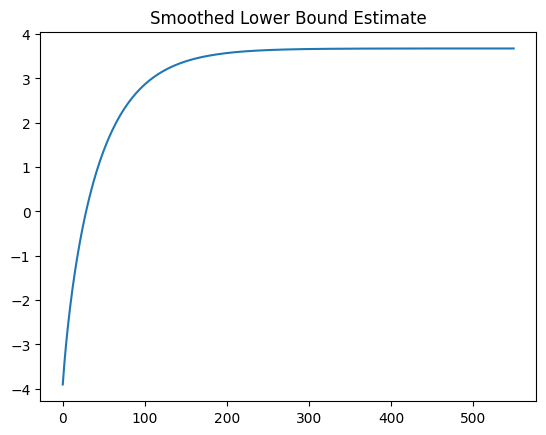

In [14]:
wass_smoothed_lb_df = pd.DataFrame(np.array(LB_Smoothed))
plt.figure()
wass_smoothed_lb_df.plot(title = 'Smoothed Lower Bound Estimate', legend = False)

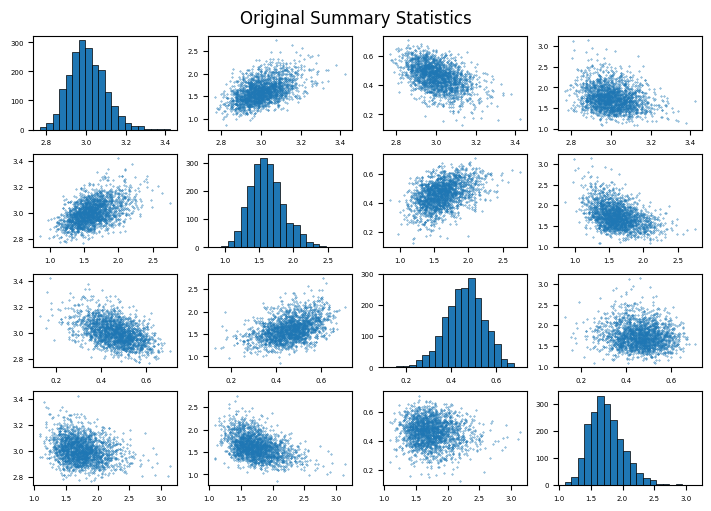

In [62]:
# Initialise the subplot function using number of rows and columns
figure, axis = plt.subplots(4, 4, figsize=(7,5), constrained_layout=True)

# For Sine Function
for x in range(4):
    for y in range(4):
        if x != y:
            axis[x, y].scatter(original_train_summary_statistics[:,x], original_train_summary_statistics[:,y], s = 0.1)
            axis[x, y].tick_params(axis='both', which='major', labelsize=5)
        else:
            axis[x, y].hist(original_train_summary_statistics[:,x], bins = 20, edgecolor='black', linewidth=0.5)
            axis[x, y].tick_params(axis='both', which='major', labelsize=5)

# Combine all the operations and display
figure.suptitle('Original Summary Statistics')
plt.show()


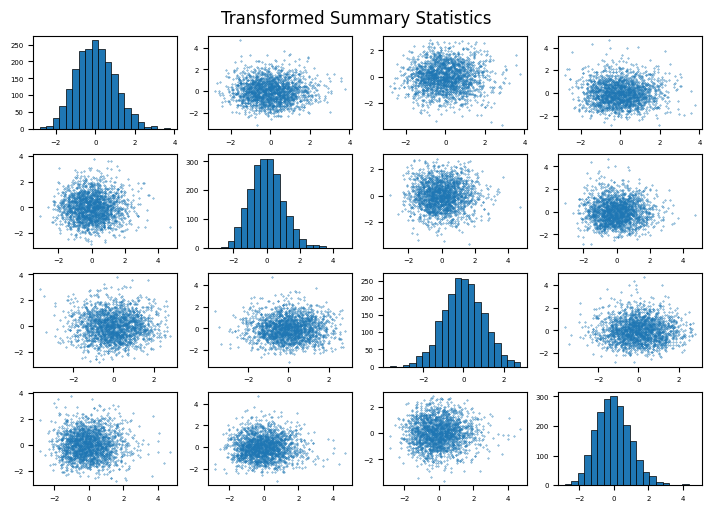

In [63]:
# Initialise the subplot function using number of rows and columns
figure, axis = plt.subplots(4, 4, figsize=(7,5), constrained_layout=True)

# For Sine Function
for x in range(4):
    for y in range(4):
        if x != y:
            axis[x, y].scatter(wass_train_summary_statistics[:,x], wass_train_summary_statistics[:,y], s = 0.1)
            axis[x, y].tick_params(axis='both', which='major', labelsize=5)
        else:
            axis[x, y].hist(wass_train_summary_statistics[:,x], bins = 20, edgecolor='black', linewidth=0.5)
            axis[x, y].tick_params(axis='both', which='major', labelsize=5)

# Combine all the operations and display
figure.suptitle('Transformed Summary Statistics')
plt.show()

<AxesSubplot: >

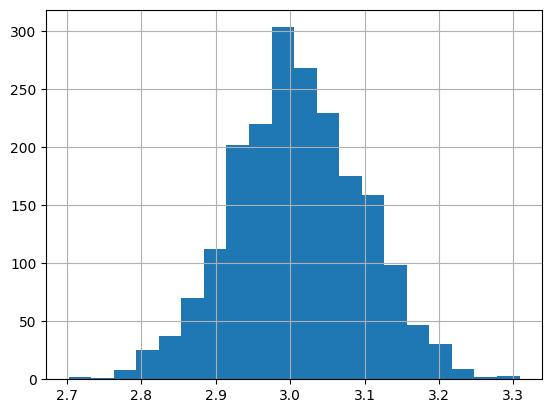

In [20]:
pd.Series(np.random.normal(np.mean(original_train_summary_statistics[:,0]),np.std(original_train_summary_statistics[:,0]), len(original_train_summary_statistics[:,0]))
).hist(bins = 20)

(array([  9.,  24.,  52., 139., 187., 268., 308., 280., 222., 205., 129.,
         81.,  45.,  21.,  12.,  11.,   2.,   3.,   1.,   1.]),
 array([2.76860403, 2.80135999, 2.83411595, 2.86687192, 2.89962788,
        2.93238384, 2.96513981, 2.99789577, 3.03065174, 3.0634077 ,
        3.09616366, 3.12891963, 3.16167559, 3.19443155, 3.22718752,
        3.25994348, 3.29269944, 3.32545541, 3.35821137, 3.39096733,
        3.4237233 ]),
 <BarContainer object of 20 artists>)

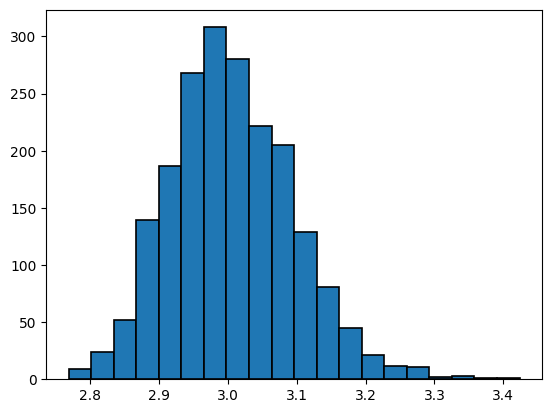

In [36]:
plt.hist(original_train_summary_statistics[:,0], bins = 20, edgecolor='black', linewidth=1.2)

In [15]:
def wasserstein_transform(mixture_obj_seq, n_summary_statistics):
    for i in range(len(mixture_obj_seq)):
        stepsize = eps
        mixture_obj = mixture_obj_seq[i]
        mean_mixture_obj = mixture_obj.means_
        sigma_mixture_obj = mixture_obj.covariances_
        weights_mixture_obj = mixture_obj.weights_
        grad_log_f = grad_log_density_mixture(n_summary_statistics, mean_mixture_obj, sigma_mixture_obj, weights_mixture_obj)[1]
        v = -n_summary_statistics-grad_log_f
        n_summary_statistics = n_summary_statistics + stepsize * v
    return n_summary_statistics

In [16]:
def summary_statistics(theta, mixture_obj_seq, num_samples, num_datasets):
    n_summary_statistics = np.zeros((num_datasets, num_latent))
    for i in range(0, num_datasets):
        y = simulate_gandk(theta, num_samples)
        n_summary_statistics[i,:] = compute_summary_statistics(y)
    transformed_summary_statistics = wasserstein_transform(mixture_obj_seq, n_summary_statistics)

    sample_mean = np.mean(transformed_summary_statistics, axis = 0)
    cov = np.cov(np.array(transformed_summary_statistics).T)
    sample_variance = cov + (np.eye(cov.shape[0]) * 5 * 1e-7)
    return sample_mean, sample_variance

In [17]:
def mean_adjustment_summary_statistics(adjusted_theta, mixture_obj_seq, num_samples, num_datasets):
    theta = adjusted_theta[:num_coeffs]
    Gamma = adjusted_theta[-num_latent:]
    sample_mean, sample_variance = summary_statistics(theta, mixture_obj_seq, num_samples, num_datasets)
    adjusted_sample_mean = sample_mean + np.diag(scipy.linalg.sqrtm(sample_variance)) * Gamma
    return adjusted_sample_mean, sample_variance

In [18]:
def prior(theta): 
    log_prior = np.sum(np.log(np.exp(theta) / (1 + np.exp(theta))**2))
    return log_prior

def unbiased_log_likelihood(theta):
    ss = summary_statistics(theta, num_samples, num_datasets)
    sample_mean = ss[0]
    sample_variance = ss[1]
    # diff_mean_s = actual_summary_statistics - sample_mean
    # part1 = diff_mean_s.T @ np.linalg.inv(sample_variance) @ diff_mean_s
    # # u_est_log_likelihood = -1/2 * np.log(np.linalg.det(sample_variance)) - (self.num_datasets - self.num_coeffs - 2) / (2 * (self.num_datasets-1)) * part1
    # u_est_log_likelihood = -1/2 * np.log(np.linalg.det(sample_variance)) - part1

    u_est_log_likelihood = multivariate_normal.logpdf(actual_summary_statistics, mean = sample_mean, cov= sample_variance)

    return u_est_log_likelihood

def prior_gamma(gamma, sigma_latent, num_latent): 
    log_prior = multivariate_normal.logpdf(gamma, cov= sigma_latent * np.identity(num_latent))
    return log_prior

def mean_adjustment_unbiased_log_likelihood(gs_adjusted_theta, num_samples, num_datasets, actual_summary_statistics, mixture_obj_seq):
    mean_adj_ss = mean_adjustment_summary_statistics(gs_adjusted_theta, mixture_obj_seq, num_samples, num_datasets)
    adjusted_sample_mean = mean_adj_ss[0]
    sample_variance = mean_adj_ss[1]

    # mean_u_est_log_likelihood = multivariate_normal.logpdf(actual_summary_statistics, mean = adjusted_sample_mean, cov= sample_variance)

    diff_mean_s = actual_summary_statistics - adjusted_sample_mean
    part1 = diff_mean_s.T @ my_inv(sample_variance) @ diff_mean_s
    mean_u_est_log_likelihood = -1/2 * np.linalg.slogdet(sample_variance)[1] - 1/2 * part1
    return mean_u_est_log_likelihood

def nuissance_mean_adjustment_unbiased_log_likelihood(Gamma, mean_nuissance, variance_nuissance):
    part1 = (Gamma - mean_nuissance).T @ my_inv(variance_nuissance) @ (Gamma - mean_nuissance)
    nuissance_mean_u_est_log_likelihood = -1/2 * np.linalg.slogdet(variance_nuissance)[1] - part1
    # nuissance_mean_u_est_log_likelihood = multivariate_normal.logpdf(Gamma, mean = mean_nuissance, cov= variance_nuissance)
    return nuissance_mean_u_est_log_likelihood

In [21]:
Sigma_0 = np.array([[0.00354862371705708,0.0100432715000140,-0.00892228604398757,-0.0115360428708387],
                   [0.0100432715000140,0.0583090115606533,-0.000835188303313756,-0.0757252081004190],
                   [-0.00892228604398757,-0.000835188303313756,0.0653624479615574,0.0107535785728523],
                   [-0.0115360428708387,-0.0757252081004190,0.0107535785728523,0.167430224841150]])
Sigma_0_inv = scipy.linalg.inv(Sigma_0)
l_0 = scipy.linalg.sqrtm(Sigma_0_inv)
l_0

array([[42.5611843 , -8.28970004,  5.43955494, -1.25900294],
       [-8.28970004,  7.88174052, -1.33079381,  2.31714084],
       [ 5.43955494, -1.33079381,  4.66869461, -0.42495144],
       [-1.25900294,  2.31714084, -0.42495144,  3.30653549]])

In [23]:
class GVB:
    def __init__(self, samples, actual_summary_statistics, learning_rate, threshold, l_threshold, adaptive_lr_1, adaptive_lr_2, t_w, Patience):
        self.samples = samples
        self.actual_summary_statistics = actual_summary_statistics
        self.num_datasets = 200 # number of datasets
        self.num_coeffs = 4 # number of coeffs
        self.lambda_dim = self.num_coeffs + int((self.num_coeffs * (self.num_coeffs + 1)) / 2)
        self.learning_rate = learning_rate
        self.threshold = threshold
        self.l_threshold = l_threshold
        self.adaptive_lr_1 = adaptive_lr_1
        self.adaptive_lr_2 = adaptive_lr_2
        self.t_w = t_w
        self.Patience = Patience

    def fun_log_q(self, theta, mu, l):
        log_q = multivariate_normal.logpdf(theta, mean = mu, cov= np.linalg.inv(l @ l.T))
        return log_q

    def gradient_log_q(self, theta, mu, l): #indep theta
        gradient_log_q_mu = np.matmul(np.matmul(l, l.T), (theta - mu))
        diag_inv_l = np.zeros((num_coeffs, num_coeffs))
        np.fill_diagonal(diag_inv_l, np.diag(np.linalg.inv(l)))
        gradient_log_q_l = (diag_inv_l - np.reshape(theta - mu, (num_coeffs,1)) @ np.reshape(theta - mu, (1,num_coeffs)) @ l).T[np.triu_indices(num_coeffs)] #use * because matmul gives scalar 
        gradient_log_q = np.array([gradient_log_q_mu, gradient_log_q_l], dtype=object)
        return gradient_log_q

    def control_variates(self, Flat_grad_log_q, Flat_grad_lb):
        c = []
        stacked_gradient_lb = np.stack(Flat_grad_lb)
        stacked_gradient_log_q = np.stack(Flat_grad_log_q)
        for i in range(self.lambda_dim):
            sample_cov = np.cov((stacked_gradient_lb[:, i], stacked_gradient_log_q[:, i]))
            c_i = sample_cov[0, 1] / sample_cov[1, 1]
            c.append(c_i)
        c_mu = np.array(c[0:self.num_coeffs])
        c_vech_l = np.array(c[self.num_coeffs:])
        return np.array([c_mu, c_vech_l], dtype = object)

    def vb_posterior(self, stop):
        # Initialize mu_0, L_0
        # mu_0 = np.array([np.log((self.actual_summary_statistics[0]-1.1)/(2-self.actual_summary_statistics[0])), np.log((1+self.actual_summary_statistics[1])/(1-self.actual_summary_statistics[1])), np.log(self.actual_summary_statistics[2]), self.actual_summary_statistics[3]])
        #mu_0 = np.array([1.5, 0.5, 3, 0])
        mu_0 = np.array([true_theta[0], np.log(true_theta[1]), true_theta[2], np.log(true_theta[3])])
        #mu_0 = np.array([self.actual_summary_statistics[0], self.actual_summary_statistics[1], self.actual_summary_statistics[2], self.actual_summary_statistics[3]])
        # mu_0 = np.array([0] * self.num_coeffs)
        # l_0 = np.tril(np.identity(self.num_coeffs) * 10)
        l_0 = np.array([[42.5611843 , -8.28970004,  5.43955494, -1.25900294],
                        [-8.28970004,  7.88174052, -1.33079381,  2.31714084],
                        [ 5.43955494, -1.33079381,  4.66869461, -0.42495144],
                        [-1.25900294,  2.31714084, -0.42495144,  3.30653549]])

        Sigma_0_inv = l_0 @ l_0.T
        Sigma_0 = np.linalg.inv(Sigma_0_inv)
        l_0_inv = np.linalg.inv(l_0)
        ### Change ways to get vech(l0)
        vech_l0 = l_0.T[np.triu_indices(self.num_coeffs)]

        lambda_0 = np.array([mu_0, vech_l0], dtype = object)
        lambda_q = lambda_0
        # Initilize best lambda
        lambda_best = lambda_0
        # List of Lambda
        Lambda = [lambda_0]
        # List of calculations of LB
        LB_all = []
        LB_Smoothed = []
        patience = 0
        # List of flattened gradients
        Flattened_gradient_lb = []
        Flattened_gradient_log_q = []
        for t in tqdm(range(stop)):
            if t == 0:        
                # Draw samples of theta from  variational q
                # List of gradients
                Gradient_lb_init = []
                lb_0 = []
                rng = np.random.default_rng()
                theta_0_samples = rng.multivariate_normal(mean = mu_0, cov = Sigma_0, size = self.samples)
                for s in tqdm(range(self.samples)):
                    # True params have been reparam into epsilon
                    theta_tilde_0 = theta_0_samples[s]
                    # alpha_0 = (2 * np.exp(theta_tilde_0[0]) + 1) / (1 + np.exp(theta_tilde_0[0]))
                    # beta_0 = (100 * np.exp(theta_tilde_0[1]) + 0) / (1 + np.exp(theta_tilde_0[1]))
                    # gamma_0 = (0.9 * np.exp(theta_tilde_0[2]) + 0) / (1 + np.exp(theta_tilde_0[2]))

                    alpha_0 = theta_tilde_0[0]
                    # beta_q = (0.05 * np.exp(theta_tilde_q[1]) + 0) / (1 + np.exp(theta_tilde_q[1]))
                    beta_0 = np.exp(theta_tilde_0[1])
                    # gamma_q = (np.exp(theta_tilde_q[2]) - 1) / (1 + np.exp(theta_tilde_q[2]))
                    gamma_0 = theta_tilde_0[2]
                    # delta_q = (0.5 * np.exp(theta_tilde_q[3]) + 0.2) / (1 + np.exp(theta_tilde_q[3]))                    theta_q = np.array([alpha_q, beta_q, gamma_q])
                    delta_0 = np.exp(theta_tilde_0[3])

                    theta_0 = np.array([alpha_0, beta_0, gamma_0, delta_0])

                    ss_0 = summary_statistics(theta_0, mixture_obj_seq, num_samples, num_datasets)
                    sample_mean_0 = ss_0[0]
                    sample_variance_0 = ss_0[1]

                    print('mean', sample_mean_0)
                    print('var', sample_variance_0)

                    # Find mean and variance for p(gamma | theta, obs)
                
                    diag_var = np.zeros((num_latent, num_latent))
                    np.fill_diagonal(diag_var, np.diag(sample_variance_0))
                    mean_nuissance_p1 = my_inv(np.identity(num_latent) / 10 + diag_var.T @ my_inv(sample_variance_0) @ diag_var)
                    diff_mean = self.actual_summary_statistics - sample_mean_0
                    mean_nuissance_p2 = diag_var @ my_inv(sample_variance_0) @ diff_mean
                    mean_nuissance_0 = mean_nuissance_p1 @ mean_nuissance_p2

                    variance_nuissance_0 = mean_nuissance_p1  + (np.eye(mean_nuissance_p1.shape[0]) * 5 * 1e-7)

                    print(mean_nuissance_0)
                    print(variance_nuissance_0)

                    # GENERATE GAMMA
                    rng = np.random.default_rng()
                    Gamma = rng.multivariate_normal(mean = mean_nuissance_0, cov = variance_nuissance_0)
                    # Gamma = Gamma[0]
                    adjusted_theta_0 = np.concatenate((theta_0, Gamma))

                    print('adjusted theta', adjusted_theta_0)

                    # Find gradient of LB
                    llh = mean_adjustment_unbiased_log_likelihood(adjusted_theta_0, num_samples, num_datasets, self.actual_summary_statistics, mixture_obj_seq)
                    llh_gamma = nuissance_mean_adjustment_unbiased_log_likelihood(Gamma, mean_nuissance_0, variance_nuissance_0)

                    # Find gradient of LB
                    h_lambda_init = prior(theta_tilde_0) + prior_gamma(Gamma, 10, num_latent) + llh - self.fun_log_q(theta_tilde_0, mu_0, l_0) - llh_gamma

                    gradient_lb_init = self.gradient_log_q(theta_tilde_0, mu_0, l_0) * (h_lambda_init)
                    Gradient_lb_init.append(gradient_lb_init)
                    # Calculate control variates
                    flattened_gradient_log_q = np.concatenate((self.gradient_log_q(theta_tilde_0, mu_0, l_0)[0], self.gradient_log_q(theta_tilde_0, mu_0, l_0)[1]), axis = None)
                    Flattened_gradient_log_q.append(flattened_gradient_log_q)
                    flattened_gradient_lb = np.concatenate((gradient_lb_init[0], gradient_lb_init[1]), axis = None)
                    Flattened_gradient_lb.append(flattened_gradient_lb)
                    # Calculate lower bound
                    lb_0.append(h_lambda_init)
                # Calculate control variates using all samples
                c = self.control_variates(Flattened_gradient_log_q, Flattened_gradient_lb)
                # Update lambda_q
                self.g_init = np.mean(Gradient_lb_init, axis = 0)
                # Gradient clipping
                if np.linalg.norm(np.concatenate(self.g_init, axis = None)) > self.l_threshold:
                    self.g_init = self.l_threshold * self.g_init / np.linalg.norm(np.concatenate(self.g_init, axis = None))
                self.v_init = self.g_init ** 2
                # Calculate lower bound
                LB_all.append(np.mean(lb_0))
                print('LB', (np.mean(lb_0)))
                lambda_q = lambda_0

            if t > 0:
                # From lambda_q find mu_q and L_q
                mu_q = lambda_q[0]

                ### Change ways to convert from vech_l0 to l0
                vech_lq = list(lambda_q[1])
                l_q = np.zeros((self.num_coeffs, self.num_coeffs))
                # l_q[:, 0] = lambda_q[1][0:self.num_coeffs]
                # l_q[1:self.num_coeffs, 1] = lambda_q[1][4:7]
                # l_q[2:self.num_coeffs, 2] = lambda_q[1][7:9]
                # l_q[3:self.num_coeffs, 3] = lambda_q[1][9:10]
                for i in range(self.num_coeffs):
                    l_q[i:self.num_coeffs,i] = vech_lq[:self.num_coeffs - i]
                    del vech_lq[:self.num_coeffs-i]

                Sigma_q_inv = l_q @ l_q.T
                Sigma_q =  np.linalg.inv(Sigma_q_inv)
                l_q_inv =  np.linalg.inv(l_q)
                # List of gradients
                Gradient_lb = []
                lb_t = []
                rng = np.random.default_rng()
                theta_q_samples = rng.multivariate_normal(mean = mu_q, cov = Sigma_q, size = self.samples)
                for s in range(self.samples):
                    theta_tilde_q = theta_q_samples[s]
                    # Calculate theta from mu, l (lambda)
                    alpha_q = theta_tilde_q[0]
                    # beta_q = (0.05 * np.exp(theta_tilde_q[1]) + 0) / (1 + np.exp(theta_tilde_q[1]))
                    beta_q = np.exp(theta_tilde_q[1])
                    # gamma_q = (np.exp(theta_tilde_q[2]) - 1) / (1 + np.exp(theta_tilde_q[2]))
                    gamma_q = theta_tilde_q[2]
                    # delta_q = (0.5 * np.exp(theta_tilde_q[3]) + 0.2) / (1 + np.exp(theta_tilde_q[3]))                    theta_q = np.array([alpha_q, beta_q, gamma_q])
                    delta_q = np.exp(theta_tilde_q[3])

                    theta_q = np.array([alpha_q, beta_q, gamma_q, delta_q])

                    ss_q = summary_statistics(theta_q, mixture_obj_seq, num_samples, num_datasets)
                    sample_mean_q = ss_q[0]
                    sample_variance_q = ss_q[1]

                    print('mean', sample_mean_q)
                    print('var', sample_variance_q)

                    # Find mean and variance for p(gamma | theta, obs)
                
                    diag_var = np.zeros((num_latent, num_latent))
                    np.fill_diagonal(diag_var, np.diag(sample_variance_q))
                    mean_nuissance_p1 = my_inv(np.identity(num_latent) / 10 + diag_var.T @ my_inv(sample_variance_q) @ diag_var)
                    diff_mean = self.actual_summary_statistics - sample_mean_q
                    mean_nuissance_p2 = diag_var @ my_inv(sample_variance_q) @ diff_mean
                    mean_nuissance_q = mean_nuissance_p1 @ mean_nuissance_p2

                    variance_nuissance_q = mean_nuissance_p1  + (np.eye(mean_nuissance_p1.shape[0]) * 5 * 1e-7)

                    print(mean_nuissance_q)
                    print(variance_nuissance_q)

                    # GENERATE GAMMA
                    rng = np.random.default_rng()
                    Gamma = rng.multivariate_normal(mean = mean_nuissance_q, cov = variance_nuissance_q)
                    # Gamma = Gamma[0]
                    adjusted_theta_q = np.concatenate((theta_q, Gamma))

                    print('adjusted theta', adjusted_theta_q)

                    # Find gradient of LB
                    llh = mean_adjustment_unbiased_log_likelihood(adjusted_theta_q, num_samples, num_datasets, self.actual_summary_statistics, mixture_obj_seq)
                    llh_gamma = nuissance_mean_adjustment_unbiased_log_likelihood(Gamma, mean_nuissance_q, variance_nuissance_q)

                    # Find gradient of LB
                    h_lambda = prior(theta_tilde_q) + prior_gamma(Gamma, 10, num_latent) + llh - self.fun_log_q(theta_tilde_q, mu_q, l_q) - llh_gamma
                    # Find gradient of LB
                    gradient_lb = self.gradient_log_q(theta_tilde_q, mu_q, l_q) * (h_lambda - c)

                    Gradient_lb.append(gradient_lb)
                    # Calculate control variates
                    Flattened_gradient_log_q[s] = np.concatenate((self.gradient_log_q(theta_tilde_q, mu_q, l_q)[0], self.gradient_log_q(theta_tilde_q, mu_q, l_q)[1]), axis = None)
                    Flattened_gradient_lb[s] = np.concatenate((gradient_lb[0], gradient_lb[1]), axis = None)
                    # Calc lower bound estimate
                    lb_t.append(h_lambda)
                # Update control variates
                c = self.control_variates(Flattened_gradient_log_q, Flattened_gradient_lb)
                # Calc gradient of h
                g_t = np.mean(Gradient_lb, axis = 0)
                # Gradient clipping
                if np.linalg.norm(np.concatenate(g_t, axis = None)) > self.l_threshold:
                    g_t = self.l_threshold * g_t / np.linalg.norm(np.concatenate(g_t, axis = None))
                v_t = g_t ** 2

                #---- Update lambda
                self.g_init = self.adaptive_lr_1 * self.g_init + (1 - self.adaptive_lr_1) * g_t
                self.v_init = self.adaptive_lr_2 * self.v_init + (1 - self.adaptive_lr_2) * v_t
                if t >= self.threshold:
                    update_t = self.learning_rate * self.threshold / t
                else:
                    update_t = self.learning_rate

                lambda_q = lambda_q + update_t * self.g_init / (self.v_init ** 0.5)
                Lambda.append(lambda_q)
                # Calculate lower bound
                LB_all.append(np.mean(lb_t))

                if t < self.t_w:
                    print('LB', np.mean(lb_t))

                if t >= self.t_w:
                    LB_smoothed = np.mean(LB_all[t - self.t_w + 1 : t])
                    print('LB Smoothed', LB_smoothed)
                    LB_Smoothed.append(LB_smoothed)
                    if LB_smoothed >= max(LB_Smoothed):
                        patience = 0
                        lambda_best = lambda_q
                    else:
                        patience += 1
                        if patience > self.Patience:
                            print("Stop at", t)
                            break

        return LB_all, LB_Smoothed, lambda_best

In [26]:
actual_summary_statistics = np.reshape(actual_summary_statistics, (1, len(actual_summary_statistics)))
actual_summary_statistics

array([[2.92896834, 1.36127314, 0.46599277, 2.00335123]])

In [27]:
# Set hyperparameters
stop = 5000
transformed_summary_statistics = wasserstein_transform(mixture_obj_seq, actual_summary_statistics)
transformed_summary_statistics[0]

array([-0.28200223, -0.96921204,  0.39173883,  0.73132168])

In [28]:
# Set hyperparameters
stop = 5000
vb = GVB(200, transformed_summary_statistics[0], 0.005, 2500, 100, 0.9, 0.9, 50, 50)
LB_estimate, smoothed_LB_estimate, best_lambda = vb.vb_posterior(stop)

  0%|          | 0/5000 [00:00<?, ?it/s]

mean [-1.32454335  2.76052122 -1.87419562  0.49892193]
var [[ 1.85598115  0.06279034  0.32336251 -0.02867031]
 [ 0.06279034  1.42554546 -0.25458938 -0.03618363]
 [ 0.32336251 -0.25458938  0.97798833  0.12292194]
 [-0.02867031 -0.03618363  0.12292194  1.06752634]]
[ 0.5039781  -2.41056996  2.05207968  0.17238784]
[[ 0.50857787  0.02364417  0.15394581 -0.01416397]
 [ 0.02364417  0.65276434 -0.15503934 -0.01862077]
 [ 0.15394581 -0.15503934  0.92155515  0.09759945]
 [-0.01416397 -0.01862077  0.09759945  0.85540231]]
adjusted theta [ 3.04623222  1.35104753  2.09031227  0.46523853  0.05603019 -2.94101779
  1.62498252  0.33520607]


mean [-0.5006108  -0.71749442 -0.52033486  0.12726591]
var [[ 1.08778357 -0.0050535   0.23183631 -0.10025214]
 [-0.0050535   0.79802049 -0.05722015  0.11605647]
 [ 0.23183631 -0.05722015  1.06881193 -0.14127624]
 [-0.10025214  0.11605647 -0.14127624  1.08627864]]
[ 0.1736914  -0.28177406  0.78126299  0.52271121]
[[ 0.83832841 -0.002924    0.16626974 -0.06928841]
 [-0.002924    1.11195277 -0.05326622  0.10834572]
 [ 0.16626974 -0.05326622  0.85109884 -0.0999965 ]
 [-0.06928841  0.10834572 -0.0999965   0.83999201]]
adjusted theta [ 2.96017403  0.85805021  1.74243487  0.56225317 -0.70741513 -1.3393678
  1.11537417  0.13711566]



  2%|▏         | 3/200 [00:01<01:11,  2.74it/s]

mean [-1.94070531  4.99282436 -4.70413459  0.20186098]
var [[ 3.90520101  0.07849531  0.98829708  0.04165106]
 [ 0.07849531  1.90836403 -0.21106736  0.13662591]
 [ 0.98829708 -0.21106736  1.51365214  0.04557406]
 [ 0.04165106  0.13662591  0.04557406  0.78098352]]
[ 0.36533072 -2.95258549  3.12978827  0.61384364]
[[ 0.24715593  0.01072556  0.15298865  0.01119716]
 [ 0.01072556  0.49677757 -0.06558421  0.07743918]
 [ 0.15298865 -0.06558421  0.61674665  0.03241615]
 [ 0.01119716  0.07743918  0.03241615  1.13434187]]
adjusted theta [ 3.17728464  1.78600257  1.70124393  0.31357505  0.6964819  -2.52238428
  3.21689533  0.90348366]


mean [-0.89504016  1.64368699 -0.62596169 -0.31187449]
var [[ 1.20934569  0.12416001 -0.44091121 -0.11071893]
 [ 0.12416001  1.17800868 -0.38029611 -0.22953608]
 [-0.44091121 -0.38029611  1.08925226  0.1439125 ]
 [-0.11071893 -0.22953608  0.1439125   1.00725783]]
[ 0.51687685 -2.01056296  0.80618644  0.90141679]
[[ 0.75392944  0.06532254 -0.2808172  -0.07195011]
 [ 0.06532254  0.77237347 -0.24657779 -0.15890182]
 [-0.2808172  -0.24657779  0.82432719  0.10282504]
 [-0.07195011 -0.15890182  0.10282504  0.89851438]]
adjusted theta [ 3.01689044  1.34857978  2.27212414  0.30309815 -0.12558565 -2.76146946
  0.52656465  1.64282505]


mean [-1.98996122e-05  2.61100501e-01 -1.89483735e+00 -2.07889195e-01]
var [[ 2.23189919 -0.41988627  0.77860911 -0.02094652]
 [-0.41988627  0.76220035 -0.21930211 -0.06851526]
 [ 0.77860911 -0.21930211  1.24611294 -0.02131074]
 [-0.02094652 -0.06851526 -0.02131074  0.75423254]]
[-0.19728058 -1.38556726  1.67643183  1.08803808]
[[ 0.41745953 -0.20423725  0.24394747 -0.01218872]
 [-0.20423725  1.15062313 -0.18405307 -0.09371537]
 [ 0.24394747 -0.18405307  0.73258168 -0.0202222 ]
 [-0.01218872 -0.09371537 -0.0202222   1.16960188]]
adjusted theta [ 3.08957583  1.03372251  1.30703389  0.45310132 -0.23708959 -1.67479661
  1.47987173  3.59468089]


mean [-0.50046704  0.2433656   0.18173754 -0.29136313]
var [[ 0.93209903  0.04591711 -0.17892824 -0.03672552]
 [ 0.04591711  0.8265119  -0.09741242 -0.05468354]
 [-0.17892824 -0.09741242  1.00086004  0.13543661]
 [-0.03672552 -0.05468354  0.13543661  1.06803475]]
[ 0.22453187 -1.3033648   0.17073578  0.8669568 ]
[[ 0.96584185  0.04623088 -0.15671123 -0.02839717]
 [ 0.04623088  1.07781024 -0.09414829 -0.04929191]
 [-0.15671123 -0.09414829  0.90343884  0.10432438]
 [-0.02839717 -0.04929191  0.10432438  0.85455578]]
adjusted theta [ 2.99195213  1.09777808  2.15708386  0.41573592 -0.09739504 -2.62094174
 -0.14204668  0.8506142 ]


mean [-1.85476041  3.05590879 -3.55472433 -0.40401455]
var [[ 3.26851179 -0.15135221  0.66337583  0.26737163]
 [-0.15135221  1.21362766 -0.19138787 -0.06070177]
 [ 0.66337583 -0.19138787  1.14380274  0.17685508]
 [ 0.26737163 -0.06070177  0.17685508  0.67481459]]
[ 0.38614846 -3.01383726  3.09931196  1.37991895]
[[ 0.29289988 -0.03155311  0.15590759  0.09916926]
 [-0.03155311  0.75927907 -0.11544482 -0.05701492]
 [ 0.15590759 -0.11544482  0.79615906  0.1812785 ]
 [ 0.09916926 -0.05701492  0.1812785   1.28559925]]
adjusted theta [ 3.08351623  1.51911892  1.71846831  0.28477634  0.8303232  -0.51167694
  3.84604826  0.32319272]


mean [ 0.56899189 -1.19212837  0.95062975  0.5807151 ]
var [[ 0.78313533 -0.03114197  0.18584749  0.01468062]
 [-0.03114197  0.80492729  0.10326684 -0.09303443]
 [ 0.18584749  0.10326684  0.98318323 -0.11360949]
 [ 0.01468062 -0.09303443 -0.11360949  1.1803188 ]]
[-0.95204106  0.24893864 -0.49702335  0.11678753]
[[ 1.1279558  -0.04112492  0.19499039  0.01437871]
 [-0.04112492  1.10296479  0.10557369 -0.07930519]
 [ 0.19499039  0.10557369  0.91696038 -0.08130965]
 [ 0.01437871 -0.07930519 -0.08130965  0.77958514]]
adjusted theta [ 2.95924478  0.78911174  2.11132734  0.68423686 -0.25149745  0.43668566
 -0.52042057  0.36085025]


mean [-0.2210071   0.70387559 -0.40871792  0.90691093]
var [[ 1.61236676 -0.16971273  0.41907589  0.13513719]
 [-0.16971273  1.15949632  0.04786813  0.10384093]
 [ 0.41907589  0.04786813  0.98861053  0.0039067 ]
 [ 0.13513719  0.10384093  0.0039067   1.36648848]]
[-0.06472127 -1.33109898  0.74192373 -0.11143562]
[[ 0.57741436 -0.07993861  0.2252598   0.05427955]
 [-0.07993861  0.79281717  0.03681025  0.05667425]
 [ 0.2252598   0.03681025  0.91308459  0.00093642]
 [ 0.05427955  0.05667425  0.00093642  0.68124495]]
adjusted theta [ 3.01440091  0.9909205   1.94182008  0.64605984 -0.62683306 -0.8896003
  2.30657969  1.26629025]


mean [ 0.20325808 -0.2311109   0.30027105  1.43913027]
var [[ 1.24339378 -0.30359552  0.44972693 -0.05071683]
 [-0.30359552  1.29191545  0.14258032  0.21338026]
 [ 0.44972693  0.14258032  1.21163307 -0.06173609]
 [-0.05071683  0.21338026 -0.06173609  1.71620425]]
[-0.37371689 -0.53409548  0.08347816 -0.38546662]
[[ 0.7343683  -0.16454104  0.25684051 -0.01859223]
 [-0.16454104  0.71409463  0.08290209  0.08430916]
 [ 0.25684051  0.08290209  0.75455708 -0.02611476]
 [-0.01859223  0.08430916 -0.02611476  0.54971764]]
adjusted theta [2.9827667  0.8150767  2.0342906  0.84286734 0.43956208 0.56389871
 0.03881559 0.45691578]


mean [-0.71281826  0.0245165  -0.84784982 -1.15390222]
var [[ 1.09286385  0.19748697 -0.38164029 -0.01636256]
 [ 0.19748697  0.81628376 -0.18174879 -0.06215308]
 [-0.38164029 -0.18174879  0.953085    0.03658831]
 [-0.01636256 -0.06215308  0.03658831  0.45167573]]
[ 0.43051986 -1.01820113  1.14372449  3.39642389]
[[ 0.82463556  0.17439427 -0.30041802 -0.02040396]
 [ 0.17439427  1.08231962 -0.18183018 -0.12134194]
 [-0.30041802 -0.18183018  0.93532528  0.05975323]
 [-0.02040396 -0.12134194  0.05975323  1.81051362]]
adjusted theta [ 2.99587244  1.14274329  1.81342425  0.21646743  0.69658268 -0.22978769
  2.05501907  1.80357917]


  6%|▌         | 11/200 [00:03<01:09,  2.73it/s]

mean [ 0.45933139  0.49398404 -1.11938499  0.50531453]
var [[ 1.360027   -0.13541295  0.442379    0.13254855]
 [-0.13541295  1.06455203  0.06655093  0.16508535]
 [ 0.442379    0.06655093  1.39938163  0.01936449]
 [ 0.13254855  0.16508535  0.01936449  1.04007821]]
[-0.5428985  -1.26825462  1.02462489  0.2188866 ]
[[ 0.67912189 -0.08161576  0.20244513  0.08054448]
 [-0.08161576  0.85613565  0.03973986  0.1250255 ]
 [ 0.20244513  0.03973986  0.66237337  0.00906254]
 [ 0.08054448  0.1250255   0.00906254  0.87473315]]
adjusted theta [ 3.08954123  1.00551547  1.54862989  0.59653132 -1.03247287 -0.50386807
  0.11643457 -0.85198564]


mean [-0.33796559  0.10002755  0.51405572  0.14195174]
var [[ 0.75496712 -0.0379987  -0.21345649 -0.15874061]
 [-0.0379987   1.08342528 -0.02343356  0.05194094]
 [-0.21345649 -0.02343356  0.94958822  0.16436934]
 [-0.15874061  0.05194094  0.16436934  0.99911328]]
[ 0.06855135 -0.90586908 -0.12507636  0.54345549]
[[ 1.16021756 -0.03736144 -0.23561148 -0.16523248]
 [-0.03736144  0.84462992 -0.02049294  0.03954214]
 [-0.23561148 -0.02049294  0.94419983  0.13819862]
 [-0.16523248  0.03954214  0.13819862  0.90431499]]
adjusted theta [ 2.95909007  1.01555897  2.33272267  0.5243945  -0.03836687 -0.31478199
  0.42159627  1.82394056]


mean [-1.44810549  1.60763974 -0.57805958  0.31798231]
var [[ 1.24803909 -0.06474742 -0.23576817 -0.03454822]
 [-0.06474742  1.64294321 -0.33891035 -0.101632  ]
 [-0.23576817 -0.33891035  0.85010702  0.01238102]
 [-0.03454822 -0.101632    0.01238102  1.13412693]]
[ 0.88224143 -1.45111442  1.00638378  0.32844214]
[[ 0.73787608 -0.03190319 -0.18482872 -0.02071713]
 [-0.03190319  0.56870855 -0.20534763 -0.04710289]
 [-0.18482872 -0.20534763  1.04436964  0.00912477]
 [-0.02071713 -0.04710289  0.00912477  0.80999659]]
adjusted theta [ 2.96472489  1.22336848  2.43690341  0.47523064  1.62551588 -1.55104302
  1.81769507  0.58571815]


mean [1.21453497 0.20787035 0.80168599 2.17794722]
var [[ 1.50023722 -0.50197479  0.3259919   0.12999781]
 [-0.50197479  1.82541297  0.17604896  0.1233998 ]
 [ 0.3259919   0.17604896  1.05941462 -0.34675107]
 [ 0.12999781  0.1233998  -0.34675107  1.85515746]]
[-0.9360585  -0.62209432 -0.34278215 -0.73934115]
[[ 0.61845827 -0.16472327  0.17792338  0.04512656]
 [-0.16472327  0.51567406  0.08254317  0.03490463]
 [ 0.17792338  0.08254317  0.85599843 -0.15414968]
 [ 0.04512656  0.03490463 -0.15414968  0.50856702]]
adjusted theta [ 3.03077483  0.83714789  2.16970042  0.94508527 -0.75301953 -0.31452512
 -0.2097282  -2.51668656]


mean [ 0.6313687  -1.56722478  1.61381965 -0.3922344 ]
var [[ 0.44120111 -0.01383253 -0.10858755  0.08746868]
 [-0.01383253  0.87578099  0.04102343 -0.11751943]
 [-0.10858755  0.04102343  1.17734672  0.02253956]
 [ 0.08746868 -0.11751943  0.02253956  0.98608802]]
[-1.72041874  0.62401151 -0.99409531  1.07536417]
[[ 1.84255103 -0.02382966 -0.15735601  0.14888655]
 [-0.02382966  1.02327747  0.03265755 -0.11053161]
 [-0.15735601  0.03265755  0.77968667  0.01952838]
 [ 0.14888655 -0.11053161  0.01952838  0.91661839]]
adjusted theta [ 2.93346017  0.81680872  2.30841432  0.48924574 -0.6590873   1.51210859
  0.49397281  2.78911462]


mean [-0.89777083  0.30294374  0.12126092  0.43776689]
var [[ 0.90687895  0.08689912 -0.10595644 -0.17333134]
 [ 0.08689912  1.19661955 -0.06857558  0.07449806]
 [-0.10595644 -0.06857558  0.86068082  0.0045414 ]
 [-0.17333134  0.07449806  0.0045414   1.24932977]]
[ 0.62530978 -0.98507519  0.28318939  0.23084769]
[[ 0.9895922   0.06650583 -0.1091379  -0.12789456]
 [ 0.06650583  0.77021152 -0.05426635  0.04354883]
 [-0.1091379  -0.05426635  1.03927708  0.00220853]
 [-0.12789456  0.04354883  0.00220853  0.73909578]]
adjusted theta [ 2.94085655  1.00384088  2.28655202  0.55978902  0.15887736 -0.27296657
 -1.43983441  0.39595881]


mean [-0.25332318  1.20026512 -0.59478719  0.23953794]
var [[ 1.53007676  0.12359701  0.05785783 -0.02450959]
 [ 0.12359701  1.07500971 -0.04179748 -0.00875562]
 [ 0.05785783 -0.04179748  0.89181794  0.09981031]
 [-0.02450959 -0.00875562  0.09981031  0.85142806]]
[-0.00761885 -1.84193986  0.98151854  0.50375467]
[[ 0.61283968  0.0646642   0.03623381 -0.01617538]
 [ 0.0646642   0.85046266 -0.03602806 -0.00729977]
 [ 0.03623381 -0.03602806  1.00671996  0.10581935]
 [-0.01617538 -0.00729977  0.10581935  1.04977387]]
adjusted theta [ 3.03956074  1.15833232  2.01321078  0.4868935   1.43766086 -1.41616382
  2.08653902  1.7262453 ]


mean [-0.02147786 -0.10248353 -0.14399647 -0.47712476]
var [[ 0.81633301  0.01425164 -0.04669606 -0.01696368]
 [ 0.01425164  0.8648529   0.0309564   0.02720615]
 [-0.04669606  0.0309564   0.86140459  0.0514058 ]
 [-0.01696368  0.02720615  0.0514058   0.79578833]]
[-0.27629617 -0.9046254   0.54990966  1.34790345]
[[ 1.09091681  0.01638949 -0.05293192 -0.02037206]
 [ 0.01638949  1.03616349  0.03326029  0.03129489]
 [-0.05293192  0.03326029  1.03930706  0.05945584]
 [-0.02037206  0.03129489  0.05945584  1.1157824 ]]
adjusted theta [ 3.01784044  1.05862908  1.90426548  0.38085733  0.77613433 -1.5411288
  0.43178934  0.54467763]


mean [-0.37527966  0.3237059   0.63093795  0.46089012]
var [[ 0.79332056 -0.0129426  -0.1672714  -0.21221348]
 [-0.0129426   1.23665968 -0.05827982  0.21403488]
 [-0.1672714  -0.05827982  0.92290703 -0.05670775]
 [-0.21221348  0.21403488 -0.05670775  1.15279846]]
[ 0.10325533 -0.97145924 -0.23508206  0.23033451]
[[ 1.11174538 -0.00907159 -0.18416992 -0.19056189]
 [-0.00907159  0.74615341 -0.04220793  0.12744183]
 [-0.18416992 -0.04220793  0.97338672 -0.04762122]
 [-0.19056189  0.12744183 -0.04762122  0.79215038]]
adjusted theta [ 2.95908667  0.99880311  2.38356281  0.59456302  1.8320517  -1.40971196
 -0.75180474  1.3321931 ]


mean [ 0.39334085 -1.38586324  1.07483083  0.56392447]
var [[ 0.71388638 -0.09476848  0.04075702  0.03234982]
 [-0.09476848  0.75591794  0.04465528  0.06426635]
 [ 0.04075702  0.04465528  1.21475249 -0.23374916]
 [ 0.03234982  0.06426635 -0.23374916  1.47428585]]
[-0.82058491  0.4757735  -0.51693018  0.09980635]
[[ 1.22634023 -0.13637901  0.03903065  0.02646814]
 [-0.13637901  1.16579855  0.04087198  0.0486003 ]
 [ 0.03903065  0.04087198  0.75888062 -0.11328748]
 [ 0.02646814  0.0486003  -0.11328748  0.63348579]]
adjusted theta [ 2.93097301  0.77240424  2.24099315  0.67301527 -0.70317563  0.75345738
 -0.79825895  0.82510157]


mean [-0.53322258 -0.54970014  0.57458667 -0.76453439]
var [[ 0.59197017  0.06401862 -0.43257155 -0.07218334]
 [ 0.06401862  0.7480907  -0.1896273  -0.08083115]
 [-0.43257155 -0.1896273   1.22932395  0.11791045]
 [-0.07218334 -0.08083115  0.11791045  0.73721023]]
[ 0.38680271 -0.47914525 -0.14693444  1.78784796]
[[ 1.41842648  0.09937908 -0.46841186 -0.11833938]
 [ 0.09937908  1.17348465 -0.16151428 -0.11061672]
 [-0.46841186 -0.16151428  0.72226233  0.09738346]
 [-0.11833938 -0.11061672  0.09738346  1.19017676]]
adjusted theta [ 2.91846091  0.99499804  2.31619466  0.34663439  0.89056734 -0.74841103
  0.04241743  1.90954705]


mean [ 0.00929456 -0.5496298   1.01456224  0.28098034]
var [[ 0.80758279 -0.00182987 -0.04946975 -0.13697765]
 [-0.00182987  1.06826675  0.053829   -0.040499  ]
 [-0.04946975  0.053829    0.97785651 -0.08116466]
 [-0.13697765 -0.040499   -0.08116466  1.4086789 ]]
[-0.32112331 -0.35577975 -0.57644225  0.29082475]
[[ 1.10046813 -0.00173218 -0.05110595 -0.10033917]
 [-0.00173218  0.85571223  0.04261743 -0.02276329]
 [-0.05110595  0.04261743  0.92700876 -0.05038413]
 [-0.10033917 -0.02276329 -0.05038413  0.6613696 ]]
adjusted theta [ 2.95286194  0.91457835  2.34154998  0.57934389 -0.61861342 -1.70599225
  0.68875383  2.10684182]


 12%|█▏        | 23/200 [00:07<00:57,  3.06it/s]


mean [-0.57606041 -0.70190003  0.84423054  1.73971083]
var [[ 0.90956265 -0.51806044  0.41359196 -0.19581981]
 [-0.51806044  1.57977567 -0.20044483  0.23976881]
 [ 0.41359196 -0.20044483  0.95238599 -0.37438569]
 [-0.19581981  0.23976881 -0.37438569  2.33420292]]
[ 0.30227306 -0.15198418 -0.45122992 -0.41792437]
[[ 0.96355804 -0.30113163  0.3857216  -0.07181504]
 [-0.30113163  0.58352549 -0.09968953  0.05443903]
 [ 0.3857216  -0.09968953  0.93018315 -0.14243671]
 [-0.07181504  0.05443903 -0.14243671  0.40753777]]
adjusted theta [ 2.88661111  0.68794902  2.31988804  0.95730312  0.50133397 -0.62817355
 -0.27729048  0.67028726]


 12%|█▏        | 24/200 [00:08<00:59,  2.97it/s]

mean [ 0.48128026 -0.04170144 -0.23115824 -0.44704017]
var [[ 0.99304755 -0.0188673  -0.06781353 -0.06463665]
 [-0.0188673   0.76591865  0.02791258  0.00169889]
 [-0.06781353  0.02791258  1.00673028  0.07570043]
 [-0.06463665  0.00169889  0.07570043  1.00128981]]
[-0.69103533 -1.07462983  0.55484417  1.06232716]
[[ 0.91417156 -0.01974692 -0.05563282 -0.05331584]
 [-0.01974692  1.15470694  0.0289946   0.00146685]
 [-0.05563282  0.0289946   0.90270224  0.06178028]
 [-0.05331584  0.00146685  0.06178028  0.90728947]]
adjusted theta [ 3.05505049  1.09371403  1.88529782  0.38487516  1.15646494 -0.95679214
  1.30688911  0.00652683]


mean [ 0.35170627 -0.01460931  0.34577389  1.91635727]
var [[ 1.4884844  -0.49239964  0.47927928 -0.21820894]
 [-0.49239964  1.51682046  0.08104691  0.5341328 ]
 [ 0.47927928  0.08104691  1.19812411 -0.20316528]
 [-0.21820894  0.5341328  -0.20316528  2.47120675]]
[-0.41472602 -0.59301412  0.04525613 -0.45483139]
[[ 0.61945695 -0.19224481  0.2331574  -0.04931287]
 [-0.19224481  0.61267204  0.04421684  0.12775971]
 [ 0.2331574   0.04421684  0.76399636 -0.06018708]
 [-0.04931287  0.12775971 -0.06018708  0.38649511]]
adjusted theta [ 2.986013    0.78923239  2.04371834  0.94317632  0.04922822 -1.42296256
 -0.61701204 -0.75679542]


mean [ 1.2730388  -0.0799236  -0.55782117  1.17358825]
var [[ 1.83576844 -0.26398635  0.87601958  0.11813623]
 [-0.26398635  1.01209366 -0.05143198  0.16726579]
 [ 0.87601958 -0.05143198  1.62857003 -0.22484994]
 [ 0.11813623  0.16726579 -0.22484994  1.29966102]]
[-0.82852782 -0.80531814  0.56686449 -0.29707122]
[[ 0.50743083 -0.12255284  0.26217204  0.04767735]
 [-0.12255284  0.89630934 -0.02230096  0.10783668]
 [ 0.26217204 -0.02230096  0.57026978 -0.09395915]
 [ 0.04767735  0.10783668 -0.09395915  0.71203986]]
adjusted theta [ 3.07818529  0.85932663  1.56166493  0.78091283 -1.4931572   0.30292676
  0.50153794 -0.9355077 ]


mean [-0.57137242  1.51199095 -1.25434298  0.19393977]
var [[ 1.64315008  0.05616268  0.27435108 -0.12819266]
 [ 0.05616268  1.015657   -0.04532176  0.16487545]
 [ 0.27435108 -0.04532176  1.17736198  0.0697023 ]
 [-0.12819266  0.16487545  0.0697023   0.98141151]]
[ 0.15994678 -2.22796993  1.27586683  0.5245402 ]
[[ 0.57140603  0.03035422  0.12373356 -0.06915385]
 [ 0.03035422  0.89406222 -0.0329695   0.1370913 ]
 [ 0.12373356 -0.0329695   0.78084309  0.05185803]
 [-0.06915385  0.1370913   0.05185803  0.92187715]]
adjusted theta [ 3.05456048  1.21919424  1.90041714  0.45920281  0.53597132 -3.17601989
  2.92069065  1.72738195]


mean [ 0.46994069 -0.40515668  0.11935498  0.42717074]
var [[ 1.15432502  0.01343399  0.16036474  0.07939797]
 [ 0.01343399  0.99934772  0.13321223  0.1184391 ]
 [ 0.16036474  0.13321223  1.04624785 -0.05806084]
 [ 0.07939797  0.1184391  -0.05806084  1.1718805 ]]
[-0.60334645 -0.51764503  0.25203652  0.24832091]
[[ 0.79559764  0.00798912  0.11168128  0.05019005]
 [ 0.00798912  0.90761182  0.10600817  0.08514404]
 [ 0.11168128  0.10600817  0.86964673 -0.04142909]
 [ 0.05019005  0.08514404 -0.04142909  0.78499231]]
adjusted theta [ 3.00758773  0.90784912  1.89461783  0.58752533 -0.66334381 -0.92555376
  0.56552323  0.85963982]


mean [-0.91473018  1.11362272 -0.07789486 -0.49776401]
var [[ 7.50625333e-01  9.85660450e-04 -3.45551126e-01  4.13241806e-02]
 [ 9.85660450e-04  1.11227491e+00 -2.79239381e-01 -8.69254111e-02]
 [-3.45551126e-01 -2.79239381e-01  1.02121103e+00  3.40597376e-02]
 [ 4.13241806e-02 -8.69254111e-02  3.40597376e-02  8.16842544e-01]]
[ 0.75234789 -1.69743746  0.40683606  1.32009699]
[[ 1.16083284 -0.00675955 -0.3632752   0.0543398 ]
 [-0.00675955  0.81958026 -0.20554994 -0.07746491]
 [-0.3632752  -0.20554994  0.87225017  0.03363357]
 [ 0.0543398  -0.07746491  0.03363357  1.08959138]]
adjusted theta [ 2.9804242   1.23173753  2.34441645  0.32464986  1.02951228 -1.06904554
  0.54860398  1.42561618]


mean [-0.87366396  2.80432654 -2.97143989  0.24616711]
var [[ 3.34409063e+00  4.35339351e-02  1.05752797e+00  2.59124221e-02]
 [ 4.35339351e-02  1.26311519e+00 -6.25548020e-02 -2.87295313e-03]
 [ 1.05752797e+00 -6.25548020e-02  1.84013653e+00  2.38545463e-01]
 [ 2.59124221e-02 -2.87295313e-03  2.38545463e-01  8.36025654e-01]]
[ 0.14546476 -2.76405239  1.71678715  0.49374456]
[[ 0.28769736  0.00967167  0.15824695  0.00585087]
 [ 0.00967167  0.73354518 -0.02378295 -0.00193033]
 [ 0.15824695 -0.02378295  0.51085729  0.13128286]
 [ 0.00585087 -0.00193033  0.13128286  1.06652377]]
adjusted theta [ 3.13571873  1.42092545  1.64984775  0.4042225   0.05310339 -2.01103925
  1.15472325 -0.4135179 ]


mean [-0.95543785  2.19078265 -1.59660412  0.60273028]
var [[ 1.81649126  0.10142737  0.33887521  0.2384004 ]
 [ 0.10142737  1.54386388 -0.14951463  0.06775755]
 [ 0.33887521 -0.14951463  1.1114981   0.10522861]
 [ 0.2384004   0.06775755  0.10522861  1.01253321]]
[ 0.3308733  -1.91059401  1.61995417  0.10543293]
[[ 0.51800513  0.03294681  0.14532583  0.11048963]
 [ 0.03294681  0.60743842 -0.07590941  0.03730999]
 [ 0.14532583 -0.07590941  0.82192234  0.07668738]
 [ 0.11048963  0.03730999  0.07668738  0.89674689]]
adjusted theta [ 3.04557559  1.25635458  2.02134453  0.51069027 -0.79743727 -1.84896406
  0.18671331  0.45132623]


mean [ 0.36880312 -0.04443203 -0.170691   -0.20563907]
var [[ 1.17181405  0.06268274  0.03941911  0.14106906]
 [ 0.06268274  0.96358498 -0.00731723  0.07118975]
 [ 0.03941911 -0.00731723  1.0931132   0.12152868]
 [ 0.14106906  0.07118975  0.12152868  1.08574594]]
[-0.51671158 -0.87151218  0.46482664  0.79650457]
[[ 0.78502304  0.04578817  0.02513762  0.09303587]
 [ 0.04578817  0.93963701 -0.00642152  0.05604759]
 [ 0.02513762 -0.00642152  0.83726503  0.08569546]
 [ 0.09303587  0.05604759  0.08569546  0.84125421]]
adjusted theta [ 3.03263844  1.04298932  1.88571347  0.43718024 -0.51660049 -1.74636602
  1.38046355  0.42854648]


mean [-0.67616686 -0.31909788  0.80596252 -1.10714359]
var [[ 0.59615091  0.16850552 -0.51861571 -0.10928232]
 [ 0.16850552  0.98250067 -0.35218764 -0.15770448]
 [-0.51861571 -0.35218764  1.2386288   0.10356157]
 [-0.10928232 -0.15770448  0.10356157  0.73632269]]
[ 0.60893829 -0.58097387 -0.30857516  2.20355405]
[[ 1.39436925  0.20666532 -0.55184128 -0.17914296]
 [ 0.20666532  0.90907847 -0.22824601 -0.16766805]
 [-0.55184128 -0.22824601  0.70425548  0.07645604]
 [-0.17914296 -0.16766805  0.07645604  1.18780222]]
adjusted theta [ 2.92887304  1.10147181  2.39691302  0.23826827 -0.11803815 -0.90409875
  0.04699588  2.73479089]


 17%|█▋        | 34/200 [00:11<00:56,  2.92it/s]


mean [-0.21668148  0.92467339  0.60879582  1.35212492]
var [[ 1.21797358 -0.25214755 -0.0064754  -0.14997216]
 [-0.25214755  1.42338978  0.15101332  0.341521  ]
 [-0.0064754   0.15101332  1.08965669 -0.15145818]
 [-0.14997216  0.341521   -0.15145818  1.82649314]]
[-0.06821173 -1.23876584 -0.17358693 -0.30850541]
[[ 0.75670257 -0.12487501 -0.00341829 -0.05754828]
 [-0.12487501  0.65254252  0.08411539  0.1162266 ]
 [-0.00341829  0.08411539  0.83935931 -0.06716336]
 [-0.05754828  0.1162266  -0.06716336  0.51677844]]
adjusted theta [ 2.98273892  1.00108399  2.50401155  0.73709514 -0.86516262 -0.69901764
  1.54748152  1.06137004]


 18%|█▊        | 35/200 [00:11<00:58,  2.80it/s]

mean [-0.81999098  1.91131595 -1.63151284 -0.2897068 ]
var [[ 1.70185447  0.1443977  -0.00205083 -0.02950666]
 [ 0.1443977   1.06253887 -0.16939111  0.0504475 ]
 [-0.00205083 -0.16939111  1.01809374  0.0393384 ]
 [-0.02950666  0.0504475   0.0393384   0.77879784]]
[ 0.31979236 -2.46131169  1.76921814  1.16799622]
[[ 5.54423567e-01  6.90446824e-02  5.23109397e-05 -1.90085834e-02]
 [ 6.90446824e-02  8.57534932e-01 -1.30574848e-01  5.01037525e-02]
 [ 5.23109397e-05 -1.30574848e-01  8.92334029e-01  4.07504307e-02]
 [-1.90085834e-02  5.01037525e-02  4.07504307e-02  1.13743127e+00]]
adjusted theta [ 3.06927136  1.36102989  1.91084953  0.32454053  0.05575037 -3.16688316
  0.40992014 -0.73153586]


mean [ 0.35473855  0.52661216 -1.81684538 -0.32186982]
var [[ 2.03272533 -0.32539304  0.40206064  0.05231102]
 [-0.32539304  0.76628105 -0.21556408  0.00829306]
 [ 0.40206064 -0.21556408  1.41216795  0.05892222]
 [ 0.05231102  0.00829306  0.05892222  0.8234192 ]]
[-0.35504384 -1.70943887  1.42800362  1.13707489]
[[ 0.46371907 -0.17410956  0.12137287  0.02623194]
 [-0.17410956  1.14826697 -0.16244826  0.01159347]
 [ 0.12137287 -0.16244826  0.65649398  0.04207072]
 [ 0.02623194  0.01159347  0.04207072  1.08265549]]
adjusted theta [ 3.12149887  1.1312515   1.38235656  0.38269347 -0.61513838  0.50371748
  0.40937258  0.03553858]


 18%|█▊        | 37/200 [00:12<00:59,  2.75it/s]

mean [-1.07465157  0.53925176  0.24374051  2.35570516]
var [[ 1.38923204 -0.42442644  0.28479579 -0.25424062]
 [-0.42442644  1.64652987 -0.05116421  0.23136322]
 [ 0.28479579 -0.05116421  0.95172912 -0.35535457]
 [-0.25424062  0.23136322 -0.35535457  1.69984114]]
[ 0.50643619 -0.84756857  0.11068368 -0.8884522 ]
[[ 0.66416837 -0.16205291  0.17970697 -0.08993363]
 [-0.16205291  0.56910086 -0.02328427  0.07149731]
 [ 0.17970697 -0.02328427  0.94354956 -0.1858674 ]
 [-0.08993363  0.07149731 -0.1858674   0.55027662]]
adjusted theta [ 2.90641641  0.78134554  2.39418785  1.04961798 -0.11187552  0.45710054
  0.03525103 -2.18654099]


mean [-0.88763585  0.89534778 -0.23893423  0.64519411]
var [[ 1.08046256 -0.07830311  0.0516564  -0.23906989]
 [-0.07830311  1.18097771 -0.17143367  0.03067757]
 [ 0.0516564  -0.17143367  0.88079493  0.03883768]
 [-0.23906989  0.03067757  0.03883768  1.10989787]]
[ 0.5033473  -1.44349903  0.61891433  0.08123463]
[[ 0.84356346 -0.05076564  0.04447993 -0.16750609]
 [-0.05076564  0.77825411 -0.13630801  0.01936738]
 [ 0.04447993 -0.13630801  1.01722664  0.0338432 ]
 [-0.16750609  0.01936738  0.0338432   0.82328827]]
adjusted theta [ 2.96930911e+00  1.04829174e+00  2.21788916e+00  5.96027227e-01
 -9.44684482e-01 -1.42875957e+00  5.60865608e-01 -1.70372775e-03]


mean [ 0.35658662 -0.20003236  0.45755836  0.2202883 ]
var [[ 1.0574455  -0.07291446 -0.02500375 -0.02902799]
 [-0.07291446  1.07366803 -0.01969523 -0.07096886]
 [-0.02500375 -0.01969523  0.94798895  0.03079223]
 [-0.02902799 -0.07096886  0.03079223  1.04528501]]
[-0.55466531 -0.65618745 -0.06644601  0.44127808]
[[ 0.86355596 -0.0538416  -0.02064623 -0.0221511 ]
 [-0.0538416   0.85137964 -0.01598646 -0.05288443]
 [-0.02064623 -0.01598646  0.95406275  0.02551359]
 [-0.0221511  -0.05288443  0.02551359  0.87271493]]
adjusted theta [ 3.00625178  0.97584242  2.04215632  0.53525838  0.12141821 -0.49577756
  1.66197105 -0.14438087]


mean [0.76454963 0.77661963 0.51782777 0.81537721]
var [[ 1.2860623   0.02496198  0.14745869  0.09528854]
 [ 0.02496198  1.22010013  0.02332914  0.22898478]
 [ 0.14745869  0.02332914  0.88248723 -0.11334865]
 [ 0.09528854  0.22898478 -0.11334865  0.96819441]]
[-0.75132022 -1.32023293 -0.11761496 -0.05169625]
[[ 0.71967109  0.0122537   0.10906032  0.06546728]
 [ 0.0122537   0.75454819  0.01978745  0.16259142]
 [ 0.10906032  0.01978745  1.01521366 -0.10913934]
 [ 0.06546728  0.16259142 -0.10913934  0.93153659]]
adjusted theta [ 3.05703476  1.05047425  2.14985233  0.63826579 -0.2170931  -0.50310683
 -0.22828715 -0.03157037]


mean [ 1.30227156 -1.05423226  0.25661789  1.12943767]
var [[ 1.66253497 -0.0900766   0.92549657  0.41363391]
 [-0.0900766   0.85371711  0.11689659  0.08738326]
 [ 0.92549657  0.11689659  1.54195144 -0.16231741]
 [ 0.41363391  0.08738326 -0.16231741  1.66526327]]
[-0.89913229  0.08432758  0.11081079 -0.21268355]
[[ 0.55416712 -0.05696204  0.32152485  0.13537768]
 [-0.05696204  1.04730197  0.07690574  0.05317235]
 [ 0.32152485  0.07690574  0.59712735 -0.06104944]
 [ 0.13537768  0.05317235 -0.06104944  0.56390785]]
adjusted theta [ 3.01747888  0.74525426  1.70522785  0.81976581 -1.34487178 -1.57030885
 -0.0075291  -1.09217389]


mean [-0.48677525  0.08046762 -0.26118811 -0.26687517]
var [[ 1.03451707 -0.0592444  -0.10591628 -0.06117619]
 [-0.0592444   0.92432944 -0.08620429 -0.03244434]
 [-0.10591628 -0.08620429  0.97785024 -0.10889227]
 [-0.06117619 -0.03244434 -0.10889227  0.89336866]]
[ 0.18667706 -1.01487486  0.61017257  1.00922573]
[[ 0.87996729 -0.05193925 -0.0877055  -0.05545808]
 [-0.05193925  0.97516174 -0.07895526 -0.03308331]
 [-0.0877055  -0.07895526  0.92509741 -0.10253276]
 [-0.05545808 -0.03308331 -0.10253276  1.00507965]]
adjusted theta [ 2.97906541  1.05360827  2.04693527  0.41881703 -0.60764813 -0.78126146
  0.01338212 -0.04435408]


mean [ 1.21261515 -1.00381357  1.11383413 -0.42861896]
var [[ 0.61931881  0.04908537 -0.06841317  0.13807469]
 [ 0.04908537  0.70263262  0.13468886  0.06329886]
 [-0.06841317  0.13468886  1.21112126 -0.0427656 ]
 [ 0.13807469  0.06329886 -0.0427656   0.86819085]]
[-2.11034975  0.06047344 -0.56473697  1.24402233]
[[ 1.38444903  0.08429536 -0.07307916  0.19734005]
 [ 0.08429536  1.24255324  0.12904855  0.08001576]
 [-0.07307916  0.12904855  0.76007921 -0.03321674]
 [ 0.19734005  0.08001576 -0.03321674  1.02744487]]
adjusted theta [ 3.02383227  0.94130532  2.06217897  0.45340351 -0.63079808  1.81557582
 -2.1173912   2.37579354]


mean [ 0.11557591 -0.42802522 -0.66533473  0.2435499 ]
var [[ 1.39231905e+00 -1.52792494e-01  3.92430192e-01 -1.78579675e-02]
 [-1.52792494e-01  8.68088464e-01  2.58344146e-02 -7.92814033e-04]
 [ 3.92430192e-01  2.58344146e-02  1.19220367e+00 -1.77348108e-03]
 [-1.78579675e-02 -7.92814033e-04 -1.77348108e-03  8.80637072e-01]]
[-0.29060816 -0.56412251  0.82575476  0.49709553]
[[ 6.64331546e-01 -1.06283765e-01  2.03871139e-01 -1.21893845e-02]
 [-1.06283765e-01  1.03170764e+00  2.29725345e-02 -9.70762265e-04]
 [ 2.03871139e-01  2.29725345e-02  7.69372419e-01 -1.13143949e-03]
 [-1.21893845e-02 -9.70762265e-04 -1.13143949e-03  1.01972955e+00]]
adjusted theta [ 3.02187025  0.9090083   1.63074302  0.5810211   0.14875435 -1.71378729
  0.89812946  0.22378942]


mean [ 0.07877497 -0.86165004  0.4580055   0.80887091]
var [[ 1.05424671 -0.08837553  0.2102462  -0.02053174]
 [-0.08837553  1.00455771  0.03544391  0.10983146]
 [ 0.2102462   0.03544391  0.93266683 -0.09237109]
 [-0.02053174  0.10983146 -0.09237109  1.64679916]]
[-0.31223618 -0.0992817  -0.05804275 -0.04445084]
[[ 0.86237406 -0.06990309  0.17665648 -0.00874851]
 [-0.06990309  0.9043527   0.03273685  0.05703784]
 [ 0.17665648  0.03273685  0.9645653  -0.05123691]
 [-0.00874851  0.05703784 -0.05123691  0.5718189 ]]
adjusted theta [ 2.93990079  0.79107796  2.02681348  0.70262285 -2.6737012  -1.23925396
 -0.70557986 -0.14908806]


mean [ 0.87581707 -0.20529791 -0.11752256  0.32285121]
var [[ 1.18012035 -0.02591496  0.41075813 -0.0523977 ]
 [-0.02591496  0.90097991  0.09903394  0.07093502]
 [ 0.41075813  0.09903394  1.30357696 -0.06434388]
 [-0.0523977   0.07093502 -0.06434388  1.22326197]]
[-0.91481504 -0.76995921  0.39271481  0.3116609 ]
[[ 0.77539555 -0.02180003  0.22881381 -0.02996872]
 [-0.02180003  0.99812166  0.07123826  0.05375163]
 [ 0.22881381  0.07123826  0.70610515 -0.03432359]
 [-0.02996872  0.05375163 -0.03432359  0.75516036]]
adjusted theta [ 3.04707495  0.94681487  1.77386992  0.58092502  0.91217876 -1.98785647
  1.2120868   0.99280267]


mean [-0.78546629  2.82057695 -0.50661312  0.91012256]
var [[ 1.84384549 -0.08890891  0.01246002 -0.15479853]
 [-0.08890891  2.40882434 -0.48107254 -0.00384914]
 [ 0.01246002 -0.48107254  0.98861793  0.09530621]
 [-0.15479853 -0.00384914  0.09530621  1.3023663 ]]
[ 0.25484351 -1.49462099  0.79852942 -0.13163343]
[[ 5.14058912e-01 -1.81233790e-02  5.93797616e-03 -5.68314917e-02]
 [-1.81233790e-02  3.95141263e-01 -1.76194889e-01  8.29833955e-06]
 [ 5.93797616e-03 -1.76194889e-01  9.14940423e-01  6.24692864e-02]
 [-5.68314917e-02  8.29833955e-06  6.24692864e-02  7.12311290e-01]]
adjusted theta [ 3.04400831  1.35713724  2.51204742  0.53371572  0.98852256 -1.60820151
 -0.10076582  0.57446487]


mean [-1.14862603  2.20821754 -1.4775107   0.73758793]
var [[ 2.14201555  0.15474148  0.4858426  -0.01149569]
 [ 0.15474148  1.39847611 -0.15790959  0.22702079]
 [ 0.4858426  -0.15790959  1.16122986  0.14702726]
 [-0.01149569  0.22702079  0.14702726  1.35202138]]
[ 0.36976937 -2.10908066  1.45649482  0.00670009]
[[ 0.44257389  0.04770253  0.17235283 -0.00556868]
 [ 0.04770253  0.66516277 -0.08533726  0.10512421]
 [ 0.17235283 -0.08533726  0.78831248  0.08134186]
 [-0.00556868  0.10512421  0.08134186  0.68680897]]
adjusted theta [ 3.03493902  1.23239899  2.03065262  0.55760005  0.64217234 -0.40889268
  0.59095857 -1.44108028]


 24%|██▍       | 49/200 [00:16<00:52,  2.87it/s]


mean [-0.4454975   0.9505198  -1.40339342  0.38403637]
var [[ 1.83410222 -0.24164907  0.59764125  0.03593968]
 [-0.24164907  1.08127179 -0.07383735  0.13844911]
 [ 0.59764125 -0.07383735  1.34321626  0.09392276]
 [ 0.03593968  0.13844911  0.09392276  1.00468011]]
[ 0.03680997 -1.62278533  1.23322464  0.32531461]
[[ 0.51087694 -0.10503768  0.21364032  0.01669736]
 [-0.10503768  0.8439371  -0.04164182  0.10657729]
 [ 0.21364032 -0.04164182  0.68749424  0.05904978]
 [ 0.01669736  0.10657729  0.05904978  0.90360121]]
adjusted theta [ 3.05423236  1.0763674   1.68533367  0.55153585 -0.18613713 -3.14840028
  0.56533753  0.33944062]


 25%|██▌       | 50/200 [00:17<00:53,  2.83it/s]


mean [ 0.13650438 -0.10914361 -0.07816139 -0.59350292]
var [[ 0.86255133  0.00640426 -0.19974356  0.09278965]
 [ 0.00640426  0.77907339 -0.02113195 -0.1551006 ]
 [-0.19974356 -0.02113195  1.06450196 -0.15052734]
 [ 0.09278965 -0.1551006  -0.15052734  0.57481902]]
[-0.45824898 -0.91707427  0.43618128  1.95261904]
[[ 1.03314061  0.01146332 -0.17514875  0.13961252]
 [ 0.01146332  1.12943764 -0.02633551 -0.26243166]
 [-0.17514875 -0.02633551  0.85092642 -0.18970095]
 [ 0.13961252 -0.26243166 -0.18970095  1.46793635]]
adjusted theta [ 3.00987746  1.04137991  1.94028702  0.38391429  1.17705448 -1.5956798
 -1.3775793   2.18478244]


 26%|██▌       | 51/200 [00:17<00:52,  2.82it/s]

mean [-0.08396597 -0.61137193  0.6109811   1.07468242]
var [[ 1.0000367  -0.19061205  0.22771252 -0.04105419]
 [-0.19061205  0.95926009 -0.04263538  0.15287271]
 [ 0.22771252 -0.04263538  1.09123908 -0.44625303]
 [-0.04105419  0.15287271 -0.44625303  1.86114499]]
[-0.18301397 -0.34042856 -0.18537131 -0.1765639 ]
[[ 0.90280757 -0.16294886  0.17299989 -0.01411159]
 [-0.16294886  0.94045227 -0.02922448  0.07266858]
 [ 0.17299989 -0.02922448  0.83221085 -0.19056879]
 [-0.01411159  0.07266858 -0.19056879  0.50531287]]
adjusted theta [ 2.94604691  0.8038025   2.14637201  0.76481804  0.0523409  -0.41432509
 -0.01283297 -0.38566608]


mean [-0.81952537  0.77654657  0.3697905   1.9586432 ]
var [[ 1.31337496 -0.28558746  0.17985514 -0.29289562]
 [-0.28558746  1.35249876 -0.10108788  0.27742781]
 [ 0.17985514 -0.10108788  0.83729249 -0.25938128]
 [-0.29289562  0.27742781 -0.25938128  2.63924689]]
[ 0.3589969  -1.19333551  0.00408262 -0.43614579]
[[ 0.70286159 -0.13753935  0.13397019 -0.07314562]
 [-0.13753935  0.68532462 -0.07155644  0.06782188]
 [ 0.13397019 -0.07155644  1.06333271 -0.09943964]
 [-0.07314562  0.06782188 -0.09943964  0.36283639]]
adjusted theta [ 2.94504397  0.90702279  2.44349681  0.87778201  0.19945032 -1.4868445
 -1.03098273 -0.08047835]


 26%|██▋       | 53/200 [00:18<00:54,  2.71it/s]


mean [-0.56512577 -0.95042254  0.85693564 -0.80188844]
var [[ 0.5325511   0.04846923 -0.32062488 -0.04628174]
 [ 0.04846923  0.80345153 -0.02280274 -0.07978212]
 [-0.32062488 -0.02280274  1.04247494  0.09217747]
 [-0.04628174 -0.07978212  0.09217747  0.97865088]]
[ 0.43914633 -0.01329361 -0.39584787  1.42807518]
[[ 1.5580345   0.08339468 -0.44413803 -0.06360746]
 [ 0.08339468  1.10525384 -0.01703296 -0.08107236]
 [-0.44413803 -0.01703296  0.85125847  0.07126107]
 [-0.06360746 -0.08107236  0.07126107  0.92524155]]
adjusted theta [ 2.90585908  0.96347623  2.34297437  0.33823983 -1.68385379  2.58524097
  0.49359995  2.32328044]


 27%|██▋       | 54/200 [00:18<00:54,  2.67it/s]

mean [ 0.2379995  -0.43544992  0.06108954 -0.96857437]
var [[ 0.78763762 -0.08597733 -0.36094291 -0.0163344 ]
 [-0.08597733  0.75968011  0.07017783 -0.11846847]
 [-0.36094291  0.07017783  1.11814109  0.00599817]
 [-0.0163344  -0.11846847  0.00599817  0.90916842]]
[-0.58093889 -0.60474004  0.2532624   1.67377868]
[[ 1.11300727 -0.11070864 -0.333475   -0.01979632]
 [-0.11070864  1.15928388  0.06295316 -0.13687514]
 [-0.333475    0.06295316  0.80789804  0.00517374]
 [-0.01979632 -0.13687514  0.00517374  0.98875684]]
adjusted theta [ 3.00524836  1.05847242  1.97557236  0.2966646   1.26738316  0.90500694
 -0.51777885  1.48172722]


mean [-0.52270207 -0.15330201  0.12378635 -0.65951168]
var [[ 0.93018578  0.05055981 -0.23265959 -0.15318789]
 [ 0.05055981  0.79356393  0.02713993 -0.11131078]
 [-0.23265959  0.02713993  0.97776751  0.14294567]
 [-0.15318789 -0.11131078  0.14294567  0.79951294]]
[ 0.27304937 -0.89158558  0.23234431  1.5335267 ]
[[ 0.96258497  0.05310473 -0.20722803 -0.16126328]
 [ 0.05310473  1.11654186  0.03171211 -0.1380687 ]
 [-0.20722803  0.03171211  0.92054129  0.14426705]
 [-0.16126328 -0.1380687   0.14426705  1.10426305]]
adjusted theta [ 2.96054328  1.0823909   2.20626372  0.33995498  0.74207269 -1.19623176
 -0.91178674  2.8531959 ]


mean [-0.1301857  -2.22601953  1.04288666 -0.50823418]
var [[ 0.36281262  0.05546483 -0.0222245  -0.02996641]
 [ 0.05546483  0.43145641  0.05328944 -0.10752278]
 [-0.0222245   0.05328944  1.55645112 -0.04582854]
 [-0.02996641 -0.10752278 -0.04582854  0.96641837]]
[-0.38793158  2.40405278 -0.40898154  1.21440011]
[[ 2.15399235  0.22472675 -0.03084962 -0.05560135]
 [ 0.22472675  1.87082866  0.06090651 -0.18806003]
 [-0.03084962  0.06090651  0.60306167 -0.02476095]
 [-0.05560135 -0.18806003 -0.02476095  0.93282504]]
adjusted theta [ 2.87827181  0.72378508  2.13047234  0.47395305 -2.10472568  3.69039205
 -0.14548666  0.02782657]


mean [-1.03745765  0.89538232 -0.95881221 -0.53483285]
var [[ 1.27644203 -0.03358054 -0.17087409 -0.15807563]
 [-0.03358054  1.05761573 -0.18636814 -0.08752042]
 [-0.17087409 -0.18636814  0.89527022  0.1485715 ]
 [-0.15807563 -0.08752042  0.1485715   0.84224067]]
[ 0.58135416 -1.57397662  1.31362361  1.31445084]
[[ 0.72311245 -0.02437292 -0.12308263 -0.11997448]
 [-0.02437292  0.86020051 -0.1607723  -0.0777593 ]
 [-0.12308263 -0.1607723   0.9974942   0.15552637]
 [-0.11997448 -0.0777593   0.15552637  1.0563015 ]]
adjusted theta [ 3.00145327  1.20775552  2.00090716  0.3330437   1.77335954 -1.27221565
  0.93103593 -0.67318309]


mean [-1.1361081   2.21760436 -2.47441683 -0.31660615]
var [[ 2.2963925   0.07247135  0.15911858 -0.06267762]
 [ 0.07247135  1.19729417 -0.18242236 -0.01509631]
 [ 0.15911858 -0.18242236  1.21647616  0.24983632]
 [-0.06267762 -0.01509631  0.24983632  0.78557082]]
[ 0.35475173 -2.43119282  2.11979535  1.13180645]
[[ 0.41685107  0.0238619   0.05145711 -0.03069536]
 [ 0.0238619   0.76952857 -0.10669838 -0.01059423]
 [ 0.05145711 -0.10669838  0.75291747  0.21446028]
 [-0.03069536 -0.01059423  0.21446028  1.12413232]]
adjusted theta [ 3.06792158  1.37859341  1.77784203  0.31420455 -0.36983064 -4.58321202
  2.43078653  2.43489671]


mean [-1.46808321  2.15828266 -1.43906864  0.15822009]
var [[ 1.49309716  0.04123313 -0.07167948 -0.02541028]
 [ 0.04123313  1.35474215 -0.18591871 -0.04863567]
 [-0.07167948 -0.18591871  0.89210988  0.11429679]
 [-0.02541028 -0.04863567  0.11429679  1.13833019]]
[ 0.7583406  -2.12400784  1.81521421  0.43890587]
[[ 0.62743167  0.01711139 -0.04499111 -0.01236573]
 [ 0.01711139  0.68545882 -0.12850275 -0.02565067]
 [-0.04499111 -0.12850275  1.00502066  0.09262911]
 [-0.01236573 -0.02565067  0.09262911  0.80648985]]
adjusted theta [ 3.01202834  1.31888162  2.18822485  0.42681465  1.52874112 -2.52486898
  1.73748404  0.32614559]


mean [-0.17827652  0.92087246 -0.95789525  0.58140879]
var [[ 1.81419697 -0.29834673  0.58573765  0.15100036]
 [-0.29834673  0.87073397 -0.21478051  0.12507428]
 [ 0.58573765 -0.21478051  1.21073391 -0.02516907]
 [ 0.15100036  0.12507428 -0.02516907  1.16011923]]
[-0.11493449 -1.93239852  0.99638083  0.14339775]
[[ 0.51332397 -0.15721466  0.2308269   0.06483371]
 [-0.15721466  1.02332727 -0.16488813  0.10309246]
 [ 0.2308269  -0.16488813  0.75411839 -0.01489806]
 [ 0.06483371  0.10309246 -0.01489806  0.79194822]]
adjusted theta [ 3.04235164  1.0519564   1.80770301  0.58378372  0.68115022 -3.92697436
  1.83362971  0.69292059]


 30%|███       | 61/200 [00:21<00:50,  2.78it/s]

mean [ 0.44384258 -0.93441502  0.91150735 -0.72489256]
var [[ 0.65231457  0.09173856 -0.28556081  0.06517434]
 [ 0.09173856  0.65248252 -0.01845595 -0.01992452]
 [-0.28556081 -0.01845595  1.12683622 -0.19057088]
 [ 0.06517434 -0.01992452 -0.19057088  0.90102592]]
[-0.99299177 -0.02434676 -0.43403197  1.4572256 ]
[[ 1.31503915  0.16188806 -0.30811437  0.08197296]
 [ 0.16188806  1.32579415 -0.01471086 -0.02832517]
 [-0.30811437 -0.01471086  0.80145007 -0.15237628]
 [ 0.08197296 -0.02832517 -0.15237628  0.9954967 ]]
adjusted theta [ 2.98364649  0.988285    2.14398838  0.34339449 -1.01528194 -1.69743205
 -1.56556011  1.37816346]


mean [ 0.75689309 -2.14136324  1.80963436  0.1441102 ]
var [[ 0.3967587  -0.03856383  0.14742653  0.12082632]
 [-0.03856383  0.5327926   0.07252397 -0.14662681]
 [ 0.14742653  0.07252397  1.43009839 -0.11645482]
 [ 0.12082632 -0.14662681 -0.11645482  1.15115865]]
[-2.0578023   1.83901898 -0.88939355  0.55408372]
[[ 2.00313174 -0.12051697  0.19655017  0.19327303]
 [-0.12051697  1.57416997  0.07668181 -0.18190165]
 [ 0.19655017  0.07668181  0.64767502 -0.06396672]
 [ 0.19327303 -0.18190165 -0.06396672  0.79013793]]
adjusted theta [ 2.91844171  0.71619348  2.25591154  0.59487425  0.85680273 -0.21973921
  0.32862414  1.44834022]


mean [ 0.13081936 -2.13578965  0.78275687 -0.35987488]
var [[ 0.48867851  0.07298261  0.16450722  0.07606178]
 [ 0.07298261  0.52298539  0.15517128 -0.12699132]
 [ 0.16450722  0.15517128  1.54641874 -0.01631803]
 [ 0.07606178 -0.12699132 -0.01631803  0.99880393]]
[-0.75560332  1.91613468 -0.25553961  1.04587836]
[[ 1.68941227  0.19904227  0.16645773  0.12227961]
 [ 0.19904227  1.59418596  0.14722532 -0.18843457]
 [ 0.16645773  0.14722532  0.60131466 -0.00813027]
 [ 0.12227961 -0.18843457 -0.00813027  0.90417691]]
adjusted theta [ 2.90879283  0.7324461   2.01533195  0.51694268 -1.84751386  3.03638007
 -0.92960814  1.87185941]


 32%|███▏      | 64/200 [00:22<00:49,  2.75it/s]

mean [-1.32629719  1.00566285 -0.31986712 -0.69457872]
var [[ 0.93521781 -0.09779955 -0.43278033 -0.01281881]
 [-0.09779955  1.02576158 -0.22627127 -0.09139602]
 [-0.43278033 -0.22627127  0.96735217  0.12582524]
 [-0.01281881 -0.09139602  0.12582524  0.76090983]]
[ 1.0237455  -1.71383776  0.6504093   1.63033684]
[[ 0.94807796 -0.09237633 -0.3942164  -0.00941177]
 [-0.09237633  0.88248348 -0.19101629 -0.09162363]
 [-0.3942164  -0.19101629  0.9137726   0.13467597]
 [-0.00941177 -0.09162363  0.13467597  1.15856431]]
adjusted theta [ 2.95809432  1.25440675  2.35982104  0.27999608  0.77913318 -2.53563633
  2.21321898  3.07157225]
mean [-1.58837672  2.20252756 -1.34666782 -0.24150968]
var [[ 1.39880912  0.04922727 -0.41459491 -0.07471201]
 [ 0.04922727  1.30463983 -0.14673997 -0.09912843]
 [-0.41459491 -0.14673997  0.96238777  0.10550835]
 [-0.07471201 -0.09912843  0.10550835  0.85469059]]
[ 0.92976245 -2.23455568  1.62712467  0.98773388]
[[ 0.65939211  0.0201765  -0.25980559 -0.04911293]
 [

mean [-1.74691474  2.22183698 -1.00845771  3.45449776]
var [[ 1.96354224 -0.38752388  0.92911408 -0.19783531]
 [-0.38752388  2.06302879 -0.13955572  0.66885139]
 [ 0.92911408 -0.13955572  1.52052461 -0.08712567]
 [-0.19783531  0.66885139 -0.08712567  2.79746646]]
[ 0.66872633 -1.45545236  0.83666973 -0.9195817 ]
[[ 0.47549566 -0.08537594  0.27769216 -0.03161532]
 [-0.08537594  0.46020287 -0.03712489  0.10637409]
 [ 0.27769216 -0.03712489  0.60878817 -0.01719085]
 [-0.03161532  0.10637409 -0.01719085  0.34379541]]
adjusted theta [ 2.96289229  0.89699925  2.26667909  1.11445952  0.20974508 -1.59145354
  0.88151588 -1.1719247 ]


mean [ 0.63012795 -1.39313932  0.6323819  -0.30377689]
var [[ 0.70702764  0.03957749 -0.06262569 -0.05077013]
 [ 0.03957749  0.73176309  0.11982668 -0.09189565]
 [-0.06262569  0.11982668  1.25672735  0.09163517]
 [-0.05077013 -0.09189565  0.09163517  0.95037485]]
[-1.12849282  0.53099547 -0.19815017  0.98546545]
[[ 1.23797616  0.05894362 -0.05749776 -0.05879683]
 [ 0.05894362  1.19941142  0.107354   -0.1055607 ]
 [-0.05749776  0.107354    0.73493375  0.06520735]
 [-0.05879683 -0.1055607   0.06520735  0.94992488]]
adjusted theta [ 2.96598836  0.83799935  1.97563598  0.48578612 -2.16015954  0.13204909
 -0.77708768  1.68060249]


mean [ 0.52226414 -0.79092864  1.59533762  0.86033258]
var [[ 0.87003617 -0.21945699 -0.07607284 -0.06377338]
 [-0.21945699  1.54002567 -0.02110949  0.07839271]
 [-0.07607284 -0.02110949  0.81818038 -0.16552086]
 [-0.06377338  0.07839271 -0.16552086  1.38957664]]
[-0.84409137 -0.12339487 -1.32047903 -0.10827488]
[[ 1.02782429 -0.13797505 -0.08622797 -0.04485022]
 [-0.13797505  0.6074941  -0.01493073  0.03121541]
 [-0.08622797 -0.01493073  1.08669241 -0.12142744]
 [-0.04485022  0.03121541 -0.12142744  0.66935567]]
adjusted theta [ 2.94791618e+00  8.34167024e-01  2.48305837e+00  6.91505135e-01
 -2.04064138e+00 -2.45384996e-03 -1.19816743e+00  1.02364582e-01]


 34%|███▍      | 69/200 [00:24<00:48,  2.73it/s]

mean [ 0.76141406 -0.43773286  0.77233602  2.59689041]
var [[ 1.48177254 -0.65293719  0.67790457  0.08847609]
 [-0.65293719  1.83171409 -0.02634545  0.45229563]
 [ 0.67790457 -0.02634545  1.32314103 -0.72909994]
 [ 0.08847609  0.45229563 -0.72909994  3.70376298]]
[-0.65717459 -0.28728013 -0.25339364 -0.49122777]
[[ 0.61758095 -0.21384222  0.30168291  0.02048662]
 [-0.21384222  0.51240424 -0.00185805  0.06189837]
 [ 0.30168291 -0.00185805  0.69109975 -0.13531613]
 [ 0.02048662  0.06189837 -0.13531613  0.2605038 ]]
adjusted theta [ 2.97854928  0.69977619  2.17300383  1.06793974 -0.93017338 -0.15649668
 -0.02396814  0.61690135]


mean [ 0.22491126 -0.60422669 -0.37376659  0.48417878]
var [[ 1.31830024 -0.29342894  0.45580015  0.06754663]
 [-0.29342894  0.84747328  0.0432673   0.19017401]
 [ 0.45580015  0.0432673   1.16890726  0.04892829]
 [ 0.06754663  0.19017401  0.04892829  1.20271727]]
[-0.38485054 -0.39993555  0.61474582  0.19614092]
[[ 0.69254153 -0.22030598  0.25436653  0.03958511]
 [-0.22030598  1.04751573  0.04152639  0.15494518]
 [ 0.25436653  0.04152639  0.78089269  0.02790651]
 [ 0.03958511  0.15494518  0.02790651  0.76471238]]
adjusted theta [ 3.00432069  0.85140384  1.67474623  0.63329432 -0.79541285 -0.48390602
  1.64513172  0.19151782]


mean [ 0.02484729  0.21026535 -0.42274796  1.03117998]
var [[ 1.64922678 -0.25263323  0.55832483 -0.08900835]
 [-0.25263323  0.96641965 -0.00307006  0.16029685]
 [ 0.55832483 -0.00307006  1.25496656 -0.1421224 ]
 [-0.08900835  0.16029685 -0.1421224   1.5796177 ]]
[-0.20788319 -1.10730105  0.60495619 -0.16418186]
[[ 0.56358143 -0.13523201  0.23555452 -0.02739757]
 [-0.13523201  0.93492773  0.00184508  0.0890979 ]
 [ 0.23555452  0.00184508  0.73173116 -0.06175248]
 [-0.02739757  0.0890979  -0.06175248  0.59398981]]
adjusted theta [ 3.01320415  0.92998513  1.90786459  0.69780211 -0.1926506  -1.39500519
  1.40260204  0.19700912]


 36%|███▌      | 72/200 [00:25<00:47,  2.69it/s]

mean [-1.42838306  0.66806007 -0.02325811  0.46521291]
var [[ 1.00494275  0.12601943 -0.06748148 -0.23787205]
 [ 0.12601943  1.06627188 -0.12969702  0.02987227]
 [-0.06748148 -0.12969702  0.90049053  0.02789505]
 [-0.23787205  0.02987227  0.02789505  1.11818456]]
[ 1.05997861 -1.41080961  0.40415396  0.24125998]
[[ 0.90017296  0.09751396 -0.05944838 -0.1768893 ]
 [ 0.09751396  0.85496617 -0.11058534  0.02320759]
 [-0.05944838 -0.11058534  0.99771192  0.0219914 ]
 [-0.1768893   0.02320759  0.0219914   0.81734779]]
adjusted theta [ 2.91184058  1.02266031  2.40638727  0.58469162 -0.86669433 -2.37957603
  0.08606624  0.01906002]


mean [-0.46892907 -1.50337891  0.68285462  0.35725617]
var [[ 0.62906876 -0.05151815  0.04953804 -0.03454536]
 [-0.05151815  0.74658717  0.14548192  0.18294107]
 [ 0.04953804  0.14548192  0.97990149 -0.01692411]
 [-0.03454536  0.18294107 -0.01692411  1.28160671]]
[ 0.26531465  0.63410076 -0.28263479  0.26020178]
[[ 1.37025004 -0.08405882  0.06440634 -0.03272954]
 [-0.08405882  1.17495706  0.16004748  0.15638351]
 [ 0.06440634  0.16004748  0.92263622 -0.01393   ]
 [-0.03272954  0.15638351 -0.01393     0.72087441]]
adjusted theta [ 2.89116374  0.73676578  2.11335155  0.6611374   1.22200946  0.57652738
  1.81887983 -0.38457438]


mean [ 1.23960747 -1.29681378  0.61894961  0.87023394]
var [[ 1.06075683 -0.05207274  0.53878933  0.25279099]
 [-0.05207274  0.98440382  0.19096776  0.16110674]
 [ 0.53878933  0.19096776  1.439922   -0.03216559]
 [ 0.25279099  0.16110674 -0.03216559  1.22500899]]
[-1.30450584  0.29855756 -0.10842543 -0.08524672]
[[ 0.84858832 -0.04713959  0.30272726  0.16568699]
 [-0.04713959  0.91915938  0.11614473  0.11320613]
 [ 0.30272726  0.11614473  0.63789706 -0.02266297]
 [ 0.16568699  0.11320613 -0.02266297  0.75029588]]
adjusted theta [ 3.0004714   0.74276091  1.88320173  0.79154644 -1.30956999 -0.8292861
  0.8586419   1.08251987]


 38%|███▊      | 75/200 [00:26<00:45,  2.75it/s]

mean [-0.45821478  0.93074593 -0.77075217  1.88506785]
var [[ 1.51751805 -0.28932082  0.5841067  -0.24490425]
 [-0.28932082  1.41627752  0.06111512  0.39524004]
 [ 0.5841067   0.06111512  1.24800946 -0.11689962]
 [-0.24490425  0.39524004 -0.11689962  2.0036458 ]]
[ 0.06424064 -1.24815465  0.86225381 -0.52756053]
[[ 0.60845545 -0.11805247  0.26824318 -0.06928832]
 [-0.11805247  0.65631404  0.03381471  0.12319823]
 [ 0.26824318  0.03381471  0.73389581 -0.03964981]
 [-0.06928832  0.12319823 -0.03964981  0.47302324]]
adjusted theta [ 3.00779373  0.88835122  1.86670426  0.88529567  0.52443633 -2.04674792
 -0.59798711 -1.77538716]


mean [ 0.97749138 -1.0059665   0.77258697 -0.42001088]
var [[ 0.83842705  0.03863765  0.10817345  0.07092256]
 [ 0.03863765  0.85412482  0.03417864 -0.03866761]
 [ 0.10817345  0.03417864  1.36060955  0.03670701]
 [ 0.07092256 -0.03866761  0.03670701  1.23656676]]
[-1.34556289  0.04853409 -0.2507626   0.87059686]
[[ 1.06439321  0.0431364   0.07869748  0.05653985]
 [ 0.0431364   1.04770889  0.02420762 -0.03064468]
 [ 0.07869748  0.02420762  0.68384732  0.01838841]
 [ 0.05653985 -0.03064468  0.01838841  0.74768734]]
adjusted theta [ 3.02045405  0.93717063  1.95722723  0.4385418  -2.51137732  0.3625344
  0.04586483  1.05775979]


mean [-1.51629664  2.41812815 -2.23835482 -0.83927673]
var [[ 1.92446304  0.18815398 -0.28102683 -0.05160904]
 [ 0.18815398  1.24038816 -0.19286931 -0.09454929]
 [-0.28102683 -0.19286931  0.83135229  0.11788808]
 [-0.05160904 -0.09454929  0.11788808  0.61656142]]
[ 0.68278591 -2.46033014  2.75018526  2.11381287]
[[ 0.49086856  0.06644509 -0.14733011 -0.03196561]
 [ 0.06644509  0.74185544 -0.15156953 -0.0952371 ]
 [-0.14733011 -0.15156953  1.0652821   0.17464842]
 [-0.03196561 -0.0952371   0.17464842  1.39096536]]
adjusted theta [ 3.03736734  1.51125531  2.03655497  0.18554642  1.0934525  -3.8943185
  2.03012355  1.25343524]


mean [-0.16319118  0.70563471 -0.69572691 -0.74573634]
var [[ 1.21965397  0.13652917 -0.26855403 -0.08818317]
 [ 0.13652917  1.04950453 -0.22965447 -0.12824132]
 [-0.26855403 -0.22965447  0.83484222  0.14571863]
 [-0.08818317 -0.12824132  0.14571863  0.72173174]]
[-0.03335195 -1.40346508  1.09176088  1.75314039]
[[ 0.7510266   0.08377263 -0.21425302 -0.07558231]
 [ 0.08377263  0.86210047 -0.20909801 -0.13070277]
 [-0.21425302 -0.20909801  1.05576351  0.18499251]
 [-0.07558231 -0.13070277  0.18499251  1.21040459]]
adjusted theta [ 3.03741153  1.24388657  2.01647877  0.27917869 -0.03538791 -0.84885259
  2.69776961  2.52917253]


mean [0.38617872 0.31128237 0.42615266 1.13846558]
var [[ 1.41709815 -0.31353532  0.3993374   0.09604363]
 [-0.31353532  1.35406287  0.0652529   0.21185122]
 [ 0.3993374   0.0652529   0.95780552 -0.14258152]
 [ 0.09604363  0.21185122 -0.14258152  1.53459757]]
[-0.45244836 -0.88516149 -0.01854581 -0.23889953]
[[ 0.64990947 -0.14384653  0.25011433  0.04242264]
 [-0.14384653  0.68446312  0.04706303  0.09018895]
 [ 0.25011433  0.04706303  0.93773844 -0.08401746]
 [ 0.04242264  0.09018895 -0.08401746  0.60996758]]
adjusted theta [ 3.01141456  0.90625601  2.08473877  0.75079002 -1.62743599  0.0758081
  0.33846086  0.67316392]


mean [-1.29348302  1.69038715 -0.84968857  0.97514527]
var [[ 1.3626397   0.26548543  0.08584786 -0.16595841]
 [ 0.26548543  1.47656554 -0.28330669  0.26079753]
 [ 0.08584786 -0.28330669  1.03263215 -0.01922574]
 [-0.16595841  0.26079753 -0.01922574  1.4556967 ]]
[ 0.70507766 -1.67567447  1.0635945  -0.13091211]
[[ 0.68137451  0.11693777  0.05372799 -0.07421667]
 [ 0.11693777  0.62885659 -0.15927335  0.10711917]
 [ 0.05372799 -0.15927335  0.87989259 -0.0086858 ]
 [-0.07421667  0.10711917 -0.0086858   0.64099173]]
adjusted theta [ 2.99205845  1.13409268  2.21806642  0.63553491  1.22764783 -1.01115333
  1.43422532 -0.73261446]


mean [ 0.85777159 -1.54442963  0.51919266 -0.62688132]
var [[ 0.67724714  0.11952891  0.20232073  0.03808504]
 [ 0.11952891  0.58119934  0.15641102 -0.00956466]
 [ 0.20232073  0.15641102  1.3210453   0.00622192]
 [ 0.03808504 -0.00956466  0.00622192  0.9158945 ]]
[-1.49559527  0.8865482  -0.0756822   1.3467028 ]
[[ 1.27690324  0.222968    0.17913587  0.04856503]
 [ 0.222968    1.45946959  0.15706049 -0.0151421 ]
 [ 0.17913587  0.15706049  0.69696582  0.00357585]
 [ 0.04856503 -0.0151421   0.00357585  0.98405966]]
adjusted theta [ 2.9969742   0.87626452  1.87179256  0.40636235 -3.61670425 -0.35077914
  0.6859534   0.65817111]


mean [ 0.07120828 -0.96938037  1.14078898 -0.1809867 ]
var [[ 0.52573497  0.07297257 -0.15481576 -0.02006833]
 [ 0.07297257  0.99886922 -0.06871976 -0.08109391]
 [-0.15481576 -0.06871976  0.9524871   0.11620967]
 [-0.02006833 -0.08109391  0.11620967  1.06315545]]
[-0.58130526  0.00814791 -0.73611307  0.79020956]
[[ 1.5907401   0.10451149 -0.2343456  -0.02440956]
 [ 0.10451149  0.90790598 -0.05585841 -0.06253193]
 [-0.2343456  -0.05585841  0.94223435  0.09385042]
 [-0.02440956 -0.06253193  0.09385042  0.85822982]]
adjusted theta [ 2.93820309  0.90304976  2.27969928  0.4710387   0.0631388  -0.06958944
 -1.79559647  0.19429985]


mean [ 0.01374215  0.3258845  -1.67519472 -0.86545559]
var [[ 1.91825335 -0.18538934  0.28405883 -0.08562163]
 [-0.18538934  0.6103129  -0.30986762  0.00212991]
 [ 0.28405883 -0.30986762  1.09949659  0.09530019]
 [-0.08562163  0.00212991  0.09530019  0.61556568]]
[-0.17858453 -1.76241864  1.62222823  2.21158467]
[[ 0.49173647 -0.12486079  0.1128801  -0.06061659]
 [-0.12486079  1.39172842 -0.36292766  0.00781559]
 [ 0.1128801  -0.36292766  0.81548083  0.11213284]
 [-0.06061659  0.00781559  0.11213284  1.39575607]]
adjusted theta [ 3.08304762  1.14027261  1.39217439  0.28697257 -1.50055619 -2.66845798
  1.62536014  2.89013491]


mean [ 0.31912631 -0.19735682  0.3611871  -0.79742344]
var [[ 0.64853849  0.07371634 -0.25926021 -0.0662791 ]
 [ 0.07371634  0.79177718  0.03495769 -0.10927921]
 [-0.25926021  0.03495769  0.94410633 -0.00143974]
 [-0.0662791  -0.10927921 -0.00143974  0.80040019]]
[-0.77407578 -0.83000776  0.00342235  1.67634238]
[[ 1.32128296  0.11051696 -0.33276908 -0.09686785]
 [ 0.11051696  1.11770961  0.04176768 -0.13489048]
 [-0.33276908  0.04176768  0.94483908 -0.00467042]
 [-0.09686785 -0.13489048 -0.00467042  1.10744984]]
adjusted theta [ 3.01392693  1.09372649  2.0829705   0.30091981 -1.15101028 -0.36614746
  1.4731984   0.28780594]


mean [-0.1011221   0.65721522 -0.63480489 -0.0556957 ]
var [[ 1.36107547 -0.0418901  -0.09618263 -0.01786137]
 [-0.0418901   0.90375079 -0.09104961  0.050472  ]
 [-0.09618263 -0.09104961  0.95640076 -0.03931647]
 [-0.01786137  0.050472   -0.03931647  0.85971175]]
[-0.12114072 -1.61649869  0.95911825  0.83340528]
[[ 0.68388608 -0.02908439 -0.06265195 -0.01283786]
 [-0.02908439  0.99505622 -0.08584741  0.05199379]
 [-0.06265195 -0.08584741  0.94520703 -0.03837186]
 [-0.01283786  0.05199379 -0.03837186  1.04149555]]
adjusted theta [ 3.03439182  1.1252474   1.95153492  0.45363006  1.01528704 -1.55137288
  2.12952785 -0.76276748]


mean [-1.20116317  2.06708394 -1.51772313 -0.19200503]
var [[ 1.38226842 -0.11057364 -0.11355715  0.04027498]
 [-0.11057364  1.47097271 -0.32012104 -0.13774675]
 [-0.11355715 -0.32012104  0.96259203  0.0873821 ]
 [ 0.04027498 -0.13774675  0.0873821   0.89405007]]
[ 0.62180442 -1.88367033  1.75499726  0.89325885]
[[ 0.67372725 -0.04877236 -0.07335697  0.02754694]
 [-0.04877236  0.63140045 -0.19145738 -0.0863644 ]
 [-0.07335697 -0.19145738  0.93586039  0.08118628]
 [ 0.02754694 -0.0863644   0.08118628  1.00435031]]
adjusted theta [ 3.03928406  1.3692544   2.11211909  0.36244542  0.36520179 -1.71666794
  1.35659795  2.0995125 ]


 44%|████▎     | 87/200 [00:30<00:38,  2.96it/s]

mean [ 0.75528712 -1.12511687 -0.09217451 -0.12889709]
var [[ 9.56695732e-01 -3.34383698e-03  2.30798528e-01  6.41731471e-02]
 [-3.34383698e-03  7.31775677e-01 -4.07656152e-02 -3.59777679e-02]
 [ 2.30798528e-01 -4.07656152e-02  1.28486278e+00 -6.37794843e-04]
 [ 6.41731471e-02 -3.59777679e-02 -6.37794843e-04  1.00883983e+00]]
[-0.99251087  0.19177662  0.36752741  0.78265348]
[[ 0.94333388 -0.00296905  0.15775923  0.05478108]
 [-0.00296905  1.20194449 -0.03534131 -0.03899345]
 [ 0.15775923 -0.03534131  0.71920327 -0.00152652]
 [ 0.05478108 -0.03899345 -0.00152652  0.90133965]]
adjusted theta [ 3.02414619  0.86444278  1.67210864  0.51762221 -2.07855936  0.03663107
  1.4170176   0.60982396]


mean [ 1.02691923 -1.50568118 -1.23883283  1.18747124]
var [[ 2.3379946  -0.45226024  2.10084667  0.21576964]
 [-0.45226024  0.65695315 -0.25954721  0.1478784 ]
 [ 2.10084667 -0.25954721  3.17563246 -0.10841101]
 [ 0.21576964  0.1478784  -0.10841101  1.50075812]]
[-0.52938916  0.70459373  0.52016758 -0.29070497]
[[ 0.3958781  -0.2433915   0.2606545   0.05934898]
 [-0.2433915   1.31220412 -0.09783559  0.12336165]
 [ 0.2606545  -0.09783559  0.29690888 -0.02082019]
 [ 0.05934898  0.12336165 -0.02082019  0.62258323]]
adjusted theta [ 3.03524374  0.64939323  1.13431271  0.8585557  -0.9732058   1.29599472
  0.44651285 -0.13680746]


 44%|████▍     | 89/200 [00:30<00:38,  2.87it/s]


mean [-0.44657423 -0.1319882   0.3991254   2.18258872]
var [[ 0.97087563 -0.28925433  0.28693016 -0.11315951]
 [-0.28925433  1.38916783  0.11490751  0.56270896]
 [ 0.28693016  0.11490751  0.99804078 -0.11968674]
 [-0.11315951  0.56270896 -0.11968674  2.76887229]]
[ 0.1412612  -0.55252888 -0.00832539 -0.4975262 ]
[[ 0.92353797 -0.18303325  0.24554066 -0.03326435]
 [-0.18303325  0.66547604  0.07576164  0.13137145]
 [ 0.24554066  0.07576164  0.90338406 -0.0380969 ]
 [-0.03326435  0.13137145 -0.0380969   0.34642023]]
adjusted theta [ 2.92649113  0.74814808  2.22564749  0.97769961  0.30967048 -0.11977618
 -0.88978556  0.2247312 ]


 45%|████▌     | 90/200 [00:31<00:38,  2.83it/s]

mean [ 0.38745164 -1.00202199  0.24952866 -0.65872404]
var [[ 0.750511    0.00137985 -0.11735616  0.03333719]
 [ 0.00137985  0.67979829  0.14027591 -0.06625647]
 [-0.11735616  0.14027591  1.14417136 -0.09693002]
 [ 0.03333719 -0.06625647 -0.09693002  0.78089156]]
[-0.79364584  0.05762104  0.1191718   1.58378411]
[[ 1.17421161  0.0042923  -0.11056043  0.04348862]
 [ 0.0042923   1.27908737  0.14374361 -0.09513043]
 [-0.11056043  0.14374361  0.79911337 -0.08633803]
 [ 0.04348862 -0.09513043 -0.08633803  1.13311184]]
adjusted theta [ 2.99402531  0.92396119  1.81436604  0.39267377  0.54440826  1.85310573
 -0.41316253  0.66336464]


mean [-0.40053409 -0.65117724 -0.48370867 -0.71114794]
var [[ 1.14081272  0.05659685  0.05720817 -0.17296142]
 [ 0.05659685  0.78084941  0.04903558 -0.02456287]
 [ 0.05720817  0.04903558  0.87595326  0.08452627]
 [-0.17296142 -0.02456287  0.08452627  0.72771386]]
[ 0.12621668 -0.36070341  0.87805985  1.73341959]
[[ 0.80213486  0.05084591  0.04894333 -0.16885474]
 [ 0.05084591  1.13449046  0.05718172 -0.03342794]
 [ 0.04894333  0.05718172  1.02276147  0.105772  ]
 [-0.16885474 -0.03342794  0.105772    1.20369442]]
adjusted theta [ 2.96805182  0.95281847  1.7754784   0.40067184  1.45645426 -1.96029697
  0.68041883  2.85561321]


mean [-0.82683997  1.62874802 -1.04099156  0.0324887 ]
var [[ 1.39265138  0.12623868 -0.06379364 -0.02466325]
 [ 0.12623868  1.02350476 -0.11617519 -0.11085155]
 [-0.06379364 -0.11617519  0.96394965  0.1252225 ]
 [-0.02466325 -0.11085155  0.1252225   0.83817483]]
[ 0.39116985 -2.29318029  1.3139913   0.70095638]
[[ 0.66912674  0.07467231 -0.03914892 -0.01620941]
 [ 0.07467231  0.88722494 -0.09544124 -0.10373822]
 [-0.03914892 -0.09544124  0.93696219  0.12431685]
 [-0.01620941 -0.10373822  0.12431685  1.06295035]]
adjusted theta [ 3.02559811  1.25129298  2.07308266  0.40461219  1.60714907 -3.18205867
  1.33898534  1.56298273]


mean [-0.18333886  1.23276699 -0.8687821   0.3463333 ]
var [[ 1.39746331 -0.0252132   0.29350777  0.05651315]
 [-0.0252132   1.33211631 -0.15634092  0.18751649]
 [ 0.29350777 -0.15634092  0.99557371 -0.06886676]
 [ 0.05651315  0.18751649 -0.06886676  1.05409944]]
[-0.09151282 -1.52966999  1.13806867  0.35938266]
[[ 0.66413678 -0.01021922  0.1790676   0.03391091]
 [-0.01021922  0.69576879 -0.09880179  0.11292759]
 [ 0.1790676  -0.09880179  0.90795149 -0.05391712]
 [ 0.03391091  0.11292759 -0.05391712  0.86465759]]
adjusted theta [ 3.06355633  1.16842971  1.94713789  0.52147173  1.22926939 -2.15945458
  1.24465138 -1.01674817]


mean [-0.58667538  0.57222775 -0.44387168  0.95492656]
var [[ 1.54762986 -0.07686421  0.38740634 -0.05849973]
 [-0.07686421  1.14075026  0.03797866  0.13483937]
 [ 0.38740634  0.03797866  1.25399828 -0.06075775]
 [-0.05849973  0.13483937 -0.06075775  1.34098901]]
[ 0.16789768 -1.24202325  0.61661608 -0.14247271]
[[ 0.6034577  -0.03784481  0.17373346 -0.02375411]
 [-0.03784481  0.80514438  0.02356069  0.07540408]
 [ 0.17373346  0.02356069  0.73518065 -0.03088918]
 [-0.02375411  0.07540408 -0.03088918  0.69318362]]
adjusted theta [ 2.99935898  0.98495832  2.05836278  0.68704277 -0.24161451 -1.57216058
  1.94281011 -0.13007588]


mean [-1.33614173  1.40588314 -1.099425    0.1289358 ]
var [[ 1.22526414  0.00898498 -0.06315846  0.00145682]
 [ 0.00898498  1.23007311 -0.22055942 -0.07124797]
 [-0.06315846 -0.22055942  0.87515121  0.10946542]
 [ 0.00145682 -0.07124797  0.10946542  0.89078009]]
[ 0.80444885 -1.7543446   1.49386209  0.57877948]
[[ 0.75429869  0.00418294 -0.04881821  0.00175029]
 [ 0.00418294  0.74831362 -0.16943863 -0.05194745]
 [-0.04881821 -0.16943863  1.02069274  0.11237518]
 [ 0.00175029 -0.05194745  0.11237518  1.00758362]]
adjusted theta [ 3.00192784  1.20746485  2.09636834  0.45165318  2.29042448 -1.97743819
  1.88784397 -0.10291405]


mean [ 1.62120469 -2.09665786  1.9135797   0.58181947]
var [[ 0.59379282 -0.00517353  0.36751286  0.09802311]
 [-0.00517353  0.64784309  0.09205729 -0.19859832]
 [ 0.36751286  0.09205729  1.47618157 -0.3491555 ]
 [ 0.09802311 -0.19859832 -0.3491555   1.39718666]]
[-2.7117026   1.51448944 -0.87036513  0.1470142 ]
[[ 1.42819437 -0.01091359  0.3382699   0.09963317]
 [-0.01091359  1.333187    0.07577018 -0.17613801]
 [ 0.3382699   0.07577018  0.61809465 -0.15039403]
 [ 0.09963317 -0.17613801 -0.15039403  0.66083892]]
adjusted theta [ 2.97471026  0.69402481  2.12991373  0.72114705 -2.2747401   1.02631626
  0.18310909 -1.43768418]


 48%|████▊     | 97/200 [00:33<00:37,  2.73it/s]

mean [-0.87773105 -0.46210449  0.06128892 -0.37413562]
var [[ 0.67455197  0.08890705 -0.18624717 -0.12857675]
 [ 0.08890705  0.8357108  -0.05472101 -0.04504522]
 [-0.18624717 -0.05472101  0.93222562  0.03248471]
 [-0.12857675 -0.04504522  0.03248471  0.78909583]]
[ 0.81161842 -0.54362645  0.33338479  1.25614758]
[[ 1.27954135  0.12024951 -0.23175737 -0.18531793]
 [ 0.12024951  1.06636552 -0.05324841 -0.0513725 ]
 [-0.23175737 -0.05324841  0.96212384  0.03013082]
 [-0.18531793 -0.0513725   0.03013082  1.12033614]]
adjusted theta [ 2.92849355  0.98221717  2.15424815  0.40409448  0.79070331  0.7630118
 -0.99012455  1.79996297]


mean [-0.60519036  0.32541955  0.19072486  0.64640042]
var [[ 8.31458984e-01  5.13160214e-02 -8.37347489e-02  9.17957264e-03]
 [ 5.13160214e-02  1.04832909e+00 -7.21091120e-02  8.76513069e-04]
 [-8.37347489e-02 -7.21091120e-02  9.71901542e-01 -3.08530737e-02]
 [ 9.17957264e-03  8.76513069e-04 -3.08530737e-02  1.22779138e+00]]
[ 0.35454662 -1.12812675  0.18377247  0.06417237]
[[ 1.07255713e+00  4.74410891e-02 -8.35545031e-02  7.22023775e-03]
 [ 4.74410891e-02  8.70200359e-01 -5.81400157e-02  3.96451124e-04]
 [-8.35545031e-02 -5.81400157e-02  9.31713241e-01 -2.16074757e-02]
 [ 7.22023775e-03  3.96451124e-04 -2.16074757e-02  7.53073175e-01]]
adjusted theta [ 2.94796974  0.99217091  2.3362538   0.59582996  0.86738582 -2.15905476
  1.30179977  0.7173318 ]


mean [-1.11624072  0.00266093 -0.62247882 -0.86670631]
var [[ 0.99675364  0.19566793 -0.20686806  0.01387488]
 [ 0.19566793  0.81588383 -0.1421841  -0.12420797]
 [-0.20686806 -0.1421841   0.79015576  0.03141894]
 [ 0.01387488 -0.12420797  0.03141894  0.62395387]]
[ 0.80516871 -1.00891721  1.12606857  2.17841207]
[[ 0.90257451  0.19138522 -0.20848983  0.02266207]
 [ 0.19138522  1.08035301 -0.16910408 -0.18700679]
 [-0.20848983 -0.16910408  1.11496956  0.04564563]
 [ 0.02266207 -0.18700679  0.04564563  1.37707721]]
adjusted theta [ 2.95570668  1.08492992  1.96393225  0.2894793  -0.60627318  0.57056244
  0.01228346  0.98395481]


mean [ 0.52061799  0.24251808 -0.14087672 -0.14429481]
var [[ 1.05280837 -0.13400949  0.173165   -0.0144903 ]
 [-0.13400949  1.06232141 -0.04302683  0.02946844]
 [ 0.173165   -0.04302683  1.13963707  0.05720419]
 [-0.0144903   0.02946844  0.05720419  0.84204627]]
[-0.71202688 -1.05170533  0.4305731   0.92924578]
[[ 0.86474262 -0.09960747  0.1209592  -0.01369798]
 [-0.09960747  0.85908265 -0.02869203  0.02692386]
 [ 0.1209592  -0.02869203  0.80471961  0.04925646]
 [-0.01369798  0.02692386  0.04925646  1.06115774]]
adjusted theta [ 3.04651244  1.06128026  1.93723964  0.46084666 -1.78316758 -0.65670884
  0.25144287  1.23303726]


 50%|█████     | 101/200 [00:35<00:35,  2.78it/s]

mean [ 0.25693847 -0.01761275  0.59114722 -0.63747999]
var [[ 0.69253618  0.01027271 -0.43194787  0.05563356]
 [ 0.01027271  1.0015659  -0.00416406 -0.06291459]
 [-0.43194787 -0.00416406  1.23470747 -0.02331299]
 [ 0.05563356 -0.06291459 -0.02331299  0.77653551]]
[-0.70093159 -0.85148628 -0.17891022  1.56154057]
[[ 1.24298269  0.01225123 -0.40903938  0.07946333]
 [ 0.01225123  0.90730175 -0.00240666 -0.06527956]
 [-0.40903938 -0.00240666  0.73007634 -0.01623674]
 [ 0.07946333 -0.06527956 -0.01623674  1.13962452]]
adjusted theta [ 3.00148502  1.07493588  2.19205849  0.36150981 -0.746595    0.40529535
  0.10583202  1.55764909]


mean [ 0.21140968  0.311505   -0.33158765 -0.21482003]
var [[ 1.17279819  0.05068425 -0.01911083  0.05841576]
 [ 0.05068425  0.86284702 -0.0253777  -0.00696475]
 [-0.01911083 -0.0253777   1.00307364  0.11717903]
 [ 0.05841576 -0.00696475  0.11717903  0.89445002]]
[-0.38542879 -1.32595863  0.64041198  0.94475316]
[[ 0.78522125  0.04136025 -0.01405269  0.04635258]
 [ 0.04136025  1.03833322 -0.02374812 -0.00720226]
 [-0.01405269 -0.02374812  0.90520474  0.10688941]
 [ 0.04635258 -0.00720226  0.10688941  1.00408779]]
adjusted theta [ 3.04931751  1.11025708  1.89824869  0.40572835 -0.02176292 -0.54830964
  1.31611627  2.41701105]


mean [ 0.07596278 -1.41292479  0.0872491   0.61638625]
var [[ 1.07549385 -0.16796655  0.57046142  0.13080787]
 [-0.16796655  0.71550047 -0.01543315 -0.02463937]
 [ 0.57046142 -0.01543315  1.38551994 -0.13857084]
 [ 0.13080787 -0.02463937 -0.13857084  1.28621147]]
[-0.30213505  0.53881692  0.2171838   0.08846976]
[[ 0.83502783 -0.17487716  0.32758671  0.08234231]
 [-0.17487716  1.22283549 -0.00664763 -0.02031801]
 [ 0.32758671 -0.00664763  0.66094941 -0.07027095]
 [ 0.08234231 -0.02031801 -0.07027095  0.72011121]]
adjusted theta [ 2.94591343  0.71829968  1.72242809  0.70090492 -0.47215355  1.90772994
  0.68524346  1.26144966]


mean [ 0.69337044 -0.27786372 -0.07359927 -0.16697129]
var [[1.27642139 0.00433869 0.08602691 0.21440805]
 [0.00433869 1.07572857 0.04111787 0.01865695]
 [0.08602691 0.04111787 1.02686619 0.13104488]
 [0.21440805 0.01865695 0.13104488 1.0637262 ]]
[-0.72235993 -0.59036865  0.41075847  0.77871303]
[[0.72424082 0.00229888 0.05401253 0.13329348]
 [0.00229888 0.85041134 0.03087662 0.01326427]
 [0.05401253 0.03087662 0.88590589 0.09912114]
 [0.13329348 0.01326427 0.09912114 0.85627841]]
adjusted theta [ 3.04368079  0.99727203  1.82037587  0.47234969 -1.31677557 -0.86332281
 -0.14256909 -0.12278553]


mean [-0.60258864 -0.88094518  0.21652001  0.67105568]
var [[ 0.90479796 -0.01304823  0.24152538 -0.10672611]
 [-0.01304823  0.8922151   0.12391932  0.16713422]
 [ 0.24152538  0.12391932  0.96783555 -0.01907223]
 [-0.10672611  0.16713422 -0.01907223  1.66121135]]
[ 0.3152529  -0.09091267  0.15742984  0.03747298]
[[ 0.98922208 -0.01539728  0.22538801 -0.05993301]
 [-0.01539728  1.00533778  0.11747809  0.09569686]
 [ 0.22538801  0.11747809  0.92930138 -0.00988913]
 [-0.05993301  0.09569686 -0.00988913  0.56636122]]
adjusted theta [ 2.90709645  0.77882585  2.02527818  0.71324374 -0.05618054  0.65990069
 -0.31030801  1.59501804]


mean [-1.07059348  1.19461306 -1.78573146 -0.49813008]
var [[ 1.46480847  0.00164642  0.26593657 -0.10830302]
 [ 0.00164642  0.75017918 -0.20773563 -0.00690363]
 [ 0.26593657 -0.20773563  1.15392216  0.00231675]
 [-0.10830302 -0.00690363  0.00231675  0.83236918]]
[ 0.49062829 -2.50847577  1.67373385  1.31968611]
[[ 0.63643992  0.00403841  0.13567692 -0.07427802]
 [ 0.00403841  1.17208481 -0.19501115 -0.00863928]
 [ 0.13567692 -0.19501115  0.79122651  0.0028664 ]
 [-0.07427802 -0.00863928  0.0028664   1.07193886]]
adjusted theta [ 3.03654289  1.2421858   1.7502251   0.30782238 -0.02553901 -2.03361835
  3.68351132  3.83856201]


mean [ 0.46642266 -1.63930428  1.69972825  0.69653209]
var [[ 0.56035923 -0.022125    0.02868906  0.0766577 ]
 [-0.022125    0.92306125  0.0186028   0.03509283]
 [ 0.02868906  0.0186028   0.8144028  -0.27486382]
 [ 0.0766577   0.03509283 -0.27486382  1.47359461]]
[-1.12337973e+00  6.53835432e-01 -1.42558702e+00 -2.81081193e-04]
[[ 1.51335572 -0.03303704  0.04911782  0.07491222]
 [-0.03303704  0.9772333   0.0205306   0.02252645]
 [ 0.04911782  0.0205306   1.08938199 -0.19159093]
 [ 0.07491222  0.02252645 -0.19159093  0.63067328]]
adjusted theta [ 2.90578146  0.72245414  2.39101265  0.72378205 -1.74668138  0.09372294
 -2.49922277  0.13136708]


mean [-0.68042644 -0.88657045 -0.02132189 -0.6686177 ]
var [[ 0.83251176 -0.01338727 -0.29594478 -0.06313443]
 [-0.01338727  0.72516536  0.02906186 -0.02101288]
 [-0.29594478  0.02906186  0.95452206  0.10138982]
 [-0.06313443 -0.02101288  0.10138982  0.80491441]]
[ 0.4530024  -0.09581261  0.38887253  1.54596537]
[[ 1.06175175 -0.01653619 -0.30039626 -0.07143355]
 [-0.01653619  1.21163344  0.03318443 -0.02866973]
 [-0.30039626  0.03318443  0.9368028   0.10397425]
 [-0.07143355 -0.02866973  0.10397425  1.10316647]]
adjusted theta [ 2.92890095  0.92988949  2.02049038  0.40472809  0.43818557 -0.63929076
  0.79750869  3.80038336]


mean [ 1.02728269 -1.5144623   1.06507807  1.09205103]
var [[ 0.87737448 -0.17391049  0.4174974   0.02298826]
 [-0.17391049  0.8987948   0.11000712  0.1052094 ]
 [ 0.4174974   0.11000712  1.30311984 -0.19861698]
 [ 0.02298826  0.1052094  -0.19861698  1.47598972]]
[-1.31432762  0.52523779 -0.4421478  -0.23488283]
[[ 1.00948029 -0.18115172  0.30666581  0.01925826]
 [-0.18115172  0.99640554  0.08533394  0.06800032]
 [ 0.30666581  0.08533394  0.70067999 -0.09107887]
 [ 0.01925826  0.06800032 -0.09107887  0.63310448]]
adjusted theta [ 2.95916639  0.69304626  2.0090234   0.83123902 -1.24880942  0.87495355
  0.32996612 -0.2075872 ]


mean [-0.47677024  1.51923921 -1.93427442  0.49655244]
var [[ 1.76635408  0.03983687  0.58182328  0.07335069]
 [ 0.03983687  0.91627586 -0.20749481  0.07651522]
 [ 0.58182328 -0.20749481  1.47446806  0.06070654]
 [ 0.07335069  0.07651522  0.06070654  1.0139555 ]]
[ 0.07871055 -2.4304929   1.439879    0.22335756]
[[ 0.5314239   0.02350315  0.19829799  0.03438834]
 [ 0.02350315  0.98162171 -0.1304609   0.06800008]
 [ 0.19829799 -0.1304609   0.62897805  0.03487408]
 [ 0.03438834  0.06800008  0.03487408  0.89693558]]
adjusted theta [ 3.08049086  1.16527407  1.67303247  0.53231482 -0.30760883 -2.05576443
  0.49102974  0.90345638]


mean [-0.74077253  0.09774199  0.93891456  1.10367161]
var [[ 0.7172711  -0.18992163  0.07641141 -0.21318249]
 [-0.18992163  1.28682225  0.05433182  0.22021011]
 [ 0.07641141  0.05433182  0.91792335 -0.16535692]
 [-0.21318249  0.22021011 -0.16535692  1.65875251]]
[ 0.55008352 -0.75461457 -0.54213281 -0.20062703]
[[ 1.2173522  -0.16667841  0.09117763 -0.1458631 ]
 [-0.16667841  0.71687389  0.04111028  0.08792941]
 [ 0.09117763  0.04111028  0.98037443 -0.09124381]
 [-0.1458631   0.08792941 -0.09124381  0.56433024]]
adjusted theta [ 2.9071754   0.8582637   2.52368052  0.76308473  2.02939063 -0.75478629
 -1.22295149  0.21596808]


mean [-0.62459627  0.57992313 -1.046619   -1.05956433]
var [[ 1.20138062  0.07580199 -0.24474865  0.04858493]
 [ 0.07580199  0.88575365 -0.36508894 -0.00146783]
 [-0.24474865 -0.36508894  0.97454504 -0.01731854]
 [ 0.04858493 -0.00146783 -0.01731854  0.67310553]]
[ 0.28533547 -1.52377086  1.29108322  2.31763144]
[[ 0.7644659   0.05255165 -0.17296576  0.04792446]
 [ 0.05255165  1.00103485 -0.34419719 -0.00299502]
 [-0.17296576 -0.34419719  0.91409676 -0.0200542 ]
 [ 0.04792446 -0.00299502 -0.0200542   1.29318755]]
adjusted theta [ 3.02588803  1.23440602  1.84958367  0.21156432  1.94380896 -2.21169914
  0.73383561  1.9152807 ]


mean [ 0.8169142  -2.18573677  0.59313999  1.46914039]
var [[ 0.96676977 -0.10530905  0.79473292  0.07128992]
 [-0.10530905  0.53957875  0.02840436  0.15669175]
 [ 0.79473292  0.02840436  1.61402635 -0.27202413]
 [ 0.07128992  0.15669175 -0.27202413  1.84124877]]
[-0.99041003  1.89081434 -0.07930197 -0.40528577]
[[ 0.91424785 -0.15648452  0.43658503  0.04064445]
 [-0.15648452  1.55907747  0.03452514  0.1271641 ]
 [ 0.43658503  0.03452514  0.56165231 -0.08411783]
 [ 0.04064445  0.1271641  -0.08411783  0.51234585]]
adjusted theta [ 2.93219496  0.57115114  1.72536565  0.91316431 -1.15483435  2.9750463
  0.28644069 -1.80478664]


mean [ 0.78492111 -1.17703644  0.38500698  0.79271284]
var [[ 1.02659537 -0.06370436  0.42259553  0.26224997]
 [-0.06370436  0.86096891  0.21912172  0.00178712]
 [ 0.42259553  0.21912172  1.36943839 -0.23047343]
 [ 0.26224997  0.00178712 -0.23047343  1.56506309]]
[-0.94607302  0.20970545  0.02723087 -0.02210629]
[[ 0.87802615 -0.06321854  0.25806611  0.14256674]
 [-0.06321854  1.03759345  0.15703622  0.00367444]
 [ 0.25806611  0.15703622  0.6695983  -0.09828674]
 [ 0.14256674  0.00367444 -0.09828674  0.59739716]]
adjusted theta [ 2.99070767  0.75036933  1.78099166  0.7399402  -0.85265027  0.65946383
  0.70378084  0.2402869 ]


mean [-1.81646552  4.34555902 -3.51145838 -0.47912419]
var [[ 3.33626901  0.28240129  0.11189858  0.12785868]
 [ 0.28240129  1.67900731 -0.21090575 -0.0317748 ]
 [ 0.11189858 -0.21090575  0.83020056  0.03829976]
 [ 0.12785868 -0.0317748   0.03829976  0.5325929 ]]
[ 0.43154324 -2.92414077  4.14056614  1.87190874]
[[ 0.29023607  0.04689881  0.03518974  0.05870752]
 [ 0.04689881  0.5599763  -0.12743289 -0.02759572]
 [ 0.03518974 -0.12743289  1.07269104  0.0645098 ]
 [ 0.05870752 -0.02759572  0.0645098   1.57988731]]
adjusted theta [ 3.13202234  1.8011166   1.95231112  0.19920223 -0.0679704  -3.05963036
  4.49324498  1.44536022]


mean [-0.473638    1.68245223 -0.89290178  3.87240256]
var [[ 2.78006617 -0.89567649  1.79946063 -0.45485686]
 [-0.89567649  2.42545695 -0.19936957  0.75931987]
 [ 1.79946063 -0.19936957  2.27543308 -0.53375663]
 [-0.45485686  0.75931987 -0.53375663  4.07879066]]
[ 0.03569543 -1.04221209  0.53214288 -0.74073734]
[[ 0.33830019 -0.12208395  0.26265023 -0.03543981]
 [-0.12208395  0.39378281 -0.02952152  0.07132321]
 [ 0.26265023 -0.02952152  0.41342778 -0.05256406]
 [-0.03543981  0.07132321 -0.05256406  0.23833603]]
adjusted theta [ 3.00755908  0.80319717  1.94276014  1.18211575 -0.45478197  0.14168868
 -0.18261551 -0.76922203]


mean [ 0.70848858 -1.29543179 -0.07469211  0.1030997 ]
var [[ 0.94092638 -0.06801758  0.29959352  0.16699132]
 [-0.06801758  0.68214739  0.1064564   0.10111765]
 [ 0.29959352  0.1064564   1.13815517  0.05228681]
 [ 0.16699132  0.10111765  0.05228681  1.03604922]]
[-0.96641208  0.39643089  0.39428191  0.56131861]
[[ 0.95174898 -0.08818146  0.23321833  0.14156073]
 [-0.08818146  1.27494809  0.11177294  0.11477205]
 [ 0.23321833  0.11177294  0.80011662  0.032101  ]
 [ 0.14156073  0.11477205  0.032101    0.87640518]]
adjusted theta [ 3.00358983  0.8060326   1.67348876  0.6000342  -1.66870737 -0.51159247
  0.3572172   0.66061956]


mean [ 0.62919648 -0.92640393 -0.57471695 -0.88818496]
var [[ 1.06946295e+00 -4.29565708e-02  7.86510802e-02 -3.17972754e-02]
 [-4.29565708e-02  5.94538094e-01  1.00136337e-01 -7.54962483e-04]
 [ 7.86510802e-02  1.00136337e-01  1.27455614e+00  9.09631827e-02]
 [-3.17972754e-02 -7.54962483e-04  9.09631827e-02  5.82934182e-01]]
[-0.77219645 -0.07336808  0.68133267  2.36089893]
[[ 0.85431127 -0.05346492  0.05004516 -0.0403493 ]
 [-0.05346492  1.43830627  0.10522738 -0.00292436]
 [ 0.05004516  0.10522738  0.72484789  0.09716534]
 [-0.0403493  -0.00292436  0.09716534  1.46307884]]
adjusted theta [ 3.05081539  0.975871    1.49602028  0.32078058 -0.75396134  0.27128128
  0.37734055  3.15648439]


 60%|█████▉    | 119/200 [00:41<00:30,  2.70it/s]

mean [-0.61075524 -0.42247814  0.15056564 -1.11845724]
var [[ 0.76168638  0.10223239 -0.41207242 -0.00983698]
 [ 0.10223239  0.65638528 -0.08857131 -0.03080399]
 [-0.41207242 -0.08857131  1.035924    0.00694089]
 [-0.00983698 -0.03080399  0.00694089  0.74784933]]
[ 0.40800771 -0.71569929  0.22146488  2.1782154 ]
[[ 1.13834241  0.15243038 -0.42022829 -0.01232257]
 [ 0.15243038  1.31802989 -0.09583558 -0.04774808]
 [-0.42022829 -0.09583558  0.8591837   0.00605302]
 [-0.01232257 -0.04774808  0.00605302  1.1791675 ]]
adjusted theta [ 2.94979738  1.05052241  2.05181961  0.26718793  0.12711405 -0.14313135
  1.44635036  2.96057105]


mean [ 0.1312905  -0.32745886  0.45938862 -0.2203188 ]
var [[ 0.91922633 -0.03296115 -0.15228605  0.03379461]
 [-0.03296115  0.84111746  0.01883541  0.02732987]
 [-0.15228605  0.01883541  1.06728595 -0.17501394]
 [ 0.03379461  0.02732987 -0.17501394  1.07697248]]
[-0.41134582 -0.68556356 -0.05118696  0.81101375]
[[ 0.97913753 -0.03420253 -0.12759455  0.0264945 ]
 [-0.03420253  1.06233745  0.01700896  0.02501775]
 [-0.12759455  0.01700896  0.85307583 -0.12708687]
 [ 0.0264945   0.02501775 -0.12708687  0.84771558]]
adjusted theta [ 2.98841567  0.9640473   2.02881832  0.47083966  0.39963372 -0.2029076
  0.09767014  0.32194231]


mean [-7.15498798e-01  7.80735332e-01  4.42288612e-04  1.36935576e+00]
var [[ 1.19441784 -0.11715993  0.27405933 -0.2329379 ]
 [-0.11715993  1.76124933 -0.22083932  0.25920318]
 [ 0.27405933 -0.22083932  1.10689512 -0.12695426]
 [-0.2329379   0.25920318 -0.12695426  1.66420893]]
[ 0.32048132 -0.93231376  0.30623673 -0.34834349]
[[ 0.76788935 -0.04594327  0.17440442 -0.10053803]
 [-0.04594327  0.53534133 -0.0969658   0.07781578]
 [ 0.17440442 -0.0969658   0.82389003 -0.05691853]
 [-0.10053803  0.07781578 -0.05691853  0.56469623]]
adjusted theta [ 2.95887212  0.92353629  2.23886411  0.80424583  0.30046044  0.49090971
  0.23807155 -0.57359144]


mean [-0.91664765 -1.59795441  0.56501005  0.55294424]
var [[ 0.72812473 -0.07484618  0.27710131 -0.20102255]
 [-0.07484618  0.70214088  0.09764134  0.05102624]
 [ 0.27710131  0.09764134  1.16414051 -0.13738985]
 [-0.20102255  0.05102624 -0.13738985  1.81720622]]
[ 0.78279192  0.79527548 -0.16878117  0.10025921]
[[ 1.19676753 -0.11515206  0.2655415  -0.12469767]
 [-0.11515206  1.24403071  0.09997931  0.03214703]
 [ 0.2655415   0.09997931  0.78163909 -0.05330095]
 [-0.12469767  0.03214703 -0.05330095  0.51934716]]
adjusted theta [ 2.85326008  0.69526554  2.19428565  0.72085584  0.31643978  0.0605176
 -0.13194677  1.10651351]


mean [-0.31630456  1.09891429 -0.29428849  2.00458902]
var [[ 1.65596238 -0.29341087  0.66675841 -0.21606749]
 [-0.29341087  1.29856545 -0.18222906  0.45076825]
 [ 0.66675841 -0.18222906  1.41522126 -0.25522152]
 [-0.21606749  0.45076825 -0.25522152  2.12789696]]
[-0.01416801 -1.46666227  0.43523445 -0.54521871]
[[ 0.56100226 -0.11650796  0.249337   -0.05144661]
 [-0.11650796  0.71061776 -0.08180185  0.14339304]
 [ 0.249337   -0.08180185  0.65200954 -0.07293385]
 [-0.05144661  0.14339304 -0.07293385  0.44572841]]
adjusted theta [ 3.01096105  0.9341666   2.10847819  0.88671472  0.90243236 -0.5717131
  0.56524211 -1.07424788]


mean [ 0.46371838 -1.03279841 -0.34003495 -0.67347474]
var [[ 0.99850195  0.03273699  0.16428356 -0.08407391]
 [ 0.03273699  0.73051533  0.128257   -0.06449282]
 [ 0.16428356  0.128257    1.15382276 -0.02541958]
 [-0.08407391 -0.06449282 -0.02541958  0.72524825]]
[-0.66902201  0.08940864  0.59590781  1.69799236]
[[ 0.90768627  0.03332026  0.11858778 -0.09209578]
 [ 0.03332026  1.20130028  0.12250812 -0.09346034]
 [ 0.11858778  0.12250812  0.79422814 -0.02205511]
 [-0.09209578 -0.09346034 -0.02205511  1.20975873]]
adjusted theta [ 3.01791128  0.92524474  1.62895196  0.37822654 -0.62850284  2.25643413
 -0.91667024  0.24277792]


mean [ 1.07067139  0.57692324 -0.28686948  0.46915399]
var [[ 1.33043083 -0.13232559  0.35441236 -0.05447906]
 [-0.13232559  1.25275995  0.1021284   0.12120843]
 [ 0.35441236  0.1021284   1.1900835   0.02985318]
 [-0.05447906  0.12120843  0.02985318  1.13034487]]
[-0.96494643 -1.15527691  0.55279851  0.21783107]
[[ 0.69446344 -0.06939614  0.1926515  -0.03081782]
 [-0.06939614  0.7377657   0.05981431  0.07248438]
 [ 0.1926515   0.05981431  0.77074921  0.01898791]
 [-0.03081782  0.07248438  0.01898791  0.81206945]]
adjusted theta [ 3.09294373  1.05864775  1.84390692  0.57390676 -1.27895841 -1.05783746
  2.17687423  0.74077555]


mean [-0.54937984  1.34501104 -1.40474892 -0.43902058]
var [[ 1.45685369 -0.01999062  0.09216907 -0.00842501]
 [-0.01999062  0.98454623 -0.22513135 -0.04451608]
 [ 0.09216907 -0.22513135  1.2524031   0.04311222]
 [-0.00842501 -0.04451608  0.04311222  0.88115616]]
[ 0.16363137 -2.10677569  1.28771574  1.17868925]
[[ 0.64209743 -0.01114354  0.04360883 -0.00571998]
 [-0.01114354  0.91929707 -0.15333542 -0.04131537]
 [ 0.04360883 -0.15333542  0.73651328  0.03181977]
 [-0.00571998 -0.04131537  0.03181977  1.01890085]]
adjusted theta [ 3.06678673  1.27909456  1.80818168  0.32000841  0.37349705 -2.72546209
  2.58605024  1.99366901]


mean [-0.3018616   1.82763884 -0.66065699  0.37054588]
var [[ 1.33387819  0.09435831  0.23645418 -0.05121825]
 [ 0.09435831  1.3852368  -0.06602185  0.056839  ]
 [ 0.23645418 -0.06602185  1.1565506   0.04262796]
 [-0.05121825  0.056839    0.04262796  1.02551384]]
[ 0.01209554 -1.88118341  0.82914734  0.32472725]
[[ 0.69520804  0.04494374  0.13154503 -0.03233882]
 [ 0.04494374  0.67281299 -0.03612551  0.03427502]
 [ 0.13154503 -0.03612551  0.79373552  0.03072876]
 [-0.03233882  0.03427502  0.03072876  0.88814766]]
adjusted theta [ 3.06771039  1.28355036  2.15806441  0.47227999  0.90042215 -0.94649379
  1.11258039 -1.47262484]


mean [ 0.56184326 -0.71669138  0.6999455  -0.01025136]
var [[ 0.81392169  0.05506151 -0.02000707  0.06557337]
 [ 0.05506151  0.72899715  0.0598579   0.04643401]
 [-0.02000707  0.0598579   1.11714462 -0.05282495]
 [ 0.06557337  0.04643401 -0.05282495  1.04808073]]
[-0.92581431 -0.29892656 -0.25036995  0.65304808]
[[ 1.09312691  0.07247009 -0.01822009  0.06202543]
 [ 0.07247009  1.20504078  0.05967908  0.04853184]
 [-0.01822009  0.05967908  0.82099876 -0.03800854]
 [ 0.06202543  0.04853184 -0.03800854  0.87015833]]
adjusted theta [ 2.98896053  0.91228427  2.06268789  0.5273227   0.00468279 -0.60862497
  0.45313797  0.84512416]


mean [-0.25739356  1.22176587  0.57846207  0.9006151 ]
var [[ 0.99473625 -0.11511876 -0.07997091 -0.22965498]
 [-0.11511876  1.51460162 -0.17949581  0.17055772]
 [-0.07997091 -0.17949581  0.79521484 -0.09277176]
 [-0.22965498  0.17055772 -0.09277176  1.4820725 ]]
[-0.03541877 -1.35970355 -0.22759323 -0.09952439]
[[ 0.91036269 -0.06537048 -0.0834227  -0.132794  ]
 [-0.06537048  0.61667865 -0.12435131  0.06491781]
 [-0.0834227  -0.12435131  1.11419495 -0.06585646]
 [-0.132794    0.06491781 -0.06585646  0.62919723]]
adjusted theta [ 2.99347274  1.09149564  2.53055348  0.63903288  0.18203657 -1.24476872
 -0.22444219 -0.73997754]


mean [-1.25204502  0.46907239 -0.35392762  1.11562785]
var [[ 1.23608889 -0.1666641   0.29889507 -0.28441388]
 [-0.1666641   1.33320067 -0.07743856  0.31038598]
 [ 0.29889507 -0.07743856  0.86818936 -0.13481255]
 [-0.28441388  0.31038598 -0.13481255  1.42596628]]
[ 0.69432223 -0.98905844  0.7447557  -0.2187068 ]
[[ 0.7397285  -0.08362446  0.22944709 -0.13601969]
 [-0.08362446  0.69449791 -0.05236926  0.14017775]
 [ 0.22944709 -0.05236926  1.02596151 -0.08705982]
 [-0.13601969  0.14017775 -0.08705982  0.65024744]]
adjusted theta [ 2.92678074  0.90407868  2.15798422  0.73651676  0.29071003 -0.05235472
 -0.63830113  0.30481979]


mean [-0.5721144   0.48308923 -0.41289269 -0.38642824]
var [[ 1.08828704  0.20734514 -0.17801606  0.06503306]
 [ 0.20734514  1.14989632 -0.1582458  -0.05388506]
 [-0.17801606 -0.1582458   0.89020416  0.06479118]
 [ 0.06503306 -0.05388506  0.06479118  0.88805998]]
[ 0.26803329 -1.14931837  0.7928061   1.11834512]
[[ 0.83658195  0.13782584 -0.14987879  0.05717749]
 [ 0.13782584  0.79597216 -0.12531876 -0.04356245]
 [-0.14987879 -0.12531876  1.0051852   0.06656962]
 [ 0.05717749 -0.04356245  0.06656962  1.01104204]]
adjusted theta [ 3.00595673  1.14499753  2.02288525  0.35927791 -0.35860344 -0.9036105
  0.26197784  1.72270468]


mean [ 1.02084237 -0.74248633  0.21499184  2.92949429]
var [[ 1.56015590e+00 -4.90097781e-01  1.20336286e+00  4.23515951e-02]
 [-4.90097781e-01  1.36139505e+00 -1.40055803e-04  3.45976423e-01]
 [ 1.20336286e+00 -1.40055803e-04  2.07282890e+00 -2.89192500e-01]
 [ 4.23515951e-02  3.45976423e-01 -2.89192500e-01  2.90874440e+00]]
[-0.79144902 -0.16623033  0.10610719 -0.72798449]
[[ 0.58626588 -0.20244681  0.33422091  0.0117531 ]
 [-0.20244681  0.67928397  0.00750355  0.07894492]
 [ 0.33422091  0.00750355  0.44816155 -0.04465692]
 [ 0.0117531   0.07894492 -0.04465692  0.33148057]]
adjusted theta [ 2.98937263  0.63234356  1.82802621  1.15453369 -0.56190575 -0.08542035
  0.60119467 -1.19137659]


mean [-0.55754877  1.4651527  -0.28161425 -0.69378097]
var [[ 1.28911252  0.18453448 -0.5885633  -0.24838219]
 [ 0.18453448  1.18924838 -0.36988836 -0.0439615 ]
 [-0.5885633  -0.36988836  0.98328657  0.13807506]
 [-0.24838219 -0.0439615   0.13807506  0.85022302]]
[ 0.27457891 -1.86902145  0.5571593   1.48981893]
[[ 0.69836452  0.09126399 -0.38667222 -0.1825402 ]
 [ 0.09126399  0.76690224 -0.26079596 -0.03021424]
 [-0.38667222 -0.26079596  0.89744883  0.12566048]
 [-0.1825402  -0.03021424  0.12566048  1.04670912]]
adjusted theta [ 3.01812312  1.35326495  2.3273794   0.25139052  0.1145209  -2.94305405
  0.34482127  0.31044847]


 67%|██████▋   | 134/200 [00:46<00:23,  2.78it/s]

mean [ 0.88026599 -1.49305732 -0.52809674 -0.28382098]
var [[ 1.12736824 -0.09853154  0.54566106  0.14254932]
 [-0.09853154  0.52651298  0.06382943 -0.08005886]
 [ 0.54566106  0.06382943  1.50427794  0.14643514]
 [ 0.14254932 -0.08005886  0.14643514  1.01796182]]
[-0.96222659  0.83033645  0.58782511  0.92508779]
[[ 0.80344456 -0.1289198   0.27754041  0.09984525]
 [-0.1289198   1.59245     0.0684405  -0.11348955]
 [ 0.27754041  0.0684405   0.6137302   0.07952213]
 [ 0.09984525 -0.11348955  0.07952213  0.89112014]]
adjusted theta [3.02827705 0.80529229 1.38523393 0.51025113 0.18754303 2.89529047
 1.66481091 1.62296398]


mean [ 0.0768291  -0.85373292 -0.31859972  0.46293293]
var [[ 1.48085982 -0.10358954  0.63022622  0.03657148]
 [-0.10358954  0.96867429  0.06985983  0.14992512]
 [ 0.63022622  0.06985983  1.27312433  0.03178057]
 [ 0.03657148  0.14992512  0.03178057  1.35686379]]
[-0.24451843 -0.11426772  0.52517869  0.1849522 ]
[[ 0.62300374 -0.06303902  0.29093095  0.01606668]
 [-0.06303902  0.93407693  0.04940537  0.09633626]
 [ 0.29093095  0.04940537  0.71896478  0.01488456]
 [ 0.01606668  0.09633626  0.01488456  0.68533027]]
adjusted theta [ 2.97890567  0.79892757  1.71447593  0.66749867 -0.06545698  0.47980899
 -0.03620235 -0.50376363]


mean [-0.3644438  -0.74686449  0.29955968  1.10137515]
var [[ 0.95772076 -0.17765101  0.22434426 -0.09649558]
 [-0.17765101  0.96368576  0.00728306  0.11811748]
 [ 0.22434426  0.00728306  0.87824781 -0.14596689]
 [-0.09649558  0.11811748 -0.14596689  1.94973   ]]
[ 0.07129837 -0.20684783  0.09131749 -0.17820984]
[[ 0.93724434 -0.15797384  0.21681562 -0.0418457 ]
 [-0.15797384  0.93705943  0.01119392  0.05350823]
 [ 0.21681562  0.01119392  1.0164861  -0.071844  ]
 [-0.0418457   0.05350823 -0.071844    0.48676143]]
adjusted theta [2.92763266e+00 7.81895129e-01 2.10607383e+00 7.69877391e-01
 5.52133897e-01 1.26472141e-03 2.11562956e+00 4.79413322e-02]


mean [-0.9816088   2.55837259 -1.82771247 -0.45214945]
var [[ 1.72705416  0.10651536 -0.08884301 -0.03609511]
 [ 0.10651536  1.45284899 -0.23474317 -0.1683224 ]
 [-0.08884301 -0.23474317  0.71623874  0.00597429]
 [-0.03609511 -0.1683224   0.00597429  0.64051613]]
[ 0.41469427 -2.19040528  2.67658935  1.56205605]
[[ 0.54670593  0.03586296 -0.05883795 -0.02605295]
 [ 0.03586296  0.63745869 -0.18493833 -0.14617123]
 [-0.05883795 -0.18493833  1.22109278  0.0068291 ]
 [-0.02605295 -0.14617123  0.0068291   1.34804185]]
adjusted theta [ 3.07579239  1.48029958  2.00771218  0.2720169   0.40325457 -1.15989628
  3.91803061 -0.65717447]


mean [-0.90309351  2.27310245 -1.351589    0.08779979]
var [[ 1.60096358  0.0945023   0.05110649 -0.03151316]
 [ 0.0945023   1.26961174 -0.12266661 -0.00610098]
 [ 0.05110649 -0.12266661  1.00072146  0.06085105]
 [-0.03151316 -0.00610098  0.06085105  0.70954307]]
[ 0.37281635 -2.35451341  1.55595762  0.78274138]
[[ 0.58758021  0.04080087  0.02783511 -0.02307095]
 [ 0.04080087  0.72922655 -0.08145654 -0.00479201]
 [ 0.02783511 -0.08145654  0.90716753  0.06831827]
 [-0.02307095 -0.00479201  0.06831827  1.23469312]]
adjusted theta [ 3.0540766   1.3888483   2.11473161  0.36262836 -0.08232117 -2.13362803
  2.86001963 -0.23807313]


mean [-0.03344034  0.35047937 -0.87639371 -0.14376647]
var [[ 1.35595507 -0.0308986   0.21973212  0.00423855]
 [-0.0308986   0.96065596 -0.08092866 -0.01432555]
 [ 0.21973212 -0.08092866  1.0680897   0.12270251]
 [ 0.00423855 -0.01432555  0.12270251  0.66532349]]
[-0.18894116 -1.23475992  1.06159777  1.12515831]
[[ 0.68496829 -0.0190869   0.12906137  0.00183013]
 [-0.0190869   0.94227555 -0.06479672 -0.01666845]
 [ 0.12906137 -0.06479672  0.85167603  0.13714366]
 [ 0.00183013 -0.01666845  0.13714366  1.30454566]]
adjusted theta [ 3.05327718  1.08946322  1.69976805  0.426075    1.42109338 -1.34943625
  0.00621084  0.36168321]


mean [ 1.24365621 -1.39713053  1.3438865  -0.04498353]
var [[ 6.14045162e-01 -1.29445376e-03 -5.91673674e-02  1.28172945e-01]
 [-1.29445376e-03  6.71941852e-01 -7.11940197e-02 -1.39478693e-01]
 [-5.91673674e-02 -7.11940197e-02  1.42686422e+00 -1.12831524e-01]
 [ 1.28172945e-01 -1.39478693e-01 -1.12831524e-01  1.23978015e+00]]
[-2.14909216  0.55868839 -0.62959959  0.61784965]
[[ 1.39822570e+00 -7.46435860e-04 -5.34920388e-02  1.33686808e-01]
 [-7.46435860e-04  1.29306778e+00 -6.12302771e-02 -1.35248453e-01]
 [-5.34920388e-02 -6.12302771e-02  6.53845628e-01 -5.52781706e-02]
 [ 1.33686808e-01 -1.35248453e-01 -5.52781706e-02  7.41887094e-01]]
adjusted theta [ 2.98988452  0.8463347   2.11722601  0.51890171 -1.44521562  1.48459064
 -0.83034298  0.47079293]


mean [-0.56473022  0.00533341 -0.11488563  0.3586417 ]
var [[ 1.01831583  0.01991458  0.01607955 -0.13482959]
 [ 0.01991458  0.9592459  -0.03431901  0.02976578]
 [ 0.01607955 -0.03431901  0.82570746  0.00472901]
 [-0.13482959  0.02976578  0.00472901  1.33391626]]
[ 0.25596239 -0.91893433  0.54319422  0.26403871]
[[ 0.89338299  0.01705171  0.01563181 -0.08413151]
 [ 0.01705171  0.94385774 -0.03503716  0.01976922]
 [ 0.01563181 -0.03503716  1.08009185  0.00378287]
 [-0.08413151  0.01976922  0.00378287  0.69657015]]
adjusted theta [ 2.96798025  0.9627444   2.02561369  0.56713036 -0.13299836 -2.53389614
 -0.76948214  2.6800164 ]



 72%|███████▏  | 143/200 [00:49<00:19,  2.95it/s]

mean [-0.29531426 -0.87421639  1.0072993   0.4569154 ]
var [[ 0.62335016 -0.12119978 -0.1106332  -0.16534341]
 [-0.12119978  0.98277375  0.11204545 -0.00645325]
 [-0.1106332   0.11204545  0.96350889 -0.09211921]
 [-0.16534341 -0.00645325 -0.09211921  1.27454087]]
[ 0.01137995 -0.08124709 -0.57640977  0.19580634]
[[ 1.37455985 -0.1534242  -0.1434377  -0.1675189 ]
 [-0.1534242   0.91977889  0.09473551 -0.00663947]
 [-0.1434377   0.09473551  0.93642787 -0.0657656 ]
 [-0.1675189  -0.00663947 -0.0657656   0.72382287]]
adjusted theta [ 2.91113441  0.81138889  2.31962151  0.65366305 -0.08857824  1.0742064
 -0.86163738 -0.2122307 ]


mean [-1.53859467  0.6687018  -0.75234082 -1.36699951]
var [[ 0.82483177  0.10524252 -0.59448418 -0.04072099]
 [ 0.10524252  0.7694155  -0.35604658 -0.18323856]
 [-0.59448418 -0.35604658  1.04827801  0.11635225]
 [-0.04072099 -0.18323856  0.11635225  0.57857201]]
[ 1.46689332 -1.75755814  0.96460057  3.02547028]
[[ 1.04514337  0.10776249 -0.55680685 -0.05226045]
 [ 0.10776249  1.12400279 -0.3455907  -0.3050768 ]
 [-0.55680685 -0.3455907   0.81964728  0.13398263]
 [-0.05226045 -0.3050768   0.13398263  1.46040464]]
adjusted theta [ 2.94357493  1.28325816  2.24073815  0.13673392  2.67895235 -3.3437691
  0.43224845  3.86829108]


mean [-0.18172853  0.41072608  0.03306314  1.38277089]
var [[ 1.50557732 -0.15437939  0.43674851  0.0155844 ]
 [-0.15437939  1.63176977 -0.07944966  0.26869962]
 [ 0.43674851 -0.07944966  1.27164488 -0.38501347]
 [ 0.0155844   0.26869962 -0.38501347  1.86542222]]
[-0.07242603 -0.7936758   0.25537985 -0.32083327]
[[ 0.61825866 -0.05490418  0.19834534  0.00845646]
 [-0.05490418  0.57635418 -0.03110868  0.07850317]
 [ 0.19834534 -0.03110868  0.72259883 -0.14275971]
 [ 0.00845646  0.07850317 -0.14275971  0.50593568]]
adjusted theta [ 2.99230889  0.92398412  2.11944502  0.76977213 -0.18679819 -0.97525509
  0.93350803 -0.76089637]


mean [-1.05561795  2.31355472 -1.36061928 -0.32275549]
var [[ 1.63113428e+00  7.65479020e-02 -2.22776984e-01 -6.40079079e-02]
 [ 7.65479020e-02  1.34818570e+00 -3.10955762e-01 -3.45905219e-04]
 [-2.22776984e-01 -3.10955762e-01  1.05351799e+00  6.76397581e-02]
 [-6.40079079e-02 -3.45905219e-04  6.76397581e-02  7.86717029e-01]]
[ 0.47774304 -2.23833958  1.47124672  1.18013791]
[[ 0.5760191   0.02828125 -0.11071073 -0.04090306]
 [ 0.02828125  0.68663926 -0.18589606  0.00120168]
 [-0.11071073 -0.18589606  0.86139638  0.06567371]
 [-0.04090306  0.00120168  0.06567371  1.12709949]]
adjusted theta [ 3.06298417  1.43054617  2.08899716  0.30351354  0.61524054 -2.58854523
  2.11795107  2.80620757]


mean [ 0.39210691 -0.73362084  0.41487832  0.06903517]
var [[ 0.90695004 -0.04186922  0.12408262 -0.04083242]
 [-0.04186922  0.80148432  0.09635542  0.07850878]
 [ 0.12408262  0.09635542  1.1282131  -0.03771135]
 [-0.04083242  0.07850878 -0.03771135  1.12906768]]
[-0.66883728 -0.26884678 -0.00729361  0.53852552]
[[ 0.9916392  -0.0468363   0.10071636 -0.03235112]
 [-0.0468363   1.10766375  0.08775549  0.07093722]
 [ 0.10071636  0.08775549  0.81214173 -0.02531776]
 [-0.03235112  0.07093722 -0.02531776  0.81287263]]
adjusted theta [ 2.99081233  0.88918692  1.94852371  0.54764609 -1.10225618  0.00794164
  0.08656208  2.2690093 ]


mean [ 0.4575779  -1.1657055   0.69442798  0.64564723]
var [[ 0.86361854 -0.02669807  0.13250108  0.04794716]
 [-0.02669807  1.05265938  0.21344313  0.1202282 ]
 [ 0.13250108  0.21344313  0.96031566 -0.06605475]
 [ 0.04794716  0.1202282  -0.06605475  1.14578116]]
[-0.76337567  0.1731419  -0.27736042  0.0690549 ]
[[ 1.03563911 -0.02693022  0.13044987  0.04091731]
 [-0.02693022  0.86332927  0.17557282  0.08485482]
 [ 0.13044987  0.17557282  0.93758681 -0.05222811]
 [ 0.04091731  0.08485482 -0.05222811  0.80146103]]
adjusted theta [ 2.95694856  0.76532803  2.01931714  0.71238055  0.39893561  1.19884949
 -1.10497043  0.31176291]


mean [-0.0089784   0.24889129 -0.82019802 -0.39746472]
var [[ 1.42157511 -0.03745257  0.14375981  0.01079546]
 [-0.03745257  0.83813879 -0.03495718 -0.07508574]
 [ 0.14375981 -0.03495718  1.03629758  0.03281734]
 [ 0.01079546 -0.07508574  0.03281734  0.65689571]]
[-0.1944139  -1.27723523  1.05713669  1.47199124]
[[ 0.65637198 -0.02583499  0.08302235  0.00872142]
 [-0.02583499  1.06446621 -0.0321039  -0.10560084]
 [ 0.08302235 -0.0321039   0.8790292   0.03769808]
 [ 0.00872142 -0.10560084  0.03769808  1.31977011]]
adjusted theta [ 3.04189482  1.05960404  1.70039416  0.41683221  1.59911779 -0.1181859
  2.11478524  2.10392473]


mean [-0.44159956 -0.04713488  0.984316    1.18558244]
var [[ 0.80377729 -0.27227711 -0.02861002 -0.22900397]
 [-0.27227711  1.43250264  0.01294507  0.1874202 ]
 [-0.02861002  0.01294507  0.90940382 -0.09554918]
 [-0.22900397  0.1874202  -0.09554918  1.50668027]]
[ 0.15733078 -0.59539288 -0.58772117 -0.27893759]
[[ 1.0996145  -0.1954358  -0.03219323 -0.15644798]
 [-0.1954358   0.64760994  0.00814059  0.07274535]
 [-0.03219323  0.00814059  0.9901893  -0.0595563 ]
 [-0.15644798  0.07274535 -0.0595563   0.61864576]]
adjusted theta [ 2.92672149  0.86135082  2.47287153  0.75929874  0.12386872 -0.72689644
 -2.1450145   1.69465652]


mean [-0.14857759 -0.08191831  0.87907524 -0.21026247]
var [[ 0.69164779  0.06185853 -0.46547688 -0.10187974]
 [ 0.06185853  0.95836589 -0.02824005 -0.07437643]
 [-0.46547688 -0.02824005  1.14841296  0.12156861]
 [-0.10187974 -0.07437643  0.12156861  0.77815915]]
[-0.16536551 -0.82829062 -0.41458835  1.06712863]
[[ 1.236187    0.07169414 -0.47051143 -0.14069638]
 [ 0.07169414  0.94349893 -0.01652754 -0.07863525]
 [-0.47051143 -0.01652754  0.77432293  0.10317284]
 [-0.14069638 -0.07863525  0.10317284  1.1344476 ]]
adjusted theta [ 2.94503799  1.00810848  2.47402291  0.46257247 -0.01676272 -0.69776815
 -0.32420807  3.05381085]


mean [-1.39303532  1.68496412 -1.63452207  1.90744785]
var [[ 2.22430788e+00 -3.44869482e-01  1.33512354e+00  1.01533051e-04]
 [-3.44869482e-01  1.36366627e+00 -1.92206518e-01  3.24061876e-01]
 [ 1.33512354e+00 -1.92206518e-01  1.60536082e+00  3.72338564e-02]
 [ 1.01533051e-04  3.24061876e-01  3.72338564e-02  1.63885464e+00]]
[ 0.41703376 -1.79064424  1.15956363 -0.65345571]
[[ 0.41712193 -0.09877129  0.33647455  0.00092621]
 [-0.09877129  0.67984489 -0.07372456  0.12747227]
 [ 0.33647455 -0.07372456  0.57391621  0.01357951]
 [ 0.00092621  0.12747227  0.01357951  0.57333149]]
adjusted theta [ 3.01658712  0.98734897  1.83125378  0.84619417 -0.15008869 -1.80761002
  0.43679736 -0.91887396]


mean [-0.92129237  0.59443672 -0.57243407  1.70766661]
var [[ 1.80152662 -0.24617564  0.79587988 -0.14684584]
 [-0.24617564  1.46093625  0.0218517   0.40183765]
 [ 0.79587988  0.0218517   1.3170213  -0.41169614]
 [-0.14684584  0.40183765 -0.41169614  2.07240821]]
[ 0.30463233 -0.99448561  0.66600075 -0.42611189]
[[ 0.51565936 -0.08296606  0.29535362 -0.03028619]
 [-0.08296606  0.6384293   0.01412838  0.11842154]
 [ 0.29535362  0.01412838  0.69461898 -0.13296948]
 [-0.03028619  0.11842154 -0.13296948  0.45679278]]
adjusted theta [ 2.97315936  0.88571892  1.95101863  0.81928101  0.19328436  0.05159473
  0.49701169 -0.43051633]


mean [-0.73240649 -0.56933741  0.47776601  0.20958372]
var [[ 0.73436552 -0.00638758  0.06421576 -0.11787827]
 [-0.00638758  0.99889962 -0.04134615  0.12030892]
 [ 0.06421576 -0.04134615  0.95220007  0.03425431]
 [-0.11787827  0.12030892  0.03425431  1.21793796]]
[ 0.54496353 -0.36745654 -0.08881932  0.40611225]
[[ 1.19667269 -0.00571281  0.07342521 -0.10736759]
 [-0.00571281  0.90910815 -0.03593663  0.08310678]
 [ 0.07342521 -0.03593663  0.94956922  0.02592635]
 [-0.10736759  0.08310678  0.02592635  0.75662363]]
adjusted theta [ 2.91452255  0.88414754  2.23502691  0.58419915  0.47730657 -0.9827006
  0.21270616  0.71265908]


mean [-0.01690052  0.32157588 -0.09789129  0.07709373]
var [[ 1.05157189 -0.0633535   0.06068556 -0.01121135]
 [-0.0633535   1.13409418 -0.05712614  0.03143398]
 [ 0.06068556 -0.05712614  1.24714233  0.07107495]
 [-0.01121135  0.03143398  0.07107495  0.80291057]]
[-0.23591667 -1.04807143  0.35578425  0.72526971]
[[ 0.86798526 -0.0444016   0.03902561 -0.01089305]
 [-0.0444016   0.80987711 -0.03435945  0.02837598]
 [ 0.03902561 -0.03435945  0.74163192  0.05858886]
 [-0.01089305  0.02837598  0.05858886  1.10706012]]
adjusted theta [ 3.01914499  1.04391886  1.98439282  0.49648433 -1.0012668  -0.15653763
  0.39180632  0.31340103]


mean [ 0.98005463 -1.53707588  0.59380897 -0.78105132]
var [[ 0.51131623  0.02396198  0.08703522  0.04328044]
 [ 0.02396198  0.44895242  0.06638141 -0.06656451]
 [ 0.08703522  0.06638141  1.34313571  0.03664572]
 [ 0.04328044 -0.06656451  0.03664572  0.8493504 ]]
[-2.08607662  1.07669494 -0.1313175   1.62885328]
[[ 1.63352509  0.07162058  0.0977233   0.0754341 ]
 [ 0.07162058  1.81845331  0.08336502 -0.12865472]
 [ 0.0977233   0.08336502  0.69084798  0.02718454]
 [ 0.0754341  -0.12865472  0.02718454  1.05059235]]
adjusted theta [ 3.00592143  0.86722004  1.79868624  0.39323274 -3.03096964  1.03614745
 -0.98891907  0.76565803]


mean [-1.45926793  1.71039479 -1.52086793 -0.56826303]
var [[ 1.54436931  0.22882041 -0.30379055 -0.15787407]
 [ 0.22882041  1.0828379  -0.3366023  -0.12646767]
 [-0.30379055 -0.3366023   1.05453843  0.13493391]
 [-0.15787407 -0.12646767  0.13493391  0.73711776]]
[ 0.79177224 -2.2106461   1.58667386  1.50702492]
[[ 0.60253328  0.11191481 -0.15534221 -0.11082237]
 [ 0.11191481  0.83568762 -0.24288963 -0.12277913]
 [-0.15534221 -0.24288963  0.8548286   0.13450035]
 [-0.11082237 -0.12277913  0.13450035  1.18945338]]
adjusted theta [ 3.01114626  1.35456034  2.05374821  0.2683999   1.23815568 -2.68323855
  1.61415542  1.86777661]


 78%|███████▊  | 157/200 [00:53<00:14,  2.87it/s]


mean [-0.09104592  0.36977766 -0.01210479  0.3409961 ]
var [[ 1.04808408 -0.06625181  0.06295324 -0.05165169]
 [-0.06625181  1.19395074 -0.05246952 -0.18729847]
 [ 0.06295324 -0.05246952  0.90536755  0.08925131]
 [-0.05165169 -0.18729847  0.08925131  1.28595628]]
[-0.17277669 -1.03087592  0.39637368  0.26652713]
[[ 0.87035339 -0.04473133  0.05457926 -0.03335782]
 [-0.04473133  0.77125824 -0.03935269 -0.10433692]
 [ 0.05457926 -0.03935269  0.99372301  0.06380842]
 [-0.03335782 -0.10433692  0.06380842  0.71977055]]
adjusted theta [ 2.99907423  1.02670207  2.11893362  0.54544578 -0.3059855  -1.29116968
 -0.02364179 -0.35701412]


 79%|███████▉  | 158/200 [00:54<00:15,  2.79it/s]

mean [-1.03192564 -0.63880966  0.42821906  0.34567702]
var [[ 0.71333536  0.01084232  0.01898796 -0.18698333]
 [ 0.01084232  1.03076632 -0.03242657  0.0806311 ]
 [ 0.01898796 -0.03242657  0.92236475  0.03492611]
 [-0.18698333  0.0806311   0.03492611  1.14956505]]
[ 0.92911934 -0.29561404 -0.03999183  0.33008533]
[[ 1.22574549  0.01300964  0.02343234 -0.18421288]
 [ 0.01300964  0.88389497 -0.02825526  0.05742655]
 [ 0.02343234 -0.02825526  0.97789381  0.0280083 ]
 [-0.18421288  0.05742655  0.0280083   0.7959703 ]]
adjusted theta [ 2.89342833e+00  8.44726574e-01  2.25208035e+00  6.33093081e-01
  2.10825151e+00 -7.33497494e-01 -6.21483660e-04  3.36772452e-01]


mean [ 0.92734885 -1.69829704  1.79293077  0.81211248]
var [[ 0.71315166 -0.07536219  0.15898151  0.12817385]
 [-0.07536219  1.07473746  0.26858583 -0.12035949]
 [ 0.15898151  0.26858583  1.18260433  0.02748977]
 [ 0.12817385 -0.12035949  0.02748977  1.72378195]]
[-1.4637544   0.62818752 -1.07922624 -0.02464065]
[[ 1.22575144 -0.08139693  0.15398356  0.08577174]
 [-0.08139693  0.84671496  0.17983057 -0.05563297]
 [ 0.15398356  0.17983057  0.77346979  0.01134651]
 [ 0.08577174 -0.05563297  0.01134651  0.54711033]]
adjusted theta [ 2.92932291  0.7027803   2.33812551  0.75996562 -1.84671542  0.49734009
 -0.61119089  1.37019945]


mean [-0.09944853 -0.74035715  0.21695382 -0.2068066 ]
var [[ 0.85826628  0.0603925   0.07876797 -0.1439657 ]
 [ 0.0603925   0.80882443  0.02067729 -0.02010649]
 [ 0.07876797  0.02067729  0.98046075  0.07292608]
 [-0.1439657  -0.02010649  0.07292608  1.00214457]]
[-0.17719475 -0.24893969  0.1581594   0.84685868]
[[ 1.0403209   0.06889007  0.07686247 -0.13672453]
 [ 0.06889007  1.09969954  0.02060279 -0.01916523]
 [ 0.07686247  0.02060279  0.92440925  0.06246385]
 [-0.13672453 -0.01916523  0.06246385  0.90477684]]
adjusted theta [ 2.97307567  0.91768731  1.96676034  0.50100174 -0.03102952  0.52418181
 -0.75829579  3.20037248]


 80%|████████  | 161/200 [00:55<00:14,  2.74it/s]


mean [ 0.49557062 -0.13803181  0.10288342 -0.78552745]
var [[ 0.92723676  0.01481439 -0.22583611 -0.10486802]
 [ 0.01481439  0.82446244 -0.03547749  0.02615406]
 [-0.22583611 -0.03547749  1.11124912 -0.00415176]
 [-0.10486802  0.02615406 -0.00415176  0.83597063]]
[-0.731279   -0.90253306  0.22122849  1.61492683]
[[ 0.96853219  0.01535115 -0.18159516 -0.1092556 ]
 [ 0.01535115  1.08147249 -0.03136297  0.03040026]
 [-0.18159516 -0.03136297  0.82182919 -0.00575165]
 [-0.1092556   0.03040026 -0.00575165  1.06698458]]
adjusted theta [ 3.04605767  1.10930892  1.93174343  0.31493196 -0.34401459  0.37728839
 -0.14996795  1.59213526]


 81%|████████  | 162/200 [00:55<00:14,  2.70it/s]

mean [-1.21891281  0.89487389 -0.2006966   0.36450907]
var [[ 0.9635873  -0.02734714 -0.06970243 -0.11803204]
 [-0.02734714  0.9374246  -0.10606655  0.19681651]
 [-0.06970243 -0.10606655  0.85576988  0.01918565]
 [-0.11803204  0.19681651  0.01918565  1.3388873 ]]
[ 0.88299992 -1.79127307  0.6048975   0.28763973]
[[ 0.93898553 -0.02452296 -0.06875264 -0.07667136]
 [-0.02452296  0.96070749 -0.10739298  0.13185492]
 [-0.06875264 -0.10739298  1.04446337  0.01493527]
 [-0.07667136  0.13185492  0.01493527  0.69238203]]
adjusted theta [ 2.95650269  1.10069927  2.29896865  0.52098318 -0.77985473 -2.13388006
  0.03318483 -0.43145322]


mean [-0.18854842  1.44650881 -1.99263722  0.07737652]
var [[ 2.35793024 -0.14447763  0.85325128  0.33006107]
 [-0.14447763  1.02815173 -0.20549568 -0.02389682]
 [ 0.85325128 -0.20549568  1.49940008  0.25873635]
 [ 0.33006107 -0.02389682  0.25873635  0.87045108]]
[-0.09376816 -2.12258094  1.45441708  0.6442641 ]
[[ 0.399533   -0.04921448  0.21409505  0.13455361]
 [-0.04921448  0.8847263  -0.11244014 -0.01912205]
 [ 0.21409505 -0.11244014  0.61594723  0.16350426]
 [ 0.13455361 -0.01912205  0.16350426  1.02555519]]
adjusted theta [ 3.10967261  1.22094042  1.59531097  0.44535666  0.13355225 -0.72433997
  1.26737498  0.03555665]


mean [-0.85572009  1.97865495 -2.61915462 -0.13137279]
var [[ 2.33668155 -0.0843973   0.53324782  0.12612171]
 [-0.0843973   0.99400135 -0.29122683 -0.01653275]
 [ 0.53324782 -0.29122683  1.14694855  0.06667551]
 [ 0.12612171 -0.01653275  0.06667551  0.87663938]]
[ 0.17643039 -2.6380949   2.34412563  0.8639086 ]
[[ 0.4066606  -0.0275303   0.17460658  0.0519321 ]
 [-0.0275303   0.90901705 -0.21301305 -0.0140622 ]
 [ 0.17460658 -0.21301305  0.79343154  0.05347293]
 [ 0.0519321  -0.0140622   0.05347293  1.02329064]]
adjusted theta [ 3.11700795  1.34777913  1.57361065  0.34418646 -0.63693336 -3.46848215
  2.70401688  1.18914003]


mean [-0.66462736  3.09522887 -0.975271    2.51885923]
var [[ 2.06761038 -0.40029439  0.88983092 -0.33187717]
 [-0.40029439  2.29748113 -0.24461761  0.52575858]
 [ 0.88983092 -0.24461761  1.28438143 -0.10148066]
 [-0.33187717  0.52575858 -0.10148066  2.34438509]]
[ 0.12741875 -1.67991849  0.96834536 -0.71158907]
[[ 0.45087921 -0.07418819  0.2960949  -0.06105341]
 [-0.07418819  0.4151081  -0.07113228  0.08901587]
 [ 0.2960949  -0.07113228  0.71250719 -0.02741025]
 [-0.06105341  0.08901587 -0.02741025  0.40777847]]
adjusted theta [ 3.05829683  1.14709127  2.224823    0.8597049   1.03692075 -2.89078127
  1.43763203 -1.9558654 ]


mean [-0.58934134  1.35375133 -0.90060752 -0.20936382]
var [[ 1.17134447  0.09809945 -0.08385924 -0.00741002]
 [ 0.09809945  1.00378747 -0.18457114 -0.08659602]
 [-0.08385924 -0.18457114  0.82186957 -0.00208065]
 [-0.00741002 -0.08659602 -0.00208065  0.80537585]]
[ 0.26932435 -2.06891615  1.36298636  1.01985536]
[[ 0.78547578  0.06843007 -0.07019662 -0.005806  ]
 [ 0.06843007  0.90092597 -0.18098161 -0.08670385]
 [-0.07019662 -0.18098161  1.08059647 -0.00426758]
 [-0.005806   -0.08670385 -0.00426758  1.10368275]]
adjusted theta [ 3.03555544  1.23478123  2.01206744  0.3910636  -1.50310062 -1.24641807
 -0.29874985  1.85506812]


 84%|████████▎ | 167/200 [00:57<00:12,  2.62it/s]

mean [-0.22333092  0.21946975  0.18150949  1.91144545]
var [[ 1.25037175 -0.37492336  0.33980538 -0.13901539]
 [-0.37492336  1.31344399 -0.04309156  0.33525417]
 [ 0.33980538 -0.04309156  1.01844328 -0.34942334]
 [-0.13901539  0.33525417 -0.34942334  2.08707936]]
[-0.06814888 -0.83589822  0.17927563 -0.5273674 ]
[[ 0.73066531 -0.19550034  0.22403763 -0.04132406]
 [-0.19550034  0.70206409 -0.02091935  0.10719172]
 [ 0.22403763 -0.02091935  0.88647585 -0.14158431]
 [-0.04132406  0.10719172 -0.14158431  0.45354911]]
adjusted theta [ 2.96250807  0.79729306  2.04427124  0.93026652 -0.51295995 -0.22860817
 -0.12726608 -0.19050808]


mean [-0.45428291 -0.11981463 -0.41544247  0.16888531]
var [[ 1.2879466  -0.14440136  0.1707825  -0.01677971]
 [-0.14440136  1.05164184 -0.15508218  0.04167218]
 [ 0.1707825  -0.15508218  1.03287487 -0.02580599]
 [-0.01677971  0.04167218 -0.02580599  1.00789393]]
[ 0.10915311 -0.72916478  0.70289489  0.51198409]
[[ 0.718317   -0.08892316  0.1074592  -0.01035439]
 [-0.08892316  0.86580871 -0.11778625  0.03229989]
 [ 0.1074592  -0.11778625  0.87987425 -0.02001956]
 [-0.01035439  0.03229989 -0.02001956  0.90244113]]
adjusted theta [ 2.9843818   0.97498512  1.88163986  0.51773352 -0.20102906 -0.46761849
 -0.23477872 -0.24906755]


 84%|████████▍ | 169/200 [00:58<00:11,  2.70it/s]


mean [-0.57359847  1.16741145 -1.85169909 -0.74282423]
var [[ 1.81161289e+00 -4.50993667e-02  2.25744583e-01 -9.77779229e-02]
 [-4.50993667e-02  7.80903838e-01 -1.95893125e-01 -1.09253793e-03]
 [ 2.25744583e-01 -1.95893125e-01  9.44225022e-01 -7.11615222e-02]
 [-9.77779229e-02 -1.09253793e-03 -7.11615222e-02  6.38128819e-01]]
[ 0.13514378 -2.37499094  2.11132042  2.01923397]
[[ 0.52110119 -0.02416772  0.11180519 -0.06817384]
 [-0.02416772  1.13011653 -0.21283597 -0.00403105]
 [ 0.11180519 -0.21283597  0.95022286 -0.09162353]
 [-0.06817384 -0.00403105 -0.09162353  1.35334281]]
adjusted theta [ 3.0844877   1.27119268  1.60913276  0.26782909  1.22081308 -2.71344706
  1.20858954  2.41798409]


 85%|████████▌ | 170/200 [00:58<00:11,  2.63it/s]


mean [ 0.31253479 -1.2647373   1.73056417  0.70549995]
var [[ 0.62682532 -0.1813926   0.07716602 -0.1126814 ]
 [-0.1813926   0.98440304 -0.10840811  0.14886502]
 [ 0.07716602 -0.10840811  0.85641042 -0.16093463]
 [-0.1126814   0.14886502 -0.16093463  1.50255306]]
[-0.79494963  0.23522152 -1.3870294  -0.0112886 ]
[[ 1.36776444 -0.22825154  0.10743698 -0.09341776]
 [-0.22825154  0.91415038 -0.10076261  0.08199593]
 [ 0.10743698 -0.10076261  1.04188137 -0.10288815]
 [-0.09341776  0.08199593 -0.10288815  0.62097666]]
adjusted theta [ 2.906948    0.75385774  2.53875705  0.74541857 -0.47919778  0.23907368
 -1.64534491  0.53300777]


 86%|████████▌ | 171/200 [00:59<00:11,  2.62it/s]

mean [ 0.11480927 -0.75616073  1.01326838 -0.73089781]
var [[ 0.57312273  0.0809516  -0.3412883  -0.13285781]
 [ 0.0809516   0.99995954 -0.03205076 -0.24721607]
 [-0.3412883  -0.03205076  1.08615627  0.18679015]
 [-0.13285781 -0.24721607  0.18679015  0.96683076]]
[-0.586687   -0.1560048  -0.57607044  1.36354257]
[[ 1.46089517  0.10441205 -0.42553758 -0.17626863]
 [ 0.10441205  0.90289939 -0.01594759 -0.20828921]
 [-0.42553758 -0.01594759  0.81939942  0.13837546]
 [-0.17626863 -0.20828921  0.13837546  0.92646863]]
adjusted theta [ 2.95323383  1.00599366  2.3375648   0.34140797 -0.41747309  0.40344035
  0.27974695  1.29748908]


mean [ 0.40106815 -1.66992999 -0.06123866  0.67878881]
var [[ 1.10944527 -0.07586772  0.68563161  0.1241465 ]
 [-0.07586772  0.59446456  0.17320944  0.11436789]
 [ 0.68563161  0.17320944  1.54640499  0.02199678]
 [ 0.1241465   0.11436789  0.02199678  1.29033163]]
[-0.56468117  0.99858996  0.27862549  0.02822607]
[[ 0.8125036  -0.09701363  0.34650136  0.07493267]
 [-0.09701363  1.4349814   0.15509649  0.11914113]
 [ 0.34650136  0.15509649  0.59162851  0.00469074]
 [ 0.07493267  0.11914113  0.00469074  0.71699685]]
adjusted theta [ 2.95363413  0.6833599   1.63032831  0.73526951  0.26614614  2.19915196
 -0.01081487  0.6486718 ]


 86%|████████▋ | 173/200 [01:00<00:10,  2.69it/s]

mean [-0.29104511 -0.4899186   0.2059908   0.82525341]
var [[ 1.13880783 -0.21417441  0.13257115  0.00901427]
 [-0.21417441  0.92933572 -0.01925638  0.13962274]
 [ 0.13257115 -0.01925638  1.00359753 -0.22472738]
 [ 0.00901427  0.13962274 -0.22472738  1.45344626]]
[-0.00309961 -0.46487964  0.16672076 -0.05356587]
[[ 0.80306807 -0.16792772  0.09680585  0.00770577]
 [-0.16792772  0.96759244 -0.01396515  0.08723987]
 [ 0.09680585 -0.01396515  0.90324466 -0.13103961]
 [ 0.00770577  0.08723987 -0.13103961  0.64099399]]
adjusted theta [2.9509606  0.83189976 2.0433974  0.71807286 0.05604111 2.65755303
 0.36511449 0.88992216]


mean [-1.83436997  1.2489718  -1.61408002 -0.73445171]
var [[ 1.02557595  0.15662805 -0.14802565 -0.0824806 ]
 [ 0.15662805  0.86582381 -0.1400698  -0.17033573]
 [-0.14802565 -0.1400698   0.66887418  0.08540576]
 [-0.0824806  -0.17033573  0.08540576  0.81981204]]
[ 1.47916585 -2.23159843  2.56894925  1.52309867]
[[ 0.88224816  0.13894852 -0.1672277  -0.07442768]
 [ 0.13894852  1.02515783 -0.18367848 -0.18819229]
 [-0.1672277  -0.18367848  1.29203465  0.11549088]
 [-0.07442768 -0.18819229  0.11549088  1.08090004]]
adjusted theta [ 2.96100177  1.28608883  2.11483549  0.25828824  1.83590162 -1.23429629
  2.99623925  2.46771052]


mean [-1.48383084  0.91668166 -0.8138294  -0.7883701 ]
var [[ 0.95398855  0.17147725 -0.38761213 -0.11772754]
 [ 0.17147725  0.8987268  -0.19680198 -0.09601887]
 [-0.38761213 -0.19680198  1.01074926  0.10665123]
 [-0.11772754 -0.09601887  0.10665123  0.76082959]]
[ 1.2387187  -1.86762248  1.07181223  1.74682095]
[[ 0.93224536  0.15525451 -0.32706782 -0.12405627]
 [ 0.15525451  0.99379881 -0.1705174  -0.1074614 ]
 [-0.32706782 -0.1705174   0.88364368  0.10493953]
 [-0.12405627 -0.1074614   0.10493953  1.15727215]]
adjusted theta [ 2.94978711  1.21859699  2.23637087  0.29164612  0.18253317 -1.20215922
  0.31722713  1.66284329]


mean [-2.10639466  2.26249109 -2.18449823  0.53960582]
var [[ 1.44020207 -0.17770247  0.08212245 -0.10803838]
 [-0.17770247  1.36998433 -0.13274256  0.04964645]
 [ 0.08212245 -0.13274256  0.85886331  0.02115341]
 [-0.10803838  0.04964645  0.02115341  1.14961621]]
[ 1.15079758 -2.16133111  2.6577677   0.16135763]
[[ 0.64792821 -0.07775698  0.05493646 -0.05602451]
 [-0.07775698  0.67856256 -0.09378238  0.02675009]
 [ 0.05493646 -0.09378238  1.04159261  0.01825849]
 [-0.05602451  0.02675009  0.01825849  0.79979632]]
adjusted theta [ 2.99000965  1.26207183  2.02533286  0.4848094  -0.15484245 -2.23736066
  2.02888604 -0.4418645 ]


 88%|████████▊ | 177/200 [01:01<00:08,  2.62it/s]

mean [-0.66788547  1.35206932 -1.02922407 -0.01566407]
var [[ 1.26664237  0.05269791 -0.09071481  0.04410371]
 [ 0.05269791  1.03908361 -0.17677132  0.04248493]
 [-0.09071481 -0.17677132  1.13903043  0.03019014]
 [ 0.04410371  0.04248493  0.03019014  0.88541259]]
[ 0.29362027 -2.02689324  1.11860371  0.76240732]
[[ 0.7311689   0.03299091 -0.05321278  0.0327575 ]
 [ 0.03299091  0.87591263 -0.12519034  0.03807798]
 [-0.05321278 -0.12519034  0.80498669  0.02543974]
 [ 0.0327575   0.03807798  0.02543974  1.01446169]]
adjusted theta [ 3.03546531  1.2044172   1.99492243  0.43979573  0.16186947 -1.10580365
  0.27871917 -0.06991709]


mean [-0.79262278  0.88564199 -0.7525958  -1.00182331]
var [[ 1.17014426  0.34812292 -0.46398638 -0.20550712]
 [ 0.34812292  1.0059174  -0.25571782 -0.02582819]
 [-0.46398638 -0.25571782  0.91955037  0.01052417]
 [-0.20550712 -0.02582819  0.01052417  0.55556893]]
[ 0.56790061 -1.65372536  1.09831948  2.65054552]
[[ 0.75962354  0.23866687 -0.35296612 -0.24599659]
 [ 0.23866687  0.89220963 -0.21775672 -0.02889791]
 [-0.35296612 -0.21775672  0.96165786  0.00547035]
 [-0.24599659 -0.02889791  0.00547035  1.51868017]]
adjusted theta [ 3.00445732  1.26842114  2.08359914  0.2279583   0.61927442 -2.06161274
 -0.28423872  3.16733003]


mean [ 0.85628642 -1.24434014  0.48698295 -0.77379574]
var [[ 0.59697683  0.10937407 -0.18168078 -0.09753168]
 [ 0.10937407  0.60168075  0.00468988 -0.16576211]
 [-0.18168078  0.00468988  1.41418732  0.03667936]
 [-0.09753168 -0.16576211  0.03667936  0.87819712]]
[-1.62312234  0.47555508 -0.09997601  1.52521415]
[[ 1.42367293  0.22034063 -0.17211125 -0.13657759]
 [ 0.22034063  1.412985    0.00950598 -0.2381889 ]
 [-0.17211125  0.00950598  0.65689549  0.02216622]
 [-0.13657759 -0.2381889   0.02216622  1.01324115]]
adjusted theta [ 2.99864288  0.92543122  1.95300784  0.38396807 -0.94736658 -0.36370028
  0.84952823  1.83229754]


 90%|█████████ | 180/200 [01:02<00:07,  2.78it/s]

mean [-0.96449983  1.94617496 -1.34601583  0.60422849]
var [[ 1.91257684  0.09238654  0.19140918 -0.02815727]
 [ 0.09238654  1.69685371 -0.14980535  0.28471531]
 [ 0.19140918 -0.14980535  1.09070108  0.11230416]
 [-0.02815727  0.28471531  0.11230416  1.3271035 ]]
[ 0.33099324 -1.61351706  1.44399653  0.09795056]
[[ 0.49609464  0.02628963  0.08015186 -0.01069173]
 [ 0.02628963  0.5545827  -0.07104683  0.11159317]
 [ 0.08015186 -0.07104683  0.83816507  0.06702038]
 [-0.01069173  0.11159317  0.06702038  0.6989139 ]]
adjusted theta [ 3.03783796  1.24312839  2.07547694  0.52457672  0.91605285 -2.08374885
  1.6018944   0.96082294]


mean [-0.85414405  1.35249303 -1.06544232 -0.5167552 ]
var [[ 1.36312468  0.0475207  -0.16139735 -0.06872617]
 [ 0.0475207   1.2383857  -0.27881049 -0.00668566]
 [-0.16139735 -0.27881049  0.90982404  0.00201023]
 [-0.06872617 -0.00668566  0.00201023  0.73486953]]
[ 0.42215893 -1.70251323  1.40959189  1.49601169]
[[ 0.6817342   0.02174335 -0.10875722 -0.05623054]
 [ 0.02174335  0.74238875 -0.2061419  -0.00580058]
 [-0.10875722 -0.2061419   0.98440048  0.00159588]
 [-0.05623054 -0.00580058  0.00159588  1.1974487 ]]
adjusted theta [ 3.0326309   1.32199464  2.04809198  0.28984056  0.48022689 -2.3884304
  0.6767736   1.26737934]


mean [ 0.75442482 -0.5946377  -0.53590263 -0.9734413 ]
var [[ 1.05991935  0.0815524  -0.06032702  0.00949064]
 [ 0.0815524   0.55791031  0.1110013  -0.03467555]
 [-0.06032702  0.1110013   1.02089452 -0.04798331]
 [ 0.00949064 -0.03467555 -0.04798331  0.58209172]]
[-0.88577664 -0.55040028  0.85125732  2.50132923]
[[ 0.86050744  0.10779717 -0.04822876  0.01264772]
 [ 0.10779717  1.51552329  0.15058503 -0.07641483]
 [-0.04822876  0.15058503  0.88877616 -0.0613477 ]
 [ 0.01264772 -0.07641483 -0.0613477   1.46494336]]
adjusted theta [ 3.07134166  1.04481302  1.56459659  0.3007911  -1.5748192   1.35528699
  2.14746921  4.42367599]


mean [ 0.11363245 -0.16800345 -0.14937878  0.69117141]
var [[ 1.27448591 -0.00913058  0.24694387 -0.010393  ]
 [-0.00913058  0.97633631  0.11654529  0.04021581]
 [ 0.24694387  0.11654529  0.90426808 -0.07304992]
 [-0.010393    0.04021581 -0.07304992  0.98723966]]
[-0.29932368 -0.75138131  0.55384574  0.04366592]
[[ 0.72397838 -0.00829667  0.17902533 -0.00559571]
 [-0.00829667  0.92764323  0.10825567  0.03516913]
 [ 0.17902533  0.10825567  0.99051449 -0.06721763]
 [-0.00559571  0.03516913 -0.06721763  0.91912404]]
adjusted theta [ 2.9956619   0.89526763  1.87484252  0.63276835  0.40789915 -0.51114129
  0.31253122 -0.86985864]


mean [0.07985721 0.05550249 0.29842059 0.36171541]
var [[ 0.90215902 -0.01248573  0.04644924 -0.03097359]
 [-0.01248573  1.01825468 -0.11334843  0.14162289]
 [ 0.04644924 -0.11334843  1.11879705 -0.08228463]
 [-0.03097359  0.14162289 -0.08228463  1.14281603]]
[-0.36167062 -0.91955468  0.07150939  0.30710901]
[[ 0.99761037 -0.01052744  0.03778856 -0.02452762]
 [-0.01052744  0.89236657 -0.08253919  0.10140628]
 [ 0.03778856 -0.08253919  0.81925327 -0.05330176]
 [-0.02452762  0.10140628 -0.05330176  0.80310679]]
adjusted theta [ 2.99667413  0.96658351  2.07673812  0.5770141  -0.02570377 -1.26899294
  0.10654695  0.04801858]


mean [ 0.61143616 -0.95496389  0.05597016 -0.10631362]
var [[ 1.0157111  -0.0785953   0.26419028  0.16543956]
 [-0.0785953   0.93406984  0.11237444 -0.00175621]
 [ 0.26419028  0.11237444  0.96901458  0.09562867]
 [ 0.16543956 -0.00175621  0.09562867  0.95454808]]
[-0.82143054 -0.02344751  0.32680797  0.80393221]
[[ 0.88819803 -0.0706397   0.22119637  0.13865398]
 [-0.0706397   0.96536462  0.10340791 -0.00148744]
 [ 0.22119637  0.10340791  0.92813196  0.08149811]
 [ 0.13865398 -0.00148744  0.08149811  0.94536947]]
adjusted theta [ 3.01864291  0.88297326  1.72749596  0.5113998  -0.20933045 -0.62076105
  0.28917988  1.63039249]


mean [ 1.0352347  -2.1287504   0.81871575  0.59515823]
var [[ 0.71404909  0.01801249  0.46366249  0.13986823]
 [ 0.01801249  0.62595124  0.26798787 -0.01545719]
 [ 0.46366249  0.26798787  1.57251467 -0.34259174]
 [ 0.13986823 -0.01545719 -0.34259174  1.40133498]]
[-1.61677136  1.60850211 -0.2320711   0.11106709]
[[ 1.21448381  0.02267557  0.34225992  0.11962925]
 [ 0.02267557  1.37224747  0.219807   -0.01129708]
 [ 0.34225992  0.219807    0.57692919 -0.14084441]
 [ 0.11962925 -0.01129708 -0.14084441  0.66245115]]
adjusted theta [ 2.95529269  0.64909547  1.77226219  0.72635728  1.31119934  0.53264595
 -0.24663712  0.61886597]


mean [ 0.36139223 -1.65020129  1.38000261  0.1867206 ]
var [[ 0.56039895  0.02015074  0.10588642  0.1316782 ]
 [ 0.02015074  0.74990602  0.00595744 -0.0836319 ]
 [ 0.10588642  0.00595744  1.00897492 -0.05902796]
 [ 0.1316782  -0.0836319  -0.05902796  1.28826666]]
[-0.9700317   0.80910652 -0.8735024   0.41152561]
[[ 1.50954029  0.03692516  0.14523234  0.14461462]
 [ 0.03692516  1.17589516  0.00539672 -0.07148862]
 [ 0.14523234  0.00539672  0.89908736 -0.04076691]
 [ 0.14461462 -0.07148862 -0.04076691  0.71712943]]
adjusted theta [ 2.9173211   0.74784098  2.19073565  0.61739181 -1.47245975  1.07447341
 -1.17104222  0.26518842]


mean [-0.45865141  1.67729834 -1.65929311 -0.2810956 ]
var [[ 2.2496088  -0.07416698  0.32241298 -0.02308161]
 [-0.07416698  1.1124366  -0.1812536   0.10522463]
 [ 0.32241298 -0.1812536   1.19740254  0.04049021]
 [-0.02308161  0.10522463  0.04049021  0.76697956]]
[ 0.05278295 -2.17674583  1.54813177  1.18552506]
[[ 0.42430958 -0.02459119  0.1055172  -0.01147562]
 [-0.02459119  0.82214047 -0.11539734  0.10055338]
 [ 0.1055172  -0.11539734  0.76800433  0.03739168]
 [-0.01147562  0.10055338  0.03739168  1.15217375]]
adjusted theta [ 3.07840902  1.3021927   1.81344803  0.35745249 -0.12325716 -1.64410768
  1.0553856   0.19537925]


mean [ 0.02655679 -0.15820362  0.56049936  0.33130355]
var [[ 1.02626014 -0.09345505  0.03714782 -0.06761727]
 [-0.09345505  1.13664944  0.17042431  0.07312408]
 [ 0.03714782  0.17042431  1.07751259 -0.08037744]
 [-0.06761727  0.07312408 -0.08037744  0.89687995]]
[-0.27568048 -0.65882049 -0.13101806  0.40271927]
[[ 0.88691931 -0.06707696  0.02841463 -0.05958583]
 [-0.06707696  0.8062434   0.11772753  0.05976892]
 [ 0.02841463  0.11772753  0.8471363  -0.06906174]
 [-0.05958583  0.05976892 -0.06906174  1.001834  ]]
adjusted theta [ 2.97202395  0.92653585  2.15041466  0.58583506 -2.06598634 -1.22316718
 -0.8982831   1.80736511]


mean [ 0.29233074 -0.66614914  0.32081349 -0.7811284 ]
var [[ 0.73559234  0.20042209 -0.217405    0.00138508]
 [ 0.20042209  0.83380116  0.11094893 -0.12303017]
 [-0.217405    0.11094893  1.17379017 -0.00360257]
 [ 0.00138508 -0.12303017 -0.00360257  0.78052747]]
[-0.67879007 -0.27626302  0.04343763  1.71319432]
[[ 1.18469881  0.25941366 -0.20724451  0.00615995]
 [ 0.25941366  1.05978822  0.09935692 -0.14983537]
 [-0.20724451  0.09935692  0.77921211 -0.00150473]
 [ 0.00615995 -0.14983537 -0.00150473  1.13317071]]
adjusted theta [ 2.98895841  0.99370279  2.01487967  0.35457786 -0.44422595 -0.58366223
 -0.86338183  0.49635075]


mean [-1.01454079  1.71068043 -0.46992035  1.27392518]
var [[ 1.60659661 -0.00668643  0.26527911 -0.27149249]
 [-0.00668643  1.65284811 -0.22811309  0.29040764]
 [ 0.26527911 -0.22811309  1.14970401 -0.04819982]
 [-0.27149249  0.29040764 -0.04819982  1.45852502]]
[ 0.41632816 -1.5175483   0.66637184 -0.32473708]
[[ 5.83173448e-01  3.25552304e-04  1.24155434e-01 -1.01773458e-01]
 [ 3.25552304e-04  5.68120044e-01 -1.03885616e-01  1.06054995e-01]
 [ 1.24155434e-01 -1.03885616e-01  7.97343482e-01 -2.22374209e-02]
 [-1.01773458e-01  1.06054995e-01 -2.22374209e-02  6.39273868e-01]]
adjusted theta [ 2.97594036  1.06611528  2.29178243  0.71257663 -0.03405457 -1.74951281
 -0.97432423 -0.48830217]


mean [ 0.18848604  0.4960804  -1.45868437  0.03847489]
var [[ 1.87780135 -0.37139913  0.7855886  -0.10737879]
 [-0.37139913  1.14049431 -0.05303255  0.05831012]
 [ 0.7855886  -0.05303255  1.44109391  0.0495074 ]
 [-0.10737879  0.05831012  0.0495074   0.86619289]]
[-0.28605435 -1.18610386  1.20224645  0.71739811]
[[ 0.49567698 -0.15046603  0.25776568 -0.05637078]
 [-0.15046603  0.80340129 -0.02384185  0.04785897]
 [ 0.25776568 -0.02384185  0.64169127  0.03492621]
 [-0.05637078  0.04785897  0.03492621  1.03427946]]
adjusted theta [ 3.09220434  1.0658087   1.48022039  0.50054407 -0.01717241 -2.26302145
  1.12503728  0.40119142]


mean [-3.1427857   5.54315901 -5.37712951 -0.40103451]
var [[ 3.85786476 -0.0484837   0.29563359 -0.1128427 ]
 [-0.0484837   1.75151367 -0.14191831 -0.02334103]
 [ 0.29563359 -0.14191831  0.95542356  0.11572741]
 [-0.1128427  -0.02334103  0.11572741  0.5185102 ]]
[ 0.68764465 -3.46936654  5.397908    1.72084599]
[[ 0.25183556 -0.00615677  0.07173635 -0.04751828]
 [-0.00615677  0.53946966 -0.07218311 -0.01899884]
 [ 0.07173635 -0.07218311  0.9426575   0.17755941]
 [-0.04751828 -0.01899884  0.17755941  1.61304581]]
adjusted theta [ 3.12032659  1.97374892  1.8327671   0.15609363  1.54726235 -3.77344021
  4.94607911  1.3773331 ]


mean [-0.09997674  1.85182219 -1.10196601  0.28051173]
var [[ 1.60084048  0.00273131  0.00704893 -0.03535208]
 [ 0.00273131  1.02155375 -0.0564216   0.0489904 ]
 [ 0.00704893 -0.0564216   0.95734579 -0.0639333 ]
 [-0.03535208  0.0489904  -0.0639333   1.20692642]]
[-0.10661123 -2.50921739  1.40143924  0.36112741]
[[ 0.58791585  0.00150955  0.0038479  -0.0158897 ]
 [ 0.00150955  0.89125124 -0.04741453  0.03318419]
 [ 0.0038479  -0.04741453  0.94528472 -0.04608764]
 [-0.0158897   0.03318419 -0.04608764  0.7647704 ]]
adjusted theta [ 3.08476657  1.28468174  1.97796393  0.45035127 -0.86527581 -0.78178417
  1.35485426  0.99688726]


mean [ 0.15375271  0.40344607 -0.35721254 -0.75941139]
var [[ 1.09547759e+00  1.13528916e-01 -3.51269327e-01 -5.72789657e-04]
 [ 1.13528916e-01  8.45860485e-01 -1.47678701e-01 -1.44596049e-02]
 [-3.51269327e-01 -1.47678701e-01  1.15210055e+00  2.30439926e-02]
 [-5.72789657e-04 -1.44596049e-02  2.30439926e-02  6.53945789e-01]]
[-0.33385855 -1.43531382  0.5640411   1.97246754]
[[ 8.29438665e-01  9.73143505e-02 -2.33495172e-01  2.04108534e-04]
 [ 9.73143505e-02  1.05447014e+00 -1.22186004e-01 -1.99516951e-02]
 [-2.33495172e-01 -1.22186004e-01  7.90907083e-01  2.41379237e-02]
 [ 2.04108534e-04 -1.99516951e-02  2.41379237e-02  1.32624655e+00]]
adjusted theta [ 3.04281726  1.19520572  1.98975305  0.28891193  0.09852441 -1.72840931
 -0.56616594  2.58629144]


mean [-0.57250559  2.03574855 -1.98464746  0.43159034]
var [[ 2.20796792  0.19496965  0.64742867 -0.03192078]
 [ 0.19496965  1.21196318 -0.14379307  0.04563238]
 [ 0.64742867 -0.14379307  1.3664269   0.01166032]
 [-0.03192078  0.04563238  0.01166032  1.14994023]]
[ 0.10920939 -2.27907706  1.59973513  0.24569589]
[[ 0.4288683   0.06599319  0.19192422 -0.0114    ]
 [ 0.06599319  0.76107797 -0.0760886   0.02795844]
 [ 0.19192422 -0.0760886   0.67747215  0.00681574]
 [-0.0114      0.02795844  0.00681574  0.7999367 ]]
adjusted theta [ 3.09537922  1.28030272  1.80118919  0.48940921  1.17025454 -1.3248089
  2.26890178  0.60643593]


mean [-0.30875214  2.22712916 -0.8671483   0.4981048 ]
var [[ 1.6151386  -0.07726755  0.08610883  0.03554895]
 [-0.07726755  1.63868868 -0.15628654 -0.05710469]
 [ 0.08610883 -0.15628654  0.8540075   0.03317677]
 [ 0.03554895 -0.05710469  0.03317677  0.97510045]]
[ 0.00249751 -1.823972    1.3005935   0.20630874]
[[ 0.58262631 -0.02529708  0.05230718  0.01900858]
 [-0.02529708  0.57398618 -0.0939837  -0.03016163]
 [ 0.05230718 -0.0939837   1.0468645   0.03194008]
 [ 0.01900858 -0.03016163  0.03194008  0.92989405]]
adjusted theta [ 3.08267808  1.33085161  2.1242904   0.4757114   0.74178389 -1.0187947
  0.87774969 -0.31782935]


mean [ 0.47771302 -1.34341341  0.74195665  0.18306352]
var [[ 0.81825939  0.10004985  0.16957976  0.07341265]
 [ 0.10004985  0.71863769  0.08115333 -0.05985595]
 [ 0.16957976  0.08115333  1.16147044 -0.0738037 ]
 [ 0.07341265 -0.05985595 -0.0738037   1.16768486]]
[-0.83332251  0.47457534 -0.26597907  0.44017027]
[[ 1.08425285  0.13232768  0.14561461  0.06469889]
 [ 0.13232768  1.21855101  0.07614552 -0.05825169]
 [ 0.14561461  0.07614552  0.78941826 -0.04669875]
 [ 0.06469889 -0.05825169 -0.04669875  0.78776538]]
adjusted theta [2.95642532 0.80310277 2.0216946  0.59097742 0.69218682 1.43266627
 0.01546941 1.783425  ]


  0%|          | 1/5000 [01:09<96:19:24, 69.37s/it]

mean [-0.48964688  1.37127512 -1.18100594 -0.6087733 ]
var [[ 1.57755597  0.09084776 -0.20124312 -0.02702742]
 [ 0.09084776  0.83739193 -0.0992191  -0.06681263]
 [-0.20124312 -0.0992191   1.01643498  0.07603465]
 [-0.02702742 -0.06681263  0.07603465  0.73955396]]
[ 0.15931098 -2.46847687  1.36996915  1.56085798]
[[ 0.59444245  0.05650018 -0.10670734 -0.01770584]
 [ 0.05650018  1.06466105 -0.09341077 -0.08396891]
 [-0.10670734 -0.09341077  0.89276102  0.08004106]
 [-0.01770584 -0.08396891  0.08004106  1.18956187]]
adjusted theta [ 3.05672986  1.31300441  1.9824627   0.2997714  -0.32418693 -3.9814335
  1.83023268  2.30384395]
LB -17.758088366443125
mean [0.04628674 0.43238268 0.20875556 1.42896046]
var [[ 1.3755565  -0.15327597  0.5741757   0.04876733]
 [-0.15327597  1.50558252  0.05930346  0.33367788]
 [ 0.5741757   0.05930346  1.24460535 -0.19317521]
 [ 0.04876733  0.33367788 -0.19317521  1.76156462]]
[-0.23227907 -0.87070721  0.14288986 -0.36275947]
[[ 0.66814843 -0.06587182  0.290057

  0%|          | 2/5000 [02:13<92:20:57, 66.52s/it]

mean [ 0.13073806 -0.95763198  0.13377949 -1.05626573]
var [[ 0.80411112  0.15372904 -0.24679349 -0.06114447]
 [ 0.15372904  0.63174017  0.00253788 -0.09521655]
 [-0.24679349  0.00253788  1.0383319   0.01358823]
 [-0.06114447 -0.09521655  0.01358823  0.66460718]]
[-0.42832359  0.04099429  0.21085658  2.33410326]
[[ 1.09267493  0.23116119 -0.24008879 -0.08361528]
 [ 0.23116119  1.35727221  0.00958453 -0.16808484]
 [-0.24008879  0.00958453  0.87197819  0.01342428]
 [-0.08361528 -0.16808484  0.01342428  1.30369377]]
adjusted theta [ 2.97841125  0.97999015  1.88118491  0.28750636  0.17706494 -0.55342621
 -0.41851916  1.11309353]
LB -18.305927953462778
mean [ 0.23230493 -0.59617309  0.11681383 -0.25138869]
var [[ 0.82143587 -0.08601544  0.00237706  0.00736208]
 [-0.08601544  0.80863375 -0.02692    -0.00666673]
 [ 0.00237706 -0.02692     1.02111095 -0.06328478]
 [ 0.00736208 -0.00666673 -0.06328478  0.86279236]]
[-0.56396455 -0.41545128  0.25082693  1.02247149]
[[ 1.08406908 -0.10273675  0.0

  0%|          | 3/5000 [03:21<92:42:35, 66.79s/it]

mean [-0.96988224 -0.07747199 -0.86473223 -0.63490079]
var [[ 1.18805082  0.02947146  0.0915485  -0.09809007]
 [ 0.02947146  0.78886506 -0.17169468 -0.00161632]
 [ 0.0915485  -0.17169468  0.93150521  0.01601124]
 [-0.09809007 -0.00161632  0.01601124  0.69972233]]
[ 0.54643604 -0.97964757  1.18954587  1.71120454]
[[ 0.77471863  0.02716661  0.06970149 -0.09538526]
 [ 0.02716661  1.1210654  -0.18754501 -0.00159126]
 [ 0.06970149 -0.18754501  0.96493508  0.02009077]
 [-0.09538526 -0.00159126  0.02009077  1.24940616]]
adjusted theta [ 2.95967175  1.01700854  1.81375865  0.3651428  -0.7004263  -1.47660341
  0.24805107  0.47784107]
LB -18.04642362454582
mean [-0.53854692  0.86958782 -1.05767638 -0.42683783]
var [[ 1.48223028  0.12514458 -0.02511496 -0.09039436]
 [ 0.12514458  0.97202031 -0.21815773  0.03690587]
 [-0.02511496 -0.21815773  1.04410419  0.05073005]
 [-0.09039436  0.03690587  0.05073005  0.6765829 ]]
[ 0.19045034 -1.70050877  1.22399139  1.49350483]
[[ 0.63077629  0.073933   -0.01

  0%|          | 4/5000 [04:26<91:43:13, 66.09s/it]

mean [-1.16171381  0.20700331 -0.98478088  1.48783875]
var [[ 1.86416787 -0.28928733  1.0044279  -0.13391773]
 [-0.28928733  1.106643   -0.09776107  0.32516151]
 [ 1.0044279  -0.09776107  1.46807974 -0.27109444]
 [-0.13391773  0.32516151 -0.27109444  1.83781899]]
[ 0.4039656  -0.9594992   0.85510676 -0.36620138]
[[ 0.49607088 -0.1199861   0.32560325 -0.03031039]
 [-0.1199861   0.8249207  -0.04626602  0.13823387]
 [ 0.32560325 -0.04626602  0.62545207 -0.08742362]
 [-0.03031039  0.13823387 -0.08742362  0.51300312]]
adjusted theta [ 2.95251465  0.82141493  1.7934284   0.83465547  0.78166891 -2.07246021
  1.21345967 -1.28795856]
LB -17.811518960876914
mean [-0.51738121  1.065132   -0.83845403  0.36653431]
var [[ 1.20885846  0.01550857  0.14015141 -0.02371645]
 [ 0.01550857  1.20074428 -0.19461153  0.03001458]
 [ 0.14015141 -0.19461153  1.04891286 -0.14264028]
 [-0.02371645  0.03001458 -0.14264028  1.11491536]]
[ 0.17115157 -1.54981963  1.05066789  0.31548293]
[[ 0.76304067  0.01046851  0.0

  0%|          | 5/5000 [05:31<91:13:52, 65.75s/it]

mean [-0.88619731  0.23767684 -0.84917395 -0.3426511 ]
var [[ 1.30140535  0.02115953  0.06702136 -0.05123139]
 [ 0.02115953  0.69529022 -0.18709569  0.02580667]
 [ 0.06702136 -0.18709569  0.98501802  0.09426807]
 [-0.05123139  0.02580667  0.09426807  0.99063483]]
[ 0.43268467 -1.4954711   1.09592682  0.98175702]
[[ 0.71318283  0.02016918  0.04487713 -0.03398297]
 [ 0.02016918  1.25206738 -0.21732739  0.03175071]
 [ 0.04487713 -0.21732739  0.91533429  0.08061841]
 [-0.03398297  0.03175071  0.08061841  0.91595955]]
adjusted theta [2.97840653 1.02915018 1.8415142  0.43661599 0.46402326 0.05509009
 2.7142328  2.06280598]
LB -18.19771763372676
mean [-2.05469888  2.30841625 -1.44360321  1.24412059]
var [[ 1.88801675  0.0792047   0.29523324 -0.19133144]
 [ 0.0792047   1.95487837 -0.30111033  0.11964695]
 [ 0.29523324 -0.30111033  0.94613365  0.09336123]
 [-0.19133144  0.11964695  0.09336123  1.65685439]]
[ 0.86620199 -1.56915507  1.71992106 -0.29108189]
[[ 0.50040801  0.02179831  0.14261717 -

  0%|          | 6/5000 [06:39<92:31:07, 66.69s/it]

mean [-0.74257677  0.72104401 -0.80836889  0.06807913]
var [[ 1.04279617 -0.11685905  0.04388063 -0.21724533]
 [-0.11685905  0.89193172 -0.12223832  0.10588588]
 [ 0.04388063 -0.12223832  1.14663212  0.01677435]
 [-0.21724533  0.10588588  0.01677435  1.06844412]]
[ 0.39094181 -1.69536488  0.94197831  0.59064485]
[[ 0.87090845 -0.10119789  0.02990625 -0.16177784]
 [-0.10119789  1.00503454 -0.09865786  0.08970904]
 [ 0.02990625 -0.09865786  0.80095978  0.01305304]
 [-0.16177784  0.08970904  0.01305304  0.85202722]]
adjusted theta [ 2.99309267  1.09189443  1.99329435  0.48820684 -0.28238207 -1.81592104
  0.38480587  0.44104259]
LB -18.114526151116834
mean [-1.62433492  0.42012159 -0.51031553  0.08645451]
var [[ 0.91853335  0.10264989  0.09190886 -0.12348432]
 [ 0.10264989  1.02351839 -0.19500625 -0.01429486]
 [ 0.09190886 -0.19500625  0.92199133  0.02256531]
 [-0.12348432 -0.01429486  0.02256531  1.16352566]]
[ 1.32720838 -1.23330296  0.84566784  0.52149113]
[[ 0.97902141  0.09132298  0.0

  0%|          | 7/5000 [07:49<94:05:13, 67.84s/it]

mean [ 0.90823635  0.32001118 -0.09374103  1.19577956]
var [[ 1.22165482 -0.1663983   0.51448298  0.18678516]
 [-0.1663983   1.08676397  0.05685894  0.13849402]
 [ 0.51448298  0.05685894  1.44979192 -0.20980493]
 [ 0.18678516  0.13849402 -0.20980493  1.77015876]]
[-0.92056241 -1.09650359  0.34020718 -0.23072163]
[[ 0.74798026 -0.10753767  0.25237382  0.07832574]
 [-0.10753767  0.84086135  0.03432864  0.06355736]
 [ 0.25237382  0.03432864  0.63770297 -0.07474313]
 [ 0.07832574  0.06355736 -0.07474313  0.53306265]]
adjusted theta [ 3.06085345  0.95000144  1.83047285  0.68947591 -0.62044767 -0.17112211
  0.57563903 -1.37757496]
LB -17.98043356509601
mean [-2.75474864  3.45221224 -2.90831783 -0.31188327]
var [[ 1.6810281   0.17907015 -0.4172085  -0.08439122]
 [ 0.17907015  1.84396078 -0.40413931 -0.12161411]
 [-0.4172085  -0.40413931  0.83177597  0.02393061]
 [-0.08439122 -0.12161411  0.02393061  0.75374886]]
[ 1.50716126 -2.18458539  3.52634803  1.20201352]
[[ 0.55383571  0.04505392 -0.25

  0%|          | 8/5000 [08:59<94:55:34, 68.46s/it]

mean [-0.62343455  0.32244032 -0.53090921 -0.08604595]
var [[ 1.19641728e+00 -3.31437047e-02  2.81384061e-04 -4.37907687e-02]
 [-3.31437047e-02  1.05215737e+00 -4.00883035e-02  1.15921691e-02]
 [ 2.81384061e-04 -4.00883035e-02  8.68760111e-01 -2.26237836e-03]
 [-4.37907687e-02  1.15921691e-02 -2.26237836e-03  9.99591644e-01]]
[ 0.26314668 -1.11739301  0.94817395  0.74555742]
[[ 7.71199504e-01 -2.21583001e-02  1.29730630e-04 -3.06972334e-02]
 [-2.21583001e-02  8.67731247e-01 -3.59142848e-02  9.06795000e-03]
 [ 1.29730630e-04 -3.59142848e-02  1.03210605e+00 -2.08743567e-03]
 [-3.06972334e-02  9.06795000e-03 -2.08743567e-03  9.09317258e-01]]
adjusted theta [ 2.98826334  1.03683589  1.92321544  0.4746488   0.13784254 -0.17972453
  1.21551274  0.14897032]
LB -18.08795714798871
mean [-1.40234831  1.01706313 -1.09126182 -0.42565592]
var [[ 0.8789623   0.07025857 -0.17097521 -0.06314181]
 [ 0.07025857  0.88846517 -0.20188924 -0.07896036]
 [-0.17097521 -0.20188924  0.9094815   0.19288539]
 [-0.

  0%|          | 9/5000 [10:06<94:07:48, 67.90s/it]

mean [-1.20510849  2.22368589 -1.37100711  0.02955292]
var [[ 1.36734493  0.13507742 -0.17978455 -0.00875529]
 [ 0.13507742  1.40054934 -0.13608837  0.01449272]
 [-0.17978455 -0.13608837  0.91480772  0.07430525]
 [-0.00875529  0.01449272  0.07430525  0.91856928]]
[ 0.66648381 -2.11586793  1.71999717  0.67782747]
[[ 0.67949561  0.0601753  -0.12014615 -0.00496228]
 [ 0.0601753   0.665137   -0.08868318  0.01022853]
 [-0.12014615 -0.08868318  0.98242969  0.07192445]
 [-0.00496228  0.01022853  0.07192445  0.98118268]]
adjusted theta [ 3.02927379  1.37172026  2.24750811  0.40825696 -0.04070003 -3.27534368
  1.86042107 -1.06717107]
LB -18.07609335695773
mean [-0.53072551  0.40013852 -0.29590523 -0.67129949]
var [[ 0.86260787  0.09293799 -0.23264745 -0.08929824]
 [ 0.09293799  0.94181917 -0.1975736  -0.18385642]
 [-0.23264745 -0.1975736   1.03752727  0.08969265]
 [-0.08929824 -0.18385642  0.08969265  0.87868743]]
[ 0.2997385  -1.27873288  0.57541797  1.40574692]
[[ 1.03209257  0.08706735 -0.21

  0%|          | 10/5000 [11:10<92:33:11, 66.77s/it]

mean [-0.92502222  1.06959559 -0.19861341  0.2889612 ]
var [[ 1.20048622  0.16104969  0.01426079 -0.08920644]
 [ 0.16104969  1.1488152  -0.2674292   0.04816608]
 [ 0.01426079 -0.2674292   1.08581363  0.07033115]
 [-0.08920644  0.04816608  0.07033115  1.04886292]]
[ 0.5141152  -1.63042315  0.4631088   0.39170636]
[[ 0.7674647   0.09962917  0.01154484 -0.06014482]
 [ 0.09962917  0.7959902  -0.18098297  0.03525401]
 [ 0.01154484 -0.18098297  0.83944268  0.05238227]
 [-0.06014482  0.03525401  0.05238227  0.86961336]]
adjusted theta [ 2.97273632  1.14412473  2.34224525  0.49449921 -0.22403907 -2.69151322
  0.84025698  0.92195771]
LB -18.268580867322385
mean [-2.13879315  2.8789161  -2.08685204  0.38963596]
var [[ 1.69333065  0.13757293 -0.0948714  -0.21067968]
 [ 0.13757293  1.67189461 -0.40620168 -0.15314663]
 [-0.0948714  -0.40620168  0.94861107  0.18319559]
 [-0.21067968 -0.15314663  0.18319559  1.18525041]]
[ 1.06027267 -2.11897869  2.31692408  0.22619942]
[[ 0.55626721  0.04147774 -0.0

  0%|          | 11/5000 [12:15<91:33:05, 66.06s/it]

mean [-1.55068423  0.70319729 -1.58158508 -0.44541659]
var [[ 1.12070798  0.0506881   0.2096991  -0.02176933]
 [ 0.0506881   0.81753443 -0.19063073  0.00740247]
 [ 0.2096991  -0.19063073  0.78752485  0.01200797]
 [-0.02176933  0.00740247  0.01200797  0.73320772]]
[ 1.00477334 -1.77242661  2.15304446  1.4126271 ]
[[ 0.81463398  0.05044697  0.19501676 -0.0218256 ]
 [ 0.05044697  1.08340903 -0.23534619  0.01023812]
 [ 0.19501676 -0.23534619  1.11640354  0.01696742]
 [-0.0218256   0.01023812  0.01696742  1.20008836]]
adjusted theta [ 2.97929102  1.10346914  1.77251194  0.38714005  2.24612947 -0.41283682
  1.3875623   0.50461407]
LB -18.362477267753547
mean [-0.47862874 -0.30363859  0.46396596 -0.19411378]
var [[ 0.70529126  0.15421028 -0.30988196 -0.16676181]
 [ 0.15421028  0.96690392 -0.09957908  0.03978917]
 [-0.30988196 -0.09957908  0.91138848  0.06948463]
 [-0.16676181  0.03978917  0.06948463  1.08395471]]
[ 0.26878123 -0.63279053 -0.07118604  0.78967318]
[[ 1.21898895  0.17667522 -0.3

  0%|          | 12/5000 [13:20<91:15:12, 65.86s/it]

mean [-0.74290395 -0.95556712  0.44829534 -1.288244  ]
var [[ 0.54997213  0.11161075 -0.30100071 -0.08397433]
 [ 0.11161075  0.77251263 -0.10357159 -0.14858224]
 [-0.30100071 -0.10357159  0.90005852  0.05162724]
 [-0.08397433 -0.14858224  0.05162724  0.74867305]]
[ 0.74831567  0.02098623 -0.03182525  2.39382824]
[[ 1.50810696  0.18812408 -0.46121083 -0.14540046]
 [ 0.18812408  1.13585055 -0.10718326 -0.19678074]
 [-0.46121083 -0.10718326  0.97291761  0.05028501]
 [-0.14540046 -0.19678074  0.05028501  1.17089506]]
adjusted theta [ 2.91377276  1.00590732  2.18875677  0.23618077  1.32631638 -0.3259504
 -0.37697717  1.96462669]
LB -18.344684501365865
mean [-0.44841722 -0.13221056 -0.53994541  0.31452739]
var [[ 1.4352681  -0.19704236  0.33961668  0.08398016]
 [-0.19704236  0.9592031  -0.07814741  0.07520635]
 [ 0.33961668 -0.07814741  1.05821004  0.14933817]
 [ 0.08398016  0.07520635  0.14933817  0.98699985]]
[ 0.07921263 -0.78638926  0.79232406  0.37839462]
[[ 0.64550895 -0.12027465  0.18

  0%|          | 13/5000 [14:25<90:49:43, 65.57s/it]

mean [-1.80892148  2.16521356 -1.16001936  2.25529926]
var [[ 1.86185185 -0.10372951  0.5986804  -0.37620596]
 [-0.10372951  1.77071815 -0.12354941  0.52790341]
 [ 0.5986804  -0.12354941  1.16398982 -0.2641242 ]
 [-0.37620596  0.52790341 -0.2641242   2.1754306 ]]
[ 0.73650771 -1.65838648  1.19372836 -0.62958058]
[[ 0.5026166  -0.02586069  0.24068088 -0.08159856]
 [-0.02586069  0.53259191 -0.05041878  0.12331063]
 [ 0.24068088 -0.05041878  0.78388909 -0.08910797]
 [-0.08159856  0.12331063 -0.08910797  0.43624891]]
adjusted theta [ 2.95518951  1.00054872  2.21870275  0.85784183 -0.30747548 -1.18149056
 -0.12983245  0.27213778]
LB -18.614678081714224
mean [-0.39733752  0.05175861  0.29782367  0.1384167 ]
var [[ 1.13475378  0.12841127 -0.15769902 -0.15521564]
 [ 0.12841127  0.98386398 -0.02978969  0.06608179]
 [-0.15769902 -0.02978969  1.03453281 -0.04586482]
 [-0.15521564  0.06608179 -0.04586482  1.15231462]]
[ 0.10966567 -0.94543639  0.08328286  0.48001059]
[[ 0.80636451  0.09622403 -0.1

  0%|          | 14/5000 [15:30<90:39:20, 65.46s/it]

mean [-0.66052708  0.08548022 -0.89803547  0.69774261]
var [[ 1.70270702 -0.13747987  0.7161829  -0.02007614]
 [-0.13747987  1.08830984 -0.08799211  0.07620354]
 [ 0.7161829  -0.08799211  1.23648933  0.03986353]
 [-0.02007614  0.07620354  0.03986353  1.24457409]]
[ 0.17316971 -0.88080688  0.9542022   0.02742458]
[[ 0.54472714 -0.062421    0.29721552 -0.00867901]
 [-0.062421    0.84054082 -0.05356094  0.04777251]
 [ 0.29721552 -0.05356094  0.73849706  0.02274615]
 [-0.00867901  0.04777251  0.02274615  0.7434195 ]]
adjusted theta [2.98755335 0.91335977 1.71407652 0.64000444 1.08851406 0.33909084
 1.25312601 0.66153956]
LB -18.184528990192543
mean [-0.73248346  0.26052801 -0.58939468 -0.75927603]
var [[ 1.25403574  0.19098059 -0.35564731 -0.05595033]
 [ 0.19098059  0.7742411  -0.23518918 -0.04255239]
 [-0.35564731 -0.23518918  1.07708082  0.13576028]
 [-0.05595033 -0.04255239  0.13576028  0.72196687]]
[ 0.38712379 -1.3818381   0.77853168  1.79437538]
[[ 0.73010331  0.15571215 -0.21859391 

  0%|          | 15/5000 [16:36<90:49:47, 65.59s/it]

mean [-0.44883868 -0.82047969 -0.83426637 -0.49700182]
var [[ 1.25725306  0.04511054  0.17987193 -0.0929586 ]
 [ 0.04511054  0.84171625  0.08634505 -0.00699501]
 [ 0.17987193  0.08634505  0.98052092  0.05331294]
 [-0.0929586  -0.00699501  0.05331294  0.97101012]]
[ 0.11638156 -0.16806385  1.12889524  1.14182503]
[[ 0.73453452  0.03410564  0.12268453 -0.06456109]
 [ 0.03410564  1.06096639  0.08444973 -0.00712944]
 [ 0.12268453  0.08444973  0.92281508  0.0469947 ]
 [-0.06456109 -0.00712944  0.0469947   0.93300868]]
adjusted theta [ 2.96998293  0.89473756  1.63934664  0.45957799  0.53135316 -1.08524984
  0.73242993 -1.3005241 ]
LB -18.31487404015387
mean [ 0.13008636 -0.70074861  0.33009134  0.41083467]
var [[ 8.35389710e-01 -1.20553934e-02  1.44872435e-01 -4.70716693e-02]
 [-1.20553934e-02  8.78313802e-01  2.13326407e-01 -4.45522891e-04]
 [ 1.44872435e-01  2.13326407e-01  1.26427188e+00 -1.32311739e-01]
 [-4.70716693e-02 -4.45522891e-04 -1.32311739e-01  1.11985499e+00]]
[-0.44049427 -0.2

  0%|          | 16/5000 [17:42<90:49:56, 65.61s/it]

mean [-1.58773789  1.12013496 -1.60684014 -0.23967383]
var [[ 1.32777539 -0.00501535  0.14234903  0.04795041]
 [-0.00501535  0.80893145 -0.14696002  0.03414403]
 [ 0.14234903 -0.14696002  0.82484617  0.09098259]
 [ 0.04795041  0.03414403  0.09098259  0.9568825 ]]
[ 0.88502694 -2.26075561  2.09703451  0.90285422]
[[ 0.69898338 -0.00187911  0.10746567  0.03066721]
 [-0.00187911  1.09661057 -0.17525599  0.03739304]
 [ 0.10746567 -0.17525599  1.07561203  0.09347288]
 [ 0.03066721  0.03739304  0.09347288  0.94494981]]
adjusted theta [ 2.98397327  1.18007047  1.92181042  0.38995064  1.12521019 -1.28895538
  0.53213936  2.06377215]
LB -18.276046107336285
mean [ 0.25559297 -0.68623698  0.36130471 -0.0516347 ]
var [[ 6.60998393e-01  5.20690796e-02 -2.37571129e-04  2.48344090e-02]
 [ 5.20690796e-02  8.30272804e-01  2.98616162e-02 -1.13799765e-02]
 [-2.37571129e-04  2.98616162e-02  9.30149285e-01 -3.11192478e-02]
 [ 2.48344090e-02 -1.13799765e-02 -3.11192478e-02  9.02815078e-01]]
[-0.70681393 -0.

  0%|          | 17/5000 [18:50<91:51:51, 66.37s/it]

LB -18.084386998472198
mean [-0.77744613 -1.33079577 -0.30835663 -0.02576605]
var [[ 0.93789555 -0.09599441  0.30134114 -0.07323141]
 [-0.09599441  0.74729986  0.12814245  0.08956835]
 [ 0.30134114  0.12814245  1.09469762 -0.0599618 ]
 [-0.07323141  0.08956835 -0.0599618   1.03157581]]
[0.47197795 0.41769433 0.57057689 0.67065051]
[[ 0.95520518 -0.11202137  0.2445611  -0.06004019]
 [-0.11202137  1.17611317  0.13011515  0.09331904]
 [ 0.2445611   0.13011515  0.82837326 -0.04408659]
 [-0.06004019  0.09331904 -0.04408659  0.88210776]]
adjusted theta [2.91403468 0.76110947 1.70592075 0.57681228 1.9309432  2.15572596
 2.32413937 0.2128869 ]
mean [-0.98011268  1.16317527 -0.67233193  0.35216343]
var [[ 1.2356085   0.08916147  0.05903649 -0.25148538]
 [ 0.08916147  1.12246795 -0.00162735  0.05822493]
 [ 0.05903649 -0.00162735  0.96343068  0.1032141 ]
 [-0.25148538  0.05822493  0.1032141   1.09136796]]
[ 0.53415137 -1.7487681   0.99506387  0.32604607]
[[ 0.745458    0.05532647  0.04299925 -0.1

  0%|          | 18/5000 [20:25<103:46:15, 74.99s/it]

mean [-0.6981241  -0.43699186 -0.91417976  0.84855804]
var [[ 1.86054928 -0.17817434  1.15663336 -0.04590534]
 [-0.17817434  0.88455829 -0.06028508  0.13901371]
 [ 1.15663336 -0.06028508  1.95722202 -0.13890427]
 [-0.04590534  0.13901371 -0.13890427  1.23223694]]
[ 0.1876967  -0.5358868   0.62692249 -0.07799076]
[[ 0.50045367 -0.09132999  0.28667764 -0.0149886 ]
 [-0.09132999  1.01350224 -0.02643191  0.10569841]
 [ 0.28667764 -0.02643191  0.477069   -0.04988725]
 [-0.0149886   0.10569841 -0.04988725  0.74907735]]
adjusted theta [ 2.9544325   0.77511764  1.59535907  0.75585984  1.36823872 -0.46518696
  0.74769821  1.0795628 ]
LB -17.9691977021307
mean [-1.03556181  0.08888864 -0.9320045   0.1423826 ]
var [[ 1.52445453 -0.06538538  0.21798925 -0.02433291]
 [-0.06538538  0.91656372 -0.08402088  0.08664837]
 [ 0.21798925 -0.08402088  1.04719802 -0.0579483 ]
 [-0.02433291  0.08664837 -0.0579483   1.1153411 ]]
[ 0.44537583 -1.0337738   1.1423377   0.49841491]
[[ 0.61391223 -0.0385935   0.116

  0%|          | 19/5000 [21:57<111:07:16, 80.31s/it]

mean [-1.35218247 -0.2341813  -0.89648109  1.26213286]
var [[ 1.79071818 -0.45511065  0.7659758  -0.02974353]
 [-0.45511065  1.29320052 -0.24103988  0.12525694]
 [ 0.7659758  -0.24103988  1.35778793 -0.14147316]
 [-0.02974353  0.12525694 -0.14147316  1.47471396]]
[ 0.53062437 -0.50495463  0.85949853 -0.32773154]
[[ 0.51750318 -0.16942051  0.27602467 -0.00713354]
 [-0.16942051  0.71289409 -0.1134023   0.05619442]
 [ 0.27602467 -0.1134023   0.67602272 -0.06070515]
 [-0.00713354  0.05619442 -0.06070515  0.63428163]]
adjusted theta [ 2.91697678  0.76793534  1.73015399  0.81975028  1.86772295 -0.72769854
  1.60737239 -0.49829152]
LB -18.223833361999834
mean [-0.68967011  0.05069269 -0.39166597 -0.80626571]
var [[ 1.00673265  0.12638208 -0.35114869 -0.10183308]
 [ 0.12638208  0.71152874 -0.0499883  -0.06249873]
 [-0.35114869 -0.0499883   1.02747853  0.07225229]
 [-0.10183308 -0.06249873  0.07225229  0.84223125]]
[ 0.42726428 -1.24444393  0.6879687   1.61970897]
[[ 0.8916568   0.13835563 -0.2

  0%|          | 20/5000 [23:32<117:09:18, 84.69s/it]

mean [-0.31116127 -1.4554133   0.646399   -0.79953983]
var [[ 0.45316949 -0.00358681 -0.26699181 -0.01376263]
 [-0.00358681  0.63252376  0.07906064 -0.03692041]
 [-0.26699181  0.07906064  1.18137335 -0.09747142]
 [-0.01376263 -0.03692041 -0.09747142  1.00785728]]
[ 0.04894976  0.67246838 -0.19260275  1.38406466]
[[ 1.79227254 -0.0055462  -0.37752197 -0.02534065]
 [-0.0055462   1.36414927  0.08364509 -0.04489221]
 [-0.37752197  0.08364509  0.76171531 -0.06939565]
 [-0.02534065 -0.04489221 -0.06939565  0.90182103]]
adjusted theta [ 2.90161876  0.84789976  2.14893828  0.40163656  0.36253395  1.22293749
 -0.14015756  0.22781378]
LB -18.499441206389346
mean [-0.52920892 -0.125423   -0.81110656  1.32378639]
var [[ 1.83510063 -0.27086515  1.18153661 -0.05337411]
 [-0.27086515  1.1637611  -0.13635078  0.13323752]
 [ 1.18153661 -0.13635078  1.73759647 -0.24049151]
 [-0.05337411  0.13323752 -0.24049151  1.53269676]]
[ 0.09654543 -0.66012897  0.64397276 -0.35261492]
[[ 0.50377387 -0.10875943  0.3

  0%|          | 21/5000 [24:42<110:42:51, 80.05s/it]

mean [-1.8087859   2.01389642 -1.68102    -0.77288214]
var [[ 1.34081389  0.20930832 -0.36496742 -0.06133996]
 [ 0.20930832  1.13727717 -0.34690338 -0.10199379]
 [-0.36496742 -0.34690338  0.99225357  0.10081592]
 [-0.06133996 -0.10199379  0.10081592  0.88069801]]
[ 1.14413791 -2.35931399  1.84461053  1.49846043]
[[ 0.68660986  0.11067156 -0.22858659 -0.04006548]
 [ 0.11067156  0.79891359 -0.25334847 -0.08100064]
 [-0.22858659 -0.25334847  0.90181465  0.09087652]
 [-0.04006548 -0.08100064  0.09087652  1.01781325]]
adjusted theta [ 2.98269085  1.37846337  2.17241844  0.25439492 -0.18434501 -2.437849
  2.92737153  1.92302285]
LB -18.284284799091736
mean [-1.14731463  0.1773722  -0.37524423  0.51085627]
var [[ 1.06135385 -0.12755972  0.20283637 -0.14665785]
 [-0.12755972  0.97818257  0.03325211  0.22543946]
 [ 0.20283637  0.03325211  0.97416381  0.09189599]
 [-0.14665785  0.22543946  0.09189599  1.21237486]]
[ 0.72254007 -1.06087612  0.70319522  0.18917291]
[[ 0.85600145 -0.10079684  0.163

  0%|          | 22/5000 [25:55<107:51:41, 78.00s/it]

LB -18.019506145976962
mean [-1.34304642 -0.47445763 -0.781529   -0.91743022]
var [[ 0.91849888  0.03210031 -0.04016154 -0.07363615]
 [ 0.03210031  0.65955907 -0.10774492 -0.08270226]
 [-0.04016154 -0.10774492  0.58090985 -0.03062438]
 [-0.07363615 -0.08270226 -0.03062438  0.79793854]]
[ 1.07304553 -0.58894234  1.72626343  1.84764323]
[[ 0.9805336   0.03900162 -0.05743627 -0.08032052]
 [ 0.03900162  1.30960452 -0.2089322  -0.12223311]
 [-0.05743627 -0.2089322   1.46294046 -0.05355144]
 [-0.08032052 -0.12223311 -0.05355144  1.11092405]]
adjusted theta [2.93365737 1.00191198 1.82257421 0.30224052 1.40322913 0.3552735
 0.59672363 2.2485216 ]
mean [-0.43861389 -0.78201819 -0.86389765 -0.56885431]
var [[ 1.08098145 -0.16877372  0.26839404 -0.02447732]
 [-0.16877372  0.71441699 -0.01035063 -0.04823281]
 [ 0.26839404 -0.01035063  0.85001955 -0.00324048]
 [-0.02447732 -0.04823281 -0.00324048  0.69882721]]
[ 0.0979096  -0.21221402  1.31960676  1.62671955]
[[ 0.83676598 -0.17554038  0.2391998  -

  0%|          | 23/5000 [27:20<110:36:51, 80.01s/it]

mean [-1.99475471  1.25674613 -0.92612521  3.03507457]
var [[ 1.90916629 -0.4942545   1.20405244 -0.5091052 ]
 [-0.4942545   1.84138806 -0.16481895  0.73287578]
 [ 1.20405244 -0.16481895  1.58697309 -0.42304042]
 [-0.5091052   0.73287578 -0.42304042  3.5480341 ]]
[ 0.8051169  -1.12541301  0.7408333  -0.60792829]
[[ 0.48219558 -0.12432462  0.35469643 -0.06562491]
 [-0.12432462  0.51210923 -0.04497046  0.10227582]
 [ 0.35469643 -0.04497046  0.57881458 -0.06575948]
 [-0.06562491  0.10227582 -0.06575948  0.27204468]]
adjusted theta [ 2.91752514  0.78010866  2.03826216  1.12096584  1.27072361 -2.02466903
  0.86548277 -0.83506122]
LB -18.128455070736276
mean [ 0.28357146 -1.54685863 -0.46267327  0.53225203]
var [[ 1.0779523  -0.11943134  0.56271298  0.16957412]
 [-0.11943134  0.61574189  0.1498787   0.07020311]
 [ 0.56271298  0.1498787   1.32734841 -0.07028705]
 [ 0.16957412  0.07020311 -0.07028705  1.49169466]]
[-0.49007664  0.78912269  0.60348394  0.12626645]
[[ 0.83343452 -0.14783912  0.3

  0%|          | 24/5000 [28:45<112:43:56, 81.56s/it]

mean [-1.10240619  0.34170709 -0.82127664 -0.24735072]
var [[ 1.08227401 -0.05918387  0.03522146 -0.1180674 ]
 [-0.05918387  0.9247021  -0.07423978 -0.02255901]
 [ 0.03522146 -0.07423978  0.92539182  0.0936437 ]
 [-0.1180674  -0.02255901  0.0936437   0.95406265]]
[ 0.69298066 -1.26439454  1.16205675  0.92156597]
[[ 0.84447242 -0.04884775  0.02958623 -0.09515374]
 [-0.04884775  0.97503493 -0.07030938 -0.02071858]
 [ 0.02958623 -0.07030938  0.97376221  0.08679839]
 [-0.09515374 -0.02071858  0.08679839  0.94684465]]
adjusted theta [ 2.95870773  1.04720113  1.97503996  0.43150322  0.34321839 -1.20871453
  0.46555624  0.47857045]
LB -18.33276675142503
mean [-1.01511665  0.0067003  -0.31088464  0.53335102]
var [[ 0.97301968 -0.05195159  0.25019624 -0.11681445]
 [-0.05195159  0.90903533 -0.07535315  0.22655004]
 [ 0.25019624 -0.07535315  1.25026549 -0.11616331]
 [-0.11681445  0.22655004 -0.11616331  1.32542142]]
[ 0.67007038 -0.96341406  0.50275341  0.16465058]
[[ 0.92788685 -0.04571505  0.17

  0%|          | 25/5000 [30:07<113:12:01, 81.91s/it]

mean [-1.68037909  0.96210902 -0.75538807  2.81460642]
var [[ 1.81766739e+00 -2.45762583e-01  1.02156450e+00 -4.80367742e-04]
 [-2.45762583e-01  1.62268831e+00 -5.75139643e-03  4.74188045e-01]
 [ 1.02156450e+00 -5.75139643e-03  1.48335613e+00 -2.17478188e-01]
 [-4.80367742e-04  4.74188045e-01 -2.17478188e-01  2.78429938e+00]]
[ 0.69544844 -1.10849919  0.69606707 -0.70750911]
[[ 0.50878084 -0.0744409   0.33689021  0.00237969]
 [-0.0744409   0.57896085  0.00100429  0.09545399]
 [ 0.33689021  0.00100429  0.61937723 -0.04768987]
 [ 0.00237969  0.09545399 -0.04768987  0.34549566]]
adjusted theta [ 2.91882959  0.7939568   2.11266087  1.05449617  0.49758142 -1.19524054
  0.72160217 -1.80349665]
LB -17.900129107029915
mean [-0.23315501 -1.23404012  0.56935807 -0.46639002]
var [[ 0.51931515  0.03584095 -0.1532135   0.03372118]
 [ 0.03584095  0.69858658 -0.0459083  -0.06952694]
 [-0.1532135  -0.0459083   0.98514664 -0.03061604]
 [ 0.03372118 -0.06952694 -0.03061604  0.90939753]]
[-0.09286764  0.

  1%|          | 26/5000 [31:21<109:40:39, 79.38s/it]

mean [-1.72773957  1.01491337 -1.3371755  -0.05447429]
var [[ 1.32484417  0.11941535  0.16560502 -0.27512589]
 [ 0.11941535  1.00695805 -0.2262198  -0.05063527]
 [ 0.16560502 -0.2262198   0.82794229  0.07174107]
 [-0.27512589 -0.05063527  0.07174107  0.84726591]]
[ 1.02281283 -1.75186434  1.79943991  0.82620396]
[[ 0.69470475  0.0778506   0.12910136 -0.20476518]
 [ 0.0778506   0.89704682 -0.22102601 -0.04459429]
 [ 0.12910136 -0.22102601  1.06980305  0.08334468]
 [-0.20476518 -0.04459429  0.08334468  1.05018216]]
adjusted theta [ 2.95682008  1.10397749  1.95439281  0.44872896  3.20555318 -0.32271347
  0.65480442  0.34901487]
LB -18.317286391602494
mean [-0.88445442  0.29259844 -0.58302306 -0.7554571 ]
var [[ 1.18079884  0.08035695 -0.22574057  0.02550492]
 [ 0.08035695  1.09797569 -0.15293354 -0.03642397]
 [-0.22574057 -0.15293354  0.81276266  0.03950533]
 [ 0.02550492 -0.03642397  0.03950533  0.98039118]]
[ 0.49642106 -1.03527113  1.05648811  1.36722404]
[[ 0.77626637  0.04943342 -0.1

  1%|          | 27/5000 [32:41<109:53:30, 79.55s/it]

mean [-1.15818205 -0.29507371  0.11247104 -0.53916913]
var [[ 0.72275482  0.21592336 -0.26284016 -0.24463387]
 [ 0.21592336  0.80399005 -0.25950395 -0.11431381]
 [-0.26284016 -0.25950395  1.0527582   0.13842562]
 [-0.24463387 -0.11431381  0.13842562  1.00407559]]
[ 1.13188963 -0.76175793  0.24261428  1.1727288 ]
[[ 1.19037554  0.2805462  -0.26691604 -0.26328314]
 [ 0.2805462   1.08910644 -0.23941735 -0.10330271]
 [-0.26691604 -0.23941735  0.85119264  0.09769055]
 [-0.26328314 -0.10330271  0.09769055  0.89517039]]
adjusted theta [ 2.9119063   1.01513914  2.23098416  0.39242295  1.45411792 -0.41819215
  0.74305035  1.51501294]
LB -18.061174341779385
mean [-1.49210689  2.42755894 -3.06026898  0.25194532]
var [[ 2.58765886  0.09735178  1.12157594  0.10608914]
 [ 0.09735178  1.05627236 -0.26751228  0.09041989]
 [ 1.12157594 -0.26751228  1.85844292  0.31137524]
 [ 0.10608914  0.09041989  0.31137524  0.93631512]]
[ 0.41998761 -2.92161752  1.70778451  0.45743905]
[[ 0.36702715  0.03370774  0.2

  1%|          | 28/5000 [33:57<108:21:17, 78.45s/it]

mean [-1.29651018  1.33880182 -1.26979368 -0.63226058]
var [[ 1.31569323  0.11660647 -0.31520531  0.01755303]
 [ 0.11660647  1.07962598 -0.36460809 -0.17500654]
 [-0.31520531 -0.36460809  0.91002786  0.05688166]
 [ 0.01755303 -0.17500654  0.05688166  0.69737247]]
[ 0.76679097 -1.87313801  1.58720131  1.65828993]
[[ 0.7005068   0.06283775 -0.21862804  0.01855074]
 [ 0.06283775  0.83302916 -0.30353348 -0.18408267]
 [-0.21862804 -0.30353348  0.97421288  0.06494764]
 [ 0.01855074 -0.18408267  0.06494764  1.24983713]]
adjusted theta [ 2.98199404  1.27269912  2.10135645  0.27796093  2.39788286 -2.62744691
  2.09029695  1.21571241]
LB -18.034644589123584
mean [-0.44189308  0.28467712 -0.34083355 -0.0578947 ]
var [[ 1.16720363  0.06301171 -0.07384313 -0.15271728]
 [ 0.06301171  1.09667811  0.00533098 -0.00535325]
 [-0.07384313  0.00533098  0.89797037  0.08830029]
 [-0.15271728 -0.00535325  0.08830029  0.90885537]]
[ 0.14595132 -1.04844544  0.72793786  0.77657919]
[[ 0.787003    0.04153205 -0.0

  1%|          | 29/5000 [35:29<114:06:44, 82.64s/it]

mean [-0.10083853 -0.92668353 -0.25594201  0.44243228]
var [[ 1.29182614 -0.05622891  0.28935364 -0.01487338]
 [-0.05622891  0.90369593  0.06031623  0.06300396]
 [ 0.28935364  0.06031623  1.08510835 -0.08723897]
 [-0.01487338  0.06300396 -0.08723897  1.06910567]]
[-0.14068389 -0.04750839  0.55117112  0.25103791]
[[ 0.71492357 -0.04119375  0.175669   -0.00769033]
 [-0.04119375  0.99553518  0.05186258  0.05401303]
 [ 0.175669    0.05186258  0.83975826 -0.06312902]
 [-0.00769033  0.05401303 -0.06312902  0.85459138]]
adjusted theta [ 2.95956451  0.79346072  1.69865344  0.65030899 -0.54103237 -0.13859707
  0.91578516  1.68511324]
LB -17.861082328348633
mean [-1.20268854 -0.53090987 -0.20269498 -0.12181042]
var [[ 0.85893729  0.03847771  0.0146855  -0.12897815]
 [ 0.03847771  0.81952083 -0.11276743 -0.04843845]
 [ 0.0146855  -0.11276743  0.99402415 -0.12377182]
 [-0.12897815 -0.04843845 -0.12377182  0.94169813]]
[ 0.97352393 -0.46998911  0.54596747  0.83687462]
[[ 1.0407517   0.04308747  0.0

  1%|          | 30/5000 [36:52<114:12:29, 82.73s/it]

mean [-0.68670686 -0.84326885 -0.05781189 -0.04428738]
var [[ 0.78300148  0.02091746 -0.03025228 -0.05073344]
 [ 0.02091746  0.67233975  0.0638042   0.06341427]
 [-0.03025228  0.0638042   0.79437557 -0.01371858]
 [-0.05073344  0.06341427 -0.01371858  1.21583966]]
[ 0.4639342  -0.17395573  0.50724079  0.59363746]
[[ 1.13201634  0.03137264 -0.03869729 -0.04394269]
 [ 0.03137264  1.29327266  0.09259832  0.06268543]
 [-0.03869729  0.09259832  1.11693354 -0.01251281]
 [-0.04394269  0.06268543 -0.01251281  0.75928939]]
adjusted theta [ 2.9279725   0.86457837  1.95203088  0.52471422 -0.32440424 -0.58528619
 -0.03715553  1.46123993]
LB -17.996980832439302
mean [-1.67449499 -0.71853517  0.2194996   0.43617626]
var [[ 0.49527371  0.00350624  0.10272329 -0.1892234 ]
 [ 0.00350624  0.89743957  0.04168789  0.33857276]
 [ 0.10272329  0.04168789  0.76134762 -0.00741584]
 [-0.1892234   0.33857276 -0.00741584  1.50315294]]
[ 2.34133241 -0.25933605  0.14512649  0.24609207]
[[ 1.67115233  0.00929591  0.2

  1%|          | 31/5000 [38:37<123:25:03, 89.41s/it]

mean [-1.32925793  0.54751345 -0.58687955 -0.18249339]
var [[ 1.03593375  0.10649631 -0.05554142 -0.06520499]
 [ 0.10649631  1.00084672 -0.18286838 -0.05524412]
 [-0.05554142 -0.18286838  0.94273883  0.12776992]
 [-0.06520499 -0.05524412  0.12776992  0.86574997]]
[ 0.94560118 -1.36524077  0.90625812  0.93186493]
[[ 0.87892805  0.0840528  -0.04459957 -0.0583407 ]
 [ 0.0840528   0.90453357 -0.15824632 -0.04921647]
 [-0.04459957 -0.15824632  0.95423142  0.12575055]
 [-0.0583407  -0.04921647  0.12575055  1.03303891]]
adjusted theta [ 2.94608223  1.05626394  2.10909475  0.47241191  1.08893881 -1.2596002
  1.07220838  1.66174917]
LB -18.06035060949361
mean [-2.04415228  1.85976986 -2.00420753  0.28639881]
var [[ 1.75303380e+00  9.52578411e-02  3.85242404e-01 -4.80065517e-02]
 [ 9.52578411e-02  1.07523787e+00 -1.87967788e-01  7.45804917e-04]
 [ 3.85242404e-01 -1.87967788e-01  1.10797472e+00  4.86045620e-02]
 [-4.80065517e-02  7.45804917e-04  4.86045620e-02  9.70893222e-01]]
[ 0.92722289 -2.38

  1%|          | 32/5000 [39:54<118:10:56, 85.64s/it]

mean [-0.6321044  -0.60856403 -0.96659195 -0.41122992]
var [[ 1.14541234 -0.03683205  0.24194687 -0.04556304]
 [-0.03683205  0.73971711 -0.04628367  0.02431859]
 [ 0.24194687 -0.04628367  0.87013118 -0.0760004 ]
 [-0.04556304  0.02431859 -0.0760004   0.93382777]]
[ 0.25252041 -0.42311517  1.40131452  1.1193224 ]
[[ 0.79821828 -0.03386712  0.19985432 -0.03360963]
 [-0.03386712  1.19030925 -0.05585146  0.02741247]
 [ 0.19985432 -0.05585146  1.02544905 -0.07487547]
 [-0.03360963  0.02741247 -0.07487547  0.96643052]]
adjusted theta [ 2.97528108  0.9386754   1.62688595  0.43102538 -0.41679079 -1.66358789
  1.34357298 -0.37023353]
LB -18.06139587875387
mean [-1.56456493  1.11622668 -0.83215786  0.11678702]
var [[ 1.05913976  0.13257363 -0.0675863  -0.11290409]
 [ 0.13257363  1.01989257 -0.17492703  0.06779639]
 [-0.0675863  -0.17492703  0.88403381  0.07686231]
 [-0.11290409  0.06779639  0.07686231  0.95582495]]
[ 1.1413781  -1.85725597  1.21392009  0.59526267]
[[ 0.86025196  0.10173849 -0.05

  1%|          | 33/5000 [41:16<116:39:43, 84.55s/it]

LB -18.08717221600123
mean [-0.41017808 -0.17196693 -0.51393182  0.09895929]
var [[ 1.34319782  0.07203174  0.24001198  0.0588018 ]
 [ 0.07203174  0.85752119 -0.085465   -0.03471338]
 [ 0.24001198 -0.085465    0.99058228 -0.12261248]
 [ 0.0588018  -0.03471338 -0.12261248  0.99882489]]
[ 0.07733037 -0.8234735   0.82819943  0.58147718]
[[ 0.68985808  0.05366698  0.15347211  0.03901835]
 [ 0.05366698  1.04319037 -0.08311737 -0.03414727]
 [ 0.15347211 -0.08311737  0.91250512 -0.10328459]
 [ 0.03901835 -0.03414727 -0.10328459  0.90861891]]
adjusted theta [ 2.97299989  0.93247514  1.84230465  0.54688284 -0.21876459 -0.66880757
  0.70596039  0.60372121]
mean [-1.08123633 -0.46582664 -0.47489437 -0.46142382]
var [[ 1.03287008  0.06530425 -0.03887036 -0.18243706]
 [ 0.06530425  0.88488433 -0.0332132  -0.03483457]
 [-0.03887036 -0.0332132   1.09383331  0.04325953]
 [-0.18243706 -0.03483457  0.04325953  0.81628319]]
[ 0.73692165 -0.50794065  0.72083271  1.31063337]
[[ 0.87878957  0.05770891 -0.02

  1%|          | 34/5000 [42:48<119:39:54, 86.75s/it]

LB -17.86520940543363
mean [-1.84489827  0.5334447  -1.3455702  -0.51001415]
var [[ 1.22231711  0.16756598  0.01743505 -0.11320219]
 [ 0.16756598  0.88264668 -0.29886797  0.01179973]
 [ 0.01743505 -0.29886797  0.94853478  0.07402465]
 [-0.11320219  0.01179973  0.07402465  0.70580216]]
[ 1.21992753 -1.49780572  1.59144376  1.54158969]
[[ 0.75306726  0.12975711  0.01783642 -0.10666522]
 [ 0.12975711  1.00649296 -0.29079696  0.01922825]
 [ 0.01783642 -0.29079696  0.94341309  0.08839946]
 [-0.10666522  0.01922825  0.08839946  1.23888593]]
adjusted theta [ 2.93477828  1.08906446  1.93330021  0.36819488  1.38240035 -0.09501335
  1.54886504  2.04497538]
mean [-2.06166099  1.57412095 -1.89235253 -0.28150401]
var [[ 1.33637856  0.16423493  0.0374564  -0.05531441]
 [ 0.16423493  0.97521715 -0.29469321  0.01965782]
 [ 0.0374564  -0.29469321  1.04651219  0.16851398]
 [-0.05531441  0.01965782  0.16851398  0.83173874]]
[ 1.2665076  -2.33223788  1.90882722  1.06471068]
[[ 0.69467949  0.10713979  0.02

  1%|          | 35/5000 [44:13<119:10:15, 86.41s/it]

mean [-1.60137128  1.29348683 -1.21765209  0.77500345]
var [[ 1.42767351 -0.035016    0.34276743 -0.04501039]
 [-0.035016    1.28354112 -0.17530944  0.12073015]
 [ 0.34276743 -0.17530944  1.05979035 -0.01015583]
 [-0.04501039  0.12073015 -0.01015583  1.22725936]]
[ 0.83210236 -1.6176763   1.35136751 -0.01849486]
[[ 0.65041892 -0.01410629  0.19336378 -0.02196897]
 [-0.01410629  0.72098927 -0.10893535  0.06564632]
 [ 0.19336378 -0.10893535  0.85693577 -0.00537002]
 [-0.02196897  0.06564632 -0.00537002  0.75291146]]
adjusted theta [ 2.96504212  1.05134448  2.00406139  0.6187112   2.33592586 -0.90076831
  1.83454681 -1.05115059]
LB -18.167951089470343
mean [-1.04473712  0.6408141  -0.04402907 -0.5021235 ]
var [[ 0.9423699   0.04289288 -0.37207838 -0.01485489]
 [ 0.04289288  1.17074499 -0.20483845 -0.00615256]
 [-0.37207838 -0.20483845  0.98242751  0.0794711 ]
 [-0.01485489 -0.00615256  0.0794711   0.94480426]]
[ 0.7524964  -1.26251456  0.40047134  1.17795101]
[[ 0.94726223  0.02701019 -0.3

  1%|          | 36/5000 [45:38<118:27:25, 85.91s/it]

mean [-0.64011085  0.398293   -0.59454079  0.27442986]
var [[ 1.20373171 -0.05203875  0.23575458 -0.08111113]
 [-0.05203875  1.0183067   0.01787342  0.1218206 ]
 [ 0.23575458  0.01787342  1.04871597 -0.00807387]
 [-0.08111113  0.1218206  -0.00807387  1.19649452]]
[ 0.25700779 -1.22647502  0.85629989  0.36556671]
[[ 0.7639271  -0.03551137  0.15749894 -0.04758169]
 [-0.03551137  0.89328666  0.01456955  0.08385383]
 [ 0.15749894  0.01456955  0.86782735 -0.00473871]
 [-0.04758169  0.08385383 -0.00473871  0.77028727]]
adjusted theta [ 2.98439268  1.00061951  1.9585059   0.56032712  0.23764809 -0.34530822
  0.53280135  0.23566971]
LB -17.93462773537
mean [-1.35989715  0.26374886 -0.80402064  0.09869873]
var [[ 1.01855144 -0.05834316 -0.12238336 -0.18981466]
 [-0.05834316  1.02692815 -0.23202408  0.11691714]
 [-0.12238336 -0.23202408  1.00755227  0.04348424]
 [-0.18981466  0.11691714  0.04348424  1.09143809]]
[ 0.97837758 -1.07257905  1.06638691  0.55266389]
[[ 0.89049444 -0.04698453 -0.09927

  1%|          | 37/5000 [47:06<119:01:52, 86.34s/it]

mean [ 0.33611212 -0.74743532  0.4209135  -0.0970396 ]
var [[ 0.94307912  0.00998442  0.0673504  -0.0543823 ]
 [ 0.00998442  0.90761489  0.12252683 -0.03546051]
 [ 0.0673504   0.12252683  1.29807526 -0.233209  ]
 [-0.0543823  -0.03546051 -0.233209    1.3467644 ]]
[-0.59010841 -0.21791096 -0.00869537  0.56951275]
[[ 0.95832673  0.00897975  0.04566024 -0.03544672]
 [ 0.00897975  0.99156132  0.08665242 -0.02321553]
 [ 0.04566024  0.08665242  0.71277635 -0.11491166]
 [-0.03544672 -0.02321553 -0.11491166  0.68956711]]
adjusted theta [ 2.97723231  0.89930928  1.98836034  0.52023191  0.89324856 -0.54707532
 -1.16656493  1.51133826]
LB -17.9564261238815
mean [ 0.76569279 -1.75395426 -0.55287448 -1.30514828]
var [[ 7.62259468e-01  7.70672823e-02 -3.15629407e-01 -9.24343265e-04]
 [ 7.70672823e-02  4.16836115e-01  6.69095053e-02  4.95798510e-02]
 [-3.15629407e-01  6.69095053e-02  1.02636409e+00 -2.31538572e-02]
 [-9.24343265e-04  4.95798510e-02 -2.31538572e-02  6.56797434e-01]]
[-1.21879175  1.49

  1%|          | 38/5000 [48:32<119:10:14, 86.46s/it]

LB -18.142884785847492
mean [-0.08208609 -0.48879886 -0.56761589  1.1127769 ]
var [[ 1.87981337 -0.28028205  1.04823262 -0.16139722]
 [-0.28028205  1.08440773  0.0853721   0.40408714]
 [ 1.04823262  0.0853721   1.74395761 -0.13768078]
 [-0.16139722  0.40408714 -0.13768078  1.54106082]]
[-0.12335664 -0.40443487  0.52465387 -0.22138221]
[[ 0.49455697 -0.1198399   0.28774193 -0.04562576]
 [-0.1198399   0.83801837  0.04374667  0.2076236 ]
 [ 0.28774193  0.04374667  0.53320583 -0.04503029]
 [-0.04562576  0.2076236  -0.04503029  0.60419261]]
adjusted theta [ 2.9810255   0.77468567  1.66795493  0.77593274  0.6059741  -0.74822598
 -0.18721946  0.19495941]
mean [-0.75258612  0.01772664 -0.29009002  0.27795802]
var [[ 1.4632393   0.11639608  0.15366982 -0.15298382]
 [ 0.11639608  0.92589519 -0.02114294 -0.07036657]
 [ 0.15366982 -0.02114294  1.00235776 -0.01494763]
 [-0.15298382 -0.07036657 -0.01494763  1.26407619]]
[ 0.30529576 -0.96134086  0.61397269  0.33001461]
[[ 0.63768855  0.07239127  0.0

  1%|          | 39/5000 [49:59<119:12:31, 86.51s/it]

mean [-1.68495993  1.47765116 -1.44119     1.1462261 ]
var [[ 1.53224715 -0.06637646  0.34086785 -0.11220268]
 [-0.06637646  1.32788456 -0.33129124  0.2219419 ]
 [ 0.34086785 -0.33129124  1.10322517  0.00700621]
 [-0.11220268  0.2219419   0.00700621  1.40795391]]
[ 0.82526162 -1.67734258  1.47341326 -0.25316548]
[[ 0.60907911 -0.02434797  0.1731414  -0.04540616]
 [-0.02434797  0.69507617 -0.19252946  0.10309728]
 [ 0.1731414  -0.19252946  0.82390403  0.00683922]
 [-0.04540616  0.10309728  0.00683922  0.66178465]]
adjusted theta [ 2.96292494  1.03120711  2.03623335  0.70437356  1.35378439 -0.62177732
 -0.36033679 -0.92442702]
LB -18.059995291583654
mean [-1.49047789  0.91573271 -1.20709112  0.35508481]
var [[ 1.39834043 -0.01461749  0.38918276  0.06165372]
 [-0.01461749  0.9649362  -0.18466638 -0.03048508]
 [ 0.38918276 -0.18466638  0.9893569   0.06735241]
 [ 0.06165372 -0.03048508  0.06735241  1.06304103]]
[ 0.76642251 -1.74361361  1.41568063  0.30756569]
[[ 0.66101235 -0.00489863  0.2

  1%|          | 40/5000 [51:19<116:29:16, 84.55s/it]

mean [-1.90802406  0.38274986 -0.37454852  0.17135034]
var [[ 0.90234772  0.16941752 -0.12057654 -0.16497833]
 [ 0.16941752  0.87029239 -0.09727543 -0.01018304]
 [-0.12057654 -0.09727543  0.91574035  0.21731327]
 [-0.16497833 -0.01018304  0.21731327  1.28287686]]
[ 1.66493151 -1.4169809   0.75383844  0.41280929]
[[ 0.99129186  0.17296782 -0.11465928 -0.11699156]
 [ 0.17296782  1.02621225 -0.09641224 -0.00365152]
 [-0.11465928 -0.09641224  0.9793798   0.15320098]
 [-0.11699156 -0.00365152  0.15320098  0.71895182]]
adjusted theta [ 2.88567844  1.0149589   2.35759823  0.51950095  1.58030737 -2.07216421
  0.17959854  0.56352249]
LB -18.094047535811484
mean [-0.67854933 -0.55322557 -0.54518892 -0.62054027]
var [[ 1.09358491  0.04836715  0.07232811 -0.03369594]
 [ 0.04836715  0.71385949  0.02356835  0.01142387]
 [ 0.07232811  0.02356835  0.85563931 -0.05248485]
 [-0.03369594  0.01142387 -0.05248485  0.85541069]]
[ 0.3328685  -0.5186198   0.98904562  1.42324573]
[[ 0.83698794  0.04962967  0.0

  1%|          | 41/5000 [52:43<116:27:30, 84.54s/it]

LB -18.011857127905422
mean [-1.07801229  1.11538639 -1.81350039  0.07798463]
var [[ 2.22647314 -0.14442919  0.65588799 -0.00588546]
 [-0.14442919  1.04816774 -0.300879    0.01424463]
 [ 0.65588799 -0.300879    1.19209613  0.0579893 ]
 [-0.00588546  0.01424463  0.0579893   0.9172383 ]]
[ 0.29259885 -1.77836092  1.65741945  0.63679143]
[[ 0.4244051  -0.04932002  0.21723601 -0.00346126]
 [-0.04932002  0.86621965 -0.20185614  0.01315495]
 [ 0.21723601 -0.20185614  0.7642818   0.04449176]
 [-0.00346126  0.01315495  0.04449176  0.98282309]]
adjusted theta [ 3.02412091  1.08652801  1.60179037  0.49877404 -0.77857526 -2.72854207
  0.85007088 -0.73713978]
mean [-1.32628232 -0.02221249 -0.76189134 -0.13487306]
var [[ 1.03137336 -0.00996445  0.05771526 -0.12406724]
 [-0.00996445  0.98639991 -0.17897913  0.00369293]
 [ 0.05771526 -0.17897913  0.9704683   0.02468534]
 [-0.12406724  0.00369293  0.02468534  0.96135922]]
[ 0.92610849 -0.85322037  1.05640619  0.82438387]
[[ 0.8824443  -0.00726041  0.0

  1%|          | 42/5000 [54:07<116:04:58, 84.29s/it]

mean [ 0.29228399 -0.48731117  0.44115967 -0.43523369]
var [[ 0.80562359 -0.04903674 -0.2471066  -0.02620697]
 [-0.04903674  0.94110359  0.11466318  0.01556779]
 [-0.2471066   0.11466318  1.02278846 -0.02265377]
 [-0.02620697  0.01556779 -0.02265377  0.63937849]]
[-0.63106901 -0.46969885 -0.05118615  1.57587209]
[[ 1.09727072 -0.04934219 -0.24279781 -0.0397858 ]
 [-0.04934219  0.95914114  0.09682271  0.02029999]
 [-0.24279781  0.09682271  0.88286647 -0.02859638]
 [-0.0397858   0.02029999 -0.02859638  1.35218166]]
adjusted theta [ 3.00184399  1.01353357  2.02708923  0.39319886 -1.14309684 -1.55999654
  0.2211499   1.49117819]
LB -18.288525638713026
mean [-2.1916031   1.90390803 -2.95654268  0.40767116]
var [[ 2.35528994  0.0195272   0.8489229  -0.02522927]
 [ 0.0195272   0.83595995 -0.31545863  0.00287722]
 [ 0.8489229  -0.31545863  1.41258616  0.07446267]
 [-0.02522927  0.00287722  0.07446267  0.95354369]]
[ 0.72906941 -3.01987773  2.11936032  0.29832544]
[[ 0.40165118  0.01397266  0.2

  1%|          | 43/5000 [55:39<119:04:33, 86.48s/it]

LB -18.122256855707132
mean [-0.67491744  0.61447225 -0.23651928  0.34189127]
var [[ 1.2097557  -0.1305639   0.1789375  -0.11033366]
 [-0.1305639   1.09287111 -0.2515322   0.10250222]
 [ 0.1789375  -0.2515322   0.87974008 -0.14601585]
 [-0.11033366  0.10250222 -0.14601585  1.34138638]]
[ 0.28036306 -1.31232286  0.60938274  0.28750806]
[[ 0.76029104 -0.07995238  0.13698808 -0.05636628]
 [-0.07995238  0.8321094  -0.21353205  0.05669115]
 [ 0.13698808 -0.21353205  1.01247024 -0.10123544]
 [-0.05636628  0.05669115 -0.10123544  0.69188572]]
adjusted theta [ 2.97375291  1.04552237  2.14927897  0.54413323  1.02052465 -2.59423572
  0.1712545   0.42751758]
mean [-1.07706551 -0.0226883  -0.01269043  0.44171232]
var [[ 0.98403286  0.06612212  0.04433178 -0.19292177]
 [ 0.06612212  1.05342757 -0.12302908 -0.03903823]
 [ 0.04433178 -0.12302908  0.91341803  0.2288108 ]
 [-0.19292177 -0.03903823  0.2288108   1.22283858]]
[ 0.73967359 -0.81985347  0.38226938  0.22035699]
[[ 0.92001176  0.05303045  0.0

  1%|          | 44/5000 [57:04<118:32:56, 86.11s/it]

mean [-1.12754377  0.43336873 -1.17204016 -0.634846  ]
var [[ 1.31626505  0.11892991  0.00765548 -0.05169553]
 [ 0.11892991  0.86116843 -0.25629719 -0.08175707]
 [ 0.00765548 -0.25629719  0.78387757  0.08369986]
 [-0.05169553 -0.08175707  0.08369986  0.61159044]]
[ 0.62054139 -1.38134129  1.6932043   1.87946736]
[[ 0.70492763  0.08701257  0.00982481 -0.0502883 ]
 [ 0.08701257  1.02776906 -0.30039027 -0.11471595]
 [ 0.00982481 -0.30039027  1.11925571  0.12930526]
 [-0.0502883  -0.11471595  0.12930526  1.40155493]]
adjusted theta [ 2.97607156  1.08891031  1.80453351  0.34701285  0.60913646 -1.95513809
  0.7003074   2.91642352]
LB -17.847356411272855
mean [-2.09434493  0.89720153 -1.52272526 -0.22812137]
var [[ 1.22518515  0.16675912  0.03243042 -0.0137766 ]
 [ 0.16675912  0.73052113 -0.05349414  0.04443286]
 [ 0.03243042 -0.05349414  0.78934984  0.01936952]
 [-0.0137766   0.04443286  0.01936952  0.82883398]]
[ 1.401253   -2.25962456  2.12713675  1.04382779]
[[ 0.75189114  0.15187615  0.0

  1%|          | 45/5000 [58:24<116:08:36, 84.38s/it]

LB -17.932455357211666
mean [-0.18671074 -0.58401385 -0.80130141 -0.49457388]
var [[ 1.13836097  0.07626998  0.16152363  0.01443894]
 [ 0.07626998  0.72611264  0.11139315 -0.05746494]
 [ 0.16152363  0.11139315  1.03687935  0.00629702]
 [ 0.01443894 -0.05746494  0.00629702  0.86111877]]
[-0.08797638 -0.46902959  1.05600858  1.2710747 ]
[[ 0.80545048  0.07319304  0.11375931  0.01266493]
 [ 0.07319304  1.20777777  0.11777524 -0.07256799]
 [ 0.11375931  0.11777524  0.87658801  0.00658449]
 [ 0.01266493 -0.07256799  0.00658449  1.03983622]]
adjusted theta [ 2.99742096  0.9579806   1.65242758  0.40291002 -0.09267723  1.81853752
  1.85889982  1.2514072 ]
mean [-0.77205576 -0.6127369  -0.90139492 -0.00618056]
var [[ 1.3800067  -0.11385429  0.41154063 -0.00389433]
 [-0.11385429  0.81332314 -0.06013255  0.07283449]
 [ 0.41154063 -0.06013255  0.93673402  0.05288724]
 [-0.00389433  0.07283449  0.05288724  0.87597678]]
[ 0.29112605 -0.38586527  1.23180845  0.75215427]
[[ 0.66694027 -0.08239305  0.2

  1%|          | 46/5000 [1:00:13<126:13:08, 91.72s/it]

mean [-1.4098143   0.12138706 -0.62688938 -0.67275851]
var [[ 0.93538919  0.12762007 -0.09546988 -0.14935875]
 [ 0.12762007  0.82025084 -0.1517116  -0.06149349]
 [-0.09546988 -0.1517116   0.67390184  0.05561356]
 [-0.14935875 -0.06149349  0.05561356  0.85853911]]
[ 1.14894684 -1.15915924  1.29142131  1.46376746]
[[ 0.95979812  0.13006223 -0.11487258 -0.14858738]
 [ 0.13006223  1.07906012 -0.21093871 -0.06578965]
 [-0.11487258 -0.21093871  1.28499957  0.07146778]
 [-0.14858738 -0.06578965  0.07146778  1.0396497 ]]
adjusted theta [ 2.93361258  1.06873576  2.05006402  0.33670723  1.14683389 -1.66287649
  2.03186812  1.91387624]
LB -17.88359393801536
mean [-0.70430813 -0.56859511 -0.02644105 -0.0720208 ]
var [[ 0.80475824  0.02969374  0.01861605 -0.10563208]
 [ 0.02969374  0.90826121 -0.05472074 -0.01843129]
 [ 0.01861605 -0.05472074  0.82167751  0.11914052]
 [-0.10563208 -0.01843129  0.11914052  0.95109793]]
[ 0.47645778 -0.39470739  0.43956442  0.76341301]
[[ 1.10372341  0.03250111  0.02

  1%|          | 47/5000 [1:01:38<123:13:44, 89.57s/it]

LB -18.01335356617567
mean [ 0.10655971 -0.87157025  0.34621093 -0.64105389]
var [[ 0.77719507 -0.07405955 -0.05967582  0.0271012 ]
 [-0.07405955  0.70066068 -0.06267473 -0.01521099]
 [-0.05967582 -0.06267473  0.93389664  0.03144876]
 [ 0.0271012  -0.01521099  0.03144876  0.84792124]]
[-0.44947978 -0.12376583  0.03442821  1.44902139]
[[ 1.13811531 -0.10595718 -0.06684749  0.0325944 ]
 [-0.10595718  1.24702378 -0.07644654 -0.0193849 ]
 [-0.06684749 -0.07644654  0.96594194  0.03216419]
 [ 0.0325944  -0.0193849   0.03216419  1.05466191]]
adjusted theta [ 2.96366082  0.93186967  1.97169582  0.41161867 -0.28931579  1.00346115
  0.84258136  0.80488707]
mean [-2.15725063  1.17750876 -1.16170479 -0.22786031]
var [[ 1.01488913  0.08508706 -0.14748431 -0.076894  ]
 [ 0.08508706  1.15425629 -0.242961   -0.08962778]
 [-0.14748431 -0.242961    0.93071547  0.13915036]
 [-0.076894   -0.08962778  0.13915036  0.75115255]]
[ 1.72423143 -1.6818526   1.47732626  1.10097622]
[[ 0.89406323  0.05750376 -0.12

  1%|          | 48/5000 [1:02:49<115:46:44, 84.17s/it]

mean [ 0.29808153 -0.51988286  0.55028371 -0.43847708]
var [[ 0.79117124  0.10204916 -0.07278832 -0.01973386]
 [ 0.10204916  0.76706974 -0.0226892  -0.04594506]
 [-0.07278832 -0.0226892   1.28601722  0.0874566 ]
 [-0.01973386 -0.04594506  0.0874566   0.78268008]]
[-0.64054877 -0.50000815 -0.1303582   1.32108174]
[[ 1.11971282  0.13182298 -0.05847256 -0.0237487 ]
 [ 0.13182298  1.15091051 -0.01752986 -0.05954052]
 [-0.05847256 -0.01752986  0.72049263  0.07120944]
 [-0.0237487  -0.05954052  0.07120944  1.13189403]]
adjusted theta [ 2.99631748  0.97885434  2.02991989  0.42365995  0.16568514 -1.86629356
  0.92590538  2.94732789]
LB -17.88701665169559
mean [-2.36667046  1.17682794 -1.85270878 -0.09279953]
var [[ 1.28872905  0.05535982  0.17732142 -0.09126983]
 [ 0.05535982  1.0419283  -0.28194012  0.02704506]
 [ 0.17732142 -0.28194012  0.84803201 -0.03462314]
 [-0.09126983  0.02704506 -0.03462314  0.81517969]]
[ 1.48097325 -1.82066794  2.29817405  0.92737895]
[[ 0.7173182   0.03907234  0.13

  1%|          | 49/5000 [1:04:20<118:29:40, 86.16s/it]

mean [-1.67684897  0.70803997 -2.21428004 -0.79660053]
var [[ 1.62217244  0.05027941  0.09120193 -0.04331457]
 [ 0.05027941  0.53002459 -0.18624559 -0.07078759]
 [ 0.09120193 -0.18624559  0.76572998  0.06860526]
 [-0.04331457 -0.07078759  0.06860526  0.73748705]]
[ 0.80990621 -2.52811623  2.88345754  1.75583131]
[[ 0.57985519  0.04833771  0.06345986 -0.02994227]
 [ 0.04833771  1.57184799 -0.34100006 -0.13060281]
 [ 0.06345986 -0.34100006  1.13987987  0.08955013]
 [-0.02994227 -0.13060281  0.08955013  1.1909126 ]]
adjusted theta [ 2.98776893  1.14149295  1.57512669  0.2862378   1.18039361 -4.03197354
  4.13575738  2.84119465]
LB -17.918038854070332
mean [-0.85976264 -1.49254515 -0.1344118   0.05748856]
var [[ 0.93041726 -0.03949758  0.24528288  0.0173206 ]
 [-0.03949758  0.72203524  0.05334111  0.0383141 ]
 [ 0.24528288  0.05334111  1.03218458  0.00360605]
 [ 0.0173206   0.0383141   0.00360605  1.29091227]]
[0.55312735 0.6349363  0.44758035 0.48117899]
[[ 0.96535156 -0.04802522  0.21068

  1%|          | 50/5000 [1:05:46<118:31:04, 86.19s/it]

LB -18.086896587294344
mean [-1.62684489  0.23137519 -1.2979634  -0.32239061]
var [[ 1.47739384  0.11084108  0.29870075 -0.11947494]
 [ 0.11084108  0.63569796 -0.12554625 -0.05681741]
 [ 0.29870075 -0.12554625  0.87595621  0.06231812]
 [-0.11947494 -0.05681741  0.06231812  0.88359921]]
[ 0.84307167 -1.59869806  1.67391414  1.05157912]
[[ 0.62794875  0.0987281   0.19671157 -0.07757999]
 [ 0.0987281   1.35414124 -0.17644934 -0.07647548]
 [ 0.19671157 -0.17644934  1.01652125  0.06499073]
 [-0.07757999 -0.07647548  0.06499073  1.01487192]]
adjusted theta [ 2.93905742e+00  1.01008602e+00  1.83733827e+00  4.33824597e-01
  7.91439785e-01 -1.98583454e-03  1.92770673e+00  1.25324741e+00]
mean [-0.73346858 -0.41336602  0.18154676 -0.25159353]
var [[ 0.7289902   0.00232962  0.00812244 -0.04375853]
 [ 0.00232962  0.874071    0.04786075 -0.00475697]
 [ 0.00812244  0.04786075  0.80198705  0.04496639]
 [-0.04375853 -0.00475697  0.04496639  1.02247591]]
[ 0.54902721 -0.57182192  0.23154854  0.87716916

  1%|          | 51/5000 [1:07:37<128:39:55, 93.59s/it]

LB Smoothed -18.104511215017627
mean [-1.71833992  0.60814304 -1.14635118 -0.64624567]
var [[ 1.13562405  0.17475121 -0.27385007 -0.13715123]
 [ 0.17475121  0.84968664 -0.14847912  0.02389541]
 [-0.27385007 -0.14847912  0.75625133  0.03416938]
 [-0.13715123  0.02389541  0.03416938  0.91335684]]
[ 1.25905258 -1.64804892  1.79214118  1.37099819]
[[ 0.79809099  0.14411497 -0.25573514 -0.10892787]
 [ 0.14411497  1.04687286 -0.17877829  0.02736134]
 [-0.25573514 -0.17877829  1.15686999  0.03687717]
 [-0.10892787  0.02736134  0.03687717  0.98528116]]
adjusted theta [ 2.93806722  1.13909839  2.05894336  0.33021734  2.55886081 -3.39613016
  1.07100323  0.90473584]
mean [-1.43232405 -0.87359946 -0.61648685 -0.4343346 ]
var [[ 1.22705012 -0.03372875  0.13372743  0.01441093]
 [-0.03372875  0.6976868  -0.03919137  0.03462531]
 [ 0.13372743 -0.03919137  0.8610187  -0.10378613]
 [ 0.01441093  0.03462531 -0.10378613  0.77907583]]
[ 0.85215237 -0.11835859  1.05734174  1.3400298 ]
[[ 0.75219035 -0.0313

  1%|          | 52/5000 [1:09:00<124:13:04, 90.38s/it]

mean [-2.44439084  2.50945682 -2.60450262  0.15125451]
var [[ 1.94146809  0.08884688  0.21246304 -0.10634634]
 [ 0.08884688  1.37378616 -0.38542646 -0.02340713]
 [ 0.21246304 -0.38542646  1.08735223  0.09564949]
 [-0.10634634 -0.02340713  0.09564949  1.08022517]]
[ 1.04531414 -2.30384344  2.45585281  0.47470985]
[[ 0.48867871  0.0316023   0.08874312 -0.04475945]
 [ 0.0316023   0.67310428 -0.22058813 -0.01167406]
 [ 0.08874312 -0.22058813  0.83567033  0.06839774]
 [-0.04475945 -0.01167406  0.06839774  0.84656207]]
adjusted theta [ 2.97945597  1.31982705  2.05725221  0.428527    1.68348892 -1.13614453
  2.78142928  1.21096294]
LB Smoothed -18.098400766356626
mean [-1.37717781  0.47638803 -0.21780703  0.65645275]
var [[ 0.99207299  0.11914545  0.15873781 -0.13105435]
 [ 0.11914545  0.999258    0.01151915 -0.08899576]
 [ 0.15873781  0.01151915  1.0820635  -0.17425911]
 [-0.13105435 -0.08899576 -0.17425911  1.16187601]]
[ 1.01123995 -1.32613835  0.50411742  0.06699169]
[[ 0.91201973  0.0985

  1%|          | 53/5000 [1:10:19<119:25:05, 86.90s/it]

mean [-1.55519292  0.86859518 -0.38594165 -0.20780811]
var [[ 0.81026861  0.07959294 -0.221779   -0.17425343]
 [ 0.07959294  1.08629738 -0.28126605 -0.03499488]
 [-0.221779   -0.28126605  0.9748319   0.05470325]
 [-0.17425343 -0.03499488  0.05470325  1.02954574]]
[ 1.44489608 -1.54123476  0.71899739  0.85096455]
[[ 1.08929142  0.067843   -0.22444841 -0.16834412]
 [ 0.067843    0.83700592 -0.21888697 -0.0237539 ]
 [-0.22444841 -0.21888697  0.91919118  0.04021565]
 [-0.16834412 -0.0237539   0.04021565  0.88183947]]
adjusted theta [ 2.93831289  1.17416499  2.37048671  0.38763396 -0.55308463 -2.073706
  1.02103086  0.46152083]
LB Smoothed -18.102909379594653
mean [-2.50550934  0.77236504 -0.89778183  0.33173015]
var [[ 0.99563213  0.10272253  0.06400014 -0.39258329]
 [ 0.10272253  1.12060819 -0.11424121  0.07496174]
 [ 0.06400014 -0.11424121  0.88223329 -0.02285538]
 [-0.39258329  0.07496174 -0.02285538  1.34743266]]
[ 2.04195743 -1.43198868  1.28520775  0.34061392]
[[ 0.90506555  0.078641

  1%|          | 54/5000 [1:11:36<115:17:20, 83.91s/it]

LB Smoothed -18.103123698255995
mean [-0.00705961 -1.99009732 -0.13387497 -0.81486803]
var [[ 0.68185395  0.08837194  0.00842183 -0.0289473 ]
 [ 0.08837194  0.39369655  0.1756636   0.0398974 ]
 [ 0.00842183  0.1756636   1.05679125  0.00661241]
 [-0.0289473   0.0398974   0.00661241  0.77312495]]
[-0.40246495  2.04755536  0.37453469  1.74487797]
[[ 1.27220419e+00  2.29577010e-01  4.97134814e-04 -4.51019942e-02]
 [ 2.29577010e-01  2.00816224e+00  3.07941752e-01  9.36539696e-02]
 [ 4.97134814e-04  3.07941752e-01  8.52580217e-01  2.98354915e-03]
 [-4.51019942e-02  9.36539696e-02  2.98354915e-03  1.14400350e+00]]
adjusted theta [ 2.93915191  0.77265798  1.66465913  0.42291751 -0.23736068  2.86410854
  0.23613769  3.29048537]
mean [-1.51918189  0.4260869  -1.107732    0.47247208]
var [[ 1.61178591 -0.05481569  0.36793538 -0.08795163]
 [-0.05481569  0.97722728 -0.09257643  0.06048645]
 [ 0.36793538 -0.09257643  0.88602467  0.01272296]
 [-0.08795163  0.06048645  0.01272296  1.10110412]]
[ 0.683

  1%|          | 55/5000 [1:12:58<114:32:30, 83.39s/it]

LB Smoothed -18.09681781953583
mean [-0.54416718 -0.3590048  -0.1271743  -0.7370973 ]
var [[ 0.94506455  0.0970192  -0.21520653 -0.0246158 ]
 [ 0.0970192   0.6429955  -0.12352888 -0.04019878]
 [-0.21520653 -0.12352888  0.99112196  0.00284902]
 [-0.0246158  -0.04019878  0.00284902  0.78043512]]
[ 0.27720698 -0.80575522  0.46661949  1.66277926]
[[ 0.95116484  0.12171571 -0.18669668 -0.02584472]
 [ 0.12171571  1.3412841  -0.14989402 -0.06107482]
 [-0.18669668 -0.14989402  0.90995233  0.00135113]
 [-0.02584472 -0.06107482  0.00135113  1.13529195]]
adjusted theta [ 2.95429684  1.01139912  1.99307083  0.35669128 -0.33116019 -1.37722454
 -1.26410874  1.8118017 ]
mean [-0.7649665  -0.73587826 -0.28531129  1.09331243]
var [[ 1.2661148  -0.39501504  0.53625158  0.00362465]
 [-0.39501504  1.07337749 -0.01476959  0.22454037]
 [ 0.53625158 -0.01476959  1.18038726 -0.15009114]
 [ 0.00362465  0.22454037 -0.15009114  1.31292943]]
[ 0.33143489 -0.18586694  0.51539999 -0.24887578]
[[ 7.15149398e-01 -2.4

  1%|          | 56/5000 [1:14:48<125:17:58, 91.24s/it]

LB Smoothed -18.096069518861984
mean [-0.75355418 -0.96344736  0.13801077 -0.5181511 ]
var [[ 0.77603535  0.01746378 -0.04332178  0.0027912 ]
 [ 0.01746378  0.63058729 -0.03904003 -0.07112822]
 [-0.04332178 -0.03904003  0.95663903  0.04120587]
 [ 0.0027912  -0.07112822  0.04120587  1.00900185]]
[0.53914936 0.00264255 0.23864107 1.12558931]
[[ 1.14117917  0.0270588  -0.04665735  0.00332955]
 [ 0.0270588   1.36755376 -0.05009764 -0.08761496]
 [-0.04665735 -0.05009764  0.94572345  0.03467235]
 [ 0.00332955 -0.08761496  0.03467235  0.90068537]]
adjusted theta [ 2.91252348  0.87860909  1.97814306  0.43637217  0.38249538  0.51176418
 -2.65379171  3.29885832]
mean [-2.24835048  0.22384202 -0.73551217 -0.47199255]
var [[ 0.81738295  0.04557219 -0.09946216 -0.11466605]
 [ 0.04557219  0.79923856 -0.28535467  0.01983626]
 [-0.09946216 -0.28535467  0.84311052  0.02105657]
 [-0.11466605  0.01983626  0.02105657  0.97111181]]
[ 2.18140145 -1.29878457  1.1715759   1.15227302]
[[ 1.08678795  0.05128246

  1%|          | 57/5000 [1:15:59<116:56:27, 85.17s/it]

mean [-0.56778919 -0.09473063 -1.48444701 -0.91722311]
var [[ 1.68196863  0.00187417  0.11088164 -0.09126823]
 [ 0.00187417  0.6329956  -0.09683739  0.02746024]
 [ 0.11088164 -0.09683739  0.86647369  0.0652576 ]
 [-0.09126823  0.02746024  0.0652576   0.67735463]]
[ 0.16287882 -1.17574132  1.90051415  2.10999625]
[[ 0.56020652  0.00279556  0.06509692 -0.06654016]
 [ 0.00279556  1.36189808 -0.13724519  0.04955539]
 [ 0.06509692 -0.13724519  1.03119497  0.08811457]
 [-0.06654016  0.04955539  0.08811457  1.28481992]]
adjusted theta [ 3.01885115  1.07601393  1.51279709  0.27965213  0.17581402 -1.0346443
  0.86767263  0.48965071]
LB Smoothed -18.095560081294327
mean [-0.22415843 -0.89321594 -0.41245587 -0.35917491]
var [[ 1.08110943  0.04526485  0.03165321  0.07274357]
 [ 0.04526485  0.67665767 -0.04286474  0.13220491]
 [ 0.03165321 -0.04286474  0.97565465 -0.06826415]
 [ 0.07274357  0.13220491 -0.06826415  0.98873015]]
[-0.05670143 -0.11064929  0.75361055  1.00880158]
[[ 0.84596902  0.04853

  1%|          | 58/5000 [1:17:26<117:39:39, 85.71s/it]

LB Smoothed -18.0969048810122
mean [-1.30916736 -0.70326345  0.47158416 -0.72508574]
var [[ 0.57427411  0.10359799 -0.35586586 -0.07718739]
 [ 0.10359799  0.75712527 -0.03930899 -0.00828654]
 [-0.35586586 -0.03930899  1.05832947  0.07697515]
 [-0.07718739 -0.00828654  0.07697515  0.76650668]]
[ 1.55563715 -0.34087989 -0.00201371  1.70449685]
[[ 1.45484931  0.17771396 -0.45523504 -0.12850289]
 [ 0.17771396  1.16281035 -0.03003214 -0.00815343]
 [-0.45523504 -0.03003214  0.83821891  0.06980265]
 [-0.12850289 -0.00815343  0.06980265  1.1514702 ]]
adjusted theta [ 2.85931361  0.94221508  2.39972329  0.36932369  3.58267744 -1.19287111
 -0.67950312  2.98285989]
mean [-3.18978968  1.53539534 -2.38648808  0.29631567]
var [[ 1.45535753  0.20815732  0.32489846 -0.25926111]
 [ 0.20815732  0.95745552 -0.34877196 -0.11827437]
 [ 0.32489846 -0.34877196  1.01900424  0.21358344]
 [-0.25926111 -0.11827437  0.21358344  1.19798331]]
[ 1.85756539 -2.31427546  2.36558512  0.30040922]
[[ 0.63532399  0.131699

  1%|          | 59/5000 [1:18:47<115:48:54, 84.38s/it]

mean [-1.43737633  1.17907736 -1.79255959  0.34705269]
var [[ 1.75810573  0.04979539  0.26559981 -0.10968673]
 [ 0.04979539  0.83917213 -0.1819812   0.05304269]
 [ 0.26559981 -0.1819812   1.03495315  0.02075401]
 [-0.10968673  0.05304269  0.02075401  1.06307402]]
[ 0.60504323 -2.25601004  1.87282206  0.34266784]
[[ 0.53605006  0.03118423  0.12665676 -0.05115399]
 [ 0.03118423  1.06120641 -0.17129493  0.04904132]
 [ 0.12665676 -0.17129493  0.87610543  0.01734125]
 [-0.05115399  0.04904132  0.01734125  0.85922019]]
adjusted theta [ 2.98549996  1.0696612   1.81287471  0.53947815  0.93925962 -2.87802515
  1.33715373  0.78626269]
LB Smoothed -18.094736587072788
mean [-1.1122298   0.24091559 -0.6424534   0.32678439]
var [[ 1.16072793  0.0473372   0.18703444 -0.06158118]
 [ 0.0473372   1.03677114  0.07625527  0.00491675]
 [ 0.18703444  0.07625527  1.14956398 -0.10993814]
 [-0.06158118  0.00491675 -0.10993814  1.08289116]]
[ 0.65330947 -1.07184876  0.82838706  0.35204751]
[[ 0.79136801  0.0323

  1%|          | 60/5000 [1:20:18<118:34:10, 86.41s/it]

mean [-1.54929392  0.09134002 -0.74326926 -0.98544018]
var [[ 0.8190208   0.0548129  -0.18484473  0.00424663]
 [ 0.0548129   0.74311827 -0.23184559 -0.03448299]
 [-0.18484473 -0.23184559  0.79181434  0.04697222]
 [ 0.00424663 -0.03448299  0.04697222  0.62109176]]
[ 1.41857141 -1.21032077  1.24622521  2.36172006]
[[ 1.08192379  0.06308303 -0.2235547   0.00865762]
 [ 0.06308303  1.1745644  -0.30668979 -0.054315  ]
 [-0.2235547  -0.30668979  1.10431825  0.0713695 ]
 [ 0.00865762 -0.054315    0.0713695   1.38584366]]
adjusted theta [ 2.92099051  1.09315502  2.06175439  0.27532081  0.63246933 -0.24639213
  0.9144765   1.8799062 ]
LB Smoothed -18.088482138585622
mean [-0.52063281 -0.11759324 -0.19863893 -0.37530438]
var [[ 0.92976028 -0.0370276  -0.10885691  0.08757318]
 [-0.0370276   0.83706055 -0.103835    0.03258508]
 [-0.10885691 -0.103835    1.10394585  0.11673869]
 [ 0.08757318  0.03258508  0.11673869  0.82401637]]
[ 0.22000369 -0.90821366  0.46910264  1.19384098]
[[ 0.96911216 -0.0396

  1%|          | 61/5000 [1:21:41<117:18:59, 85.51s/it]

LB Smoothed -18.08148757185819
mean [-0.45393472 -1.20666973 -0.25592146 -0.58787717]
var [[ 0.92315099  0.05375995  0.10141039 -0.0640588 ]
 [ 0.05375995  0.70164852  0.0800044   0.06451171]
 [ 0.10141039  0.0800044   0.92898785  0.1065655 ]
 [-0.0640588   0.06451171  0.1065655   0.79989076]]
[0.17093177 0.27380723 0.60569502 1.45675383]
[[ 0.97529514  0.06524141  0.09654833 -0.07148769]
 [ 0.06524141  1.24504086  0.09516936  0.08874051]
 [ 0.09654833  0.09516936  0.96825629  0.11490209]
 [-0.07148769  0.08874051  0.11490209  1.10832388]]
adjusted theta [ 2.93957246  0.86609696  1.78405076  0.41598403 -0.96421015  2.21770526
  1.62181782  2.00913378]
mean [-0.57681292 -1.70554988 -0.00522932 -1.15817329]
var [[ 0.71877042  0.12693393 -0.21123791 -0.0670916 ]
 [ 0.12693393  0.63858027  0.13586022  0.05020512]
 [-0.21123791  0.13586022  1.13981696 -0.09491991]
 [-0.0670916   0.05020512 -0.09491991  0.75096823]]
[0.36848812 0.96266214 0.33501872 2.21883224]
[[ 1.21021725  0.21451657 -0.2

  1%|          | 62/5000 [1:23:28<126:10:04, 91.98s/it]

LB Smoothed -18.07748742229893
mean [-3.39757669  2.89494653 -2.74719151  0.41119564]
var [[ 1.63565092e+00  1.82502722e-03 -1.38906076e-01  5.29409353e-02]
 [ 1.82502722e-03  1.84886010e+00 -4.03108187e-01 -1.01412622e-01]
 [-1.38906076e-01 -4.03108187e-01  8.71516801e-01  7.08326282e-02]
 [ 5.29409353e-02 -1.01412622e-01  7.08326282e-02  1.07091720e+00]]
[ 1.82388803 -1.90572296  3.20251761  0.23719948]
[[ 0.57531901 -0.00129135 -0.08259497  0.02661928]
 [-0.00129135  0.50786297 -0.21274395 -0.0429855 ]
 [-0.08259497 -0.21274395  1.02340335  0.06153961]
 [ 0.02661928 -0.0429855   0.06153961  0.85332975]]
adjusted theta [ 2.92977924  1.35076847  2.28773092  0.46225736  2.43031947 -2.66866112
  2.85982664 -1.28770309]
mean [-1.42470982 -1.01427525 -0.56715849  1.06404934]
var [[ 1.45913315 -0.22711377  1.05123276 -0.11356671]
 [-0.22711377  0.78448013 -0.01719896  0.23916306]
 [ 1.05123276 -0.01719896  1.70901731 -0.22954368]
 [-0.11356671  0.23916306 -0.22954368  1.53370829]]
[ 0.7134

  1%|▏         | 63/5000 [1:24:51<122:11:41, 89.10s/it]

LB Smoothed -18.06320150894051
mean [-1.90066369  0.55427738 -0.17402893 -0.65728216]
var [[ 0.62527844  0.01325693 -0.48235697 -0.05723845]
 [ 0.01325693  1.07691257 -0.2719079  -0.21045498]
 [-0.48235697 -0.2719079   1.10801406  0.18273087]
 [-0.05723845 -0.21045498  0.18273087  0.9487698 ]]
[ 2.27883826 -1.2620524   0.56658216  1.31149544]
[[ 1.3451138   0.0028312  -0.55156908 -0.06681712]
 [ 0.0028312   0.84258503 -0.18854648 -0.16764672]
 [-0.55156908 -0.18854648  0.78646471  0.13655379]
 [-0.06681712 -0.16764672  0.13655379  0.94764421]]
adjusted theta [ 2.89756829  1.16961527  2.46713753  0.29538174  2.77025575 -0.60112417
 -1.21698236  1.16923427]
mean [-2.07114469 -0.47417022 -0.46186029 -0.73578804]
var [[ 0.55651217  0.17864019 -0.10016034  0.05627357]
 [ 0.17864019  0.74496158 -0.26976951 -0.04110565]
 [-0.10016034 -0.26976951  0.90970679  0.03300978]
 [ 0.05627357 -0.04110565  0.03300978  0.9907643 ]]
[ 2.75226795 -0.65356782  0.86667832  1.31332495]
[[ 1.50853327  0.31806

  1%|▏         | 64/5000 [1:26:16<120:39:28, 88.00s/it]

mean [-1.56708949  0.55414634 -0.9415235  -0.53348562]
var [[ 1.07581134  0.19923882 -0.22620151 -0.02212707]
 [ 0.19923882  0.77795209 -0.26480545  0.06335413]
 [-0.22620151 -0.26480545  1.00205942  0.0045084 ]
 [-0.02212707  0.06335413  0.0045084   1.05012173]]
[ 1.15526467 -1.73169373  1.17791296  1.11358279]
[[ 0.84310398  0.18819699 -0.16888427 -0.01764192]
 [ 0.18819699  1.12646793 -0.27050657  0.06327348]
 [-0.16888427 -0.27050657  0.89581342  0.00517481]
 [-0.01764192  0.06327348  0.00517481  0.86899208]]
adjusted theta [ 2.9382451   1.11837116  2.07869005  0.36545671  1.9326817  -1.43678148
 -0.19677143  0.93431147]
LB Smoothed -18.058784607238728
mean [-2.12470408  0.03315576 -0.76257156  0.24589987]
var [[ 0.9700257   0.04902312  0.11450108 -0.19154935]
 [ 0.04902312  0.79308407 -0.17510995  0.03611266]
 [ 0.11450108 -0.17510995  0.82910412  0.10512747]
 [-0.19154935  0.03611266  0.10512747  1.18647458]]
[ 1.71910273 -1.10528973  1.19050799  0.395893  ]
[[ 0.93060013  0.0545

  1%|▏         | 65/5000 [1:27:41<119:08:19, 86.91s/it]

LB Smoothed -18.051969485867446
mean [-2.52922503  1.82689241 -1.83405451  1.3654838 ]
var [[ 1.72731662  0.06467829  0.64360286 -0.35561909]
 [ 0.06467829  1.13763581 -0.25587884  0.23455121]
 [ 0.64360286 -0.25587884  1.39542861 -0.05501198]
 [-0.35561909  0.23455121 -0.05501198  1.79946891]]
[ 1.19763375 -2.23865882  1.42428665 -0.29362673]
[[ 0.54008365  0.03319576  0.23599429 -0.10240459]
 [ 0.03319576  0.80478198 -0.13892459  0.09987921]
 [ 0.23599429 -0.13892459  0.66070421 -0.01531764]
 [-0.10240459  0.09987921 -0.01531764  0.52423759]]
adjusted theta [ 2.93270159  1.05409194  2.07614102  0.70931438  1.19499578 -0.94632773
  0.25734865 -0.0515262 ]
mean [-0.32822561 -1.58836803  0.6706292  -0.0552377 ]
var [[ 0.6328278   0.09891393  0.14230422 -0.05069654]
 [ 0.09891393  0.79053203  0.08000712 -0.12263886]
 [ 0.14230422  0.08000712  1.01205771  0.02054331]
 [-0.05069654 -0.12263886  0.02054331  1.15687016]]
[ 0.0598304   0.70408058 -0.25941969  0.63529867]
[[ 1.35837662  0.1494

  1%|▏         | 66/5000 [1:29:24<125:51:39, 91.83s/it]

mean [-0.25425578 -0.43685338 -0.03164039  0.09701266]
var [[ 0.98086378  0.04784749  0.1866639   0.13728924]
 [ 0.04784749  0.75685768  0.040374    0.03601261]
 [ 0.1866639   0.040374    1.10128647 -0.01150459]
 [ 0.13728924  0.03601261 -0.01150459  0.91967151]]
[-0.03624569 -0.62547056  0.35644154  0.62585325]
[[ 0.92091707  0.05050317  0.14373459  0.12453782]
 [ 0.05050317  1.16641796  0.03846852  0.04056701]
 [ 0.14373459  0.03846852  0.82998154 -0.01154717]
 [ 0.12453782  0.04056701 -0.01154717  0.97879786]]
adjusted theta [ 2.97582067  0.93270342  1.97505693  0.543135   -1.07901794 -0.80420877
  0.39602951 -0.3736294 ]
LB Smoothed -18.048852993122015
mean [-0.91958044 -0.38279377 -0.5451686  -0.88083211]
var [[ 0.98614653 -0.01416373 -0.04600322  0.03274559]
 [-0.01416373  0.79365982 -0.09981425 -0.05161942]
 [-0.04600322 -0.09981425  0.79136749  0.0561172 ]
 [ 0.03274559 -0.05161942  0.0561172   0.68086396]]
[ 0.5824118  -0.623405    1.02640905  2.04758655]
[[ 0.92023231 -0.0149

  1%|▏         | 67/5000 [1:30:54<125:12:26, 91.37s/it]

mean [-0.97494889  0.07728744 -0.49316637 -0.57935359]
var [[ 0.82596676  0.01751867 -0.21053869 -0.09050277]
 [ 0.01751867  0.78148696 -0.0403856  -0.04525261]
 [-0.21053869 -0.0403856   1.02365727  0.02462745]
 [-0.09050277 -0.04525261  0.02462745  0.93124947]]
[ 0.78223949 -1.17850804  0.79685634  1.27079331]
[[ 1.07442477  0.02005188 -0.20216105 -0.09425144]
 [ 0.02005188  1.1339463  -0.04020436 -0.049477  ]
 [-0.20216105 -0.04020436  0.88513622  0.01889056]
 [-0.09425144 -0.049477    0.01889056  0.96837464]]
adjusted theta [ 2.94962636  1.04343686  2.03440881  0.37121011  0.01374192 -1.70987759
  0.25507057  2.06963411]
LB Smoothed -18.04251578027279
mean [-0.69371197 -0.90651166  0.60802938 -0.74110534]
var [[ 0.52768086  0.053915   -0.2916608  -0.01657068]
 [ 0.053915    0.78774404 -0.15480612 -0.01571958]
 [-0.2916608  -0.15480612  1.10838453  0.10210831]
 [-0.01657068 -0.01571958  0.10210831  0.97160876]]
[ 0.65371095 -0.07819683 -0.16233942  1.37719964]
[[ 1.57603437  0.09087

  1%|▏         | 68/5000 [1:32:23<124:00:27, 90.52s/it]

mean [-0.91899645 -0.54096253 -0.80532775 -1.32007729]
var [[ 1.12330984 -0.00188044 -0.08845615 -0.1819293 ]
 [-0.00188044  0.63037523 -0.13257556 -0.04391609]
 [-0.08845615 -0.13257556  0.62942043  0.03138101]
 [-0.1819293  -0.04391609  0.03138101  0.6148863 ]]
[ 0.60846272 -0.51165224  1.61287606  2.8670956 ]
[[ 0.81130794 -0.00696034 -0.09794676 -0.20755549]
 [-0.00696034  1.36118163 -0.24857816 -0.08261045]
 [-0.09794676 -0.24857816  1.36233834  0.05559861]
 [-0.20755549 -0.08261045  0.05559861  1.39292934]]
adjusted theta [ 2.97149397  1.03999502  1.69990709  0.23476118  0.67717402 -1.56013527
  2.91659213  2.17264578]
LB Smoothed -18.037663307144935
mean [ 0.07839917 -1.67766556  0.09443341 -0.97341809]
var [[ 0.62963119  0.11070212 -0.10253833 -0.10950464]
 [ 0.11070212  0.49499287  0.05316259  0.01191861]
 [-0.10253833  0.05316259  1.1581246  -0.00427538]
 [-0.10950464  0.01191861 -0.00427538  0.88213341]]
[-0.49872096  1.19981501  0.22027466  1.72406133]
[[ 1.35869183  0.2565

  1%|▏         | 69/5000 [1:33:47<121:21:11, 88.60s/it]

LB Smoothed -18.027184360269473
mean [-0.80592379  0.54138614 -0.97332983  0.33944556]
var [[ 1.54836433  0.01232857  0.61726853  0.06473482]
 [ 0.01232857  0.8121175  -0.09727098  0.10323661]
 [ 0.61726853 -0.09727098  1.33014739  0.07577237]
 [ 0.06473482  0.10323661  0.07577237  1.06740855]]
[ 0.29188024 -1.65262734  0.93079024  0.34808872]
[[ 0.59915923  0.00996452  0.26197484  0.03228047]
 [ 0.00996452  1.09470597 -0.07534236  0.09730259]
 [ 0.26197484 -0.07534236  0.69107061  0.04530647]
 [ 0.03228047  0.09730259  0.04530647  0.85520242]]
adjusted theta [ 2.9889838   0.9857024   1.78204831  0.5794181   1.41177294 -2.26519245
  1.33653221 -0.61290635]
mean [-0.27612779 -1.55677592  0.35140588 -0.2562919 ]
var [[ 0.58782228  0.02182249 -0.09030916 -0.05731452]
 [ 0.02182249  0.6667781   0.20665684 -0.01123668]
 [-0.09030916  0.20665684  1.00431981 -0.01834039]
 [-0.05731452 -0.01123668 -0.01834039  1.00600731]]
[-0.00457059  0.76716053  0.01640456  0.89410956]
[[ 1.45145461  0.0445

  1%|▏         | 70/5000 [1:35:17<121:52:45, 89.00s/it]

mean [-1.12810598 -1.17199704  0.0702254  -0.73002871]
var [[ 0.7343732   0.09468572 -0.30190743 -0.15811996]
 [ 0.09468572  0.63829691 -0.06039557 -0.09033435]
 [-0.30190743 -0.06039557  0.93799653  0.10549869]
 [-0.15811996 -0.09033435  0.10549869  1.07193156]]
[1.0447531  0.27385264 0.34161357 1.26618196]
[[ 1.17971173  0.14922199 -0.34648821 -0.15692314]
 [ 0.14922199  1.35008225 -0.07198141 -0.10102515]
 [-0.34648821 -0.07198141  0.94826059  0.07963604]
 [-0.15692314 -0.10102515  0.07963604  0.84842531]]
adjusted theta [2.87795856 0.87608471 2.07352207 0.38214736 1.19308809 0.15396025
 0.13876354 0.49075405]
LB Smoothed -18.018149204710348
mean [-0.35505072 -1.67632873 -0.26819168  0.28424629]
var [[ 1.03600626 -0.12256051  0.4963835   0.11117869]
 [-0.12256051  0.62574525  0.02307241  0.12970376]
 [ 0.4963835   0.02307241  1.40398457 -0.1327625 ]
 [ 0.11117869  0.12970376 -0.1327625   1.28996894]]
[0.06509623 0.97011453 0.43645483 0.30964398]
[[ 0.86803298 -0.15055281  0.29180205

  1%|▏         | 71/5000 [1:36:52<124:33:41, 90.98s/it]

LB Smoothed -18.008603290680483
mean [-2.50315132  2.77585242 -1.56093055  0.25857161]
var [[ 1.31869996  0.07792257 -0.36089904 -0.17495016]
 [ 0.07792257  1.58670299 -0.43937209 -0.02642466]
 [-0.36089904 -0.43937209  0.81681282  0.14545404]
 [-0.17495016 -0.02642466  0.14545404  1.15381182]]
[ 1.64263269 -2.15836     2.10871702  0.36161495]
[[ 0.69519141  0.02367551 -0.27574331 -0.09450852]
 [ 0.02367551  0.58373516 -0.28358349 -0.00822903]
 [-0.27574331 -0.28358349  1.07224105  0.12350387]
 [-0.09450852 -0.00822903  0.12350387  0.79480331]]
adjusted theta [ 2.93173398  1.34537016  2.58976884  0.45983301  0.91820808 -2.23368636
  1.4666998   0.37730008]
mean [-0.87654662 -1.85149433  0.78373478 -0.7210361 ]
var [[ 0.38563382  0.10815057 -0.05968021 -0.10961208]
 [ 0.10815057  0.54802162  0.12302401  0.0258749 ]
 [-0.05968021  0.12302401  1.07793187  0.08449103]
 [-0.10961208  0.0258749   0.08449103  0.87983766]]
[ 1.20587817  1.30868219 -0.35422149  1.51375166]
[[ 2.03784893  0.3475

  1%|▏         | 72/5000 [1:38:30<127:11:58, 92.92s/it]

LB Smoothed -18.00264987676098
mean [-0.60786344 -1.47119056  0.28313423 -0.45381033]
var [[ 0.62262496 -0.04361328 -0.09508853 -0.16485755]
 [-0.04361328  0.53984587  0.11001884  0.05088153]
 [-0.09508853  0.11001884  1.01892348  0.03205773]
 [-0.16485755  0.05088153  0.03205773  1.01557724]]
[0.48474737 0.78002302 0.08646076 1.06701985]
[[ 1.37676408 -0.09086065 -0.11546941 -0.20357605]
 [-0.09086065  1.55877371  0.15231142  0.06873141]
 [-0.11546941  0.15231142  0.88930534  0.0216672 ]
 [-0.20357605  0.06873141  0.0216672   0.89092381]]
adjusted theta [ 2.90099037  0.82463864  2.01494046  0.45863318  0.27780995 -0.39060361
 -0.20390552  2.12028411]
mean [-1.00686249 -0.51628197 -0.45569234 -0.56493559]
var [[ 0.90582193 -0.03743456 -0.13198161  0.00697544]
 [-0.03743456  0.83258139 -0.12089443  0.02690563]
 [-0.13198161 -0.12089443  0.83582635  0.04138004]
 [ 0.00697544  0.02690563  0.04138004  0.78341098]]
[ 0.73140088 -0.47384228  0.90131877  1.46337652]
[[ 0.99180322 -0.04213771 

  1%|▏         | 73/5000 [1:40:06<128:37:49, 93.99s/it]

LB Smoothed -17.997639640115537
mean [-0.5872393  -0.39605535 -0.29828594 -0.89232681]
var [[ 0.86127298  0.06715505 -0.23441237 -0.12275419]
 [ 0.06715505  0.67733327 -0.08354817 -0.04715982]
 [-0.23441237 -0.08354817  0.79825497  0.10019494]
 [-0.12275419 -0.04715982  0.10019494  0.62814752]]
[ 0.39227974 -0.71000685  0.7309311   2.21812375]
[[ 1.0277766   0.08474967 -0.26767064 -0.17019639]
 [ 0.08474967  1.28327214 -0.11571527 -0.07969607]
 [-0.26767064 -0.11571527  1.10095942  0.14705507]
 [-0.17019639 -0.07969607  0.14705507  1.36672019]]
adjusted theta [ 2.96836115  1.03431973  1.90882673  0.30146466 -0.05723322 -0.36209885
  1.5913195   2.13784395]
mean [-0.72690432 -0.8758329  -0.32795084 -0.56072294]
var [[ 0.90083833  0.04580415 -0.06462545 -0.09122276]
 [ 0.04580415  0.65673673  0.04857285 -0.00321452]
 [-0.06462545  0.04857285  1.06144904  0.07990203]
 [-0.09122276 -0.00321452  0.07990203  0.92082788]]
[ 0.46169511 -0.12962758  0.61386938  1.26567406]
[[ 0.99752309  0.0607

  1%|▏         | 74/5000 [1:41:44<130:03:43, 95.05s/it]

LB Smoothed -17.9823115001388
mean [-0.34900207 -0.52559074  0.32542402  0.44744432]
var [[ 1.14797454e+00 -8.68643067e-02  8.06372649e-02 -9.10810427e-02]
 [-8.68643067e-02  1.13903239e+00 -6.14838062e-04  2.28583189e-01]
 [ 8.06372649e-02 -6.14838062e-04  9.52881227e-01  6.61766333e-02]
 [-9.10810427e-02  2.28583189e-01  6.61766333e-02  1.36088656e+00]]
[ 0.05213465 -0.36041808  0.06169755  0.19925944]
[[ 8.00276542e-01 -5.55083518e-02  6.16017831e-02 -4.94939581e-02]
 [-5.55083518e-02  8.05034615e-01 -6.83075967e-04  1.26012955e-01]
 [ 6.16017831e-02 -6.83075967e-04  9.49163925e-01  4.33706436e-02]
 [-4.94939581e-02  1.26012955e-01  4.33706436e-02  6.82310322e-01]]
adjusted theta [ 2.93955551  0.87895488  2.11285247  0.59943118 -0.52397028 -0.48135371
 -2.65713902 -1.35270995]
mean [-0.50372255 -2.29033715  0.94578299 -0.63369537]
var [[ 0.36479807  0.10001494  0.04241759 -0.03467813]
 [ 0.10001494  0.47129294  0.08243757 -0.07210016]
 [ 0.04241759  0.08243757  1.47066395  0.0948385

  2%|▏         | 75/5000 [1:43:20<130:23:19, 95.31s/it]

LB Smoothed -17.97635789988963
mean [ 0.41586506 -1.98931451  1.01934389 -0.34030143]
var [[ 0.47600455  0.04337987  0.10974965  0.08557633]
 [ 0.04337987  0.54461245  0.08976803 -0.0428468 ]
 [ 0.10974965  0.08976803  1.18864243  0.12065386]
 [ 0.08557633 -0.0428468   0.12065386  0.87866899]]
[-1.24512479  1.61453017 -0.4975064   1.1359919 ]
[[ 1.72960715  0.1163719   0.14487273  0.15135914]
 [ 0.1163719   1.54788535  0.10678673 -0.07119074]
 [ 0.14487273  0.10678673  0.77105222  0.09391794]
 [ 0.15135914 -0.07119074  0.09391794  1.01746959]]
adjusted theta [ 2.93926511  0.75109852  1.9664422   0.51830039 -0.11712395  1.93229149
 -0.00917753  0.73881895]
mean [-0.9259975   0.26003103 -0.53890022 -0.21295647]
var [[ 1.20014131 -0.03604841 -0.05291056 -0.23362576]
 [-0.03604841  0.85146208 -0.09124703  0.08709819]
 [-0.05291056 -0.09124703  0.88707277  0.12119553]
 [-0.23362576  0.08709819  0.12119553  0.97500887]]
[ 0.51172085 -1.28873002  0.91993562  0.88822866]
[[ 0.76580785 -0.02801

  2%|▏         | 76/5000 [1:44:57<131:02:30, 95.81s/it]

LB Smoothed -17.964040195718812
mean [ 0.6081385  -1.97710665 -0.06045339 -1.0264977 ]
var [[ 0.76380394  0.13303953  0.1117078   0.02346454]
 [ 0.13303953  0.38932184  0.13995813 -0.03529659]
 [ 0.1117078   0.13995813  1.24735002 -0.08448981]
 [ 0.02346454 -0.03529659 -0.08448981  0.67032267]]
[-1.12688491  2.11761579  0.31299521  2.3140949 ]
[[ 1.14418802  0.31364077  0.08813169  0.03978345]
 [ 0.31364077  2.02669707  0.20846206 -0.09325807]
 [ 0.08813169  0.20846206  0.73493694 -0.07936687]
 [ 0.03978345 -0.09325807 -0.07936687  1.29620368]]
adjusted theta [ 2.99084814  0.81374306  1.55338814  0.34789848 -0.84357392  0.49766183
 -0.90949523  2.41923793]
mean [ 0.21565731 -0.61052231 -1.01900695 -0.49966595]
var [[ 1.33916969 -0.08822596  0.28427563 -0.09413467]
 [-0.08822596  0.6631365  -0.0142062   0.0629332 ]
 [ 0.28427563 -0.0142062   1.40446271  0.00339589]
 [-0.09413467  0.0629332   0.00339589  0.86826831]]
[-0.35392205 -0.48392083  0.94168102  1.27326741]
[[ 0.69176095 -0.0795

  2%|▏         | 77/5000 [1:46:35<132:10:30, 96.65s/it]

LB Smoothed -17.954808609209277
mean [-2.23625047  2.38136624 -3.45545968 -0.14888416]
var [[ 2.75563055 -0.35913658  0.72315848  0.14519048]
 [-0.35913658  0.96228046 -0.37989903  0.00527252]
 [ 0.72315848 -0.37989903  1.33366797  0.02769576]
 [ 0.14519048  0.00527252  0.02769576  0.72148022]]
[ 0.58753786 -3.07833999  2.58509506  1.06323724]
[[ 0.34497092 -0.1138466   0.17343308  0.06156358]
 [-0.1138466   0.93333003 -0.2476055   0.00740351]
 [ 0.17343308 -0.2476055   0.68745858  0.02259441]
 [ 0.06156358  0.00740351  0.02259441  1.21685834]]
adjusted theta [ 3.0331233   1.33198205  1.65157467  0.3564406   0.53565681 -2.54044821
  1.93986559  1.6076123 ]
mean [-0.75102525 -0.34273091  0.20637424  0.40384769]
var [[ 0.83374292  0.01819507 -0.06477942 -0.08868621]
 [ 0.01819507  1.01458669  0.04217598  0.12838478]
 [-0.06477942  0.04217598  0.95619163  0.0210466 ]
 [-0.08868621  0.12838478  0.0210466   1.20449948]]
[ 0.50675819 -0.56627316  0.1810287   0.26035389]
[[ 1.06987265  0.0184

  2%|▏         | 78/5000 [1:48:22<136:04:52, 99.53s/it]

LB Smoothed -17.95168499347463
mean [-0.06001699 -0.2709043   0.29020146 -0.72654438]
var [[ 7.27471439e-01  1.66530343e-03 -3.42701722e-01 -1.11593623e-01]
 [ 1.66530343e-03  7.76756742e-01 -1.30773295e-01 -9.55359150e-02]
 [-3.42701722e-01 -1.30773295e-01  1.06685969e+00  5.55699534e-04]
 [-1.11593623e-01 -9.55359150e-02  5.55699534e-04  6.83006421e-01]]
[-0.22904887 -0.76603563  0.06658915  1.84535785]
[[ 1.19128612 -0.00542713 -0.35569278 -0.17263366]
 [-0.00542713  1.13655555 -0.12809387 -0.13932329]
 [-0.35569278 -0.12809387  0.84079388 -0.00837119]
 [-0.17263366 -0.13932329 -0.00837119  1.27155924]]
adjusted theta [ 2.99388577  1.09169769  2.11605925  0.31119042 -0.71767118 -1.2789038
  1.06472495  2.10024986]
mean [-0.19560347 -0.19785143 -0.53021416  0.50250367]
var [[ 1.28639571 -0.14058861  0.2509392  -0.11248811]
 [-0.14058861  0.93636586 -0.03115427 -0.01384953]
 [ 0.2509392  -0.03115427  1.07356615 -0.02700505]
 [-0.11248811 -0.01384953 -0.02700505  1.00900011]]
[-0.08194

  2%|▏         | 79/5000 [1:50:01<135:54:42, 99.43s/it]

LB Smoothed -17.94799754661433
mean [-1.14009043  0.31767159 -0.09989614  1.60064337]
var [[ 1.08193389 -0.04621264  0.35271169 -0.11706219]
 [-0.04621264  1.16231801 -0.07946518  0.28892693]
 [ 0.35271169 -0.07946518  1.02647498 -0.27197867]
 [-0.11706219  0.28892693 -0.27197867  1.74376516]]
[ 0.70833213 -1.00870896  0.40361332 -0.44793614]
[[ 0.83800985 -0.02872978  0.26428653 -0.0495797 ]
 [-0.02872978  0.7901519  -0.05335854  0.12323266]
 [ 0.26428653 -0.05335854  0.87796956 -0.12882055]
 [-0.0495797   0.12323266 -0.12882055  0.53856528]]
adjusted theta [ 2.93132426  0.86692679  2.17129057  0.81862654  1.42179595  0.16409289
  0.36032108 -1.36829082]
mean [ 0.26309321 -2.48268113  1.19696044 -0.70994227]
var [[ 0.42040335  0.13488395  0.26375341  0.06859325]
 [ 0.13488395  0.46940009  0.04494048 -0.03021318]
 [ 0.26375341  0.04494048  1.79963831 -0.01910613]
 [ 0.06859325 -0.03021318 -0.01910613  1.17078005]]
[-1.20025113  2.73264974 -0.39701472  1.16307662]
[[ 1.8876998   0.45642

  2%|▏         | 80/5000 [1:51:44<137:20:45, 100.50s/it]

LB Smoothed -17.93981760955253
mean [-0.12419014 -0.54896578 -0.14364375 -0.21617296]
var [[ 0.99799173 -0.09237997 -0.01908896  0.01532356]
 [-0.09237997  0.9350976   0.09348363  0.02619463]
 [-0.01908896  0.09348363  1.02591848  0.10350955]
 [ 0.01532356  0.02619463  0.10350955  0.76211582]]
[-0.14867877 -0.41506287  0.46572891  1.09519688]
[[ 0.90996772 -0.08121344 -0.01492184  0.01662799]
 [-0.08121344  0.96456983  0.07974437  0.02857019]
 [-0.01492184  0.07974437  0.88614702  0.10642803]
 [ 0.01662799  0.02857019  0.10642803  1.15856946]]
adjusted theta [2.97674323 0.93165833 1.91329385 0.50219673 1.6466866  2.57335214
 0.84519186 2.0839813 ]
mean [-0.28670181 -1.68501715  0.57057531 -0.83758842]
var [[ 0.49594678  0.11328057 -0.13353834  0.00434375]
 [ 0.11328057  0.60007819  0.07741078 -0.07690261]
 [-0.13353834  0.07741078  1.27146069  0.03722564]
 [ 0.00434375 -0.07690261  0.03722564  0.95533349]]
[-0.02881853  1.04191042 -0.14502572  1.49972718]
[[ 1.66640265  0.27346666 -0.1

  2%|▏         | 81/5000 [1:53:23<136:42:17, 100.05s/it]

LB Smoothed -17.93138402572971
mean [-0.66438906 -0.12801819 -0.58110004 -0.69163408]
var [[ 0.99968034  0.03959187 -0.11123688 -0.01452728]
 [ 0.03959187  0.82452231 -0.10508953 -0.02915511]
 [-0.11123688 -0.10508953  0.8807094   0.02414267]
 [-0.01452728 -0.02915511  0.02414267  0.73156923]]
[ 0.3659385  -0.8914544   0.97880431  1.7047913 ]
[[ 0.90798525  0.03755741 -0.10261916 -0.01539058]
 [ 0.03755741  1.07982859 -0.11537612 -0.03748439]
 [-0.10261916 -0.11537612  1.01690937  0.0289429 ]
 [-0.01539058 -0.03748439  0.0289429   1.20226451]]
adjusted theta [ 2.98349379  1.06565615  1.88049221  0.33813215  1.9079107  -0.43112309
  3.01121263  2.00078127]
mean [-0.93148074  0.57588761 -0.03773424 -0.91674761]
var [[ 0.82041785  0.04978493 -0.50448125 -0.12746497]
 [ 0.04978493  1.06786698 -0.18187954 -0.2090169 ]
 [-0.50448125 -0.18187954  0.98330051  0.16753105]
 [-0.12746497 -0.2090169   0.16753105  0.66600227]]
[ 0.77695535 -1.26401536  0.37129378  2.12672128]
[[ 1.0547159   0.03395

  2%|▏         | 82/5000 [1:55:02<136:10:30, 99.68s/it] 

LB Smoothed -17.922516460776304
mean [ 0.39733844 -2.07670476  0.46322877 -1.25518225]
var [[ 0.47767087  0.12052294 -0.1142591  -0.06600068]
 [ 0.12052294  0.38700853  0.0255971  -0.08539789]
 [-0.1142591   0.0255971   1.55562672  0.0232855 ]
 [-0.06600068 -0.08539789  0.0232855   0.72928479]]
[-1.26807497  2.39865244 -0.07578552  2.43827568]
[[ 1.70453643  0.42714379 -0.12131279 -0.12663071]
 [ 0.42714379  2.02616081  0.03842168 -0.20512551]
 [-0.12131279  0.03842168  0.60206441  0.01596433]
 [-0.12663071 -0.20512551  0.01596433  1.19826207]]
adjusted theta [ 2.95184858  0.83794871  1.87607769  0.30447738 -2.95401295  4.51372555
  0.05197254  1.80218051]
mean [ 0.08202837 -1.01422406  0.04006803 -0.96358677]
var [[ 0.74295294  0.00845293 -0.0507738   0.06834027]
 [ 0.00845293  0.73050798  0.01059085 -0.01333497]
 [-0.0507738   0.01059085  0.98004988  0.03896814]
 [ 0.06834027 -0.01333497  0.03896814  0.75749263]]
[-0.45119935  0.05860589  0.31324103  1.98009872]
[[ 1.18492858  0.0123

  2%|▏         | 83/5000 [1:56:39<135:15:05, 99.02s/it]

LB Smoothed -17.91387505200902
mean [-0.70669178 -0.28751298  0.04144398 -0.86312752]
var [[ 0.76502296  0.08970843 -0.3057318  -0.06346626]
 [ 0.08970843  0.67650502 -0.13096357 -0.12931136]
 [-0.3057318  -0.13096357  0.92611192  0.03896392]
 [-0.06346626 -0.12931136  0.03896392  0.64787988]]
[ 0.54032895 -0.82561265  0.3344527   2.11496946]
[[ 1.14000727  0.12517172 -0.3421605  -0.09315702]
 [ 0.12517172  1.27737561 -0.15839455 -0.22065678]
 [-0.3421605  -0.15839455  0.95798654  0.04302276]
 [-0.09315702 -0.22065678  0.04302276  1.33019859]]
adjusted theta [ 2.93543987  1.05465836  2.184536    0.31024015  0.27171282 -0.28334302
  0.19371915  0.22992356]
mean [-0.3925343   0.22012968 -0.03779515  0.29769487]
var [[ 1.05326922  0.03704296  0.0256337  -0.09760333]
 [ 0.03704296  1.21882557 -0.15127065  0.14833363]
 [ 0.0256337  -0.15127065  0.99787982 -0.04921705]
 [-0.09760333  0.14833363 -0.04921705  1.29498638]]
[ 0.09946064 -0.90047918  0.38194961  0.32071376]
[[ 0.86659179  0.02511

  2%|▏         | 84/5000 [1:58:18<135:11:22, 99.00s/it]

LB Smoothed -17.914743743272467
mean [-0.13737701 -0.90445483  0.03012822  0.25411304]
var [[ 0.97983887 -0.07542492  0.17290165  0.07516891]
 [-0.07542492  0.76727803  0.2103366   0.05852001]
 [ 0.17290165  0.2103366   1.18475167 -0.12945572]
 [ 0.07516891  0.05852001 -0.12945572  0.9261149 ]]
[-0.14216436 -0.08529585  0.29034812  0.4698522 ]
[[ 0.92305859 -0.08367707  0.12721612  0.06983871]
 [-0.08367707  1.14788656  0.19077575  0.06845358]
 [ 0.12721612  0.19077575  0.77144806 -0.10064149]
 [ 0.06983871  0.06845358 -0.10064149  0.97244759]]
adjusted theta [ 2.96086499  0.82543963  1.81617697  0.60279716  0.42749982 -0.4363218
  1.07935179 -0.42913242]
mean [-0.54784717 -1.00423623  0.50431961 -0.91903071]
var [[ 0.52631953  0.08495727 -0.25338248 -0.0505998 ]
 [ 0.08495727  0.69914201 -0.03597826 -0.03890736]
 [-0.25338248 -0.03597826  1.01641975  0.07477612]
 [-0.0505998  -0.03890736  0.07477612  0.6661485 ]]
[ 0.44558648  0.05016436 -0.10312338  2.16103508]
[[ 1.57776517  0.16778

  2%|▏         | 85/5000 [1:59:58<135:28:01, 99.22s/it]

LB Smoothed -17.90488851261695
mean [ 0.01471061 -1.16262203 -0.05978565 -0.44958432]
var [[0.82120499 0.04054616 0.12892357 0.0661289 ]
 [0.04054616 0.65644487 0.0202202  0.02117405]
 [0.12892357 0.0202202  1.01880434 0.06812676]
 [0.0661289  0.02117405 0.06812676 0.93055608]]
[-0.33812149  0.2533953   0.40013117  1.14514453]
[[1.08290818 0.0576695  0.12451838 0.06868883]
 [0.0576695  1.32145747 0.02291045 0.02656391]
 [0.12451838 0.02291045 0.89162158 0.05805652]
 [0.06868883 0.02656391 0.05805652 0.96935383]]
adjusted theta [ 2.97591303  0.88850628  1.77076546  0.44585263 -0.23369906  0.92189479
  0.86645941  1.29741753]
mean [-1.54067419 -0.27546934  0.48063993 -0.7792466 ]
var [[ 0.36863849  0.14154776 -0.27894627 -0.072194  ]
 [ 0.14154776  0.71702284 -0.28616192 -0.13682308]
 [-0.27894627 -0.28616192  0.98888695  0.23205223]
 [-0.072194   -0.13682308  0.23205223  0.79881532]]
[ 2.7604373  -0.94172891  0.02978287  1.71999666]
[[ 2.08408849  0.34996753 -0.53323651 -0.15112531]
 [ 

  2%|▏         | 86/5000 [2:02:08<148:00:39, 108.43s/it]

LB Smoothed -17.90234248824614
mean [ 0.3660114  -0.8249072   0.68508253 -0.68976323]
var [[ 0.63833773  0.08665846 -0.34700162  0.04916376]
 [ 0.08665846  0.74606058  0.05552718 -0.00813375]
 [-0.34700162  0.05552718  1.19547971 -0.05637756]
 [ 0.04916376 -0.00813375 -0.05637756  0.9123056 ]]
[-0.8956201  -0.15329724 -0.2564147   1.40926448]
[[ 1.33739543  0.14106375 -0.3639987   0.06436317]
 [ 0.14106375  1.1793642   0.05654588 -0.01030941]
 [-0.3639987   0.05654588  0.75612462 -0.04023294]
 [ 0.06436317 -0.01030941 -0.04023294  0.98715626]]
adjusted theta [ 2.98137181  0.99077815  2.09894119  0.34785385 -1.36199196 -0.08985462
 -1.77470017  0.91754388]
mean [-1.75262837  2.35732989 -1.94959492  0.61610373]
var [[ 1.70738129e+00  2.79816594e-01  2.85033395e-01 -3.50887350e-02]
 [ 2.79816594e-01  1.34037328e+00 -1.87589567e-01  7.46402934e-02]
 [ 2.85033395e-01 -1.87589567e-01  9.00022129e-01 -1.44436295e-03]
 [-3.50887350e-02  7.46402934e-02 -1.44436295e-03  1.00260303e+00]]
[ 0.8000

  2%|▏         | 87/5000 [2:03:54<147:10:29, 107.84s/it]

LB Smoothed -17.89879610737531
mean [-0.50893285  0.44814441 -0.97015392 -0.37551346]
var [[ 1.40183614  0.01300453 -0.04185242 -0.11843901]
 [ 0.01300453  0.87954817 -0.05527119  0.02453176]
 [-0.04185242 -0.05527119  0.89880944  0.10623222]
 [-0.11843901  0.02453176  0.10623222  0.7864513 ]]
[ 0.16907498 -1.44264703  1.33821685  1.23692135]
[[ 0.66487174  0.00895581 -0.02664845 -0.08864682]
 [ 0.00895581  1.02042124 -0.05686205  0.02909686]
 [-0.02664845 -0.05686205  0.99913308  0.11993508]
 [-0.08864682  0.02909686  0.11993508  1.12555849]]
adjusted theta [ 3.00875206  1.11564107  1.85290038  0.38027439 -0.39967779 -2.65713348
  1.20755235  2.01774678]
mean [-0.35908793  0.04200082  0.47574489 -0.79882907]
var [[ 0.61683671  0.06797684 -0.38498711 -0.0819117 ]
 [ 0.06797684  1.00943705 -0.14098398  0.02872352]
 [-0.38498711 -0.14098398  1.02049499  0.10715019]
 [-0.0819117   0.02872352  0.10715019  0.70145321]]
[ 0.14189712 -0.92125033 -0.10467481  1.91621332]
[[ 1.36687458  0.08030

  2%|▏         | 88/5000 [2:05:30<142:21:39, 104.34s/it]

LB Smoothed -17.89098693684181
mean [ 0.49075667 -1.37685222  0.23127999 -1.24583055]
var [[ 0.61904381  0.11451849 -0.27529642 -0.06702828]
 [ 0.11451849  0.60784862  0.07084104 -0.04702351]
 [-0.27529642  0.07084104  1.22755033  0.1163422 ]
 [-0.06702828 -0.04702351  0.1163422   0.70005326]]
[-1.05679529  0.62647162  0.04914093  2.46244848]
[[ 1.3742851   0.22673471 -0.28954981 -0.11111569]
 [ 0.22673471  1.40535205  0.08406101 -0.08103252]
 [-0.28954981  0.08406101  0.74149596  0.1065722 ]
 [-0.11111569 -0.08103252  0.1065722   1.24636746]]
adjusted theta [ 2.99289931  0.95283126  1.81301944  0.26074465 -1.33079094 -2.72041349
 -1.00391421  1.28397262]
mean [-0.51670232  0.18254927 -0.64115286 -0.21914224]
var [[ 1.08727156 -0.03241353  0.00753017 -0.04392785]
 [-0.03241353  0.83028965 -0.06917002  0.00779077]
 [ 0.00753017 -0.06917002  0.92433869 -0.01113413]
 [-0.04392785  0.00779077 -0.01113413  0.78630584]]
[ 0.19801091 -1.23053718  0.99969533  1.0759521 ]
[[ 0.84197129 -0.02925

  2%|▏         | 89/5000 [2:07:06<138:58:20, 101.87s/it]

LB Smoothed -17.882196713506683
mean [-0.15882859 -1.90416109  0.66247926 -1.12217024]
var [[ 0.41731959  0.09448302 -0.06606506  0.01294766]
 [ 0.09448302  0.4676335   0.10326143 -0.05025101]
 [-0.06606506  0.10326143  1.27925869  0.0172927 ]
 [ 0.01294766 -0.05025101  0.0172927   0.7774577 ]]
[-0.31316491  1.68717053 -0.23034208  2.13446723]
[[ 1.91930115  0.32406973 -0.09798936  0.03269199]
 [ 0.32406973  1.74567389  0.13603515 -0.10244225]
 [-0.09798936  0.13603515  0.72169876  0.0163062 ]
 [ 0.03269199 -0.10244225  0.0163062   1.1382613 ]]
adjusted theta [2.91408019 0.83390881 1.99697619 0.3284215  0.31838727 3.75596266
 0.83699509 3.34121347]
mean [ 1.15736474 -2.88418714  0.57885933  0.16428863]
var [[ 0.9064449   0.04200227  1.12973373  0.20950149]
 [ 0.04200227  0.26036439  0.17871062 -0.00889335]
 [ 1.12973373  0.17871062  3.1269557  -0.34334562]
 [ 0.20950149 -0.00889335 -0.34334562  1.51642551]]
[-1.51697887  5.33587168 -0.11020583  0.38301176]
[[ 0.97755779  0.11072515  0.

  2%|▏         | 90/5000 [2:08:49<139:05:42, 101.98s/it]

LB Smoothed -17.87546585442725
mean [-0.56425257 -0.34099015 -0.76837634 -1.28348327]
var [[ 1.13426334  0.1037943  -0.16678447 -0.06479941]
 [ 0.1037943   0.71536239 -0.10482182  0.01032949]
 [-0.16678447 -0.10482182  0.85784482 -0.00284945]
 [-0.06479941  0.01032949 -0.00284945  0.55492959]]
[ 0.28578449 -0.76265651  1.20554412  3.08115402]
[[ 0.80604879  0.10127487 -0.1396334  -0.08049231]
 [ 0.10127487  1.2232777  -0.13269945  0.02016654]
 [-0.1396334  -0.13269945  1.03983444 -0.00546981]
 [-0.08049231  0.02016654 -0.00546981  1.52613283]]
adjusted theta [ 2.99633202  1.09108197  1.73128674  0.21782303  0.92818169 -1.38920069
  1.81425885  3.29250835]
mean [ 0.41985026 -0.91737429  0.36155699  0.33126183]
var [[ 0.90314551 -0.08405516  0.13747001  0.08156898]
 [-0.08405516  0.92840903  0.06208957  0.02168678]
 [ 0.13747001  0.06208957  1.03156342  0.03152548]
 [ 0.08156898  0.02168678  0.03152548  0.98867967]]
[-0.70371423 -0.05777791  0.03542818  0.37333499]
[[ 0.99389522 -0.08237

  2%|▏         | 91/5000 [2:11:19<158:49:26, 116.47s/it]

LB Smoothed -17.872363455084773
mean [ 0.50819166 -1.63834284  0.75227169  1.13035169]
var [[ 1.09719802e+00 -2.24830271e-01  5.89577394e-01  1.94797066e-01]
 [-2.24830271e-01  8.48527612e-01  2.53486447e-02  2.35815452e-04]
 [ 5.89577394e-01  2.53486447e-02  1.25649162e+00 -8.06323981e-02]
 [ 1.94797066e-01  2.35815452e-04 -8.06323981e-02  1.74035636e+00]]
[-0.63321434  0.6922817  -0.24294692 -0.21157107]
[[ 0.81574699 -0.19918667  0.36456221  0.08987536]
 [-0.19918667  1.04990423  0.02760833  0.00215299]
 [ 0.36456221  0.02760833  0.7225716  -0.03586748]
 [ 0.08987536  0.00215299 -0.03586748  0.54238139]]
adjusted theta [ 2.93188292  0.65718565  1.92783187  0.84764916 -0.68475652 -0.07406668
  0.96569185 -0.29191547]
mean [ 0.06904673 -1.96331517  0.8068886  -0.20510629]
var [[ 5.23336560e-01  3.35030383e-02 -2.29733756e-02  1.30038521e-01]
 [ 3.35030383e-02  4.86783904e-01  1.08657617e-01  2.56829488e-02]
 [-2.29733756e-02  1.08657617e-01  1.30149628e+00 -7.04903456e-04]
 [ 1.300385

  2%|▏         | 92/5000 [2:12:59<152:12:45, 111.65s/it]

LB Smoothed -17.863687893714165
mean [-0.92138319  0.21615054 -1.22116869 -1.12312062]
var [[ 1.47396443  0.07894299 -0.27488113 -0.0113828 ]
 [ 0.07894299  0.77521695 -0.29092467 -0.08080471]
 [-0.27488113 -0.29092467  0.87275967  0.01067263]
 [-0.0113828  -0.08080471  0.01067263  0.65160284]]
[ 0.44939331 -1.26096472  1.6139211   2.44766478]
[[ 0.63144815  0.05044185 -0.17764708 -0.00863743]
 [ 0.05044185  1.12753886 -0.34111802 -0.1224396 ]
 [-0.17764708 -0.34111802  1.01142153  0.00971116]
 [-0.00863743 -0.1224396   0.00971116  1.32876771]]
adjusted theta [ 3.00457952  1.1579587   1.7271492   0.22537324 -0.18019621 -1.34605236
  2.9105864   3.03957268]
mean [ 0.51917726 -1.63185478  1.20856988 -0.68255379]
var [[ 0.44720904  0.06829163 -0.10360862 -0.01493421]
 [ 0.06829163  0.54372572 -0.06475651  0.02225533]
 [-0.10360862 -0.06475651  1.25838206  0.02894567]
 [-0.01493421  0.02225533  0.02894567  0.86643393]]
[-1.49307541  1.05403524 -0.62112811  1.45483689]
[[ 1.82086187  0.1930

  2%|▏         | 93/5000 [2:14:40<147:37:57, 108.31s/it]

LB Smoothed -17.85880356201701
mean [ 0.62666387 -1.95710891  0.12029636 -0.30589309]
var [[ 0.64280627  0.02889423  0.23821174  0.15725888]
 [ 0.02889423  0.4809739   0.13628433 -0.11724018]
 [ 0.23821174  0.13628433  1.27536359  0.15418011]
 [ 0.15725888 -0.11724018  0.15418011  1.10352346]]
[-1.25957409  1.72356323  0.18643966  0.9204544 ]
[[ 1.3365623   0.06599605  0.23029081  0.17512803]
 [ 0.06599605  1.7144741   0.17065493 -0.1708667 ]
 [ 0.23029081  0.17065493  0.71642529  0.09202648]
 [ 0.17512803 -0.1708667   0.09202648  0.82294922]]
adjusted theta [ 2.96822212  0.74652406  1.65489281  0.52976428 -2.26770799  1.13717953
 -0.82523419  0.51717086]
mean [ 0.32383284 -2.30803004 -0.50085091 -0.0741531 ]
var [[ 0.81800519 -0.04500081  0.48126154  0.22423349]
 [-0.04500081  0.36080301  0.14088635  0.00768106]
 [ 0.48126154  0.14088635  1.49869433  0.14177303]
 [ 0.22423349  0.00768106  0.14177303  1.10292338]]
[-0.65340681  2.88624811  0.50644321  0.67539691]
[[ 1.07178845 -0.11361

  2%|▏         | 94/5000 [2:16:37<151:07:59, 110.90s/it]

LB Smoothed -17.848955011145748
mean [-0.53331631 -0.5596948   0.42111756  1.3433641 ]
var [[ 1.14406352 -0.26189824  0.35249291 -0.09004739]
 [-0.26189824  1.15465865  0.12869533  0.28430336]
 [ 0.35249291  0.12869533  0.93713002 -0.25131887]
 [-0.09004739  0.28430336 -0.25131887  1.96378257]]
[ 0.1961535  -0.31906797 -0.03433401 -0.29245478]
[[ 0.79228269 -0.17066946  0.27500886 -0.0295065 ]
 [-0.17066946  0.79148646  0.10539603  0.1105823 ]
 [ 0.27500886  0.10539603  0.95344409 -0.11776454]
 [-0.0295065   0.1105823  -0.11776454  0.48158552]]
adjusted theta [ 2.91105224  0.74700338  2.12752552  0.83076716 -0.10005254  0.53613953
 -0.67470586 -0.322524  ]
mean [ 0.33949956 -1.50603736  0.15883775 -0.7038926 ]
var [[ 0.78645639  0.01075747 -0.1101045   0.16421633]
 [ 0.01075747  0.52397834  0.14038272 -0.07225191]
 [-0.1101045   0.14038272  1.11986042  0.03589861]
 [ 0.16421633 -0.07225191  0.03589861  0.97989575]]
[-0.72696043  0.87471725  0.1593041   1.35378287]
[[ 1.12363548  0.0235

  2%|▏         | 95/5000 [2:19:11<168:41:39, 123.81s/it]

LB Smoothed -17.843626241683626
mean [-1.08226532 -0.5354795   0.32907108  0.30820506]
var [[ 0.60216233 -0.05396567  0.01374832  0.01034125]
 [-0.05396567  1.14631047  0.01379342  0.01956016]
 [ 0.01374832  0.01379342  0.92347985 -0.06090723]
 [ 0.01034125  0.01956016 -0.06090723  1.0767128 ]]
[ 1.13680947 -0.34043474  0.06107717  0.35875195]
[[ 1.42370059 -0.06171215  0.01927465  0.0127142 ]
 [-0.06171215  0.80189215  0.01102628  0.01349009]
 [ 0.01927465  0.01102628  0.97672358 -0.05061903]
 [ 0.0127142   0.01349009 -0.05061903  0.8495037 ]]
adjusted theta [ 2.89074664  0.85865558  2.27217955  0.60523673  2.22326699 -1.15786355
  0.65912688 -0.26118967]
mean [-0.45855985  0.52361904 -1.21576429 -0.62645932]
var [[ 1.31640765  0.02782106 -0.01935549 -0.03248625]
 [ 0.02782106  0.86343712 -0.15578247 -0.14736658]
 [-0.01935549 -0.15578247  0.90323362 -0.04523159]
 [-0.03248625 -0.14736658 -0.04523159  0.67336766]]
[ 0.13632985 -1.48198338  1.58747745  1.73368154]
[[ 0.7058474   0.0194

  2%|▏         | 96/5000 [2:21:06<165:10:48, 121.26s/it]

LB Smoothed -17.838453843296485
mean [ 0.0922974  -2.01026664  0.10572164 -0.7195138 ]
var [[0.65626162 0.00527969 0.11327643 0.10318538]
 [0.00527969 0.47445881 0.09095625 0.0491535 ]
 [0.11327643 0.09095625 1.07919034 0.01580684]
 [0.10318538 0.0491535  0.01580684 0.99063674]]
[-0.51880699  1.79834219  0.21912511  1.32036723]
[[1.31880119 0.00921926 0.12675557 0.12489502]
 [0.00921926 1.73811418 0.13407573 0.07816629]
 [0.12675557 0.13407573 0.84399241 0.0091953 ]
 [0.12489502 0.07816629 0.0091953  0.91434067]]
adjusted theta [2.94058511 0.75722693 1.66753324 0.43068919 0.51740256 2.61029045
 0.63479059 0.94174007]
mean [-0.07771677 -2.39095765  1.1346876  -0.44288304]
var [[ 0.3911924   0.07820363  0.19482048  0.07380968]
 [ 0.07820363  0.32040266  0.01812846 -0.07924897]
 [ 0.19482048  0.01812846  1.40293367  0.15695902]
 [ 0.07380968 -0.07924897  0.15695902  1.14651869]]
[-0.58559853  3.4280653  -0.49715467  1.02333501]
[[ 2.00784684  0.38131332  0.26224562  0.12618533]
 [ 0.38131

  2%|▏         | 97/5000 [2:25:38<226:53:38, 166.60s/it]

LB Smoothed -17.828425017694364
mean [-0.73746903  0.3656136  -0.47907577  0.00445912]
var [[ 1.17051834  0.02752841 -0.12790262 -0.10139482]
 [ 0.02752841  0.91272397 -0.13026539  0.03002302]
 [-0.12790262 -0.13026539  0.96508113  0.02079332]
 [-0.10139482  0.03002302  0.02079332  0.81760258]]
[ 0.37776159 -1.31113791  0.80200346  0.79851525]
[[ 0.78520348  0.02046048 -0.09405599 -0.08684235]
 [ 0.02046048  0.98566178 -0.12066109  0.03279072]
 [-0.09405599 -0.12066109  0.93626457  0.02082664]
 [-0.08684235  0.03279072  0.02082664  1.08881065]]
adjusted theta [ 2.97968117  1.06098502  2.04718785  0.47105203 -0.7666856  -2.34902362
 -0.00773363 -0.52275343]
mean [ 0.01523975 -1.36545534  0.72624462 -0.94448044]
var [[ 0.5252573  -0.0053623  -0.17949453  0.01582384]
 [-0.0053623   0.6577754   0.03230827 -0.14686741]
 [-0.17949453  0.03230827  1.06890028 -0.0729432 ]
 [ 0.01582384 -0.14686741 -0.0729432   0.78336303]]
[-0.48854571  0.57067146 -0.28762922  1.91093889]
[[ 1.5926494  -0.0096

  2%|▏         | 98/5000 [2:28:42<233:56:33, 171.81s/it]

LB Smoothed -17.822706679861028
mean [-0.50005506  0.8465699   0.28416304 -0.36606527]
var [[ 0.82173484  0.11201341 -0.38784051 -0.06798551]
 [ 0.11201341  1.07373959 -0.16778464 -0.01663873]
 [-0.38784051 -0.16778464  1.08053469  0.15594658]
 [-0.06798551 -0.01663873  0.15594658  0.92605983]]
[ 0.26516272 -1.54757652  0.06600118  1.06838793]
[[ 1.06944349  0.09891991 -0.3547803  -0.06686994]
 [ 0.09891991  0.84926407 -0.11700697 -0.01137647]
 [-0.3547803  -0.11700697  0.82954474  0.12595237]
 [-0.06686994 -0.01137647  0.12595237  0.97227454]]
adjusted theta [ 2.98556008  1.2138214   2.41621539  0.34297677 -0.20845239 -2.71801446
 -0.39629195  1.55709911]
mean [-0.01709807 -1.99552489  1.13003446 -0.27653374]
var [[ 0.41650315  0.07898928 -0.02120504  0.06791149]
 [ 0.07898928  0.57501625  0.08559472 -0.09577361]
 [-0.02120504  0.08559472  1.4652913   0.01301547]
 [ 0.06791149 -0.09577361  0.01301547  1.04022373]]
[-0.56712213  1.55307353 -0.48901209  0.91508745]
[[ 1.92843484  0.2286

  2%|▏         | 99/5000 [2:32:49<264:16:00, 194.12s/it]

LB Smoothed -17.81722711679099
mean [-0.47162702 -0.410121   -0.15408538 -1.02589765]
var [[ 0.83597794  0.00202025 -0.15631582 -0.02506912]
 [ 0.00202025  0.64281013 -0.00879159 -0.14694533]
 [-0.15631582 -0.00879159  0.98176955  0.07351049]
 [-0.02506912 -0.14694533  0.07351049  0.66596787]]
[ 0.22019315 -0.68473386  0.48434573  2.26980786]
[[ 1.06564557  0.00172817 -0.15408851 -0.03342031]
 [ 0.00172817  1.33855308 -0.00828405 -0.25840769]
 [-0.15408851 -0.00828405  0.92084096  0.08790081]
 [-0.03342031 -0.25840769  0.08790081  1.29683617]]
adjusted theta [ 2.96240608  1.01590695  1.92541121  0.29618751 -1.03786473  1.03166509
 -0.31398459  2.24737319]
mean [-0.44512918 -0.56345838 -0.18756295 -0.38246074]
var [[ 0.939193    0.04585531  0.01283593 -0.01883041]
 [ 0.04585531  0.81171375 -0.04709974 -0.06175027]
 [ 0.01283593 -0.04709974  0.91558271  0.03639396]
 [-0.01883041 -0.06175027  0.03639396  1.056493  ]]
[ 0.16023043 -0.43657317  0.56445187  0.95853474]
[[ 0.96197945  0.04837

  2%|▏         | 100/5000 [2:37:06<290:13:38, 213.23s/it]

LB Smoothed -17.810002755860907
mean [-0.68211775 -0.60643097  0.44558434 -0.67680743]
var [[ 0.64372409  0.13015231 -0.35819176 -0.16087874]
 [ 0.13015231  0.69518494 -0.13328544  0.00988062]
 [-0.35819176 -0.13328544  0.91308985  0.12667045]
 [-0.16087874  0.00988062  0.12667045  0.78906676]]
[ 0.59095551 -0.47478162 -0.05506278  1.60205822]
[[ 1.30795194  0.21275991 -0.46962078 -0.23734779]
 [ 0.21275991  1.24929261 -0.15427533  0.02237719]
 [-0.46962078 -0.15427533  0.95633552  0.12816002]
 [-0.23734779  0.02237719  0.12816002  1.11606798]]
adjusted theta [ 2.91940943  1.00624202  2.28326184  0.34398787 -0.16581359 -1.89224529
 -0.33767992  2.49280778]
mean [ 0.61318584 -1.31749638  0.91187117 -1.00525844]
var [[ 0.4757961   0.14647381 -0.22055035  0.07436971]
 [ 0.14647381  0.63044598  0.02221493 -0.08879135]
 [-0.22055035  0.02221493  1.28007849  0.02737489]
 [ 0.07436971 -0.08879135  0.02737489  0.81243959]]
[-1.62185661  0.57524417 -0.43756836  1.94091528]
[[ 1.71179372  0.3521

  2%|▏         | 101/5000 [2:40:52<295:01:58, 216.80s/it]

LB Smoothed -17.799858885407858
mean [ 0.70678389 -1.86825295  0.52281116 -0.99633942]
var [[ 0.49517348  0.06411617  0.05174586  0.10694408]
 [ 0.06411617  0.42975047  0.11766843 -0.05148532]
 [ 0.05174586  0.11766843  1.37991597 -0.01544881]
 [ 0.10694408 -0.05148532 -0.01544881  0.79842999]]
[-1.74968439  1.76578323 -0.10628231  1.98845206]
[[ 1.67012167  0.20518139  0.0552886   0.20304623]
 [ 0.20518139  1.87889779  0.14865577 -0.11303941]
 [ 0.0552886   0.14865577  0.67255944 -0.01096986]
 [ 0.20304623 -0.11303941 -0.01096986  1.10665124]]
adjusted theta [ 2.97627662  0.82962751  1.79280204  0.37245949 -2.0050596   3.1319585
  0.74735374  1.59447327]
mean [-1.71502607  1.4052801  -0.58295355 -0.51576293]
var [[ 0.96151683  0.05755148 -0.62483951 -0.0116376 ]
 [ 0.05755148  1.24995092 -0.39040286 -0.15895313]
 [-0.62483951 -0.39040286  1.21419888  0.14059936]
 [-0.0116376  -0.15895313  0.14059936  0.91215166]]
[ 1.39555555 -1.73160821  0.75540248  1.20338276]
[[ 0.92018523  0.02951

  2%|▏         | 102/5000 [2:44:03<284:46:44, 209.31s/it]

LB Smoothed -17.790567790860756
mean [-0.34508972 -0.79463061  0.8396585   0.30099895]
var [[ 0.64678218 -0.11564904 -0.04432064 -0.0064969 ]
 [-0.11564904  1.10451996  0.07639702  0.02608246]
 [-0.04432064  0.07639702  0.91538198 -0.02560524]
 [-0.0064969   0.02608246 -0.02560524  1.05847274]]
[ 0.07995567 -0.14147013 -0.43874752  0.37075521]
[[ 1.33690218 -0.12818636 -0.05760882 -0.00738946]
 [-0.12818636  0.82783831  0.06166012  0.01873426]
 [-0.05760882  0.06166012  0.98399044 -0.02194547]
 [-0.00738946  0.01873426 -0.02194547  0.86310838]]
adjusted theta [ 2.9195012   0.83388171  2.21246591  0.60465532 -1.83570237  0.74337835
 -0.55566908  1.58401493]
mean [-1.08760982  0.35876939 -0.04811213  0.49904636]
var [[ 0.91177444  0.09593234 -0.05750562 -0.21525672]
 [ 0.09593234  1.22552388 -0.05874918  0.05666437]
 [-0.05750562 -0.05874918  0.92408516  0.12563289]
 [-0.21525672  0.05666437  0.12563289  1.2233137 ]]
[ 0.80994281 -1.00689151  0.42788471  0.1890974 ]
[[ 0.98468558  0.0718

  2%|▏         | 103/5000 [2:47:18<278:47:37, 204.95s/it]

LB Smoothed -17.79075942791771
mean [ 0.50345013 -0.59689171 -0.35376076 -0.50255867]
var [[ 1.06029696 -0.10562217  0.07796559  0.06707396]
 [-0.10562217  0.91158287  0.05615097  0.00626929]
 [ 0.07796559  0.05615097  1.14079026  0.03374513]
 [ 0.06707396  0.00626929  0.03374513  0.9096551 ]]
[-0.69205863 -0.37864148  0.60314521  1.22490781]
[[ 0.86026306 -0.09030742  0.0544414   0.05716672]
 [-0.09030742  0.98743627  0.04525708  0.00657222]
 [ 0.0544414   0.04525708  0.80531176  0.02656631]
 [ 0.05716672  0.00657222  0.02656631  0.98999724]]
adjusted theta [ 3.04226701  0.97185411  1.64624499  0.40514173 -0.08337689 -1.56307238
  0.25013447  2.0613286 ]
mean [ 0.92114085 -1.45600675  0.46299669 -0.03090775]
var [[ 0.72206252  0.10214081  0.09457053  0.04675466]
 [ 0.10214081  0.56886377  0.2105028  -0.11290924]
 [ 0.09457053  0.2105028   1.23074347 -0.12328085]
 [ 0.04675466 -0.11290924 -0.12328085  1.18190476]]
[-1.4828033   0.76933666 -0.05553719  0.61357477]
[[ 1.21142951  0.18446

  2%|▏         | 104/5000 [2:51:12<290:23:31, 213.52s/it]

LB Smoothed -17.784336402855732
mean [-0.80870114  0.42111189 -0.00624108  0.84498662]
var [[ 1.17518086 -0.00837788  0.17248854 -0.0812716 ]
 [-0.00837788  1.06431279  0.07445904  0.15760981]
 [ 0.17248854  0.07445904  1.04422057 -0.06679826]
 [-0.0812716   0.15760981 -0.06679826  1.52412799]]
[ 0.40753678 -1.19551029  0.3496849  -0.05597205]
[[ 0.78250713 -0.00602328  0.11812688 -0.03872863]
 [-0.00602328  0.85778569  0.05629446  0.08355365]
 [ 0.11812688  0.05629446  0.87196064 -0.03596288]
 [-0.03872863  0.08355365 -0.03596288  0.61464713]]
adjusted theta [ 2.94809494  0.95084466  2.24148347  0.69025461  0.84432046 -1.50233274
  0.39473786  1.51547996]
mean [ 0.95634332 -2.40660186  0.7887771  -0.69145709]
var [[ 0.63594695  0.11404243  0.42510671  0.1513178 ]
 [ 0.11404243  0.26763787  0.03177777 -0.009118  ]
 [ 0.42510671  0.03177777  1.84723621  0.04108063]
 [ 0.1513178  -0.009118    0.04108063  1.09833395]]
[-1.93271876  4.0076343  -0.16436403  1.23737201]
[[ 1.32187983  0.4223

  2%|▏         | 105/5000 [2:54:10<275:52:24, 202.89s/it]

LB Smoothed -17.774050347757512
mean [ 0.14662566 -1.13394989 -0.29198939 -0.55539977]
var [[ 0.92351459 -0.01982505  0.04478718  0.02372124]
 [-0.01982505  0.67734527  0.09087596  0.04734451]
 [ 0.04478718  0.09087596  1.09945812 -0.01577405]
 [ 0.02372124  0.04734451 -0.01577405  1.08683983]]
[-0.42279718  0.19860842  0.57083118  1.08459293]
[[ 0.97676497 -0.02542005  0.03679091  0.01972245]
 [-0.02542005  1.28503308  0.09764598  0.05149854]
 [ 0.03679091  0.09764598  0.83245513 -0.01173688]
 [ 0.01972245  0.05149854 -0.01173688  0.84221401]]
adjusted theta [ 2.99157791  0.89721165  1.66440125  0.42634361 -2.32832743  0.58725222
 -0.44319945  0.42448003]
mean [-0.02355953 -1.59527906  1.38874583  0.33891763]
var [[ 0.44580771 -0.13461732  0.0090477   0.12782367]
 [-0.13461732  0.87932685  0.05254354 -0.11153258]
 [ 0.0090477   0.05254354  0.93332104  0.08251007]
 [ 0.12782367 -0.11153258  0.08251007  1.3877224 ]]
[-0.45881639  0.63303649 -0.96924916  0.28376085]
[[ 1.82245692 -0.2509

  2%|▏         | 106/5000 [2:56:00<238:10:38, 175.20s/it]

LB Smoothed -17.77022987424404
mean [ 0.29561567 -0.97860412  0.39439834 -0.98822661]
var [[ 0.68101211 -0.02672131 -0.24855817 -0.03563393]
 [-0.02672131  0.65757497  0.02260301 -0.0736598 ]
 [-0.24855817  0.02260301  1.11992605  0.05458058]
 [-0.03563393 -0.0736598   0.05458058  0.76591788]]
[-0.72860591  0.03388033 -0.03565241  1.98204581]
[[ 1.27243853 -0.04516708 -0.26068525 -0.05185525]
 [-0.04516708  1.31827371  0.02376918 -0.1127157 ]
 [-0.26068525  0.02376918  0.81156134  0.05044691]
 [-0.05185525 -0.1127157   0.05044691  1.15278902]]
adjusted theta [ 2.99091128  0.99633256  1.95469527  0.29429857 -0.88643256 -0.21597236
 -1.49502638  2.72999996]
mean [-0.65719976 -0.76462008 -0.65962501  0.15790057]
var [[ 1.451393   -0.00407832  0.56581421  0.05717117]
 [-0.00407832  0.96941868  0.12239428  0.06873061]
 [ 0.56581421  0.12239428  1.14132228 -0.07013401]
 [ 0.05717117  0.06873061 -0.07013401  1.04641134]]
[ 0.21300663 -0.20283272  0.84507225  0.50524014]
[[ 0.63505593 -0.00561

  2%|▏         | 107/5000 [2:58:27<226:23:26, 166.57s/it]

LB Smoothed -17.760257834254922
mean [-0.66752162 -0.73472981  0.57984389  0.53864873]
var [[ 0.83772722  0.04760592  0.14689246 -0.06807712]
 [ 0.04760592  1.01744608  0.1527918   0.14612322]
 [ 0.14689246  0.1527918   1.07427914  0.05650251]
 [-0.06807712  0.14612322  0.05650251  1.26842621]]
[ 0.41540684 -0.21136603 -0.16424188  0.1461154 ]
[[ 1.06393787  0.04430754  0.13307396 -0.05404333]
 [ 0.04430754  0.89221992  0.11545068  0.0954064 ]
 [ 0.13307396  0.11545068  0.84799141  0.03475452]
 [-0.05404333  0.0954064   0.03475452  0.72931116]]
adjusted theta [ 2.89913073  0.81261485  2.29501375  0.68902816  0.60061897 -0.31404755
  0.21704627  0.07238713]
mean [ 0.37271861 -1.95047545  0.73998778 -0.31610991]
var [[ 0.48895539  0.12277072  0.1150107   0.14230185]
 [ 0.12277072  0.49943611  0.27145102 -0.04664507]
 [ 0.1150107   0.27145102  1.52410934  0.10281444]
 [ 0.14230185 -0.04664507  0.10281444  0.93878881]]
[-1.20670235  1.70406017 -0.26111731  1.05914414]
[[ 1.67598078  0.3474

  2%|▏         | 108/5000 [3:00:23<205:38:57, 151.34s/it]

LB Smoothed -17.75215458853202
mean [-0.69135696  1.54445271 -1.92055824 -0.3093718 ]
var [[ 2.00995427  0.08415108  0.23812872 -0.16414661]
 [ 0.08415108  0.93145974 -0.23818523 -0.06289056]
 [ 0.23812872 -0.23818523  1.00888955  0.05032426]
 [-0.16414661 -0.06289056  0.05032426  0.58699   ]]
[ 0.20122949 -2.37628559  2.01685213  1.47925319]
[[ 0.47110865  0.03986897  0.10360542 -0.11363635]
 [ 0.03986897  0.96367269 -0.20813387 -0.08682503]
 [ 0.10360542 -0.20813387  0.89539223  0.06529261]
 [-0.11363635 -0.08682503  0.06529261  1.45294748]]
adjusted theta [ 3.06125465  1.25995527  1.73011216  0.35223465  0.54522867 -2.83917931
  2.20692924  0.69731073]
mean [ 0.54881486 -1.92149534  0.61799635 -0.34425018]
var [[ 0.58546958  0.10982069  0.22034304  0.22001448]
 [ 0.10982069  0.50523779  0.13571764 -0.03636236]
 [ 0.22034304  0.13571764  1.31172042  0.0610116 ]
 [ 0.22001448 -0.03636236  0.0610116   0.91815187]]
[-1.29859652  1.62372193 -0.16180299  1.11654324]
[[ 1.43397148  0.26376

  2%|▏         | 109/5000 [3:02:32<196:33:49, 144.68s/it]

LB Smoothed -17.748875516360357
mean [ 0.1770023  -1.48588815 -0.36897735 -0.93954378]
var [[ 0.91741754  0.00625661 -0.02973119 -0.01174069]
 [ 0.00625661  0.50776017  0.06234133 -0.0631383 ]
 [-0.02973119  0.06234133  1.09418884  0.07217543]
 [-0.01174069 -0.0631383   0.07217543  0.8198955 ]]
[-0.44799363  0.86798314  0.61343638  1.82307517]
[[ 0.98278619  0.01019296 -0.02448523 -0.01223135]
 [ 0.01019296  1.64312234  0.08678369 -0.11357202]
 [-0.02448523  0.08678369  0.83593751  0.06685132]
 [-0.01223135 -0.11357202  0.06685132  1.08504891]]
adjusted theta [ 2.98091356  0.86391917  1.6292987   0.38373346  0.59270596 -0.3467757
  1.13539806  0.24681021]
mean [-0.90967361 -0.57734092  1.08397352 -0.1633678 ]
var [[ 0.44167136 -0.04568796 -0.20647276 -0.13421211]
 [-0.04568796  0.91138079 -0.14271025 -0.13933497]
 [-0.20647276 -0.14271025  0.98031932  0.15224167]
 [-0.13421211 -0.13933497  0.15224167  1.01280121]]
[ 1.15219614 -0.37301795 -0.60798836  0.83882071]
[[ 1.82623328 -0.09165

  2%|▏         | 110/5000 [3:04:56<196:29:36, 144.66s/it]

LB Smoothed -17.743600539224097
mean [ 0.74076138 -1.56527981  0.80212401 -0.70358981]
var [[ 0.62435733  0.10980367 -0.09751166  0.0305395 ]
 [ 0.10980367  0.63775856  0.03762036 -0.06401514]
 [-0.09751166  0.03762036  1.24114334  0.08442151]
 [ 0.0305395  -0.06401514  0.08442151  0.96280027]]
[-1.44193118  0.85601487 -0.33549052  1.36699118]
[[ 1.37434076  0.20641697 -0.10163222  0.04229799]
 [ 0.20641697  1.34962129  0.04099337 -0.08291005]
 [-0.10163222  0.04099337  0.74387623  0.06009402]
 [ 0.04229799 -0.08291005  0.06009402  0.93954876]]
adjusted theta [ 2.9676159   0.8507117   1.98850138  0.40637153 -1.41885181  0.06786484
  0.86897074  0.83030874]
mean [-0.93883042 -0.83745892 -0.65331417 -1.23607743]
var [[ 1.0740073   0.1562201  -0.09591037 -0.13457676]
 [ 0.1562201   0.55050291 -0.09124735 -0.00315501]
 [-0.09591037 -0.09124735  0.72610256 -0.00828451]
 [-0.13457676 -0.00315501 -0.00828451  0.61391101]]
[ 0.63008075 -0.18985781  1.2725647   2.76874431]
[[ 0.84281033  0.2027

  2%|▏         | 111/5000 [3:07:03<189:15:24, 139.36s/it]

LB Smoothed -17.735208868159226
mean [-2.27078809  2.57697088 -2.93066697 -0.41812177]
var [[ 2.35534352  0.03635213  0.08726375 -0.12413836]
 [ 0.03635213  1.13758074 -0.09419695 -0.12054663]
 [ 0.08726375 -0.09419695  0.79673929  0.12355355]
 [-0.12413836 -0.12054663  0.12355355  0.71302973]]
[ 0.80666951 -2.81361657  3.65030513  1.3127107 ]
[[ 0.40663239  0.01149699  0.04095558 -0.06282072]
 [ 0.01149699  0.80561004 -0.08266447 -0.1181853 ]
 [ 0.04095558 -0.08266447  1.11095878  0.16873402]
 [-0.06282072 -0.1181853   0.16873402  1.22480183]]
adjusted theta [ 3.01483454  1.40485172  1.87724115  0.29318336 -0.46299854 -4.37468899
  2.78690571  0.89930657]
mean [-0.47379411 -0.53762022  0.272984    0.72079742]
var [[ 0.935354   -0.09543983  0.03601069 -0.07246526]
 [-0.09543983  0.85713821  0.12889088  0.0017264 ]
 [ 0.03601069  0.12889088  1.06684461  0.06270654]
 [-0.07246526  0.0017264   0.06270654  1.25905714]]
[ 0.18009738 -0.45035018  0.10694811  0.00837465]
[[ 9.64424663e-01 -9.

  2%|▏         | 112/5000 [3:09:34<193:58:28, 142.86s/it]

LB Smoothed -17.729354233836087
mean [-0.02894052 -0.91396039  0.71655125  1.27075075]
var [[ 0.9142635  -0.22416666  0.22755456  0.09313975]
 [-0.22416666  1.09332243 -0.04119043  0.14677424]
 [ 0.22755456 -0.04119043  0.98948405 -0.36430698]
 [ 0.09313975  0.14677424 -0.36430698  1.77762193]]
[-0.2422514  -0.05030188 -0.29825657 -0.29146817]
[[ 0.97723395 -0.18504344  0.20650812  0.05432719]
 [-0.18504344  0.8336466  -0.02622804  0.06602721]
 [ 0.20650812 -0.02622804  0.90968719 -0.17918284]
 [ 0.05432719  0.06602721 -0.17918284  0.52830868]]
adjusted theta [ 2.92385347  0.74482067  2.21583914  0.85830641  0.02689304  0.83462477
 -0.01940594 -0.33984167]
mean [-0.44081718 -0.49913097 -0.28993227 -0.49179618]
var [[ 0.93657169  0.05174774  0.06731286 -0.09897917]
 [ 0.05174774  0.72612813 -0.02956711 -0.04316187]
 [ 0.06731286 -0.02956711  0.97538725 -0.04579688]
 [-0.09897917 -0.04316187 -0.04579688  0.7438035 ]]
[ 0.17142299 -0.5576249   0.63893659  1.4513032 ]
[[ 0.9624647   0.0598

  2%|▏         | 113/5000 [3:12:31<207:33:22, 152.90s/it]

LB Smoothed -17.721980399724625
mean [-0.6952384  -0.63919731  0.11416076 -0.70560176]
var [[ 0.73722918  0.02173835 -0.30715292  0.05915797]
 [ 0.02173835  0.76346957  0.04612015 -0.09414858]
 [-0.30715292  0.04612015  1.07513142 -0.04987816]
 [ 0.05915797 -0.09414858 -0.04987816  0.68417759]]
[ 0.48505102 -0.35611759  0.26654991  1.82340849]
[[ 1.18273184  0.03307791 -0.31222624  0.08889872]
 [ 0.03307791  1.15556091  0.04577507 -0.13915188]
 [-0.31222624  0.04577507  0.83935222 -0.05028035]
 [ 0.08889872 -0.13915188 -0.05028035  1.27182645]]
adjusted theta [ 2.92563645  0.96122099  2.09367083  0.37739272  0.55107553 -1.41396614
 -0.47629505  1.22898281]
mean [ 0.2560759  -0.86139776  0.10113298 -0.83105822]
var [[ 9.08000158e-01  7.11946438e-02 -1.92823047e-01  5.43381102e-03]
 [ 7.11946438e-02  7.20763333e-01  1.78291115e-02  5.24188886e-04]
 [-1.92823047e-01  1.78291115e-02  1.02592519e+00  6.68579518e-02]
 [ 5.43381102e-03  5.24188886e-04  6.68579518e-02  7.00529814e-01]]
[-0.529

  2%|▏         | 114/5000 [3:14:27<192:38:42, 141.94s/it]

LB Smoothed -17.71625832157609
mean [-0.48556796 -0.57513262 -0.39239434 -0.63135775]
var [[ 0.78901219  0.06587398 -0.02498188  0.04709231]
 [ 0.06587398  0.91195643 -0.02912439 -0.05248456]
 [-0.02498188 -0.02912439  0.92053593  0.02181454]
 [ 0.04709231 -0.05248456  0.02181454  0.73865075]]
[ 0.22276971 -0.37751068  0.76318023  1.61851456]
[[ 1.12370538  0.07359354 -0.02749298  0.06375357]
 [ 0.07359354  0.98705385 -0.02779608 -0.06229568]
 [-0.02749298 -0.02779608  0.97963175  0.02549365]
 [ 0.06375357 -0.06229568  0.02549365  1.19143872]]
adjusted theta [ 2.96753682  0.98231525  1.84253712  0.381186    1.07856937 -1.4537797
 -0.33926754  2.99669198]
mean [-0.56855119 -1.43527367  0.66786113 -0.45522121]
var [[ 0.69193733  0.07495457 -0.09976031 -0.04700675]
 [ 0.07495457  0.69303606 -0.0502232  -0.16655892]
 [-0.09976031 -0.0502232   1.14224017  0.05565587]
 [-0.04700675 -0.16655892  0.05565587  1.01206958]]
[ 0.35751614  0.60407096 -0.21939939  1.08316817]
[[ 1.25971378  0.117785

  2%|▏         | 115/5000 [3:17:00<197:10:34, 145.31s/it]

LB Smoothed -17.705154754822527
mean [-0.49193096 -1.21391064 -0.52669458 -0.73858274]
var [[ 0.87136145  0.00595337  0.092439   -0.00385913]
 [ 0.00595337  0.60887449 -0.0226224  -0.10802389]
 [ 0.092439   -0.0226224   0.93373452  0.02271189]
 [-0.00385913 -0.10802389  0.02271189  0.72130925]]
[0.2077268  0.38594194 0.88224773 1.79554471]
[[ 1.02853295  0.00885776  0.09211536 -0.00491926]
 [ 0.00885776  1.40665527 -0.03041194 -0.18553486]
 [ 0.09211536 -0.03041194  0.96623259  0.02614693]
 [-0.00491926 -0.18553486  0.02614693  1.21348073]]
adjusted theta [ 2.94653121  0.87285376  1.69643548  0.40023478  0.60898016 -1.21602943
  2.04963358  1.80302683]
mean [-1.01351001  0.06690212 -0.93993945 -1.10462161]
var [[ 1.12229179  0.19300268 -0.19917612 -0.00470808]
 [ 0.19300268  0.80867326 -0.21464734 -0.10597907]
 [-0.19917612 -0.21464734  0.75467637  0.05140881]
 [-0.00470808 -0.10597907  0.05140881  0.56125799]]
[ 0.65342355 -1.04841056  1.50974623  2.74052323]
[[ 8.10845979e-01  1.6808

  2%|▏         | 116/5000 [3:19:56<209:43:26, 154.59s/it]

LB Smoothed -17.69953392986578
mean [-1.44214888  1.54813132 -1.02886407  0.98435878]
var [[ 1.45765569 -0.08268012  0.36617971 -0.07595718]
 [-0.08268012  1.29448797 -0.2119246   0.13810099]
 [ 0.36617971 -0.2119246   1.19612101  0.0959346 ]
 [-0.07595718  0.13810099  0.0959346   1.34182842]]
[ 0.71602835 -1.78760096  1.06049802 -0.16558197]
[[ 0.63815846 -0.03552228  0.18119124 -0.03457972]
 [-0.03552228  0.714968   -0.11697261  0.06922417]
 [ 0.18119124 -0.11697261  0.76625238  0.05288502]
 [-0.03457972  0.06922417  0.05288502  0.69263294]]
adjusted theta [ 2.9623912   1.0872302   2.17413688  0.63959089  0.67803972 -1.90520346
 -0.00825578 -0.55539707]
mean [-1.1942609   0.97443176 -0.3941064   1.76459011]
var [[ 1.29361389 -0.07231367  0.34199488 -0.04967318]
 [-0.07231367  1.27575005  0.09840327  0.32662113]
 [ 0.34199488  0.09840327  1.12080915 -0.05734257]
 [-0.04967318  0.32662113 -0.05734257  1.97468988]]
[ 0.63404423 -1.40853615  0.63774063 -0.47790716]
[[ 0.71296423 -0.03882

  2%|▏         | 117/5000 [3:24:47<264:54:42, 195.31s/it]

mean [ 0.38780521 -0.78916794 -0.05327077 -0.38382535]
var [[ 0.93792585  0.05063481 -0.03210716 -0.1204713 ]
 [ 0.05063481  0.62296949  0.07170453 -0.03495259]
 [-0.03210716  0.07170453  0.90308304 -0.0545023 ]
 [-0.1204713  -0.03495259 -0.0545023   0.95325723]]
[-0.62906609 -0.24394478  0.4502926   1.05236951]
[[ 0.96148309  0.06728884 -0.03224503 -0.11005072]
 [ 0.06728884  1.38137061  0.09887238 -0.04452382]
 [-0.03224503  0.09887238  0.99538902 -0.05146272]
 [-0.11005072 -0.04452382 -0.05146272  0.94756206]]
adjusted theta [ 3.01208717  0.93214887  1.76470379  0.44546093 -0.3535672   0.15776943
  1.36559919  2.77069509]
LB Smoothed -17.690390506353346
mean [-0.09272562 -1.48919877  0.88257716 -0.33258773]
var [[ 0.56990065  0.05354242 -0.04477017 -0.0306074 ]
 [ 0.05354242  0.73122     0.05626438 -0.03749611]
 [-0.04477017  0.05626438  1.11019647 -0.01440113]
 [-0.0306074  -0.03749611 -0.01440113  0.94636169]]
[-0.2870529   0.636168   -0.41021387  1.01790587]
[[ 1.49116107  0.0963

  2%|▏         | 118/5000 [3:26:28<226:34:19, 167.07s/it]

LB Smoothed -17.69139547425244
mean [-0.83319756 -0.67781068 -0.05477936 -1.22641775]
var [[ 0.58514587  0.01264554 -0.16890729  0.02507875]
 [ 0.01264554  0.61553388 -0.16406922 -0.08936599]
 [-0.16890729 -0.16406922  0.84692936 -0.07069117]
 [ 0.02507875 -0.08936599 -0.07069117  0.69565679]]
[ 0.8075508  -0.35173276  0.51260642  2.45514156]
[[ 1.45169969  0.01957485 -0.25956339  0.04368065]
 [ 0.01957485  1.38803684 -0.24353327 -0.15980378]
 [-0.25956339 -0.24353327  1.04023657 -0.09703714]
 [ 0.04368065 -0.15980378 -0.09703714  1.2526546 ]]
adjusted theta [ 2.93656427  1.02331996  1.99009003  0.24405794  0.62470032  2.69701776
 -0.73547178  3.46306916]
mean [-1.69361514  1.80907603 -1.08141808  1.80568094]
var [[ 1.59365646 -0.13933982  0.58110236 -0.02087966]
 [-0.13933982  1.70813768 -0.27055283  0.52226787]
 [ 0.58110236 -0.27055283  1.05573914  0.07422334]
 [-0.02087966  0.52226787  0.07422334  2.07334028]]
[ 0.78592579 -1.50866423  1.23064931 -0.47661826]
[[ 0.58059633 -0.04125

  2%|▏         | 119/5000 [3:27:52<192:33:54, 142.03s/it]

mean [-1.84301591 -0.07045952 -0.85976198 -0.52731837]
var [[ 0.97444573  0.14462301  0.02886043 -0.17117682]
 [ 0.14462301  0.81705153 -0.12443134 -0.06068402]
 [ 0.02886043 -0.12443134  0.73189446  0.01727584]
 [-0.17117682 -0.06068402  0.01727584  0.93883748]]
[ 1.48418652 -0.96800827  1.47868039  1.22640175]
[[ 0.92558328  0.14644053  0.03532506 -0.15248026]
 [ 0.14644053  1.08461961 -0.16359859 -0.06089273]
 [ 0.03532506 -0.16359859  1.19891236  0.01942535]
 [-0.15248026 -0.06089273  0.01942535  0.95955706]]
adjusted theta [2.90004431 0.99902004 2.0145778  0.40285232 2.86187505 0.15465533
 2.43721944 0.97273592]
LB Smoothed -17.679858106566414
mean [-0.64714716 -0.23191937 -0.65188909 -0.46257229]
var [[ 1.32001414  0.0026992   0.04694662  0.0290418 ]
 [ 0.0026992   0.752782   -0.08734136 -0.01493504]
 [ 0.04694662 -0.08734136  0.86012578  0.09799497]
 [ 0.0290418  -0.01493504  0.09799497  0.86197665]]
[ 0.25036775 -0.84950512  1.06125768  1.22619044]
[[ 0.70403714  0.00267887  0.

  2%|▏         | 120/5000 [3:29:20<170:53:53, 126.07s/it]

LB Smoothed -17.673879910048544
mean [-0.65948353 -0.27809182 -0.94209734 -0.44963279]
var [[ 1.3874072  -0.11156249  0.14384694 -0.02730632]
 [-0.11156249  0.74546208 -0.09395201  0.07111595]
 [ 0.14384694 -0.09395201  0.9514342  -0.05200876]
 [-0.02730632  0.07111595 -0.05200876  0.71357642]]
[ 0.23646461 -0.81773432  1.26664513  1.47023032]
[[ 0.67045488 -0.08742472  0.09080424 -0.02093423]
 [-0.08742472  1.17952923 -0.10415531  0.1025159 ]
 [ 0.09080424 -0.10415531  0.94852689 -0.05937512]
 [-0.02093423  0.1025159  -0.05937512  1.22748968]]
adjusted theta [ 2.97389146  0.97196885  1.70618466  0.41403114 -0.08821611 -2.18425408
  2.05514097  0.34826308]
mean [-0.07846469 -1.50830148  0.67748868  0.04645099]
var [[ 0.67795686 -0.08278605  0.09247125 -0.00321653]
 [-0.08278605  0.65895229  0.09242692 -0.01323567]
 [ 0.09247125  0.09242692  1.23841401 -0.1052633 ]
 [-0.00321653 -0.01323567 -0.1052633   1.05758275]]
[-0.24788948  0.70939831 -0.2140105   0.59119648]
[[ 1.28227136 -0.1411

  2%|▏         | 121/5000 [3:31:07<162:58:54, 120.26s/it]

mean [-1.8470898   2.0793193  -3.37257319 -0.82098774]
var [[ 2.49297026  0.02495218  0.36033557 -0.09955903]
 [ 0.02495218  0.6659466  -0.27606611 -0.13749471]
 [ 0.36033557 -0.27606611  1.11855235  0.0544268 ]
 [-0.09955903 -0.13749471  0.0544268   0.64452071]]
[ 0.58431267 -3.83150422  2.93828842  1.96265625]
[[ 0.38390005  0.01482301  0.11492708 -0.05192056]
 [ 0.01482301  1.28938259 -0.29484762 -0.23954996]
 [ 0.11492708 -0.29484762  0.80888868  0.05250858]
 [-0.05192056 -0.23954996  0.05250858  1.33588178]]
adjusted theta [ 3.06321683  1.39552876  1.54675502  0.22715379  1.00128236 -3.75218227
  2.88020606  0.77871627]
LB Smoothed -17.672170682388604
mean [-1.32844315  1.68402779 -1.23883835 -0.54726276]
var [[ 1.10013609  0.07722215 -0.14537792 -0.07422433]
 [ 0.07722215  1.361143   -0.28598804 -0.05000616]
 [-0.14537792 -0.28598804  0.99863604 -0.06673091]
 [-0.07422433 -0.05000616 -0.06673091  0.64864766]]
[ 0.91468362 -1.78222918  1.477212    1.72054086]
[[ 0.83091045  0.0414

  2%|▏         | 122/5000 [3:32:53<157:01:25, 115.88s/it]

mean [-0.02064583 -1.37081052 -0.93832383 -1.27002968]
var [[ 1.26537531  0.00888597  0.06647391 -0.06447549]
 [ 0.00888597  0.46044755  0.0565303  -0.03343268]
 [ 0.06647391  0.0565303   0.95329193 -0.10664478]
 [-0.06447549 -0.03343268 -0.10664478  0.50281527]]
[-0.16773966  0.74255362  1.32244742  3.35207518]
[[ 0.73143104  0.01022393  0.0445494  -0.07739372]
 [ 0.01022393  1.78213104  0.09378068 -0.0971574 ]
 [ 0.0445494   0.09378068  0.94473606 -0.16654073]
 [-0.07739372 -0.0971574  -0.16654073  1.65396839]]
adjusted theta [ 2.99599862  0.90716068  1.39021168  0.26737667 -1.13499816  1.53663101
  2.50657904  3.74986641]
LB Smoothed -17.667876505090906
mean [-2.49625094  0.31099023 -0.52085357  0.74028177]
var [[ 0.87862142  0.18235616  0.09119281 -0.24150534]
 [ 0.18235616  1.09435017 -0.17926292  0.22312998]
 [ 0.09119281 -0.17926292  1.09679174  0.02830421]
 [-0.24150534  0.22312998  0.02830421  1.37363226]]
[ 2.27610969 -1.10216238  0.72762062  0.05035016]
[[ 1.01539354  0.1595

  2%|▏         | 123/5000 [3:34:29<148:57:06, 109.95s/it]

LB Smoothed -17.668937365622735
mean [-1.07391142 -0.05656876 -0.49161987 -0.57407044]
var [[ 0.87389594 -0.0364978  -0.11733514 -0.02183819]
 [-0.0364978   0.71478263 -0.11647525  0.0530655 ]
 [-0.11733514 -0.11647525  0.87072577  0.00950865]
 [-0.02183819  0.0530655   0.00950865  0.87847212]]
[ 0.82320988 -1.111052    0.90123535  1.34363911]
[[ 1.02476743 -0.0478903  -0.12492054 -0.0224193 ]
 [-0.0478903   1.22415156 -0.14805344  0.0666283 ]
 [-0.12492054 -0.14805344  1.02593232  0.01081992]
 [-0.0224193   0.0666283   0.01081992  1.02142716]]
adjusted theta [ 2.9437077   1.02420339  2.002994    0.39787178  0.81342223 -2.54068049
 -0.24891054  2.40495408]
mean [-1.97319135  1.49738877 -1.8220023   0.11539841]
var [[ 1.3200947   0.10541658  0.21957886 -0.00957972]
 [ 0.10541658  0.9444383  -0.20839961 -0.05952391]
 [ 0.21957886 -0.20839961  1.0979615   0.16806685]
 [-0.00957972 -0.05952391  0.16806685  1.08419558]]
[ 1.18446189 -2.33576996  1.78217237  0.48537703]
[[ 0.70175893  0.0734

  2%|▏         | 124/5000 [3:36:00<141:13:55, 104.27s/it]

mean [-1.21064749  0.0597526   0.03739105 -1.05555643]
var [[ 0.67000398  0.18807865 -0.42876159 -0.01815334]
 [ 0.18807865  0.75851695 -0.36423574 -0.11459312]
 [-0.42876159 -0.36423574  1.11264957  0.12156244]
 [-0.01815334 -0.11459312  0.12156244  0.6455297 ]]
[ 1.26648948 -1.18036892  0.27544598  2.37343658]
[[ 1.26747782  0.26796751 -0.44991485 -0.01971263]
 [ 0.26796751  1.13971046 -0.33401847 -0.17367737]
 [-0.44991485 -0.33401847  0.78570496  0.12662872]
 [-0.01971263 -0.17367737  0.12662872  1.33588192]]
adjusted theta [ 2.92523746  1.14009548  2.32589198  0.24910818  2.38690095 -0.10836334
 -0.97383827  1.96492599]
LB Smoothed -17.666918765293683
mean [-0.45429563 -1.15435146 -0.43659964 -0.27810707]
var [[ 1.20365395  0.02618014  0.16454479  0.07188913]
 [ 0.02618014  0.64481256  0.13142398  0.1015701 ]
 [ 0.16454479  0.13142398  0.89094655 -0.03353806]
 [ 0.07188913  0.1015701  -0.03353806  0.9944639 ]]
[0.11457001 0.21910553 0.83295488 0.92139042]
[[ 0.76492088  0.02375965

  2%|▎         | 125/5000 [3:37:24<133:02:49, 98.25s/it] 

mean [-1.3847177   1.27495258 -2.17451659 -0.12252404]
var [[ 1.76512167 -0.03490582  0.52399555  0.11969834]
 [-0.03490582  0.74548974 -0.23552241  0.10465641]
 [ 0.52399555 -0.23552241  1.0206706  -0.02246973]
 [ 0.11969834  0.10465641 -0.02246973  0.84335381]]
[ 0.51679812 -2.60676449  2.20499816  0.94534062]
[[ 0.52869542 -0.01632477  0.25059442  0.0689123 ]
 [-0.01632477  1.17401735 -0.24807084  0.13088314]
 [ 0.25059442 -0.24807084  0.8786457  -0.01939585]
 [ 0.0689123   0.13088314 -0.01939585  1.05755977]]
adjusted theta [ 3.01866396  1.17817482  1.67183888  0.41257827  0.10249911 -2.59637263
  3.06656258  0.73111229]
LB Smoothed -17.66260137746314
mean [-1.34538628 -0.44376129 -0.2296401   1.15687751]
var [[ 1.10126203 -0.05086497  0.40010505 -0.18097283]
 [-0.05086497  1.0079415   0.1388149   0.29584321]
 [ 0.40010505  0.1388149   1.07543235 -0.21443789]
 [-0.18097283  0.29584321 -0.21443789  1.72024523]]
[ 0.8657251  -0.47323154  0.50516762 -0.21280996]
[[ 0.82282242 -0.04033

  3%|▎         | 126/5000 [3:38:52<128:44:04, 95.08s/it]

LB Smoothed -17.664133661304042
mean [-0.72716521 -0.00453402 -1.11033421 -0.8939229 ]
var [[ 1.3393013   0.08979317 -0.03390845 -0.06533068]
 [ 0.08979317  0.64531997 -0.02838252 -0.05784871]
 [-0.03390845 -0.02838252  0.69166979  0.08664258]
 [-0.06533068 -0.05784871  0.08664258  0.66221653]]
[ 0.34214215 -1.26268259  1.85690112  2.08908291]
[[ 0.69348592  0.08287892 -0.02834176 -0.0581185 ]
 [ 0.08287892  1.33952761 -0.04618712 -0.10056538]
 [-0.02834176 -0.04618712  1.26044443  0.14290486]
 [-0.0581185  -0.10056538  0.14290486  1.30806042]]
adjusted theta [ 2.99271476  1.07499966  1.68737546  0.29625959  0.4573861  -0.1724363
  3.57160557  2.67427672]
mean [ 0.78282116 -1.61047262  0.86819093 -0.90462999]
var [[ 0.57194429 -0.00693081 -0.04805442  0.02069894]
 [-0.00693081  0.52767734  0.0537133   0.01033663]
 [-0.04805442  0.0537133   1.31523887 -0.01663706]
 [ 0.02069894  0.01033663 -0.01663706  0.70039705]]
[-1.59361456  1.01602525 -0.34998958  2.04809077]
[[ 1.48774456 -0.01619

  3%|▎         | 127/5000 [3:40:22<126:55:23, 93.77s/it]

LB Smoothed -17.65995765153959
mean [ 0.02384667 -0.88004836  0.21570322  0.17821238]
var [[ 0.82958905 -0.01026747  0.05080088  0.02640388]
 [-0.01026747  0.73807924 -0.0057436   0.10037781]
 [ 0.05080088 -0.0057436   0.93466018 -0.00672788]
 [ 0.02640388  0.10037781 -0.00672788  1.31151871]]
[-0.33103992 -0.11034895  0.17221004  0.39375147]
[[ 1.07537197 -0.01332616  0.0528203   0.02027905]
 [-0.01332616  1.19240543 -0.00650335  0.08488718]
 [ 0.0528203  -0.00650335  0.96618159 -0.00466335]
 [ 0.02027905  0.08488718 -0.00466335  0.70759129]]
adjusted theta [ 2.95630722  0.86402075  1.99966667  0.56594757  0.99378264 -0.11000787
 -1.18062734 -0.01833243]
mean [-1.0328317   1.01877526 -1.11318635 -0.23370432]
var [[ 1.22924111e+00  1.03701759e-02 -1.33292904e-02 -6.44306949e-02]
 [ 1.03701759e-02  8.88269471e-01 -1.91072514e-01  3.00265869e-04]
 [-1.33292904e-02 -1.91072514e-01  9.84757139e-01 -5.17140084e-02]
 [-6.44306949e-02  3.00265869e-04 -5.17140084e-02  7.98779561e-01]]
[ 0.5745

  3%|▎         | 128/5000 [3:41:51<124:53:16, 92.28s/it]

LB Smoothed -17.65952435049699
mean [-1.01457469 -0.69197763  0.04417268 -0.18075159]
var [[ 0.79231197  0.05151038  0.06448852 -0.0691431 ]
 [ 0.05151038  0.84895602  0.14174602  0.00522062]
 [ 0.06448852  0.14174602  0.98911678 -0.17649196]
 [-0.0691431   0.00522062 -0.17649196  0.97686588]]
[ 0.82743666 -0.3033108   0.33184834  0.85934735]
[[ 1.11924509  0.05991116  0.0642732  -0.07093745]
 [ 0.05991116  1.05130832  0.136869    0.00786356]
 [ 0.0642732   0.136869    0.91310671 -0.15012475]
 [-0.07093745  0.00786356 -0.15012475  0.92555436]]
adjusted theta [ 2.9034277   0.85258038  2.04245022  0.55111442  1.43797773 -1.09997098
  0.63964091 -0.28473436]
mean [-1.34598565 -0.82351364 -0.48449128  0.80453652]
var [[ 1.18997202 -0.24831555  0.59558598 -0.06980536]
 [-0.24831555  0.93988392 -0.22685795  0.20179498]
 [ 0.59558598 -0.22685795  1.09903107  0.01193087]
 [-0.06980536  0.20179498  0.01193087  1.47601669]]
[ 0.79318834 -0.1098293   0.6954899  -0.04248612]
[[ 0.75539534 -0.17749

  3%|▎         | 129/5000 [3:44:38<155:15:51, 114.75s/it]

LB Smoothed -17.659277338282767
mean [-0.42184986  0.19584782 -0.54830808  0.08799989]
var [[ 1.10248226 -0.02111002 -0.10072683  0.08835843]
 [-0.02111002  0.9368485  -0.00712881  0.12205988]
 [-0.10072683 -0.00712881  0.93453022  0.05723895]
 [ 0.08835843  0.12205988  0.05723895  1.06605266]]
[ 0.11845303 -1.12893962  0.90598603  0.55875009]
[[ 0.83041278 -0.01769638 -0.08132379  0.06364918]
 [-0.01769638  0.96330672 -0.00732798  0.10113071]
 [-0.08132379 -0.00732798  0.9656496   0.04809529]
 [ 0.06364918  0.10113071  0.04809529  0.85577462]]
adjusted theta [ 2.99731895  1.02507654  1.90602437  0.4976589  -1.16808676 -1.61758205
  0.64099202  1.28817812]
mean [-0.46745656 -1.87596709  0.45649242 -1.12203085]
var [[ 4.25209899e-01  2.05669550e-02 -1.54922485e-01 -8.70927679e-02]
 [ 2.05669550e-02  5.37963226e-01  1.57778949e-01  6.44504314e-04]
 [-1.54922485e-01  1.57778949e-01  1.06537678e+00  1.74141512e-01]
 [-8.70927679e-02  6.44504314e-04  1.74141512e-01  8.62212818e-01]]
[ 0.376

  3%|▎         | 130/5000 [5:59:53<3401:58:35, 2514.81s/it]

mean [-0.58470939 -0.87109858  0.17468037 -1.03331587]
var [[ 0.63397222  0.06152611 -0.34331603 -0.05992216]
 [ 0.06152611  0.76188477 -0.01269397  0.02415099]
 [-0.34331603 -0.01269397  1.05645322  0.02843077]
 [-0.05992216  0.02415099  0.02843077  0.63571386]]
[ 0.45355162 -0.12926214  0.19944791  2.40419174]
[[ 1.34203789  0.09741018 -0.4048594  -0.11016926]
 [ 0.09741018  1.15896639 -0.00832831  0.03937442]
 [-0.4048594  -0.00832831  0.84563352  0.02832014]
 [-0.11016926  0.03937442  0.02832014  1.35753598]]
adjusted theta [ 2.93094416  0.9810972   2.09768083  0.30274005 -0.09905514 -2.37166714
 -0.5712141   3.24769902]
LB Smoothed -17.665287491951386
mean [-1.1819666  -1.13117136 -0.12559618  0.504648  ]
var [[ 0.95142528 -0.10718532  0.4001894  -0.09003303]
 [-0.10718532  0.87452458  0.08698234  0.0825259 ]
 [ 0.4001894   0.08698234  1.09297835 -0.31055375]
 [-0.09003303  0.0825259  -0.31055375  1.75081646]]
[0.84451543 0.17201443 0.40440422 0.13212148]
[[ 0.93850546 -0.10716697

  3%|▎         | 131/5000 [6:03:03<2458:00:55, 1817.39s/it]

LB Smoothed -17.660015736323007
mean [-2.27799405  0.85655546 -0.71681101  0.73246598]
var [[ 1.01677233  0.10665341  0.04036114 -0.16760674]
 [ 0.10665341  1.32851941 -0.16578312  0.21684591]
 [ 0.04036114 -0.16578312  0.99285538  0.01313676]
 [-0.16760674  0.21684591  0.01313676  1.26996046]]
[ 1.79328658 -1.28006106  0.9931976   0.03503469]
[[ 0.89351652  0.06858448  0.03396477 -0.11042468]
 [ 0.06858448  0.6969406  -0.10658204  0.11176934]
 [ 0.03396477 -0.10658204  0.91368438  0.01045426]
 [-0.11042468  0.11176934  0.01045426  0.7272781 ]]
adjusted theta [ 2.87795768  0.99719507  2.36251819  0.64343301  0.46512003 -1.1043227
 -0.11920233  1.07917161]
mean [-3.55561597  2.68873669 -3.47888148 -0.48340376]
var [[ 1.77420567e+00  1.47310705e-01 -2.74042168e-01  1.15558298e-03]
 [ 1.47310705e-01  1.03143695e+00 -1.90308448e-01 -1.56770861e-02]
 [-2.74042168e-01 -1.90308448e-01  7.66337785e-01  1.24973647e-01]
 [ 1.15558298e-03 -1.56770861e-02  1.24973647e-01  8.14658694e-01]]
[ 1.8547

  3%|▎         | 132/5000 [6:07:57<1839:15:23, 1360.17s/it]

LB Smoothed -17.663331949388816
mean [-0.01194259 -1.82800003  0.07312865 -0.36552198]
var [[ 0.66020707 -0.07222508  0.09878163  0.21888713]
 [-0.07222508  0.55289628  0.14735687  0.01075634]
 [ 0.09878163  0.14735687  1.06321692  0.14143133]
 [ 0.21888713  0.01075634  0.14143133  1.20664542]]
[-0.35592844  1.30313757  0.24011954  0.84408119]
[[ 1.3062593  -0.14836894  0.11301183  0.21966197]
 [-0.14836894  1.5249722   0.19594459  0.01438825]
 [ 0.11301183  0.19594459  0.85283572  0.08996277]
 [ 0.21966197  0.01438825  0.08996277  0.75880816]]
adjusted theta [ 2.92941955  0.76827466  1.78058154  0.48224287 -1.29646115  0.67656214
  0.72079563 -0.14315446]
mean [-0.93897385 -0.56074201  0.53675631 -0.08681501]
var [[ 0.57684286  0.01922988 -0.18865483 -0.10599951]
 [ 0.01922988  0.85990361 -0.07990002 -0.06395544]
 [-0.18865483 -0.07990002  0.92119436  0.10595097]
 [-0.10599951 -0.06395544  0.10595097  1.05778065]]
[ 0.97903748 -0.42549184 -0.12159311  0.72065562]
[[ 1.46717681  0.0263

  3%|▎         | 133/5000 [6:11:51<1382:22:28, 1022.51s/it]

LB Smoothed -17.661334618689715
mean [-1.95462697  1.19053354 -0.89529485  1.18292657]
var [[ 1.10801799  0.26941483  0.37579477 -0.265863  ]
 [ 0.26941483  1.20905604  0.03075442  0.17664074]
 [ 0.37579477  0.03075442  1.12788007  0.01481286]
 [-0.265863    0.17664074  0.01481286  1.64757215]]
[ 1.38453804 -1.67582552  1.01356943 -0.22616018]
[[ 0.81595086  0.171107    0.25341665 -0.12771947]
 [ 0.171107    0.7600498   0.01435693  0.07958506]
 [ 0.25341665  0.01435693  0.80737526  0.01026788]
 [-0.12771947  0.07958506  0.01026788  0.56979627]]
adjusted theta [ 2.91902437  0.98709366  2.22238901  0.70788045  0.99110258 -0.98041273
 -0.6581013  -0.1962714 ]
mean [-1.25852491  0.30988516 -0.27656349  1.49922002]
var [[ 1.28044319 -0.22093246  0.43918134 -0.14603234]
 [-0.22093246  1.21536568  0.12964547  0.32237923]
 [ 0.43918134  0.12964547  1.07437442 -0.11063831]
 [-0.14603234  0.32237923 -0.11063831  1.94129733]]
[ 0.6762812  -0.96415174  0.556344   -0.35706793]
[[ 0.71445341 -0.1236

  3%|▎         | 134/5000 [6:18:58<1140:35:45, 843.84s/it] 

LB Smoothed -17.65403598559843
mean [ 0.07030519 -2.05284306 -0.72663487 -0.35381934]
var [[ 1.04605704 -0.02921017  0.43766176  0.1788151 ]
 [-0.02921017  0.4522369  -0.03419945  0.0213736 ]
 [ 0.43766176 -0.03419945  1.43203204 -0.02272447]
 [ 0.1788151   0.0213736  -0.02272447  1.08661164]]
[-0.32945838  1.96058427  0.74991421  0.91242713]
[[ 0.86375071 -0.0455896   0.24946264  0.13213101]
 [-0.0455896   1.81029945 -0.03913491  0.03322345]
 [ 0.24946264 -0.03913491  0.64570069 -0.01594747]
 [ 0.13213101  0.03322345 -0.01594747  0.84067909]]
adjusted theta [ 2.96634896  0.71626964  1.37902939  0.54360247 -0.26753257  1.82171013
  0.54267158  0.74840498]
mean [-1.00273002  0.68323455 -0.8564445   0.56955239]
var [[ 1.33960609  0.00504502  0.2265083  -0.03235969]
 [ 0.00504502  1.17250469 -0.0521299   0.20391061]
 [ 0.2265083  -0.0521299   0.94860258 -0.05210159]
 [-0.03235969  0.20391061 -0.05210159  1.35809416]]
[ 0.48171575 -1.29518816  1.1775525   0.13162747]
[[ 0.69212044  0.00357

  3%|▎         | 135/5000 [6:25:58<968:20:26, 716.55s/it] 

LB Smoothed -17.64705645470719
mean [-1.27173067  0.29210898 -1.1103383  -0.22934085]
var [[ 1.17576373  0.09370492  0.12097823 -0.02050902]
 [ 0.09370492  0.69504398 -0.15811073  0.05204217]
 [ 0.12097823 -0.15811073  0.91681215 -0.07536826]
 [-0.02050902  0.05204217 -0.07536826  1.04599138]]
[ 0.7787912  -1.56842457  1.44036605  0.86004614]
[[ 0.78183828  0.09455953  0.09529701 -0.01396519]
 [ 0.09455953  1.25223756 -0.1962673   0.0558916 ]
 [ 0.09529701 -0.1962673   0.97766254 -0.06329367]
 [-0.01396519  0.0558916  -0.06329367  0.87176694]]
adjusted theta [ 2.96877047  1.03454056  1.80809967  0.4260488   1.89433925 -1.771775
  0.67744548  0.22750642]
mean [-0.04340503 -2.00025811 -0.59997697 -0.50199428]
var [[ 0.9879208  -0.00136364  0.4081625   0.03496044]
 [-0.00136364  0.4007537   0.13052917  0.02316398]
 [ 0.4081625   0.13052917  1.22712317 -0.0821055 ]
 [ 0.03496044  0.02316398 -0.0821055   0.85839851]]
[-0.24530531  2.03685021  0.71414321  1.28045789]
[[ 0.91038316 -0.0087182

  3%|▎         | 136/5000 [6:32:59<848:27:27, 627.97s/it]

LB Smoothed -17.645509780145392
mean [-0.40806562 -0.7449135  -0.00304791  0.44500547]
var [[ 0.93167796 -0.14782049  0.03816286  0.07432518]
 [-0.14782049  0.95689234  0.03532999  0.12130041]
 [ 0.03816286  0.03532999  0.99683825  0.01225112]
 [ 0.07432518  0.12130041  0.01225112  1.36800902]]
[ 0.11663031 -0.21332502  0.36005411  0.19594394]
[[ 0.9668654  -0.13614123  0.0341515   0.05023552]
 [-0.13614123  0.94336108  0.03093029  0.07891947]
 [ 0.0341515   0.03093029  0.91147446  0.00715612]
 [ 0.05023552  0.07891947  0.00715612  0.68023476]]
adjusted theta [ 2.93177865  0.81356567  1.93584019  0.64978841 -0.8093992  -1.12703808
 -1.04117904 -1.71119141]
mean [-1.3407394  -0.863931   -0.65588565 -1.05442692]
var [[ 0.91283294  0.07649398  0.00656382  0.02919138]
 [ 0.07649398  0.65806886  0.0482031  -0.03236412]
 [ 0.00656382  0.0482031   0.69149544 -0.09755929]
 [ 0.02919138 -0.03236412 -0.09755929  0.64010141]]
[ 1.03476394 -0.1466941   1.3708794   2.43352977]
[[ 0.98599781  0.0998

  3%|▎         | 137/5000 [6:39:54<761:48:49, 563.96s/it]

LB Smoothed -17.64234087138507
mean [-0.47413185 -0.76085809  0.5591111  -0.51486264]
var [[ 0.61316616  0.03131974 -0.26716785 -0.12888411]
 [ 0.03131974  0.84465935  0.04824743 -0.08341705]
 [-0.26716785  0.04824743  0.94491536  0.2138203 ]
 [-0.12888411 -0.08341705  0.2138203   0.88492815]]
[ 0.28949892 -0.2084649  -0.17641221  1.27339488]
[[ 1.38428353  0.04675884 -0.35546962 -0.17523307]
 [ 0.04675884  1.05714735  0.05291467 -0.0898873 ]
 [-0.35546962  0.05291467  0.93725227  0.20115911]
 [-0.17523307 -0.0898873   0.20115911  1.00604043]]
adjusted theta [ 2.93362416  0.96353203  2.19729877  0.39497069 -0.41787547 -1.35635386
 -0.18712751  1.16592897]
mean [-1.63379699  1.14697972 -1.92737852  0.84379631]
var [[ 2.13745049 -0.04793772  1.1378939  -0.10906936]
 [-0.04793772  0.93256254 -0.31601759  0.23958603]
 [ 1.1378939  -0.31601759  1.69260372  0.039899  ]
 [-0.10906936  0.23958603  0.039899    1.34224241]]
[ 0.5621407  -2.02511012  1.23880739 -0.04194779]
[[ 0.43825444 -0.01504

  3%|▎         | 138/5000 [6:46:47<700:24:17, 518.60s/it]

LB Smoothed -17.637581552549506
mean [-1.52454708  0.66165906 -1.1695275  -0.02118696]
var [[ 1.20718862  0.02938202 -0.00456999  0.03649424]
 [ 0.02938202  0.91683766 -0.15811755  0.09907929]
 [-0.00456999 -0.15811755  1.01285666  0.07652521]
 [ 0.03649424  0.09907929  0.07652521  1.03988093]]
[ 0.95314127 -1.59126755  1.37421154  0.66361379]
[[ 0.76488124  0.0218321  -0.00296394  0.02430511]
 [ 0.0218321   0.9804254  -0.14034037  0.08638231]
 [-0.00296394 -0.14034037  0.89600507  0.06168165]
 [ 0.02430511  0.08638231  0.06168165  0.87599287]]
adjusted theta [ 2.94477582  1.05774316  1.98738148  0.46976132  0.61066398  0.17757159
 -0.0775672   1.44024257]
mean [-0.70664358 -1.85651526  0.18806261 -1.19869388]
var [[ 0.48072999  0.04479045 -0.12006421 -0.04843586]
 [ 0.04479045  0.41612182  0.06099454 -0.07596887]
 [-0.12006421  0.06099454  1.00665726 -0.03566819]
 [-0.04843586 -0.07596887 -0.03566819  0.85358997]]
[0.722962   1.73956773 0.18512088 2.06557723]
[[ 1.71446285  0.15032305

  3%|▎         | 139/5000 [6:53:40<657:42:19, 487.09s/it]

LB Smoothed -17.631518148781076
mean [-2.79678393  2.35491598 -1.39580927  2.48942892]
var [[ 1.50881071 -0.08860497  0.74749001 -0.31155544]
 [-0.08860497  1.97102036 -0.09972077  0.43025516]
 [ 0.74749001 -0.09972077  1.30482118  0.03585787]
 [-0.31155544  0.43025516  0.03585787  1.88160262]]
[ 1.50663448 -1.58686472  1.21475173 -0.85571899]
[[ 0.6087059  -0.02432465  0.33123371 -0.09805235]
 [-0.02432465  0.48150601 -0.03356421  0.10464747]
 [ 0.33123371 -0.03356421  0.70001019  0.01671865]
 [-0.09805235  0.10464747  0.01671865  0.50244483]]
adjusted theta [ 2.91337393  1.01397478  2.38621947  0.91542408  1.15261787 -0.39767368
  0.42423605 -0.64783839]
mean [-1.24645342  0.56754873 -1.10776447 -0.67608564]
var [[ 1.16143333  0.19971317 -0.18329252 -0.06118899]
 [ 0.19971317  0.78981633 -0.17587911 -0.04475454]
 [-0.18329252 -0.17587911  0.7048701   0.09329376]
 [-0.06118899 -0.04475454  0.09329376  0.77743329]]
[ 0.84540028 -1.68248208  1.80964272  1.57091785]
[[ 0.78535321  0.1728

  3%|▎         | 140/5000 [7:00:30<626:21:28, 463.97s/it]

LB Smoothed -17.626325347156822
mean [-0.43130789 -0.7032071   0.12254603  0.48643731]
var [[ 0.8827635  -0.09992358  0.15134692 -0.10064274]
 [-0.09992358  0.90177552  0.14577539  0.07028129]
 [ 0.15134692  0.14577539  0.82878006  0.01056402]
 [-0.10064274  0.07028129  0.01056402  1.27424849]]
[ 0.14491152 -0.27001233  0.29169811  0.18065804]
[[ 1.01265236 -0.10408885  0.16777837 -0.07412503]
 [-0.10408885  0.9939912   0.15862587  0.05006434]
 [ 0.16777837  0.15862587  1.07081588  0.00877432]
 [-0.07412503  0.05006434  0.00877432  0.72676393]]
adjusted theta [ 2.93014843  0.81578676  1.99677847  0.65612178  2.05614388 -0.23430108
  1.4156898  -1.48242746]
mean [-0.01003569 -0.48222871 -1.28690451 -0.17574195]
var [[ 1.81452428 -0.34719614  0.56313821  0.0595083 ]
 [-0.34719614  0.81178003 -0.17378171  0.06772837]
 [ 0.56313821 -0.17378171  1.28872549 -0.06475151]
 [ 0.0595083   0.06772837 -0.06475151  0.93863587]]
[-0.18435432 -0.52708341  1.20915134  0.88398741]
[[ 0.51305782 -0.1962

  3%|▎         | 141/5000 [7:07:25<606:07:35, 449.08s/it]

LB Smoothed -17.62297445949366
mean [ 0.67699565 -0.71442768 -0.30034253  0.28326159]
var [[ 1.23915301 -0.23385667  0.44823489  0.03978729]
 [-0.23385667  0.80386434  0.00164712 -0.10618623]
 [ 0.44823489  0.00164712  1.15453264 -0.01294618]
 [ 0.03978729 -0.10618623 -0.01294618  1.09668244]]
[-0.74013321 -0.29342432  0.57340493  0.37370274]
[[ 0.73473413 -0.19325078  0.26720405  0.02297704]
 [-0.19325078  1.1012785   0.00693359 -0.09770271]
 [ 0.26720405  0.00693359  0.78939577 -0.00927108]
 [ 0.02297704 -0.09770271 -0.00927108  0.83449526]]
adjusted theta [ 3.02743969  0.86157227  1.6327918   0.59203023  0.26832149 -0.60320238
  0.77615576  0.5110276 ]
mean [-1.8800527   0.55839496 -0.64311768 -0.55712645]
var [[ 0.92215026  0.21876179 -0.19611913 -0.00919438]
 [ 0.21876179  1.07561962 -0.21236533  0.05145083]
 [-0.19611913 -0.21236533  1.03406348  0.00613066]
 [-0.00919438  0.05145083  0.00613066  0.77261931]]
[ 1.60854228 -1.32422956  0.91859314  1.48500204]
[[ 0.97166522  0.17934

  3%|▎         | 142/5000 [7:14:22<593:07:21, 439.53s/it]

LB Smoothed -17.61507617014623
mean [-0.05528086 -2.53025061  0.03940554  0.08819627]
var [[0.87702495 0.04888722 0.52799802 0.25265556]
 [0.04888722 0.34520619 0.09475329 0.0347163 ]
 [0.52799802 0.09475329 1.43611542 0.14239416]
 [0.25265556 0.0347163  0.14239416 1.27060859]]
[-0.29857295  3.50471584  0.17517126  0.44851901]
[[1.00505113 0.10630517 0.34927453 0.18575435]
 [0.10630517 2.24250338 0.1340578  0.05371555]
 [0.34927453 0.1340578  0.63447551 0.059427  ]
 [0.18575435 0.05371555 0.059427   0.72487507]]
adjusted theta [ 2.89735863  0.60869953  1.63352015  0.64858511 -0.13798798  4.48065316
 -0.71294362 -0.15849318]
mean [ 0.09841455 -1.67442563 -0.70572081 -0.70963313]
var [[ 0.90978047 -0.03992563  0.22671125  0.08635789]
 [-0.03992563  0.50212246  0.05560646  0.02501507]
 [ 0.22671125  0.05560646  1.13948211 -0.00382081]
 [ 0.08635789  0.02501507 -0.00382081  0.72723113]]
[-0.40554768  1.15115212  0.88402366  1.73998007]
[[ 0.98497504 -0.06777268  0.18189334  0.10392589]
 [-

  3%|▎         | 143/5000 [7:20:13<557:08:53, 412.96s/it]

LB Smoothed -17.62178587169276
mean [-0.20819486 -1.53456311  0.80078297 -0.68570992]
var [[ 0.44220011  0.02176383 -0.22677318 -0.08782904]
 [ 0.02176383  0.63575199  0.03617101 -0.0423686 ]
 [-0.22677318  0.03617101  1.10722067 -0.01854942]
 [-0.08782904 -0.0423686  -0.01854942  0.85825089]]
[-0.12614325  0.78071231 -0.34521783  1.48098017]
[[ 1.82765382  0.05507371 -0.34772574 -0.16961448]
 [ 0.05507371  1.35819988  0.04296186 -0.05888431]
 [-0.34772574  0.04296186  0.81333442 -0.02296968]
 [-0.16961448 -0.05888431 -0.02296968  1.03960322]]
adjusted theta [2.90517675 0.84641287 2.1845553  0.4083137  2.07491874 0.41657277
 0.74225282 0.3406415 ]
mean [-1.11115346  0.17534865 -0.14670223  0.77642898]
var [[ 1.09055521 -0.05441823  0.32872685 -0.21898133]
 [-0.05441823  1.08140658  0.00453406  0.09809982]
 [ 0.32872685  0.00453406  1.07796488 -0.18707309]
 [-0.21898133  0.09809982 -0.18707309  1.41072797]]
[ 0.68096007 -0.96603359  0.4399009  -0.00995294]
[[ 0.83225787 -0.03810511  0.2

  3%|▎         | 144/5000 [7:21:59<432:53:30, 320.92s/it]

LB Smoothed -17.625826034680955
mean [-1.17155922  0.81302397 -0.85456287  0.14412638]
var [[ 1.40640119  0.15471043  0.03645811 -0.13366912]
 [ 0.15471043  0.97529313 -0.15956481  0.01586705]
 [ 0.03645811 -0.15956481  1.01825613  0.15233194]
 [-0.13366912  0.01586705  0.15233194  1.32100468]]
[ 0.60803594 -1.64830905  1.08477453  0.40775907]
[[ 0.66234573  0.09594144  0.0236976  -0.06281388]
 [ 0.09594144  0.9270445  -0.1330929   0.01243046]
 [ 0.0236976  -0.1330929   0.89125577  0.09620609]
 [-0.06281388  0.01243046  0.09620609  0.70228075]]
adjusted theta [ 2.96694024  1.09386173  2.1337667   0.51437035  0.66483594 -1.2715842
  0.36248045 -0.47826086]
mean [-0.78939275 -0.10122294 -0.40724773 -0.82784087]
var [[ 0.86365332  0.0742596  -0.25234923 -0.1041941 ]
 [ 0.0742596   0.60362    -0.0713488   0.00744393]
 [-0.25234923 -0.0713488   0.78497676 -0.08217766]
 [-0.1041941   0.00744393 -0.08217766  0.68696463]]
[ 0.60495167 -1.23202663  0.93345127  2.00485776]
[[ 1.02423066  0.10606

  3%|▎         | 145/5000 [7:23:42<344:31:04, 255.46s/it]

LB Smoothed -17.62820903707257
mean [-0.60212349 -0.72478438  0.34590351  0.22542491]
var [[ 0.77726588 -0.02205928 -0.07851825 -0.17480819]
 [-0.02205928  0.92515625  0.05222928  0.14428737]
 [-0.07851825  0.05222928  1.01925251  0.13109754]
 [-0.17480819  0.14428737  0.13109754  1.29319653]]
[ 0.37034419 -0.24165739  0.04214915  0.37141393]
[[ 1.13696469 -0.02259721 -0.07859262 -0.14209595]
 [-0.02259721  0.97408575  0.04441418  0.10026487]
 [-0.07859262  0.04441418  0.89177495  0.08232211]
 [-0.14209595  0.10026487  0.08232211  0.71359808]]
adjusted theta [ 2.91672973  0.8662679   2.16934145  0.58304715 -0.55710649 -1.56966312
 -0.83855279  0.60179748]
mean [-0.2990637  -1.01610107  0.23471769 -0.63445109]
var [[ 0.66646258  0.01166523 -0.06747289  0.00202851]
 [ 0.01166523  0.78635127  0.1168577   0.00189075]
 [-0.06747289  0.1168577   0.97943406  0.13606615]
 [ 0.00202851  0.00189075  0.13606615  0.89183082]]
[0.02288189 0.05083712 0.12554288 1.37524396]
[[ 1.30392332e+00  1.82736

  3%|▎         | 146/5000 [7:25:27<283:47:22, 210.47s/it]

LB Smoothed -17.629143022377537
mean [-1.37031994  1.13189013 -1.71692569  0.81622797]
var [[ 1.7268806  -0.13089651  0.36124047 -0.07353593]
 [-0.13089651  0.97444057 -0.25376195  0.24193022]
 [ 0.36124047 -0.25376195  0.97562031  0.13200013]
 [-0.07353593  0.24193022  0.13200013  1.19214196]]
[ 0.54296525 -1.90470986  1.90422898 -0.04726163]
[[ 0.54311638 -0.06168969  0.18275226 -0.03189382]
 [-0.06168969  0.92161192 -0.2204141   0.17653946]
 [ 0.18275226 -0.2204141   0.91977744  0.09991531]
 [-0.03189382  0.17653946  0.09991531  0.76936588]]
adjusted theta [ 2.98933652  1.02825293  1.76911341  0.62541668 -0.51683878 -0.58823229
  0.83901802  1.11055233]
mean [-0.73489096  0.08486471 -0.5890975  -0.35674479]
var [[ 1.04896203  0.0928587   0.0076719  -0.12858762]
 [ 0.0928587   0.80841484 -0.04602019 -0.0597071 ]
 [ 0.0076719  -0.04602019  0.93896631 -0.04353407]
 [-0.12858762 -0.0597071  -0.04353407  0.93676402]]
[ 0.41756816 -1.15196307  0.94214291  1.05042729]
[[ 0.86818212  0.0882

  3%|▎         | 147/5000 [7:27:55<258:21:47, 191.66s/it]

LB Smoothed -17.62801164643823
mean [-0.55365554 -1.39714922 -0.18291283 -0.0315199 ]
var [[ 0.83401924 -0.04289499  0.39457956  0.01660466]
 [-0.04289499  0.63912059  0.01453625  0.02105737]
 [ 0.39457956  0.01453625  1.24336992  0.0399966 ]
 [ 0.01660466  0.02105737  0.0399966   1.09170414]]
[0.27985694 0.57860991 0.41519603 0.63693859]
[[ 1.0594678  -0.06274798  0.31493366  0.01425987]
 [-0.06274798  1.35243396  0.01678538  0.02396771]
 [ 0.31493366  0.01678538  0.73321073  0.02444147]
 [ 0.01425987  0.02396771  0.02444147  0.83897889]]
adjusted theta [ 2.92992043  0.78032008  1.74801168  0.57127497  1.11041203 -0.28081366
 -0.56339717  1.64966258]
mean [ 0.24005572 -0.66354613  0.20456612  0.2964873 ]
var [[ 1.10533661 -0.06513508  0.33073971  0.18096925]
 [-0.06513508  0.8652896   0.00982597  0.08738561]
 [ 0.33073971  0.00982597  1.10709047 -0.05851102]
 [ 0.18096925  0.08738561 -0.05851102  1.21301628]]
[-0.44349679 -0.32205514  0.16771576  0.33985432]
[[ 0.8222028  -0.05710135 

  3%|▎         | 148/5000 [7:32:03<281:15:04, 208.68s/it]

LB Smoothed -17.624256617393254
mean [ 0.16704497 -0.82287134 -0.48222372  1.40852891]
var [[ 1.55690485 -0.2876916   0.9764268  -0.01602743]
 [-0.2876916   0.99816834 -0.00278444  0.35062226]
 [ 0.9764268  -0.00278444  1.73569633 -0.13219284]
 [-0.01602743  0.35062226 -0.13219284  1.51921694]]
[-0.28996303 -0.12938065  0.48402077 -0.41333228]
[[ 0.58986719 -0.1582717   0.32146476 -0.00103712]
 [-0.1582717   0.9037998   0.00496002  0.19725157]
 [ 0.32146476  0.00496002  0.53356033 -0.04442944]
 [-0.00103712  0.19725157 -0.04442944  0.61309424]]
adjusted theta [ 2.98116071  0.71037949  1.63686219  0.89717559 -0.69379112 -0.52596907
  0.62249446 -2.04380149]
mean [-1.61958437  0.12874487 -0.87647799 -0.24919352]
var [[ 1.09593132  0.15082901  0.15560715 -0.12431819]
 [ 0.15082901  0.75891946 -0.04260817  0.01153297]
 [ 0.15560715 -0.04260817  0.83954755 -0.01285747]
 [-0.12431819  0.01153297 -0.01285747  0.94949033]]
[ 1.12972688 -1.28990835  1.32640542  0.95029163]
[[ 0.83046701  0.1478

In [43]:
best_lambda

array([array([ 3.19810092,  0.09903016,  1.84708307, -0.31620551]),
       array([41.94118703, -8.53190355,  5.26819136, -1.2521479 ,  8.1421152 ,
              -1.12904861,  2.65895337,  4.05549818, -0.29774536,  3.31271867])],
      dtype=object)

<AxesSubplot: title={'center': 'Lower Bound Estimate'}>

<Figure size 640x480 with 0 Axes>

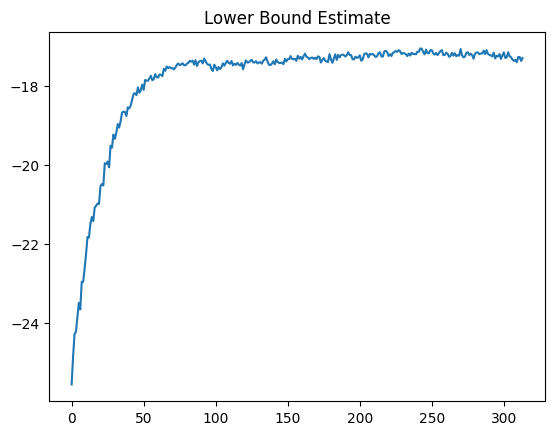

In [44]:
lb_df = pd.DataFrame(np.array(LB_estimate))
plt.figure()
lb_df.plot(title = 'Lower Bound Estimate', legend = False)

<AxesSubplot: title={'center': 'Smoothed Lower Bound Estimate'}>

<Figure size 640x480 with 0 Axes>

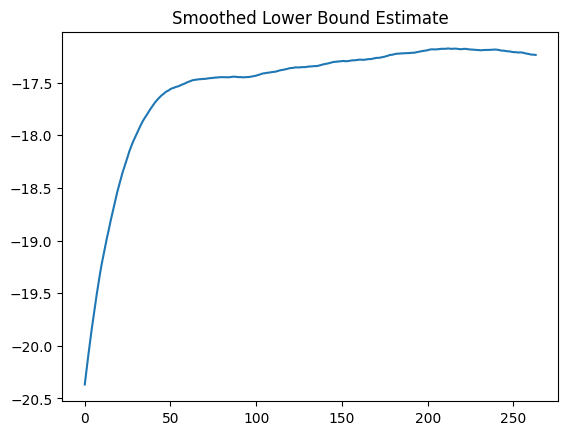

In [45]:
lb_df = pd.DataFrame(np.array(smoothed_LB_estimate))
plt.figure()
lb_df.plot(title = 'Smoothed Lower Bound Estimate', legend = False)

In [198]:
best_mu = best_lambda[0]
best_vech_l = list(best_lambda[1])
best_l = np.zeros((num_coeffs, num_coeffs))
for i in range(num_coeffs):
    best_l[i:num_coeffs,i] = best_vech_l[:num_coeffs - i]
    del best_vech_l[:num_coeffs-i]
best_Sigma_inv = best_l @ best_l.T
best_Sigma =  np.linalg.inv(best_Sigma_inv)

best_theta_tilde = multivariate_normal.rvs(mean = best_mu, cov = best_Sigma, size = 10000)
best_alpha = best_theta_tilde[0]
best_beta = np.exp(best_theta_tilde[1])
best_gamma = best_theta_tilde[2]
best_delta = np.exp(best_theta_tilde[3])
best_theta = np.array([best_alpha, best_beta, best_gamma, best_delta])
posterior_mean_estimate = np.mean(best_theta, axis = 1)
posterior_mean_estimate

array([1.05586993, 7.69468505, 1.10547505, 7.40152564])

Text(0.5, 1.0, 'Posterior density of alpha')

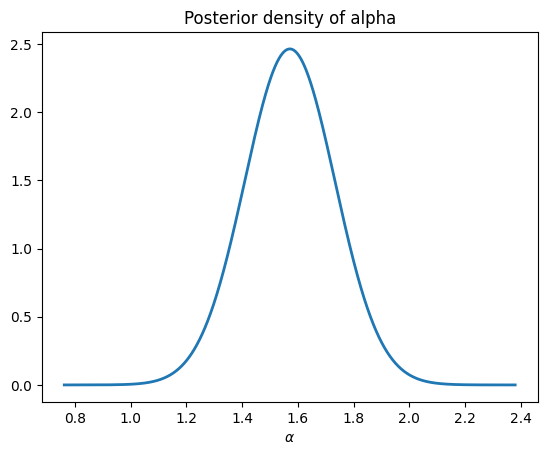

In [ ]:
plt.figure()
x_plot = np.arange((np.mean(best_alpha)-5*np.std(best_alpha)), (np.mean(best_alpha)+5*np.std(best_alpha)), 0.001)
y_plot = ss.norm.pdf(x_plot, np.mean(best_alpha), np.std(best_alpha))
plt.plot(x_plot, y_plot, '-', linewidth=2.0)
plt.xlabel(r'$\alpha$')
plt.title('Posterior density of alpha')

Text(0.5, 1.0, 'Posterior density of beta')

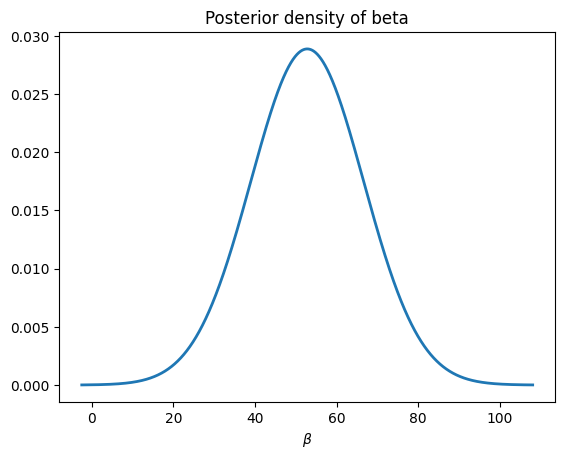

In [ ]:
plt.figure()
x_plot = np.arange((np.mean(best_beta)-4*np.std(best_beta)), (np.mean(best_beta)+4*np.std(best_beta)), 0.001)
y_plot = ss.norm.pdf(x_plot, np.mean(best_beta), np.std(best_beta))
plt.plot(x_plot, y_plot, '-', linewidth=2.0)
plt.xlabel(r'$\beta$')
plt.title('Posterior density of beta')

Text(0.5, 1.0, 'Posterior density of gamma')

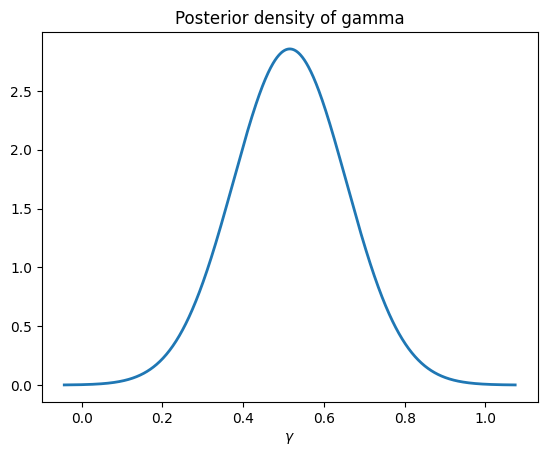

In [ ]:
plt.figure()
x_plot = np.arange((np.mean(best_gamma)-4*np.std(best_gamma)), (np.mean(best_gamma)+4*np.std(best_gamma)), 0.001)
y_plot = ss.norm.pdf(x_plot, np.mean(best_gamma), np.std(best_gamma))
plt.plot(x_plot, y_plot, '-', linewidth=2.0)
plt.xlabel(r'$\gamma$')
plt.title('Posterior density of gamma')